Install dependencies

In [0]:
!apt-get install -y xvfb python-opengl > /dev/null 2>&1
!apt-get install x11-utils
!pip install gym pyvirtualdisplay > /dev/null 2>&1

Reading package lists... Done
Building dependency tree       
Reading state information... Done
x11-utils is already the newest version (7.7+3build1).
The following package was automatically installed and is no longer required:
  libnvidia-common-430
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 25 not upgraded.


Import libraries

In [0]:
%matplotlib inline
import gym
import math
import random
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from collections import namedtuple
from itertools import count
from PIL import Image
from IPython import display
from IPython.display import clear_output, Image as displayImage, display
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as T

Set up display

In [0]:
is_ipython = 'inline' in matplotlib.get_backend()
if is_ipython:
  from IPython import display

In [0]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(400, 300))
display.start()

<Display cmd_param=['Xvfb', '-br', '-nolisten', 'tcp', '-screen', '0', '400x300x24', ':1005'] cmd=['Xvfb', '-br', '-nolisten', 'tcp', '-screen', '0', '400x300x24', ':1005'] oserror=None return_code=None stdout="None" stderr="None" timeout_happened=False>

Deep Q-Network

In [0]:
class DQN(nn.Module):
  def __init__(self, img_height, img_width):
    super().__init__()

    self.fc1 = nn.Linear(in_features=img_height*img_width*3, out_features=128)
    self.fc2 = nn.Linear(in_features=128, out_features=64)
    self.fc3 = nn.Linear(in_features=64, out_features=32)
    self.out = nn.Linear(in_features=32, out_features=2)

  def forward(self, t):
    t = t.flatten(start_dim=1)
    t = F.relu(self.fc1(t))
    t = F.relu(self.fc2(t))
    t = F.relu(self.fc3(t))
    t = self.out(t)
    return t

Experience class

In [0]:
Experience = namedtuple('Experience', ('state', 'action', 'next_state', 'reward'))

Replay memory

In [0]:
class ReplayMemory():
  def __init__(self, capacity):
    self.capacity = capacity
    self.memory = []
    self.push_count = 0

  def push(self, experience):
    if len(self.memory) < self.capacity:
      self.memory.append(experience)
    else:
      self.memory[self.push_count % self.capacity] = experience
    self.push_count += 1

  def sample(self, batch_size):
    return random.sample(self.memory, batch_size)

  def can_provide_sample(self, batch_size):
    return (len(self.memory) >= batch_size)

Epsilon greedy strategy

In [0]:
class EpsilonGreedyStrategy():
  def __init__(self, start, end, decay):
    self.start = start
    self.end = end
    self.decay = decay

  def get_exploration_rate(self, current_step):
    return self.end + (self.start - self.end) * math.exp(-1. * current_step * self.decay)

Reinforcement learning agent

In [0]:
class Agent():
  def __init__(self, strategy, num_actions, device):
    self.current_step = 0
    self.strategy = strategy
    self.num_actions = num_actions
    self.device = device

  def select_action(self, state, policy_net):
    rate = strategy.get_exploration_rate(self.current_step)
    self.current_step += 1
    
    if rate > random.random():
      action = random.randrange(self.num_actions)
      return torch.tensor([action]).to(device)             # Explore
    else:
      with torch.no_grad():
        return policy_net(state).argmax(dim=1).to(device)  # Exploit

Environment manager

In [0]:
class CartPoleEnvManager():
  def __init__(self, device):
    self.device = device
    self.env = gym.make('CartPole-v0').unwrapped
    self.env.reset()
    self.current_screen = None
    self.done = False

  def reset(self):
    self.env.reset()
    self.current_screen = None

  def close(self):
    self.env.close()

  def render(self, mode='human'):
    return self.env.render(mode)

  def num_actions_available(self):
    return self.env.action_space.n

  def take_action(self, action):
    _, reward, self.done, _ = self.env.step(action.item())
    return torch.tensor([reward], device=self.device)

  def just_starting(self):
    return self.current_screen is None

  def get_state(self):
    if self.just_starting() or self.done:
      self.current_screen = self.get_processed_screen()
      black_screen = torch.zeros_like(self.current_screen)
      return black_screen
    else:
      s1 = self.current_screen
      s2 = self.get_processed_screen()
      self.current_screen = s2
      return s2 - s1

  def get_screen_height(self):
    screen = self.get_processed_screen()
    return screen.shape[2]
    
  def get_screen_width(self):
    screen = self.get_processed_screen()
    return screen.shape[3]

  def get_processed_screen(self):
    screen = self.render(mode='rgb_array').transpose((2, 0, 1))   # PyTorch expects CHW
    screen = self.crop_screen(screen)
    return self.transform_screen_data(screen)

  def crop_screen(self, screen):
    screen_height = screen.shape[1]
    
    # Strip off top and bottom
    top = int(screen_height * 0.4)
    bottom = int(screen_height * 0.8)
    screen = screen[:, top:bottom, :]
    return screen

  def transform_screen_data(self, screen):       
    # Convert to float, rescale, convert to tensor
    screen = np.ascontiguousarray(screen, dtype=np.float32) / 255
    screen = torch.from_numpy(screen)
    
    # Use torchvision package to compose image transforms
    resize = T.Compose([
        T.ToPILImage()
        ,T.Resize((40,90))
        ,T.ToTensor()
    ])
    
    return resize(screen).unsqueeze(0).to(self.device)   # add a batch dimension (BCHW)  

Example of non-processed screen

/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


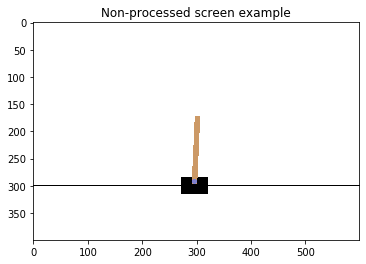

In [0]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
em = CartPoleEnvManager(device)
em.reset()
screen = em.render(mode='rgb_array')

plt.figure()
plt.imshow(screen)
plt.title('Non-processed screen example')
plt.show()

Example of processed screen

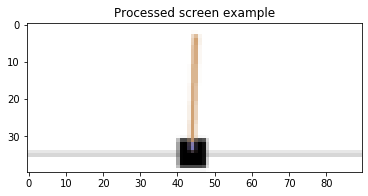

In [0]:
screen = em.get_processed_screen()

plt.figure()
plt.imshow(screen.squeeze(0).permute(1, 2, 0).cpu(), interpolation='none')
plt.title('Processed screen example')
plt.show()

Example of starting state

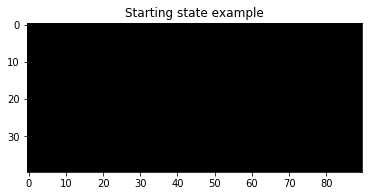

In [0]:
screen = em.get_state()
    
plt.figure()
plt.imshow(screen.squeeze(0).permute(1, 2, 0).cpu(), interpolation='none')
plt.title('Starting state example')
plt.show()

Example of non-starting state

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


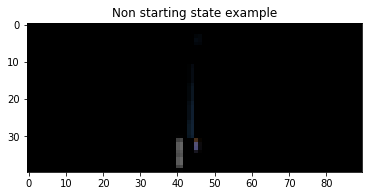

In [0]:
for i in range(5):
    em.take_action(torch.tensor([1]))
screen = em.get_state()

plt.figure()
plt.imshow(screen.squeeze(0).permute(1, 2, 0).cpu(), interpolation='none')
plt.title('Non starting state example')
plt.show()

Example of ending state

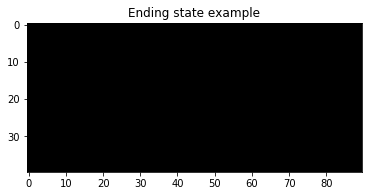

In [0]:
em.done = True
screen = em.get_state()

plt.figure()
plt.imshow(screen.squeeze(0).permute(1, 2, 0).cpu(), interpolation='none')
plt.title('Ending state example')
plt.show()
em.close()

Utility functions

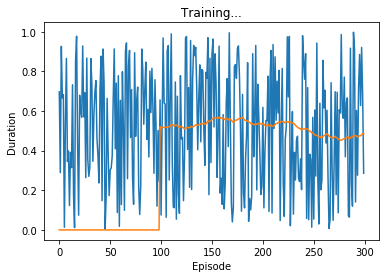

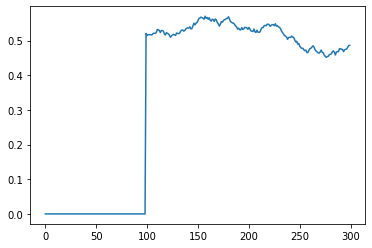

Episode 300 
 100 episode moving avg: 0.48609164


In [0]:
def plot(values, moving_avg_period):
    #plt.cla()
    #plt.clf()
    
    plt.figure(2)
    plt.clf()        
    plt.title('Training...')
    plt.xlabel('Episode')
    plt.ylabel('Duration')

    #plt.plot(values)
    #plt.plot(get_moving_average(moving_avg_period, values))
    #plt.pause(0.001)
    moving_avg = get_moving_average(moving_avg_period, values)
    plt.plot(moving_avg)    
    plt.pause(0.001)
    print("Episode", len(values), "\n", \
        moving_avg_period, "episode moving avg:", moving_avg[-1])

def get_moving_average(period, values):
    values = torch.tensor(values, dtype=torch.float)
    if len(values) >= period:
        moving_avg = values.unfold(dimension=0, size=period, step=1) \
            .mean(dim=1).flatten(start_dim=0)
        moving_avg = torch.cat((torch.zeros(period-1), moving_avg))
        return moving_avg.numpy()
    else:
        moving_avg = torch.zeros(len(values))
        return moving_avg.numpy()

# Example plot
plot(np.random.rand(300), 100)

Main program

In [0]:
batch_size = 256         #
gamma = 0.99             # Discount factor
eps_start = 1            # Max epsilon (starting value)
eps_end = 0.01           # Min epsilon (ending value)
eps_decay = 0.001        # Epsilon decay rate
target_update = 10       # How frequently we will update the target network's weights with the policy network's weights
memory_size = 100000     #
lr = 0.001               # Learning rate
num_episodes = 1000      # Number of episodes

Essential objects

In [0]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
em = CartPoleEnvManager(device)
strategy = EpsilonGreedyStrategy(eps_start, eps_end, eps_decay)
agent = Agent(strategy, em.num_actions_available(), device)
memory = ReplayMemory(memory_size)

policy_net = DQN(em.get_screen_height(), em.get_screen_width()).to(device)
target_net = DQN(em.get_screen_height(), em.get_screen_width()).to(device)
target_net.load_state_dict(policy_net.state_dict())
target_net.eval()
optimizer = optim.Adam(params=policy_net.parameters(), lr=lr)

/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Tensor processing

In [0]:
def extract_tensors(experiences):
    # Convert batch of Experiences to Experience of batches
    batch = Experience(*zip(*experiences))

    t1 = torch.cat(batch.state)
    t2 = torch.cat(batch.action)
    t3 = torch.cat(batch.reward)
    t4 = torch.cat(batch.next_state)

    return (t1,t2,t3,t4)

Q-value calculator

In [0]:
class QValues():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    @staticmethod
    def get_current(policy_net, states, actions):
        return policy_net(states).gather(dim=1, index=actions.unsqueeze(-1))

    @staticmethod        
    def get_next(target_net, next_states):                
        final_state_locations = next_states.flatten(start_dim=1) .max(dim=1)[0].eq(0).type(torch.bool)
        non_final_state_locations = (final_state_locations == False)
        non_final_states = next_states[non_final_state_locations]
        batch_size = next_states.shape[0]
        values = torch.zeros(batch_size).to(QValues.device)
        values[non_final_state_locations] = target_net(non_final_states).max(dim=1)[0].detach()
        return values

Training loop

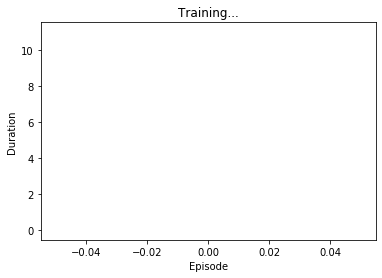

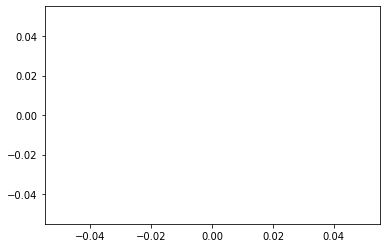

Episode 1 
 100 episode moving avg: 0.0


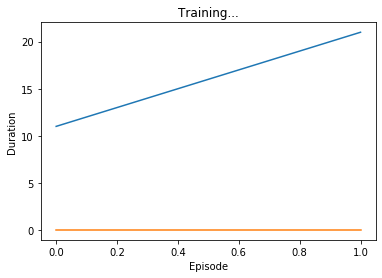

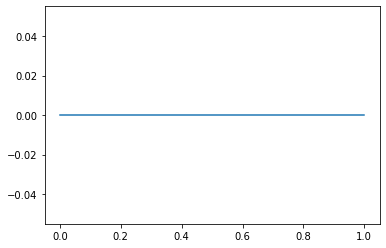

Episode 2 
 100 episode moving avg: 0.0


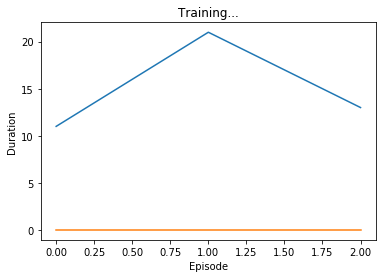

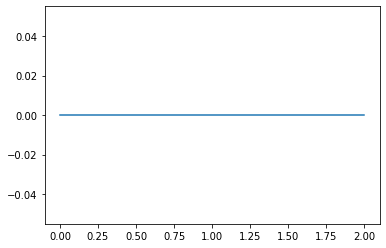

Episode 3 
 100 episode moving avg: 0.0


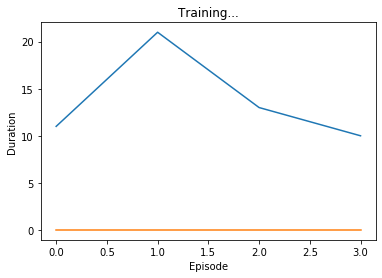

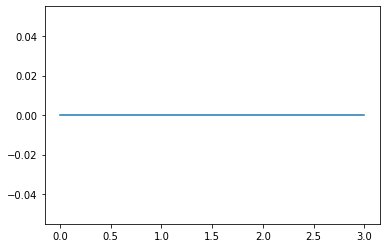

Episode 4 
 100 episode moving avg: 0.0


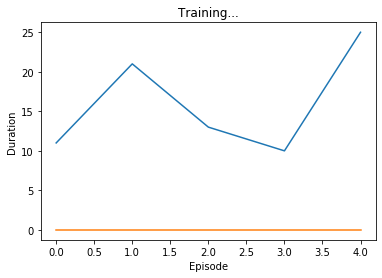

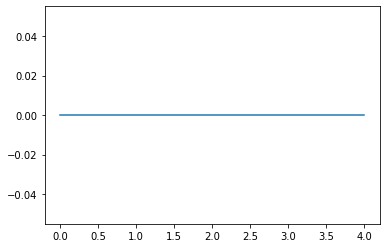

Episode 5 
 100 episode moving avg: 0.0


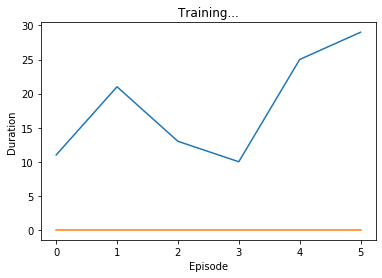

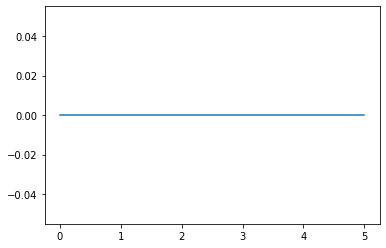

Episode 6 
 100 episode moving avg: 0.0


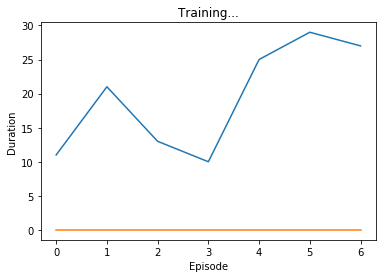

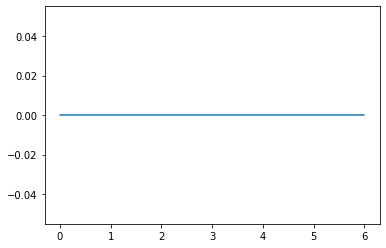

Episode 7 
 100 episode moving avg: 0.0


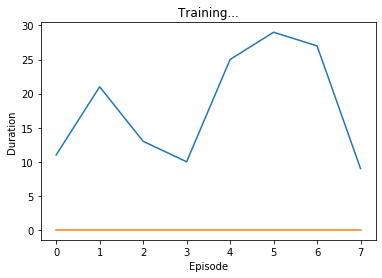

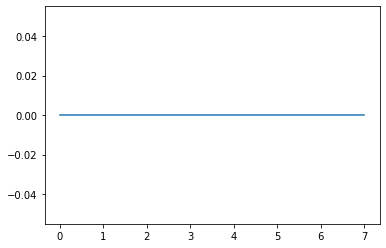

Episode 8 
 100 episode moving avg: 0.0


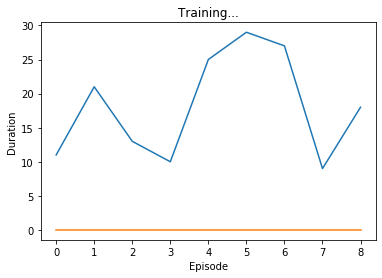

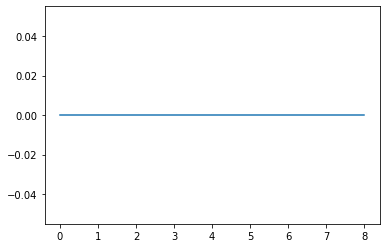

Episode 9 
 100 episode moving avg: 0.0


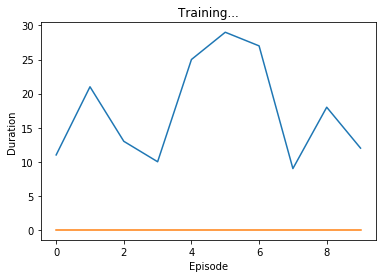

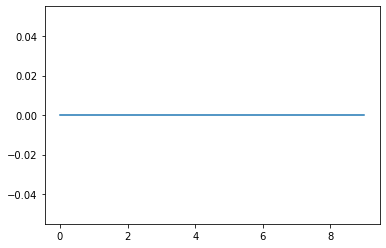

Episode 10 
 100 episode moving avg: 0.0


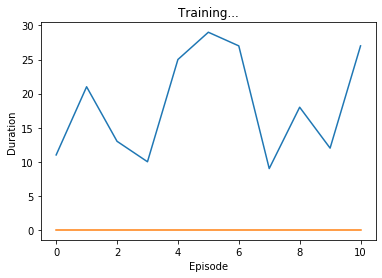

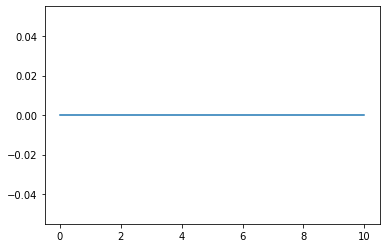

Episode 11 
 100 episode moving avg: 0.0


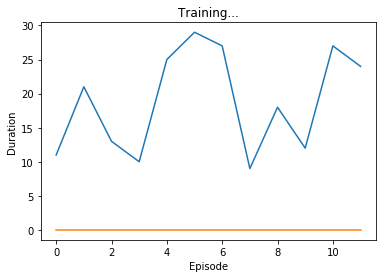

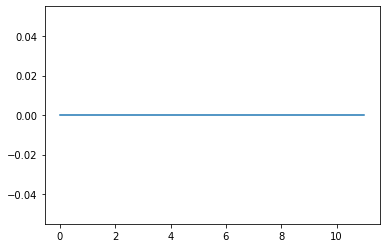

Episode 12 
 100 episode moving avg: 0.0


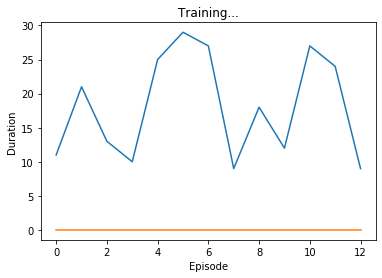

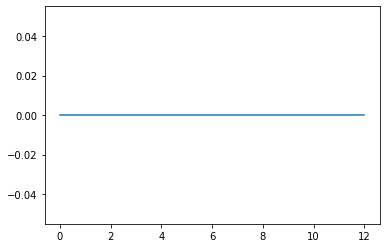

Episode 13 
 100 episode moving avg: 0.0


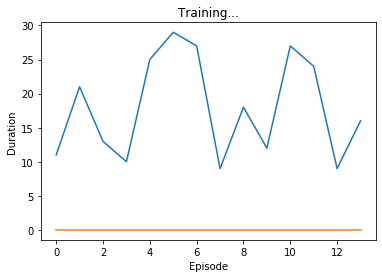

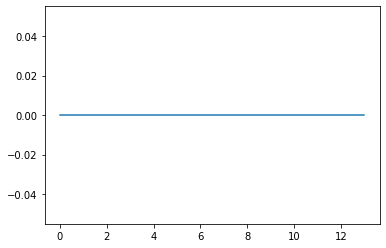

Episode 14 
 100 episode moving avg: 0.0


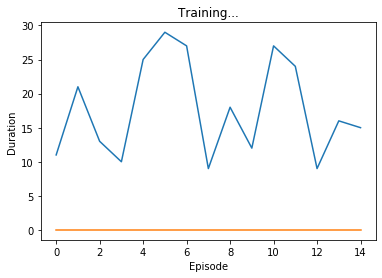

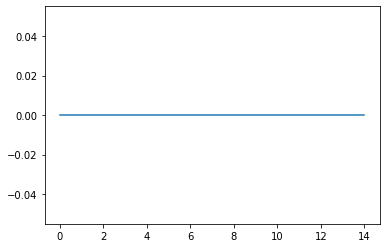

Episode 15 
 100 episode moving avg: 0.0


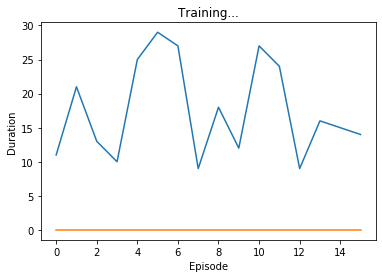

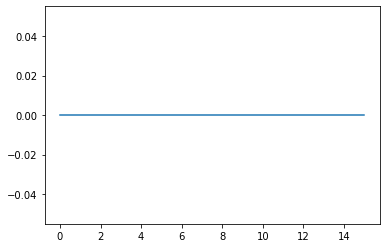

Episode 16 
 100 episode moving avg: 0.0


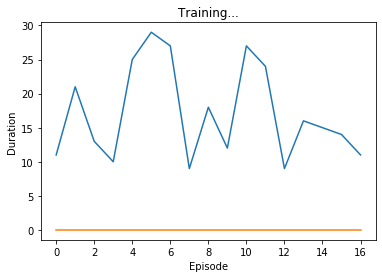

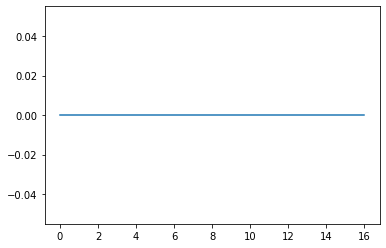

Episode 17 
 100 episode moving avg: 0.0


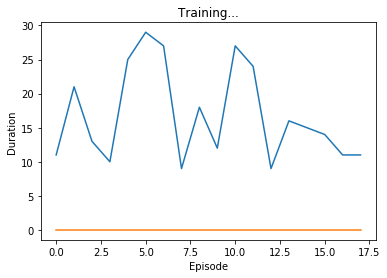

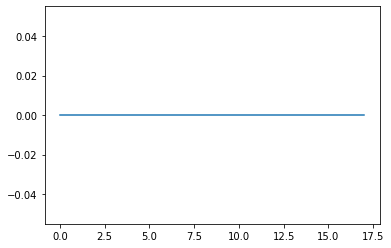

Episode 18 
 100 episode moving avg: 0.0


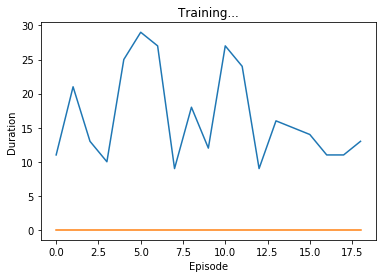

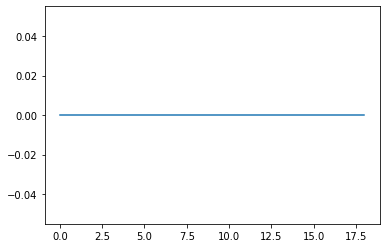

Episode 19 
 100 episode moving avg: 0.0


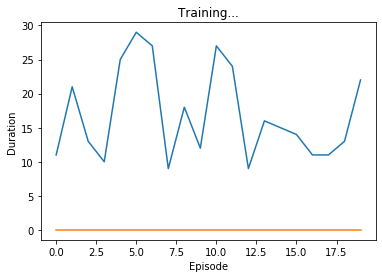

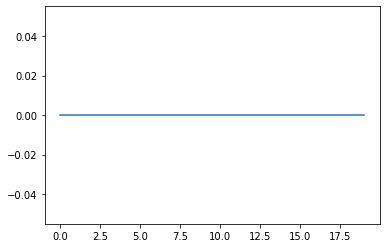

Episode 20 
 100 episode moving avg: 0.0


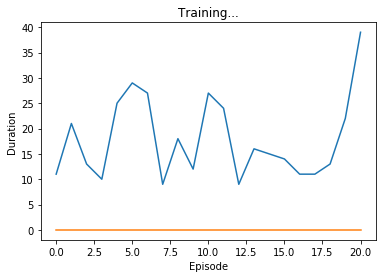

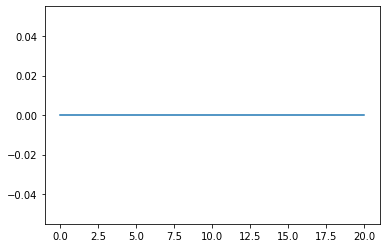

Episode 21 
 100 episode moving avg: 0.0


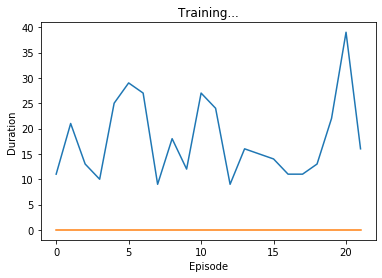

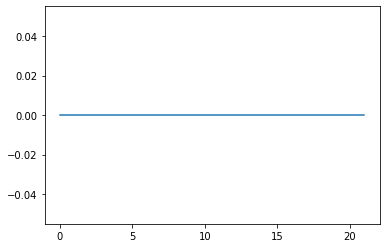

Episode 22 
 100 episode moving avg: 0.0


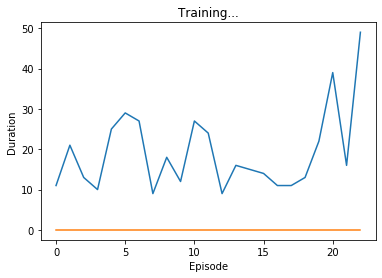

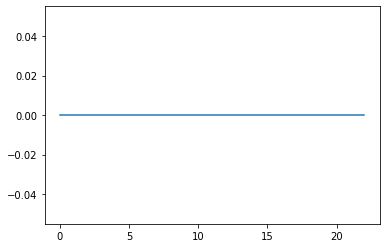

Episode 23 
 100 episode moving avg: 0.0


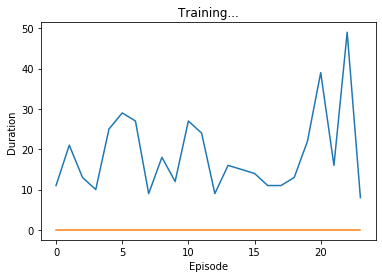

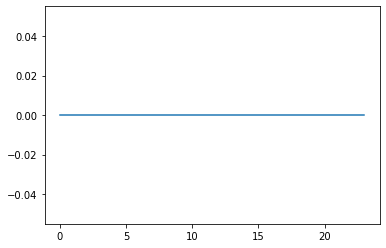

Episode 24 
 100 episode moving avg: 0.0


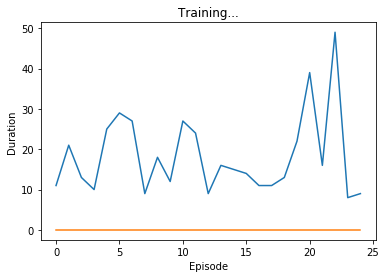

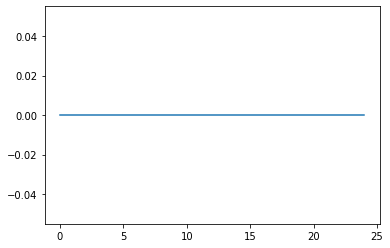

Episode 25 
 100 episode moving avg: 0.0


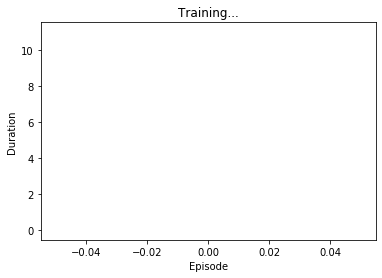

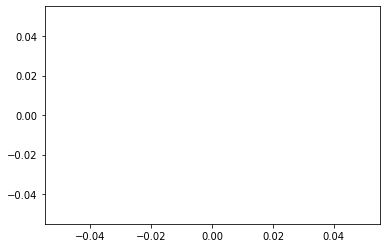

Episode 1 
 100 episode moving avg: 0.0


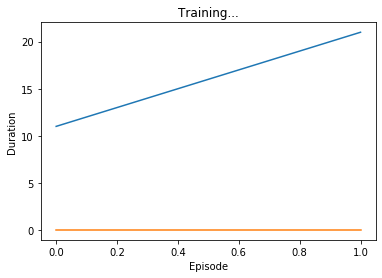

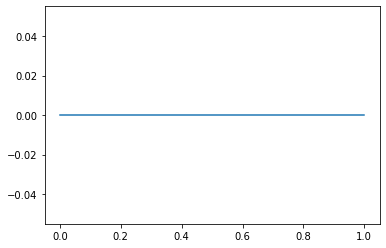

Episode 2 
 100 episode moving avg: 0.0


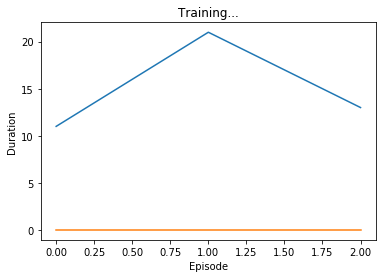

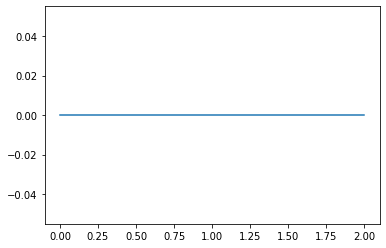

Episode 3 
 100 episode moving avg: 0.0


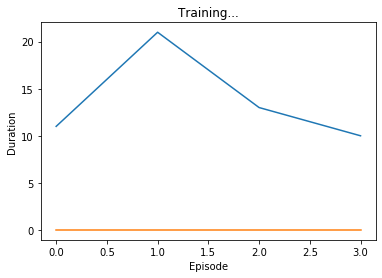

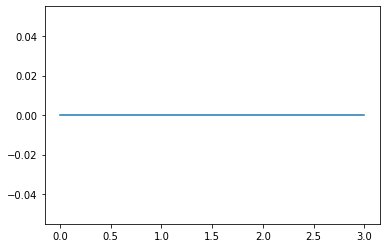

Episode 4 
 100 episode moving avg: 0.0


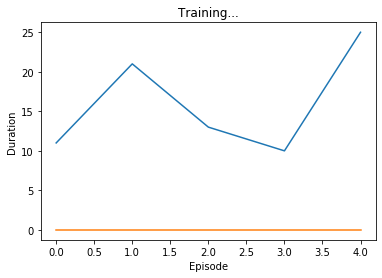

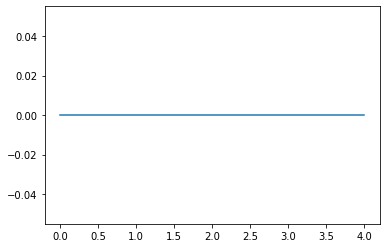

Episode 5 
 100 episode moving avg: 0.0


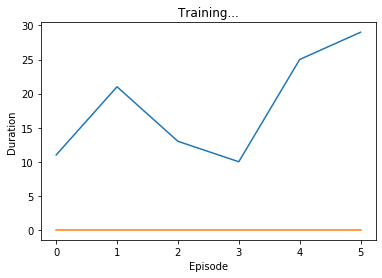

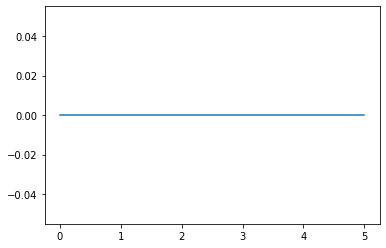

Episode 6 
 100 episode moving avg: 0.0


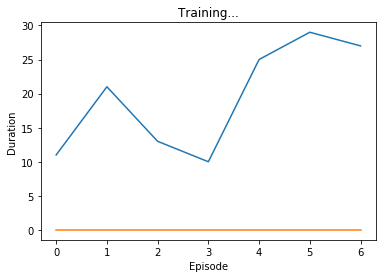

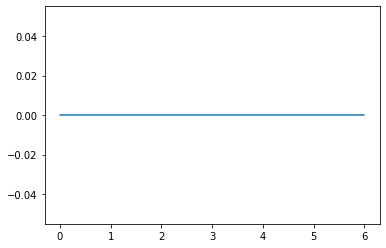

Episode 7 
 100 episode moving avg: 0.0


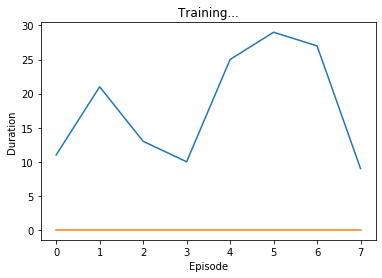

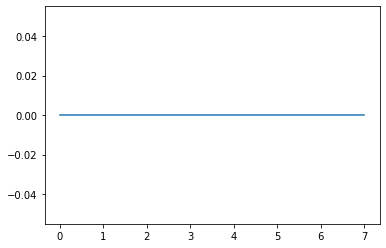

Episode 8 
 100 episode moving avg: 0.0


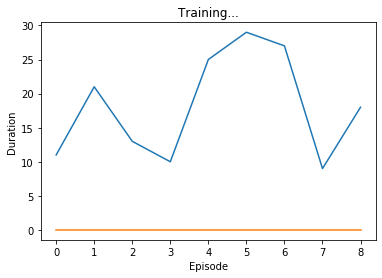

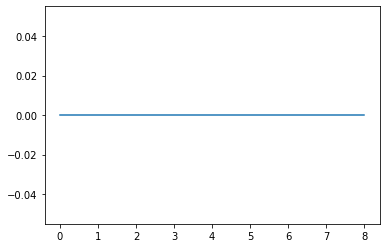

Episode 9 
 100 episode moving avg: 0.0


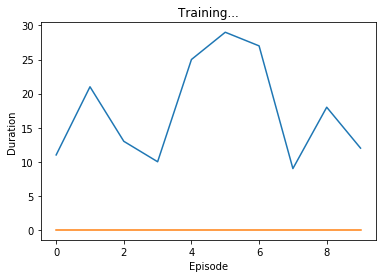

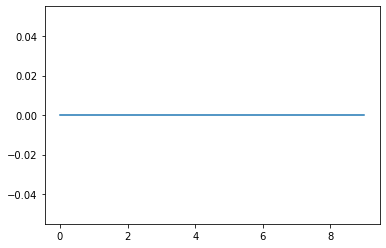

Episode 10 
 100 episode moving avg: 0.0


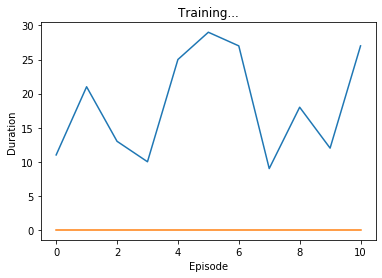

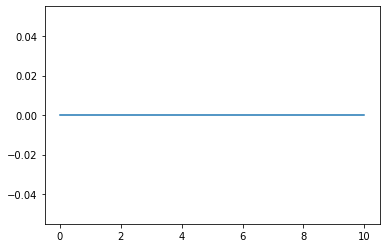

Episode 11 
 100 episode moving avg: 0.0


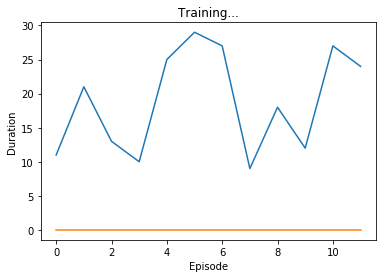

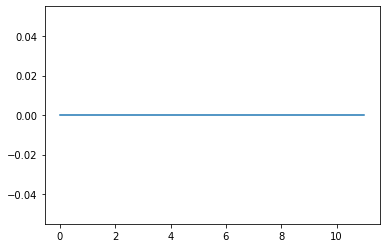

Episode 12 
 100 episode moving avg: 0.0


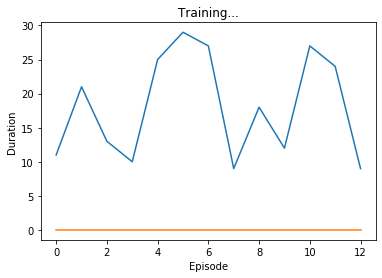

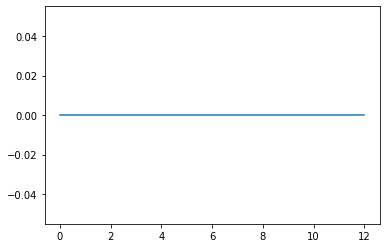

Episode 13 
 100 episode moving avg: 0.0


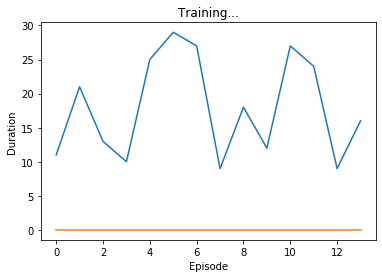

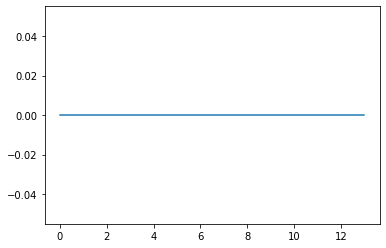

Episode 14 
 100 episode moving avg: 0.0


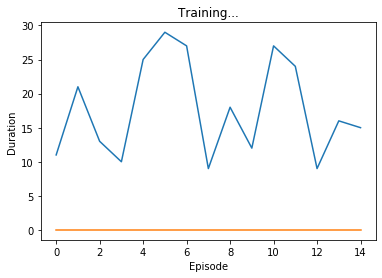

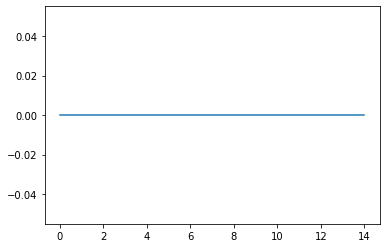

Episode 15 
 100 episode moving avg: 0.0


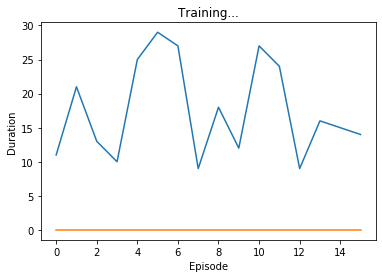

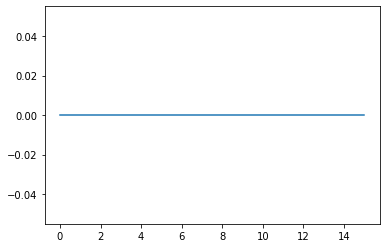

Episode 16 
 100 episode moving avg: 0.0


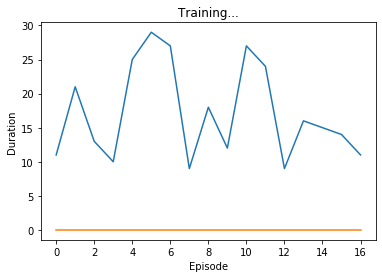

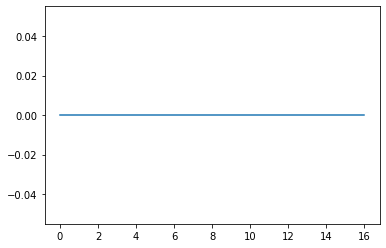

Episode 17 
 100 episode moving avg: 0.0


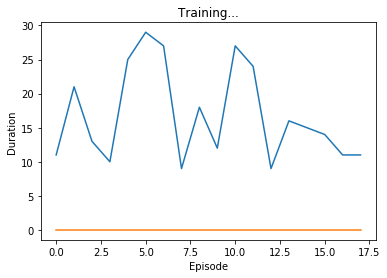

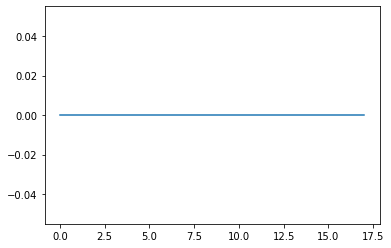

Episode 18 
 100 episode moving avg: 0.0


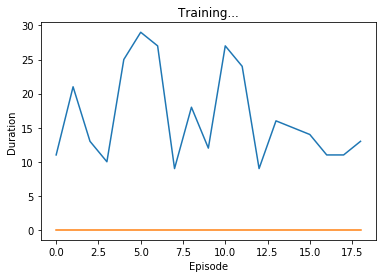

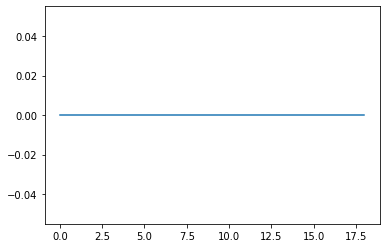

Episode 19 
 100 episode moving avg: 0.0


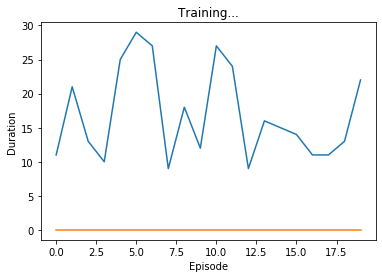

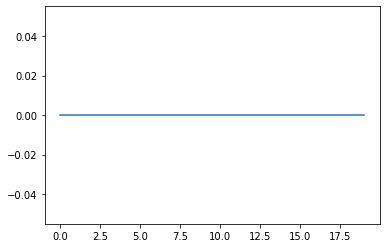

Episode 20 
 100 episode moving avg: 0.0


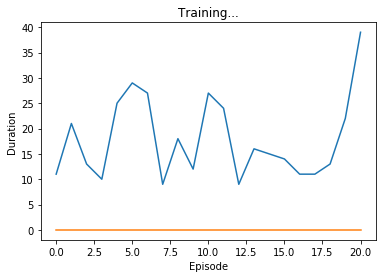

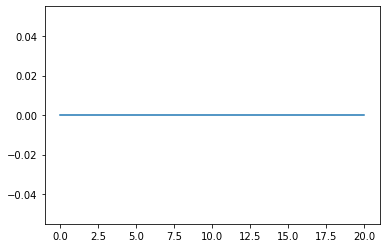

Episode 21 
 100 episode moving avg: 0.0


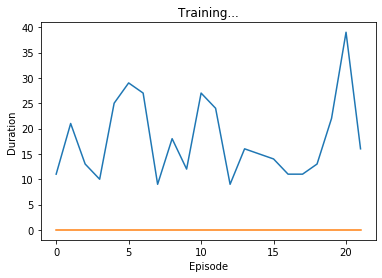

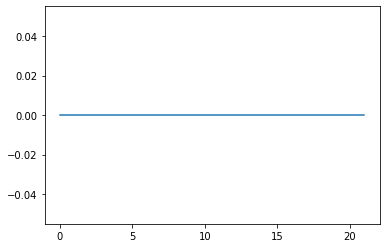

Episode 22 
 100 episode moving avg: 0.0


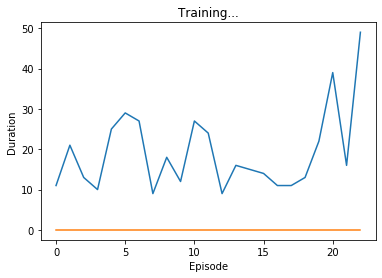

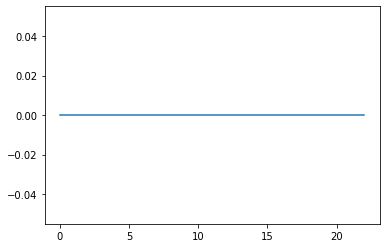

Episode 23 
 100 episode moving avg: 0.0


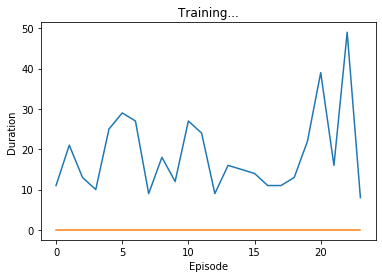

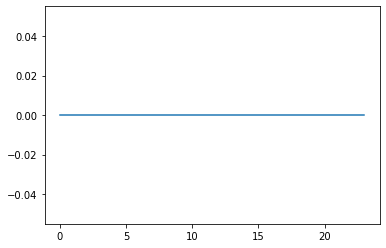

Episode 24 
 100 episode moving avg: 0.0


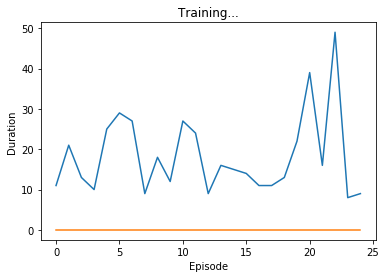

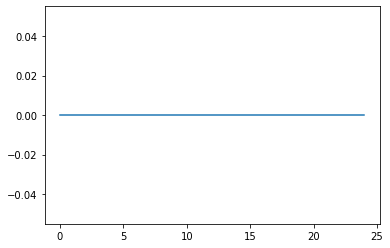

Episode 25 
 100 episode moving avg: 0.0


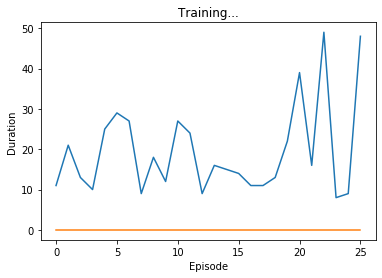

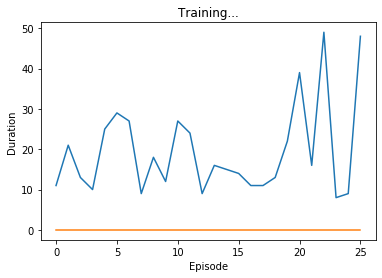

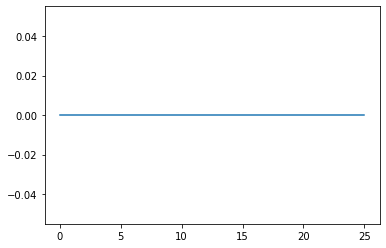

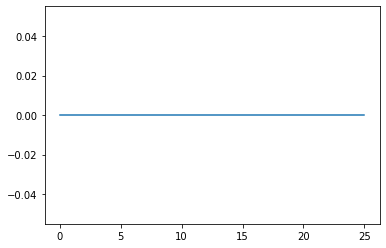

Episode 26 
 100 episode moving avg: 0.0
Episode 26 
 100 episode moving avg: 0.0


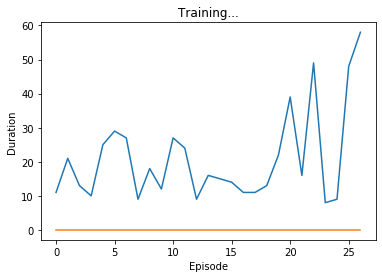

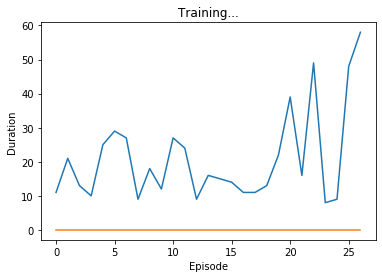

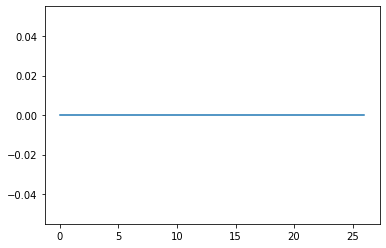

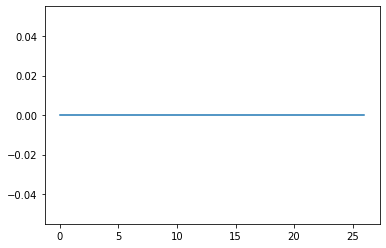

Episode 27 
 100 episode moving avg: 0.0
Episode 27 
 100 episode moving avg: 0.0


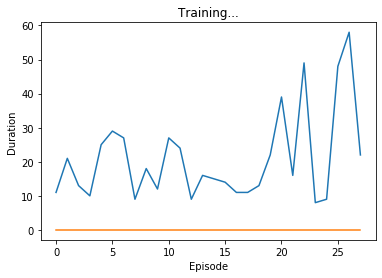

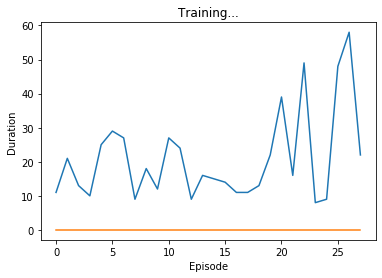

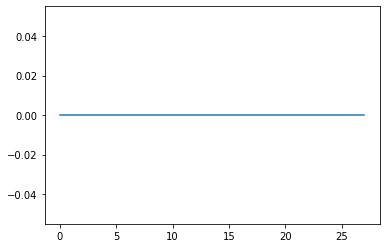

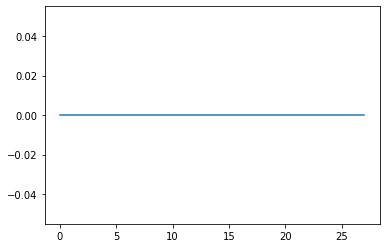

Episode 28 
 100 episode moving avg: 0.0
Episode 28 
 100 episode moving avg: 0.0


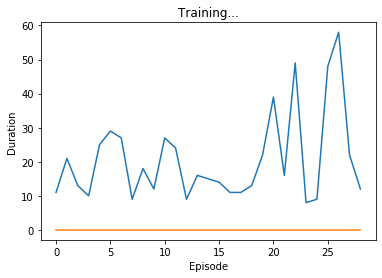

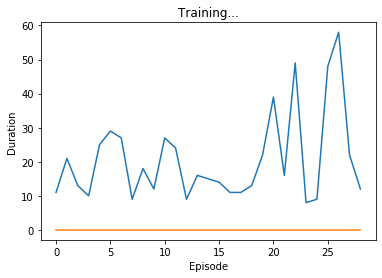

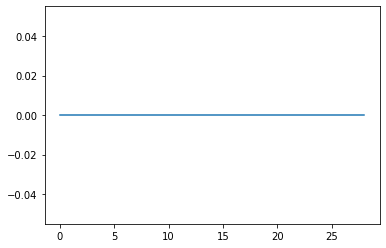

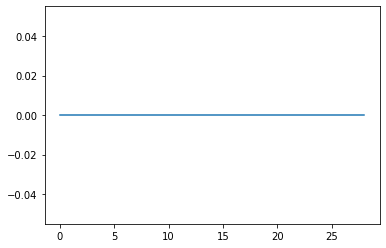

Episode 29 
 100 episode moving avg: 0.0
Episode 29 
 100 episode moving avg: 0.0


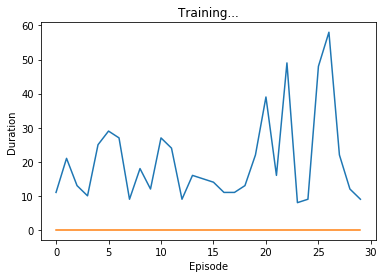

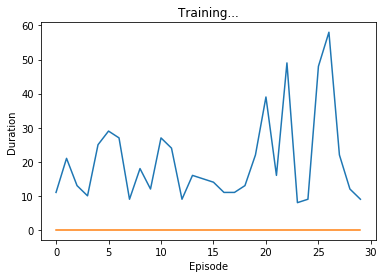

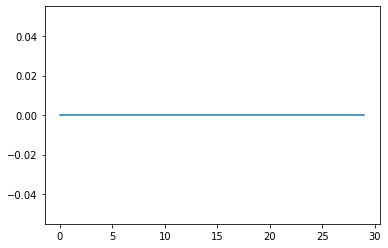

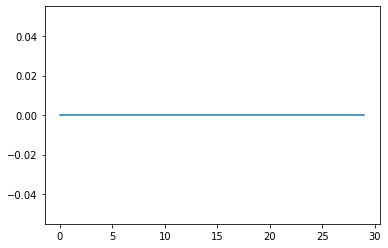

Episode 30 
 100 episode moving avg: 0.0
Episode 30 
 100 episode moving avg: 0.0


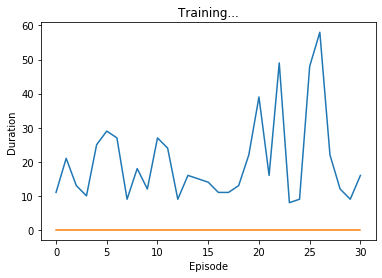

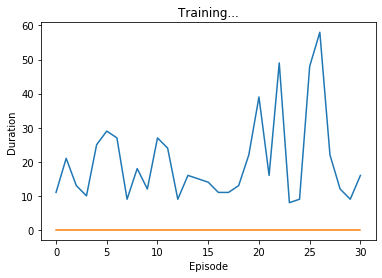

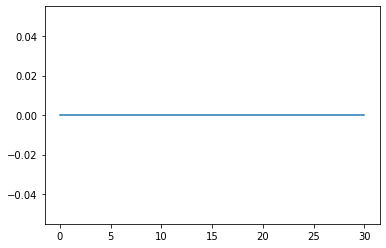

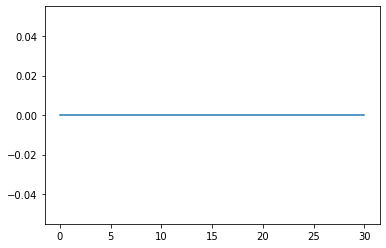

Episode 31 
 100 episode moving avg: 0.0
Episode 31 
 100 episode moving avg: 0.0


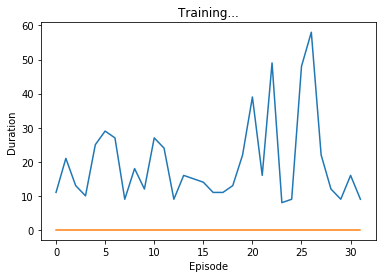

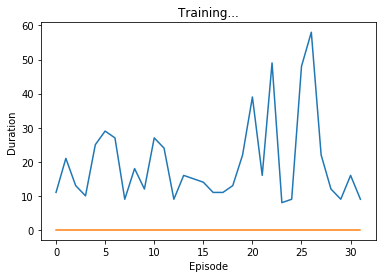

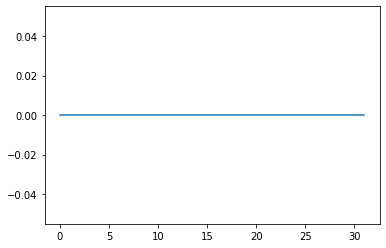

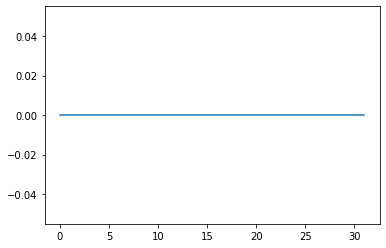

Episode 32 
 100 episode moving avg: 0.0
Episode 32 
 100 episode moving avg: 0.0


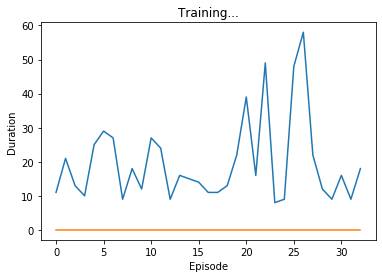

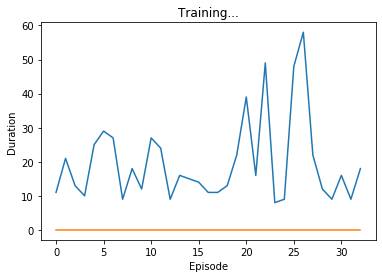

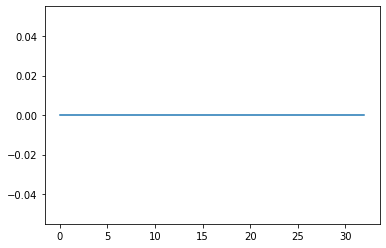

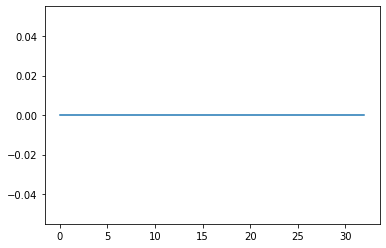

Episode 33 
 100 episode moving avg: 0.0
Episode 33 
 100 episode moving avg: 0.0


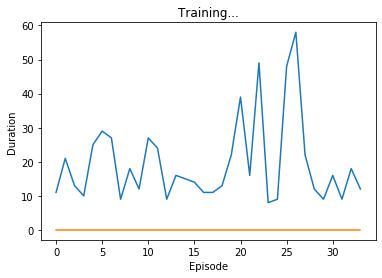

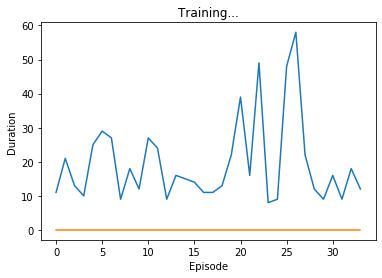

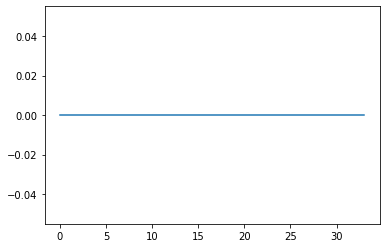

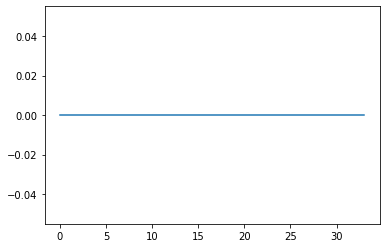

Episode 34 
 100 episode moving avg: 0.0
Episode 34 
 100 episode moving avg: 0.0


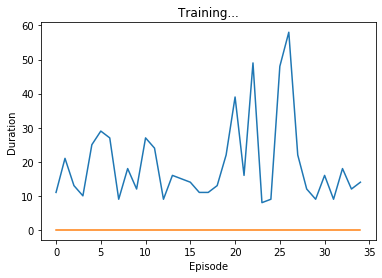

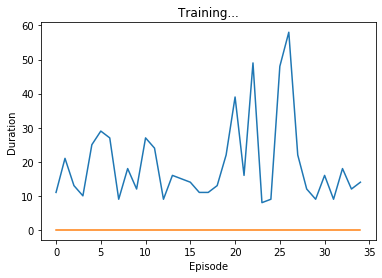

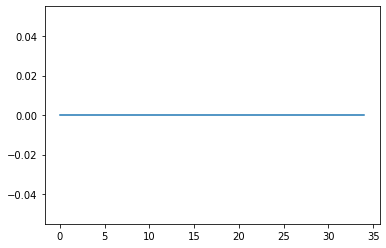

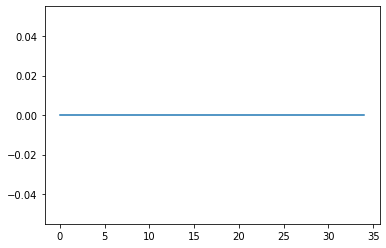

Episode 35 
 100 episode moving avg: 0.0
Episode 35 
 100 episode moving avg: 0.0


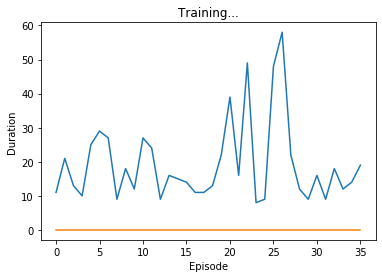

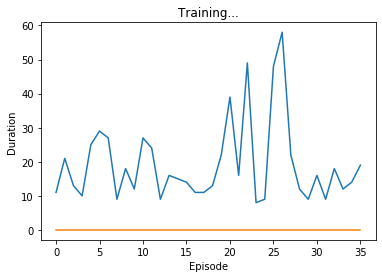

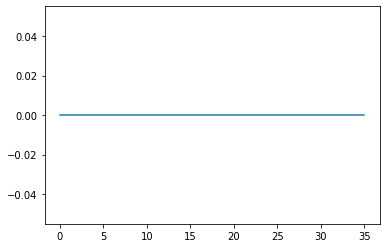

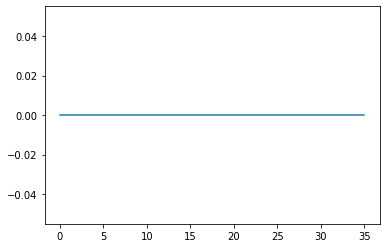

Episode 36 
 100 episode moving avg: 0.0
Episode 36 
 100 episode moving avg: 0.0


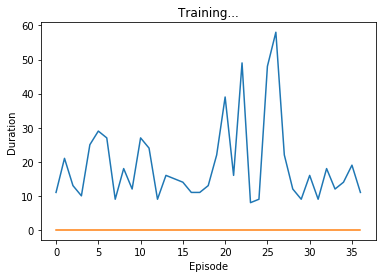

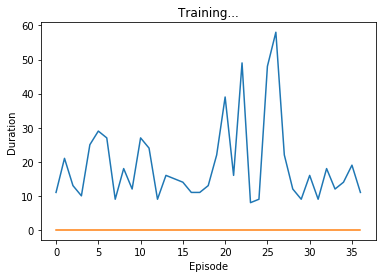

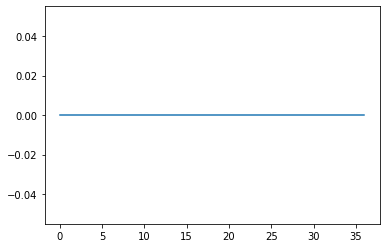

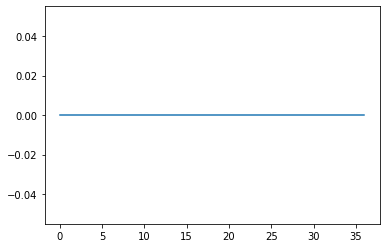

Episode 37 
 100 episode moving avg: 0.0
Episode 37 
 100 episode moving avg: 0.0


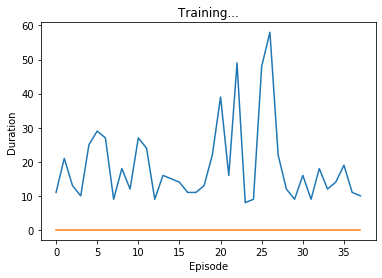

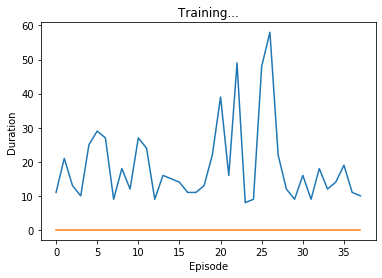

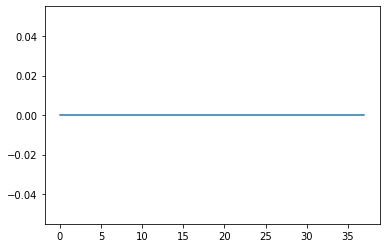

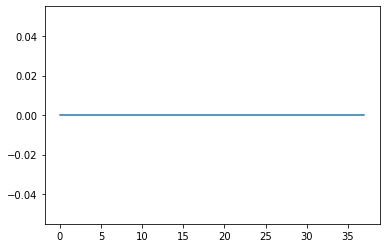

Episode 38 
 100 episode moving avg: 0.0
Episode 38 
 100 episode moving avg: 0.0


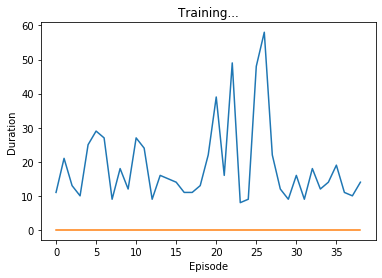

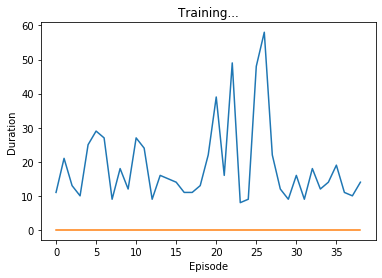

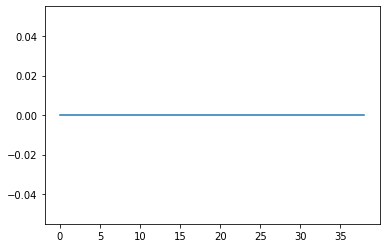

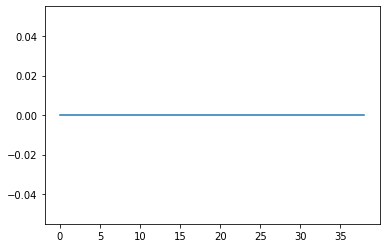

Episode 39 
 100 episode moving avg: 0.0
Episode 39 
 100 episode moving avg: 0.0


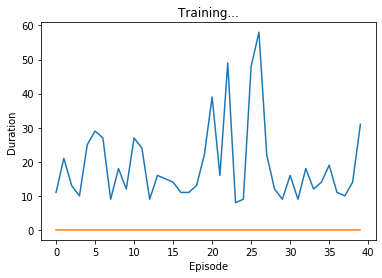

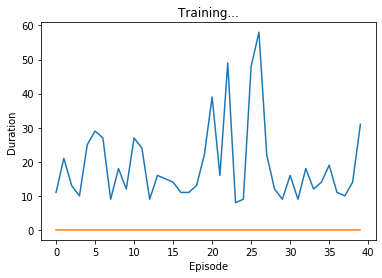

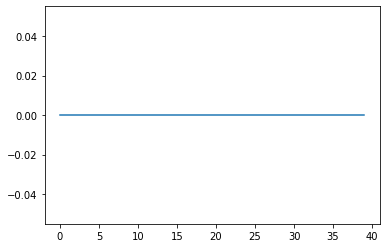

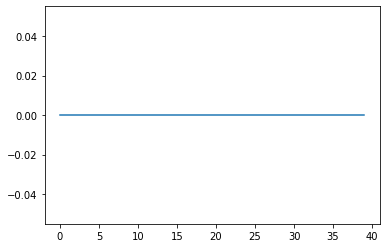

Episode 40 
 100 episode moving avg: 0.0
Episode 40 
 100 episode moving avg: 0.0


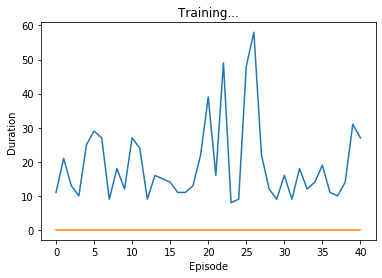

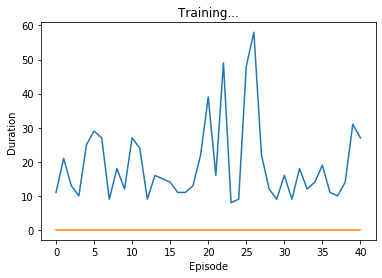

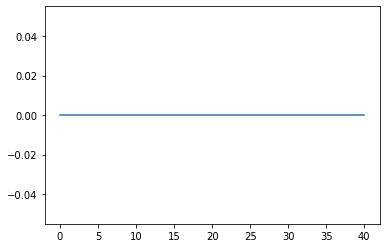

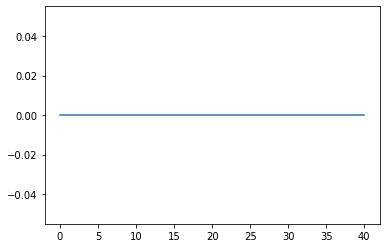

Episode 41 
 100 episode moving avg: 0.0
Episode 41 
 100 episode moving avg: 0.0


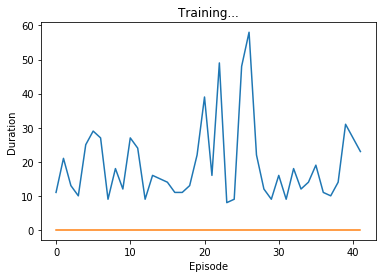

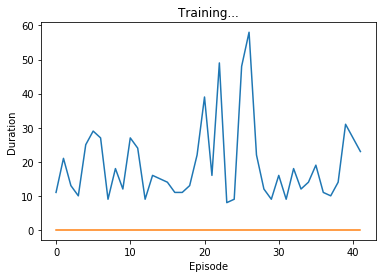

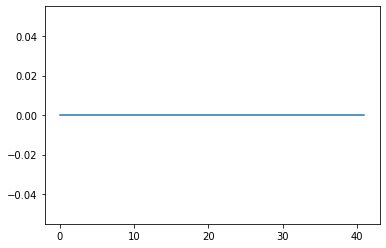

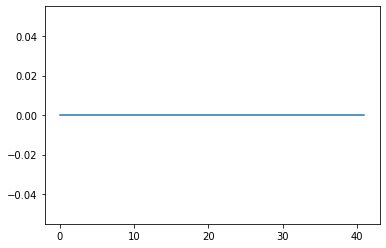

Episode 42 
 100 episode moving avg: 0.0
Episode 42 
 100 episode moving avg: 0.0


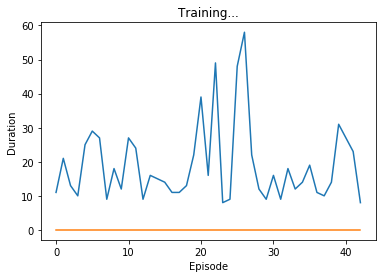

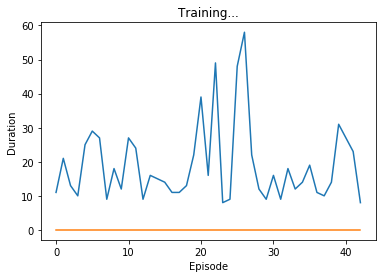

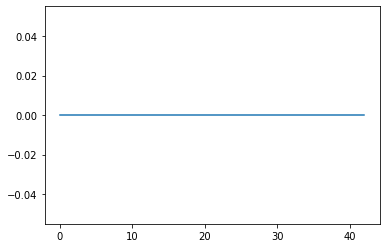

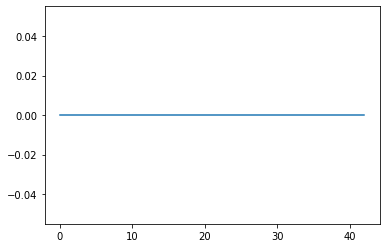

Episode 43 
 100 episode moving avg: 0.0
Episode 43 
 100 episode moving avg: 0.0


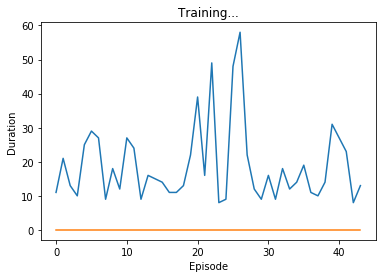

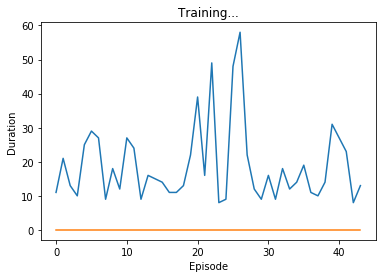

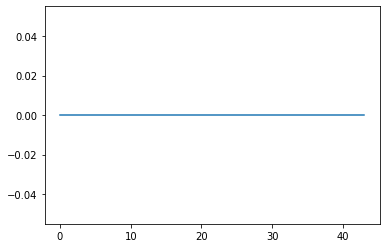

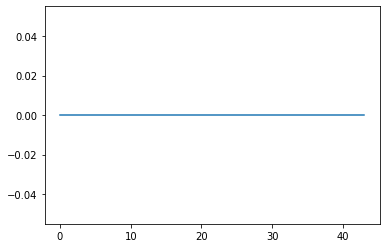

Episode 44 
 100 episode moving avg: 0.0
Episode 44 
 100 episode moving avg: 0.0


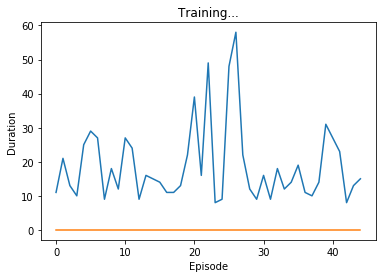

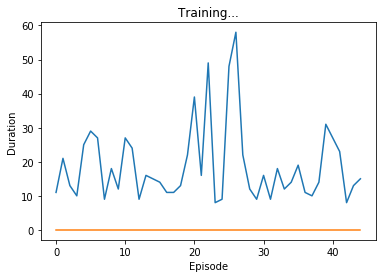

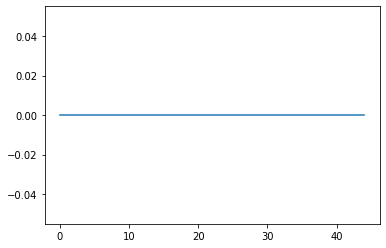

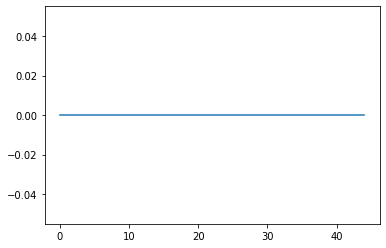

Episode 45 
 100 episode moving avg: 0.0
Episode 45 
 100 episode moving avg: 0.0


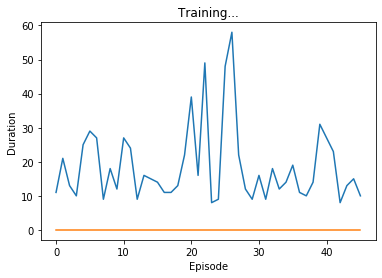

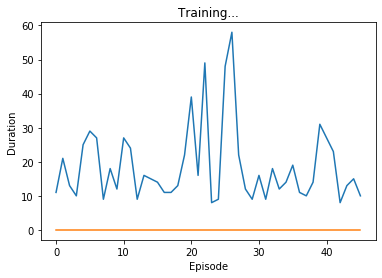

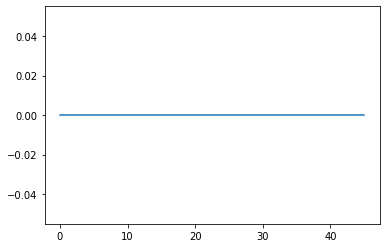

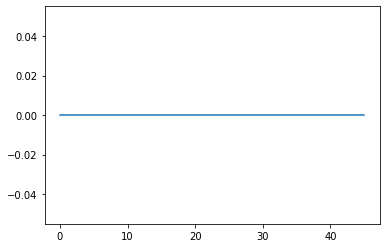

Episode 46 
 100 episode moving avg: 0.0
Episode 46 
 100 episode moving avg: 0.0


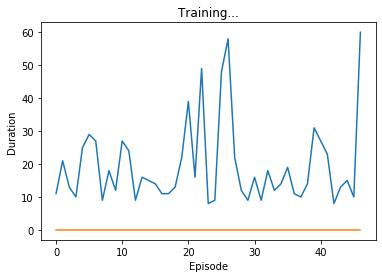

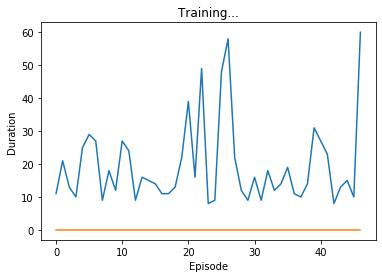

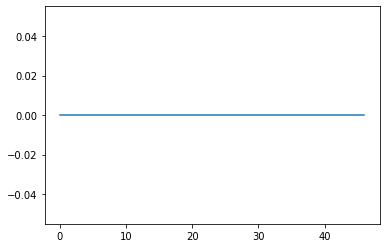

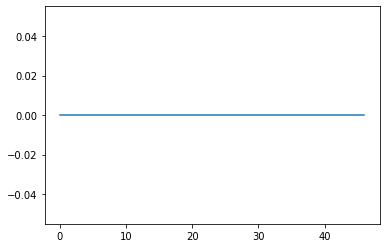

Episode 47 
 100 episode moving avg: 0.0
Episode 47 
 100 episode moving avg: 0.0


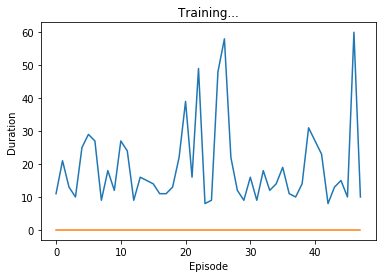

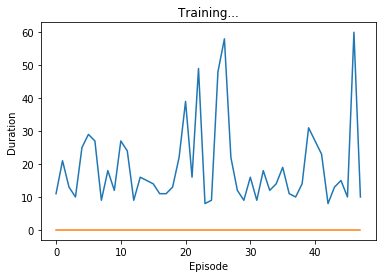

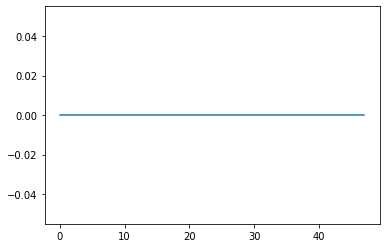

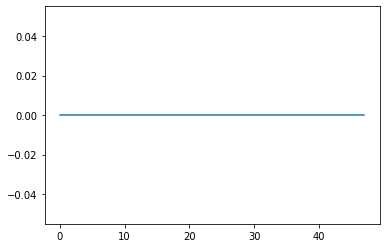

Episode 48 
 100 episode moving avg: 0.0
Episode 48 
 100 episode moving avg: 0.0


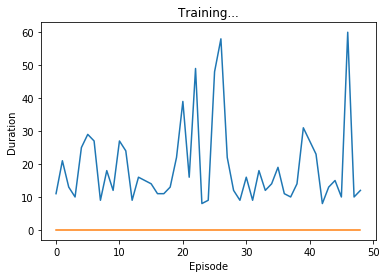

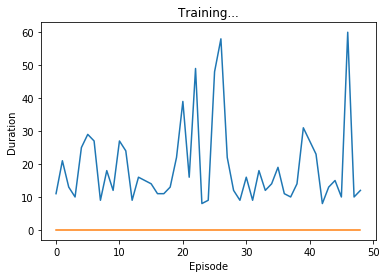

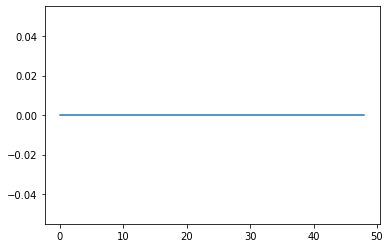

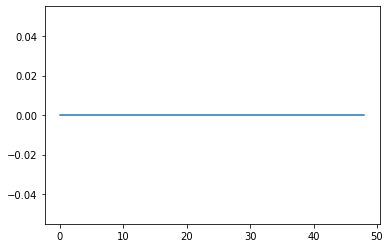

Episode 49 
 100 episode moving avg: 0.0
Episode 49 
 100 episode moving avg: 0.0


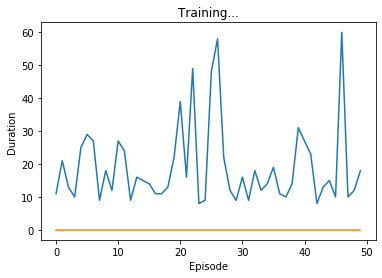

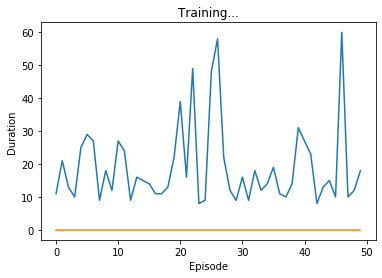

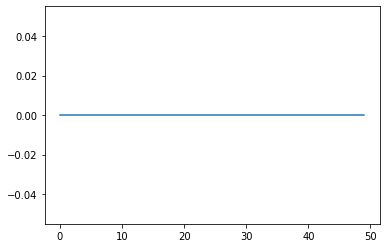

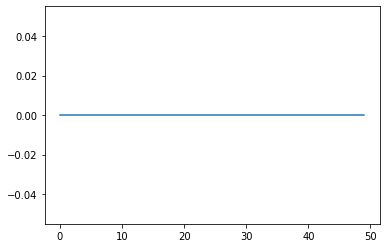

Episode 50 
 100 episode moving avg: 0.0
Episode 50 
 100 episode moving avg: 0.0


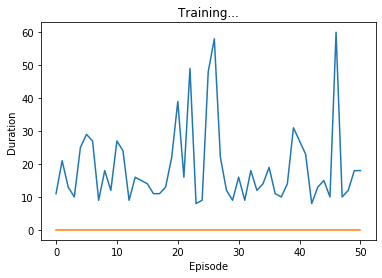

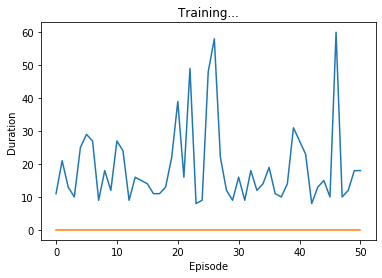

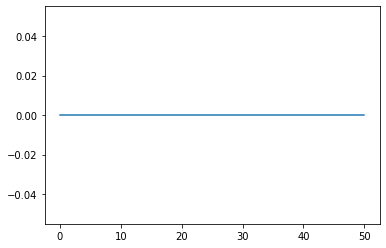

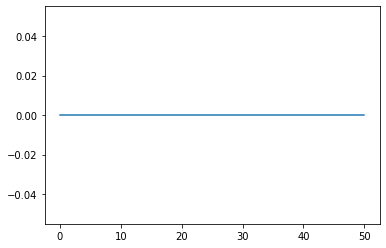

Episode 51 
 100 episode moving avg: 0.0
Episode 51 
 100 episode moving avg: 0.0


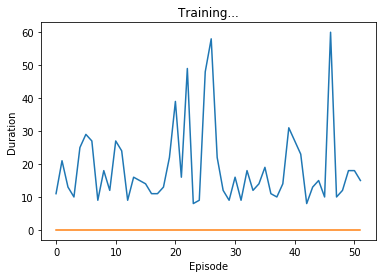

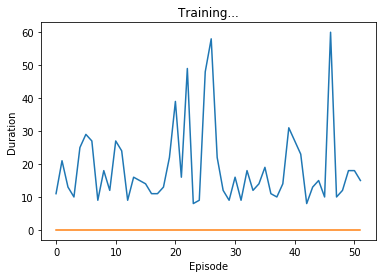

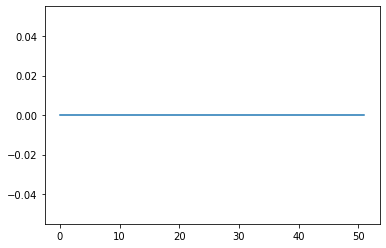

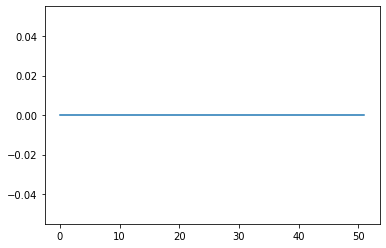

Episode 52 
 100 episode moving avg: 0.0
Episode 52 
 100 episode moving avg: 0.0


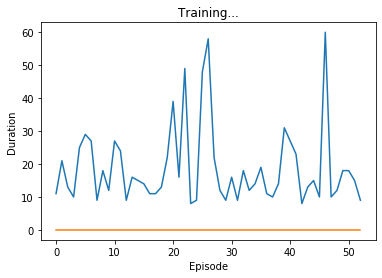

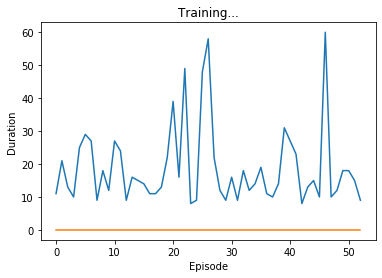

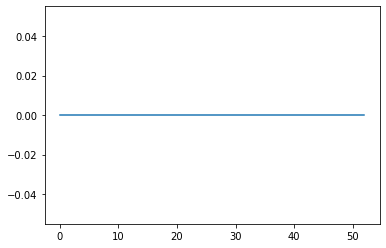

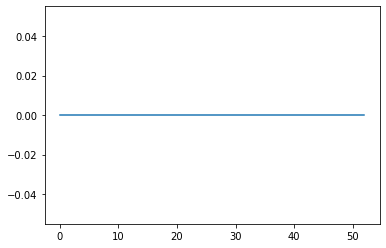

Episode 53 
 100 episode moving avg: 0.0
Episode 53 
 100 episode moving avg: 0.0


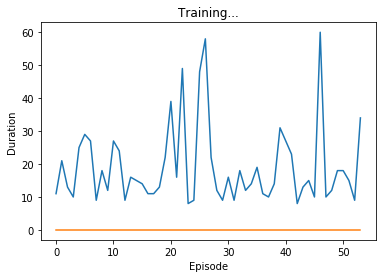

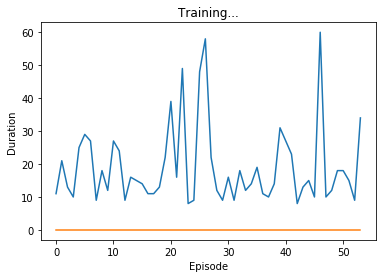

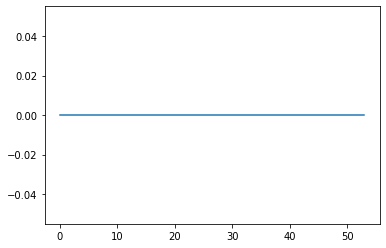

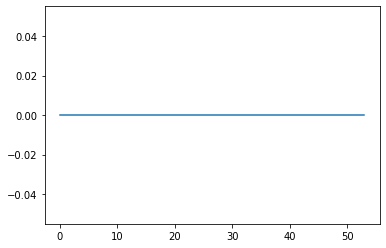

Episode 54 
 100 episode moving avg: 0.0
Episode 54 
 100 episode moving avg: 0.0


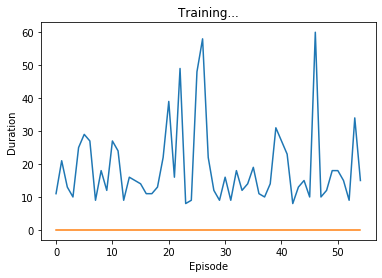

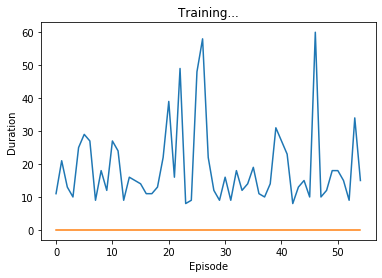

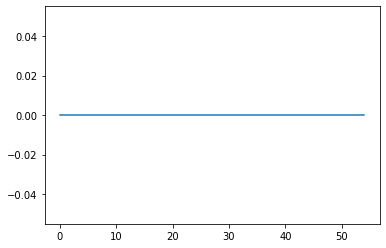

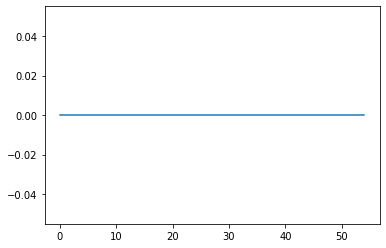

Episode 55 
 100 episode moving avg: 0.0
Episode 55 
 100 episode moving avg: 0.0


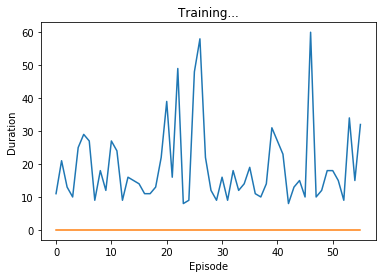

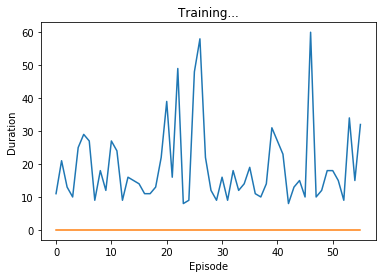

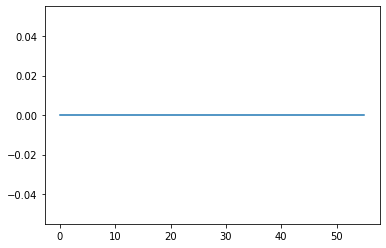

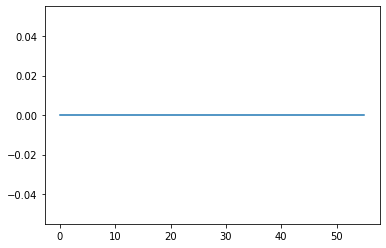

Episode 56 
 100 episode moving avg: 0.0
Episode 56 
 100 episode moving avg: 0.0


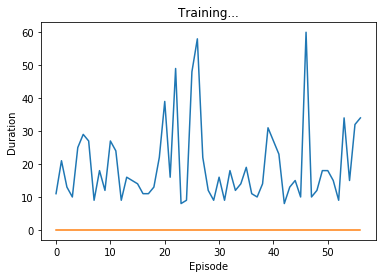

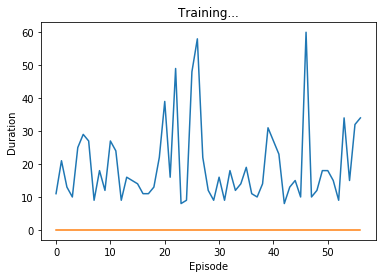

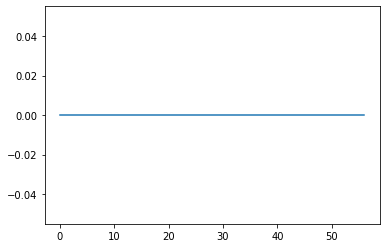

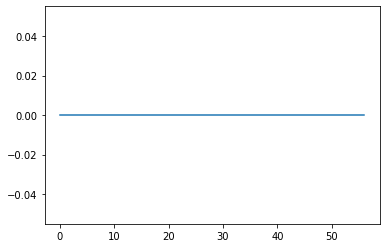

Episode 57 
 100 episode moving avg: 0.0
Episode 57 
 100 episode moving avg: 0.0


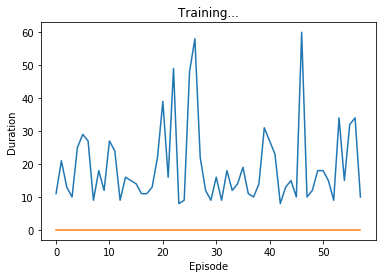

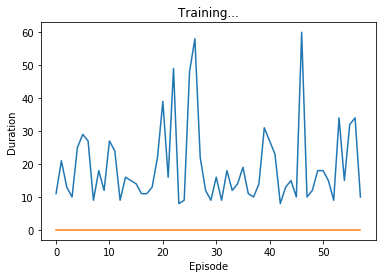

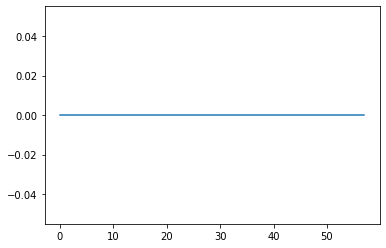

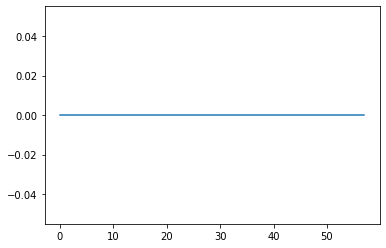

Episode 58 
 100 episode moving avg: 0.0
Episode 58 
 100 episode moving avg: 0.0


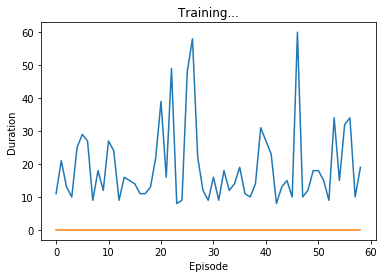

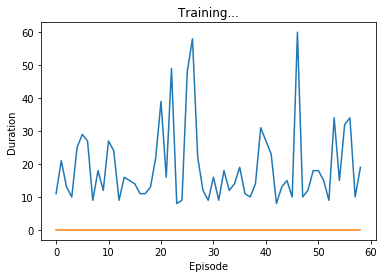

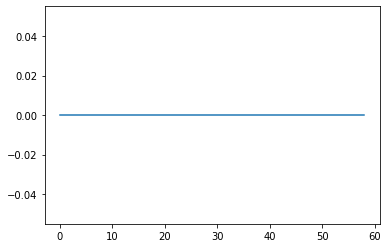

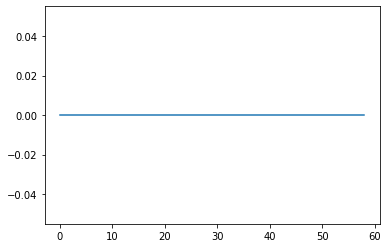

Episode 59 
 100 episode moving avg: 0.0
Episode 59 
 100 episode moving avg: 0.0


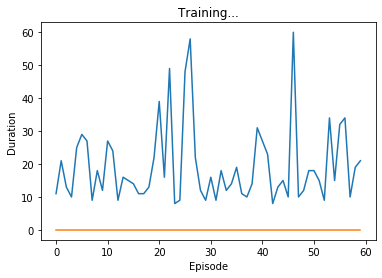

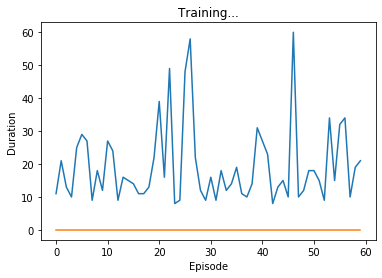

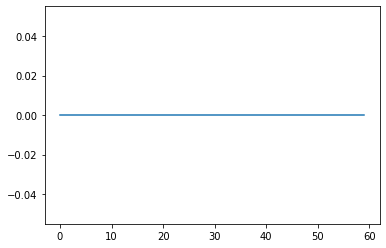

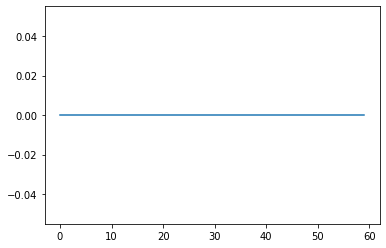

Episode 60 
 100 episode moving avg: 0.0
Episode 60 
 100 episode moving avg: 0.0


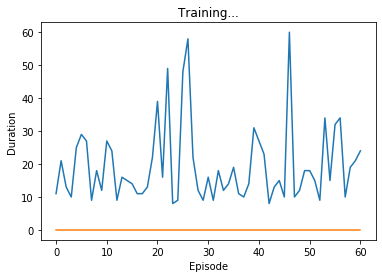

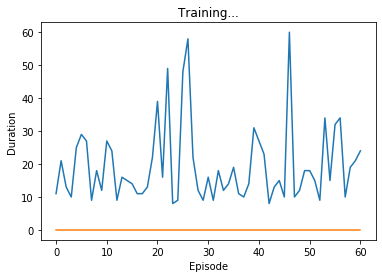

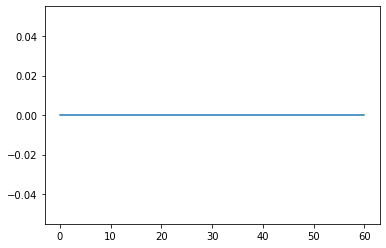

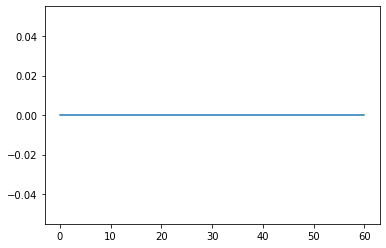

Episode 61 
 100 episode moving avg: 0.0
Episode 61 
 100 episode moving avg: 0.0


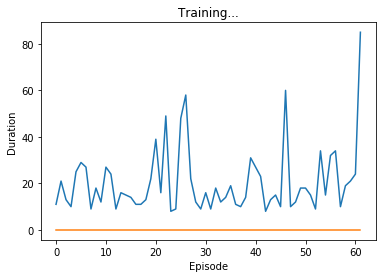

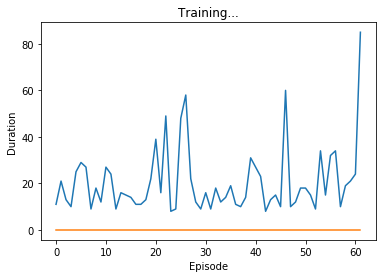

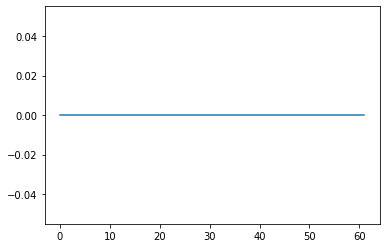

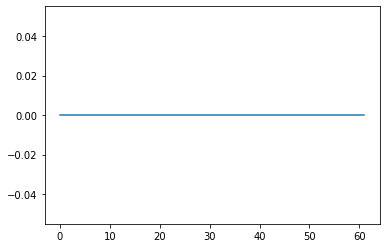

Episode 62 
 100 episode moving avg: 0.0
Episode 62 
 100 episode moving avg: 0.0


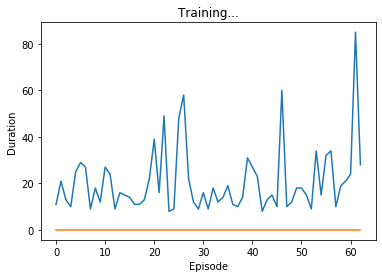

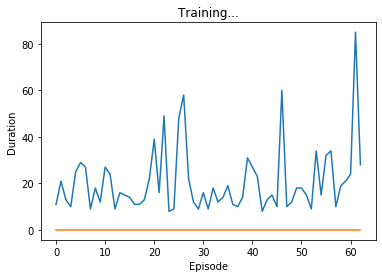

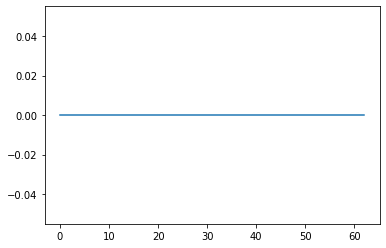

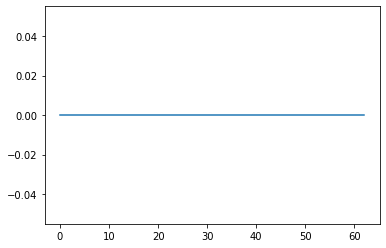

Episode 63 
 100 episode moving avg: 0.0
Episode 63 
 100 episode moving avg: 0.0


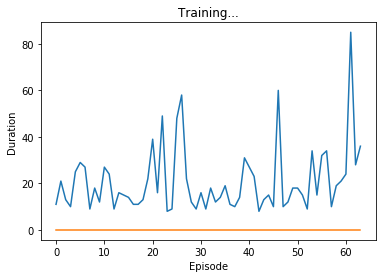

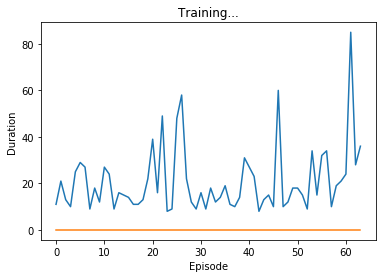

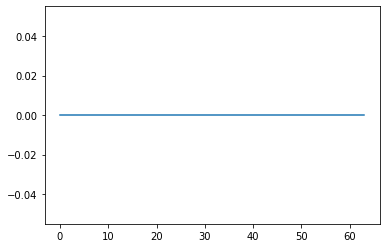

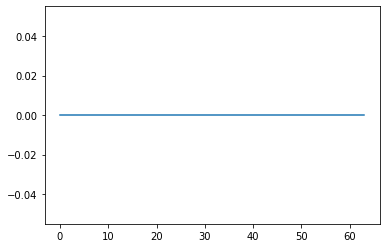

Episode 64 
 100 episode moving avg: 0.0
Episode 64 
 100 episode moving avg: 0.0


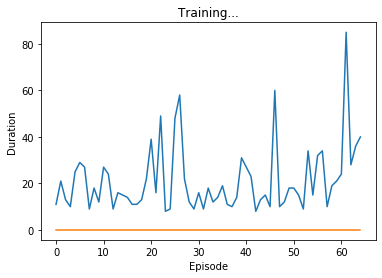

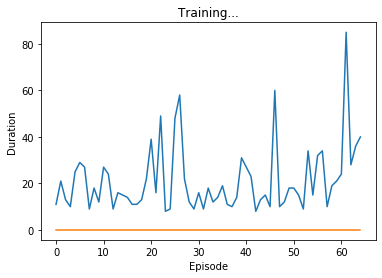

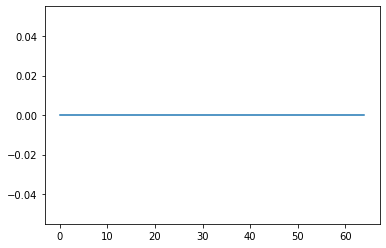

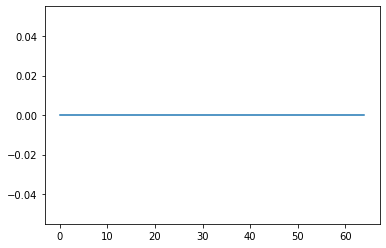

Episode 65 
 100 episode moving avg: 0.0
Episode 65 
 100 episode moving avg: 0.0


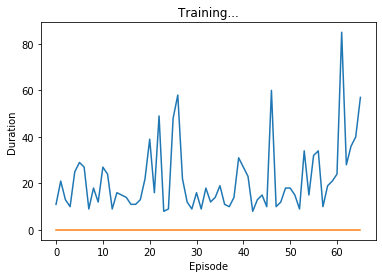

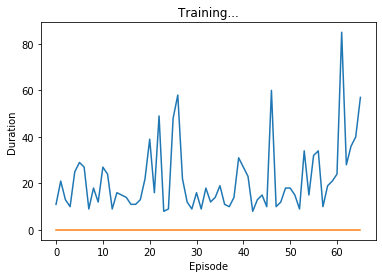

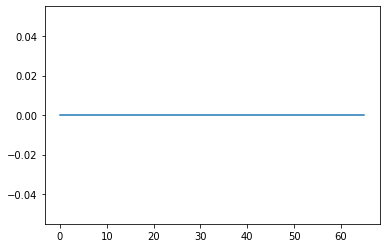

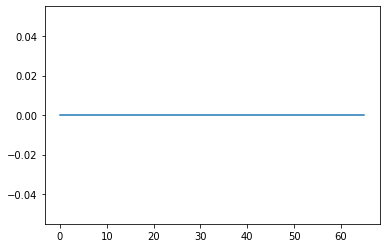

Episode 66 
 100 episode moving avg: 0.0
Episode 66 
 100 episode moving avg: 0.0


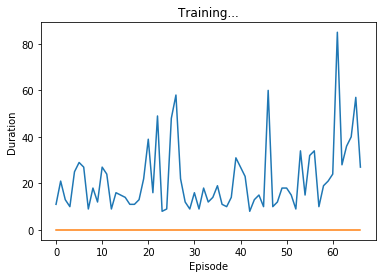

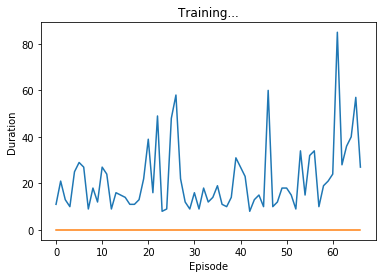

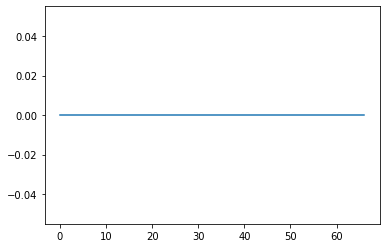

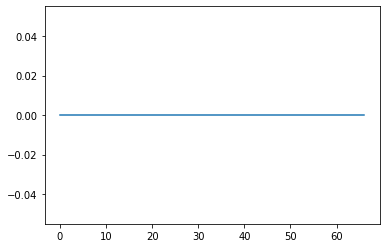

Episode 67 
 100 episode moving avg: 0.0
Episode 67 
 100 episode moving avg: 0.0


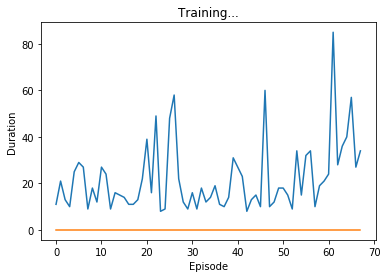

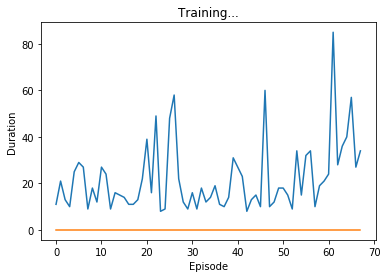

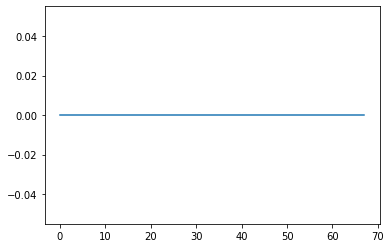

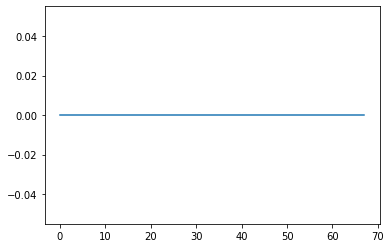

Episode 68 
 100 episode moving avg: 0.0
Episode 68 
 100 episode moving avg: 0.0


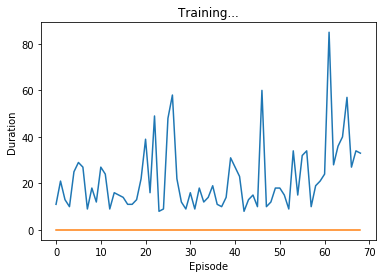

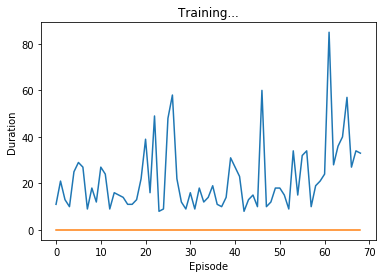

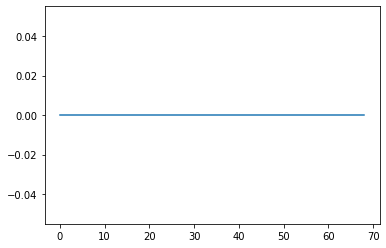

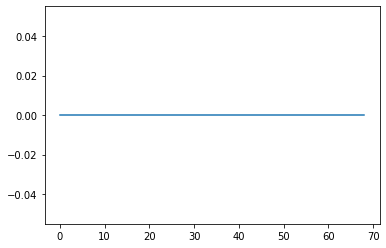

Episode 69 
 100 episode moving avg: 0.0
Episode 69 
 100 episode moving avg: 0.0


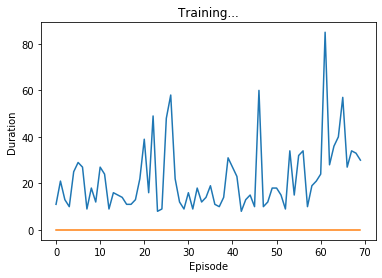

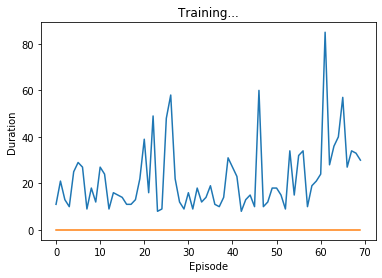

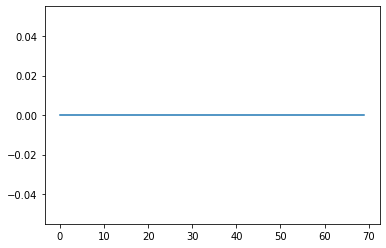

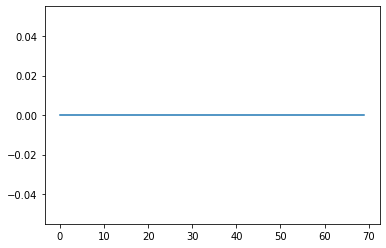

Episode 70 
 100 episode moving avg: 0.0
Episode 70 
 100 episode moving avg: 0.0


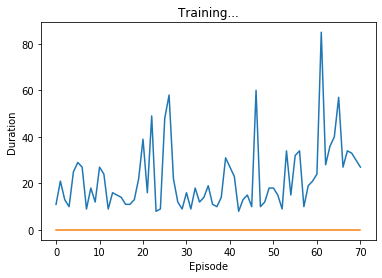

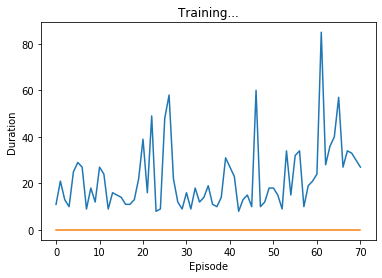

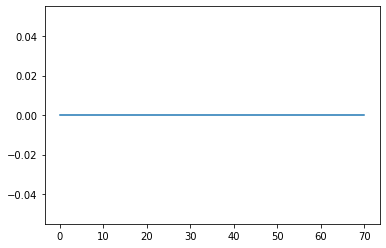

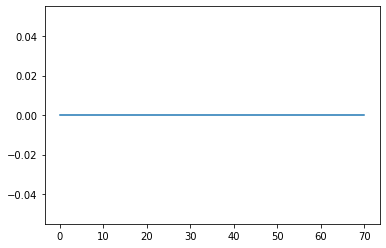

Episode 71 
 100 episode moving avg: 0.0
Episode 71 
 100 episode moving avg: 0.0


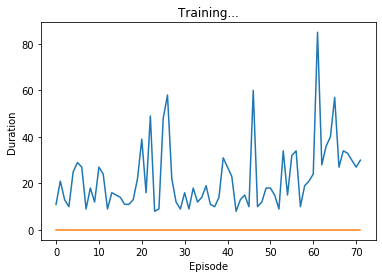

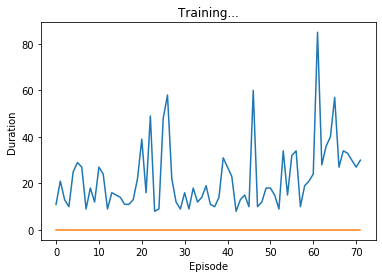

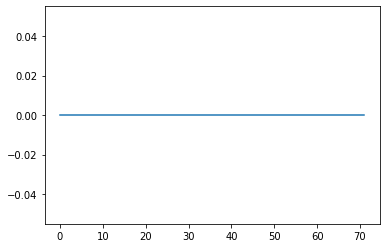

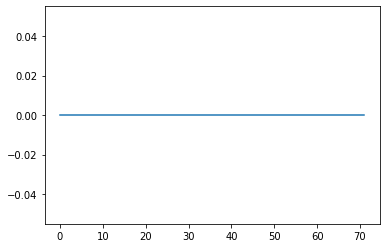

Episode 72 
 100 episode moving avg: 0.0
Episode 72 
 100 episode moving avg: 0.0


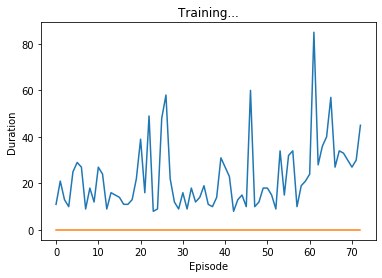

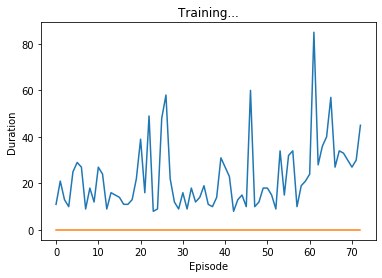

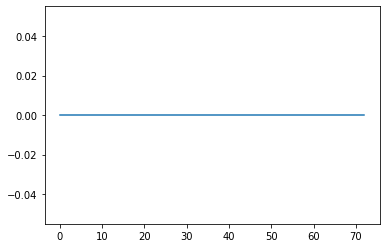

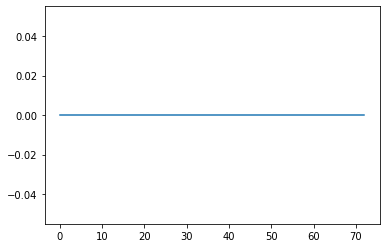

Episode 73 
 100 episode moving avg: 0.0
Episode 73 
 100 episode moving avg: 0.0


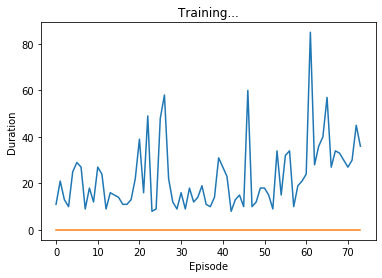

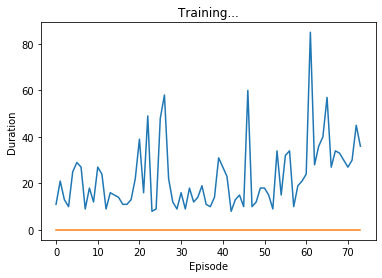

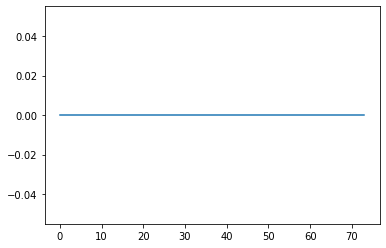

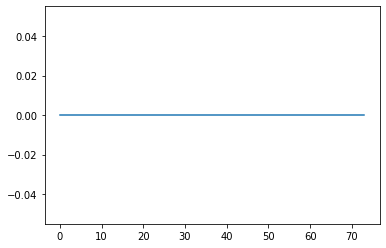

Episode 74 
 100 episode moving avg: 0.0
Episode 74 
 100 episode moving avg: 0.0


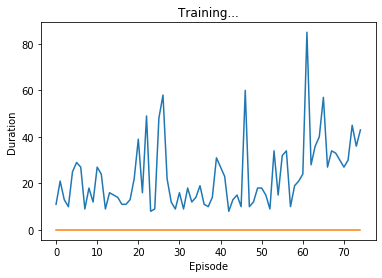

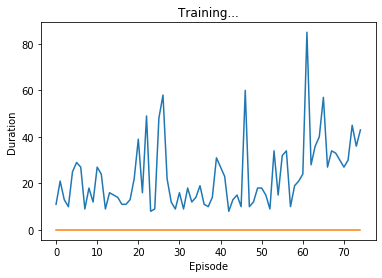

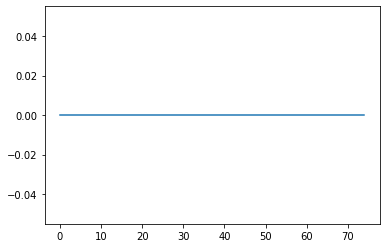

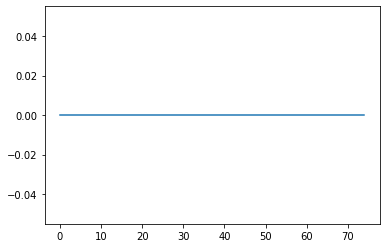

Episode 75 
 100 episode moving avg: 0.0
Episode 75 
 100 episode moving avg: 0.0


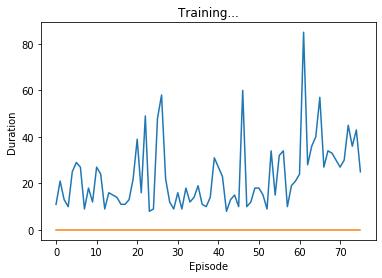

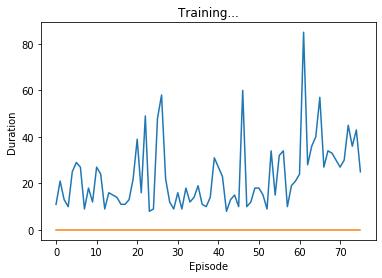

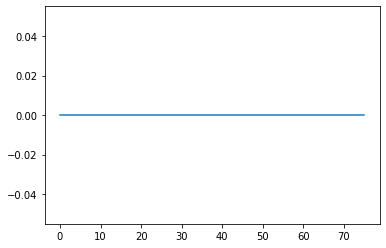

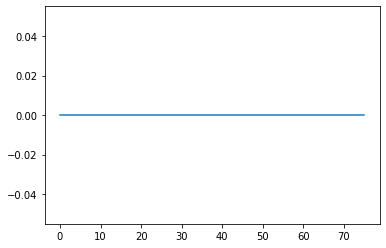

Episode 76 
 100 episode moving avg: 0.0
Episode 76 
 100 episode moving avg: 0.0


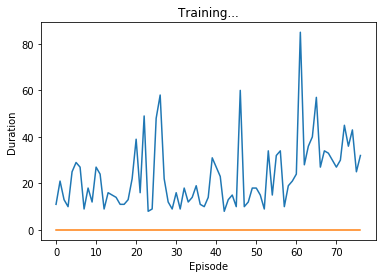

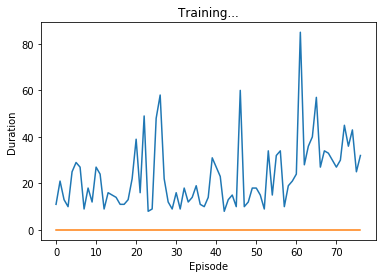

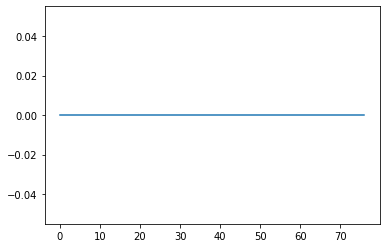

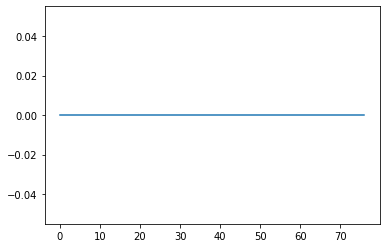

Episode 77 
 100 episode moving avg: 0.0
Episode 77 
 100 episode moving avg: 0.0


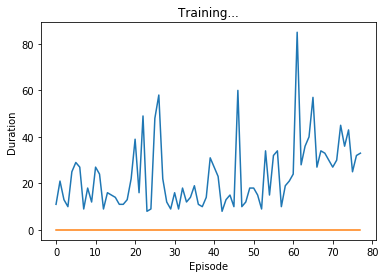

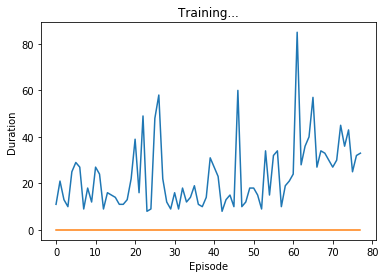

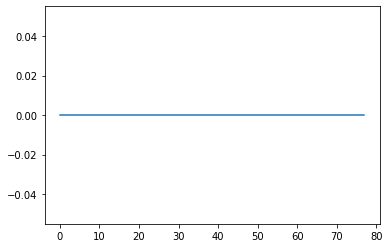

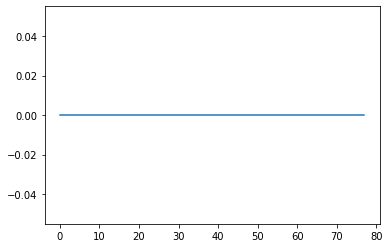

Episode 78 
 100 episode moving avg: 0.0
Episode 78 
 100 episode moving avg: 0.0


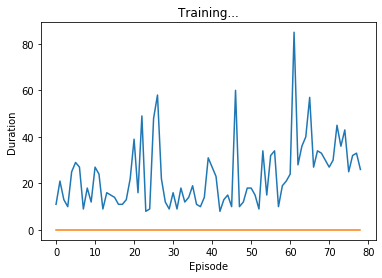

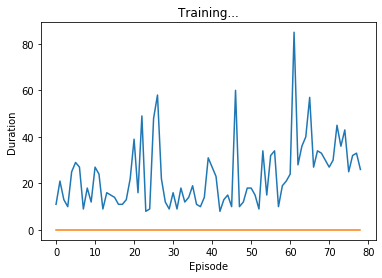

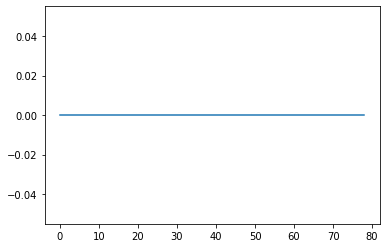

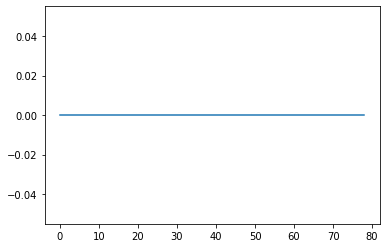

Episode 79 
 100 episode moving avg: 0.0
Episode 79 
 100 episode moving avg: 0.0


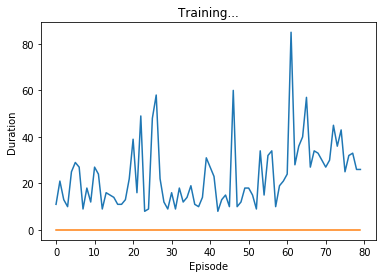

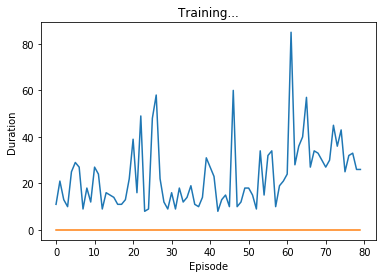

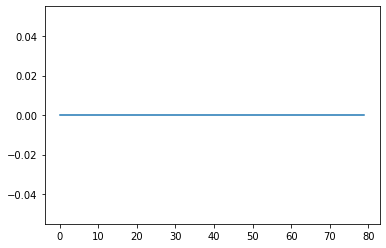

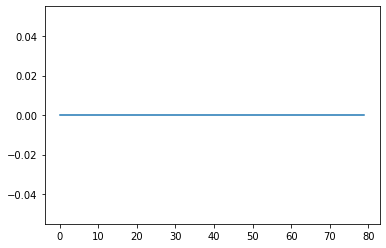

Episode 80 
 100 episode moving avg: 0.0
Episode 80 
 100 episode moving avg: 0.0


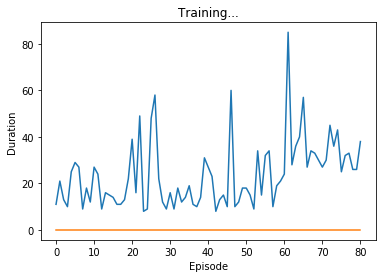

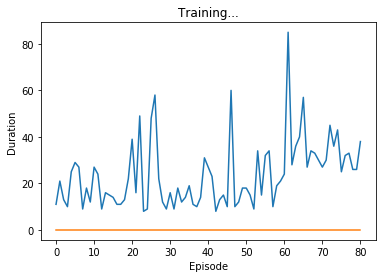

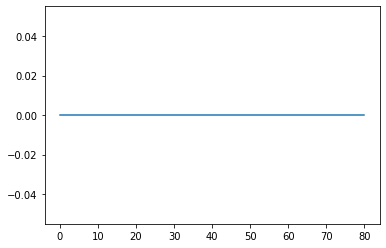

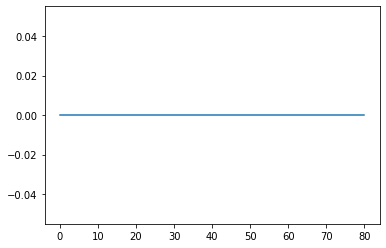

Episode 81 
 100 episode moving avg: 0.0
Episode 81 
 100 episode moving avg: 0.0


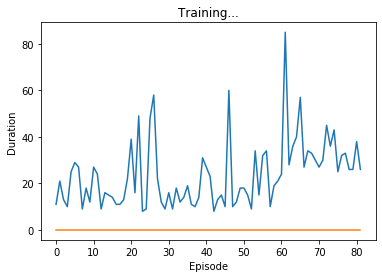

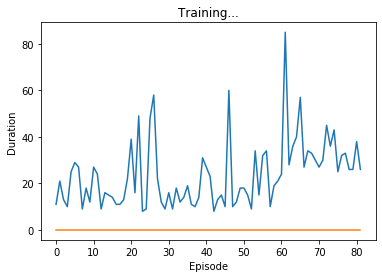

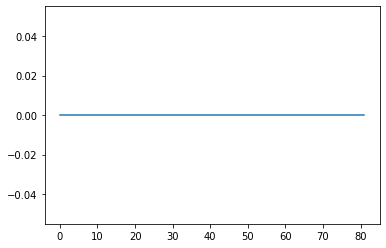

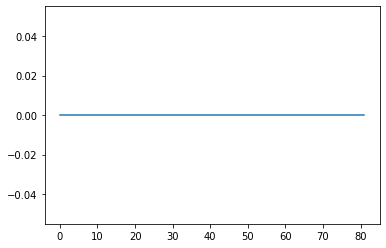

Episode 82 
 100 episode moving avg: 0.0
Episode 82 
 100 episode moving avg: 0.0


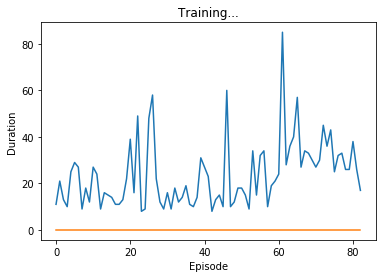

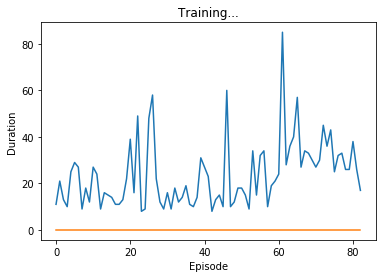

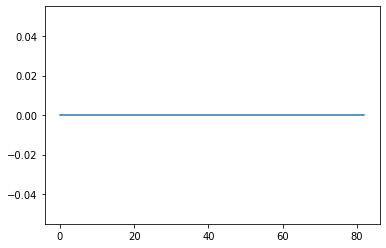

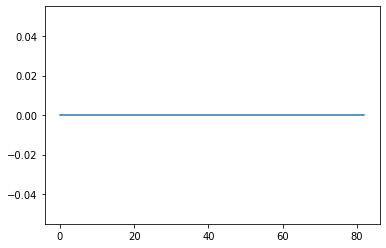

Episode 83 
 100 episode moving avg: 0.0
Episode 83 
 100 episode moving avg: 0.0


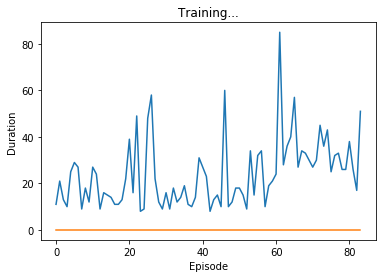

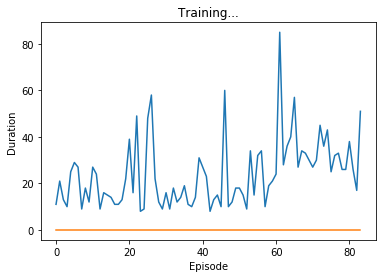

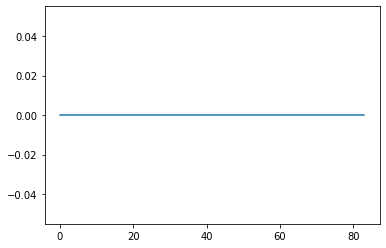

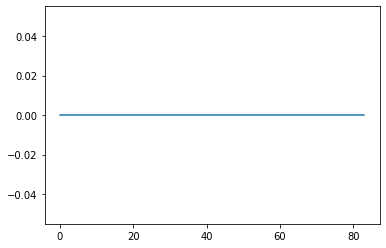

Episode 84 
 100 episode moving avg: 0.0
Episode 84 
 100 episode moving avg: 0.0


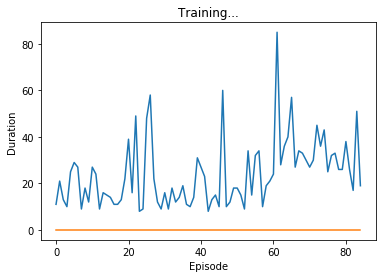

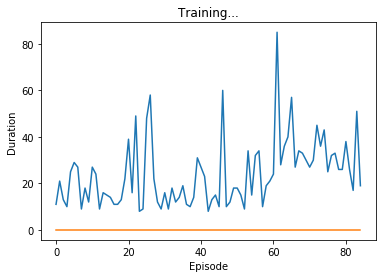

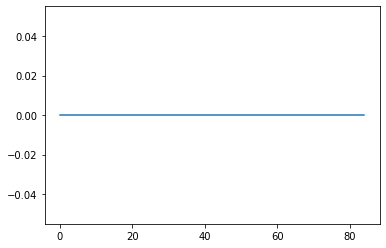

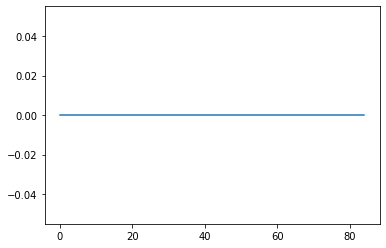

Episode 85 
 100 episode moving avg: 0.0
Episode 85 
 100 episode moving avg: 0.0


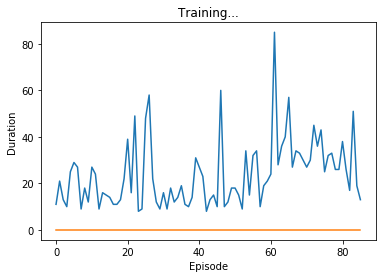

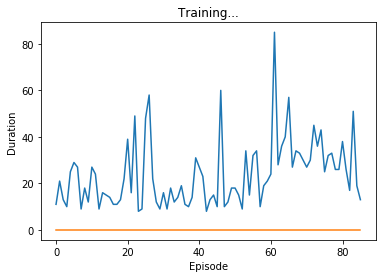

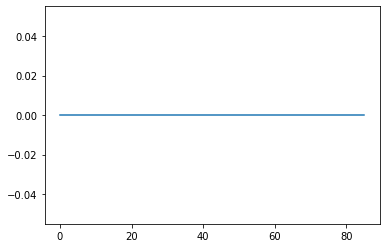

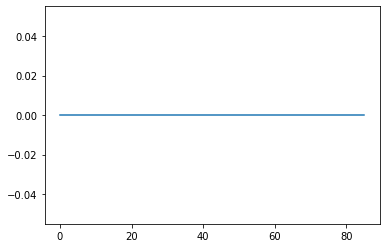

Episode 86 
 100 episode moving avg: 0.0
Episode 86 
 100 episode moving avg: 0.0


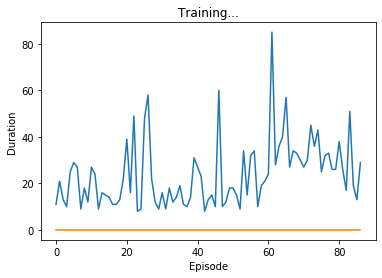

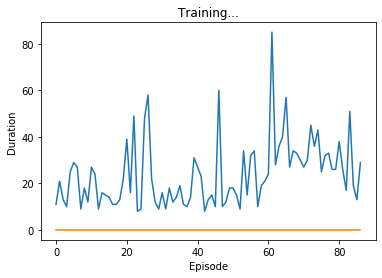

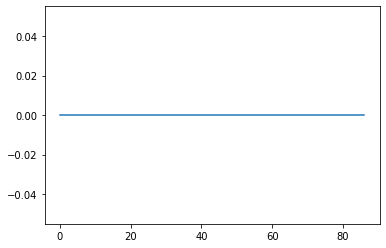

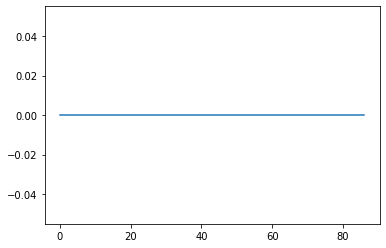

Episode 87 
 100 episode moving avg: 0.0
Episode 87 
 100 episode moving avg: 0.0


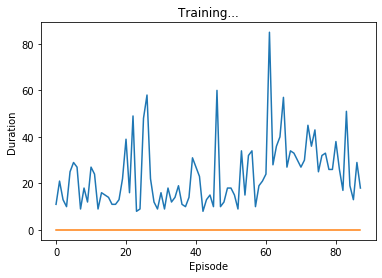

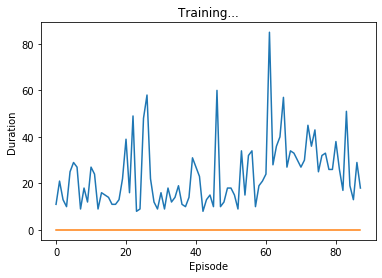

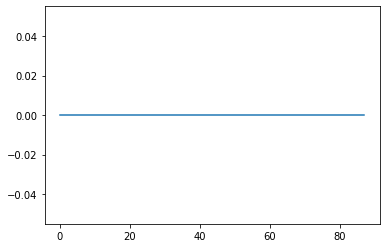

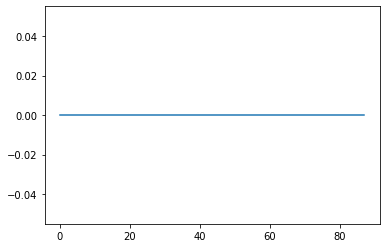

Episode 88 
 100 episode moving avg: 0.0
Episode 88 
 100 episode moving avg: 0.0


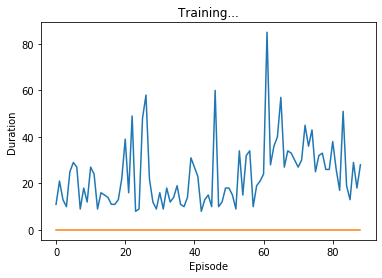

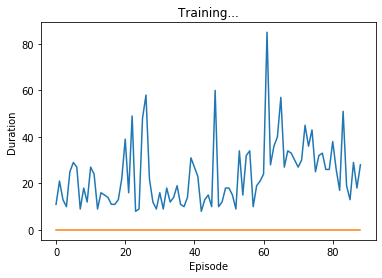

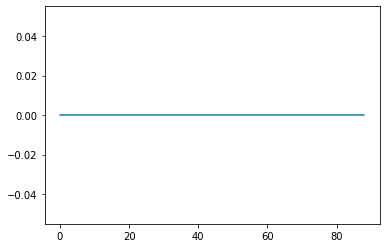

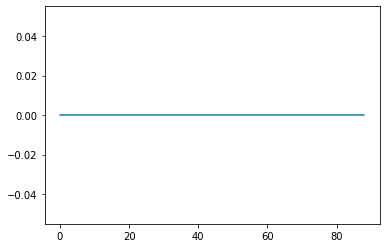

Episode 89 
 100 episode moving avg: 0.0
Episode 89 
 100 episode moving avg: 0.0


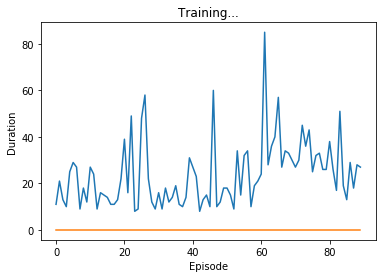

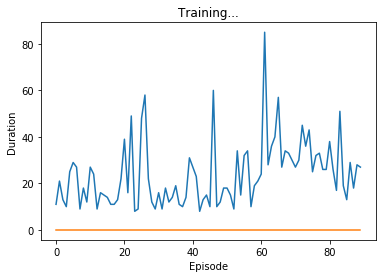

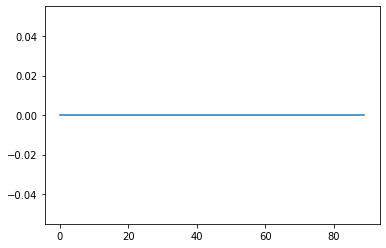

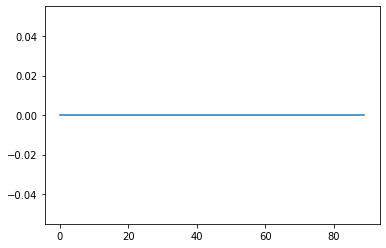

Episode 90 
 100 episode moving avg: 0.0
Episode 90 
 100 episode moving avg: 0.0


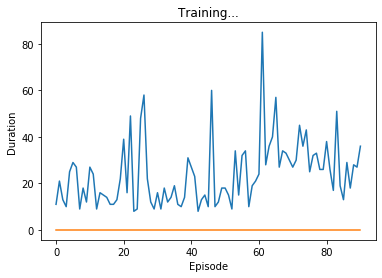

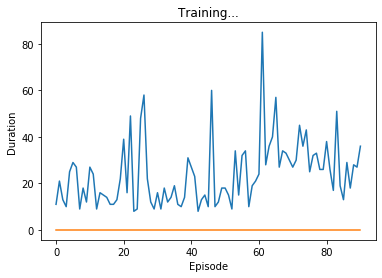

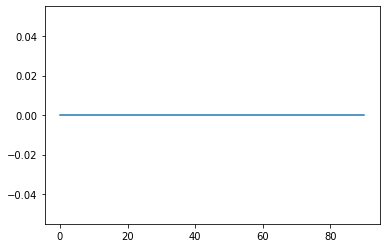

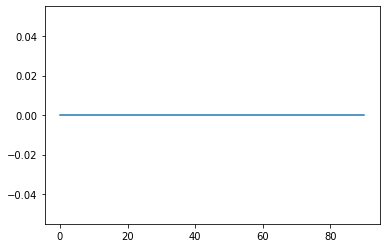

Episode 91 
 100 episode moving avg: 0.0
Episode 91 
 100 episode moving avg: 0.0


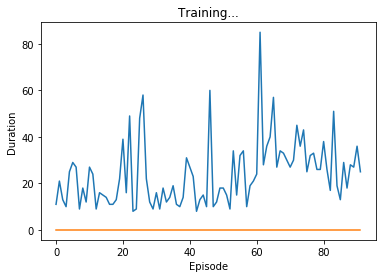

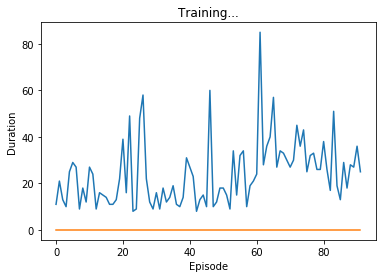

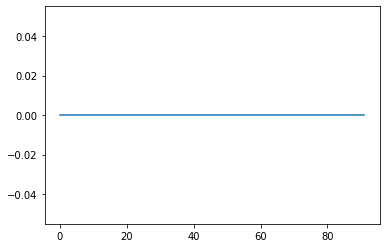

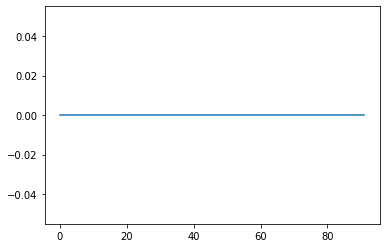

Episode 92 
 100 episode moving avg: 0.0
Episode 92 
 100 episode moving avg: 0.0


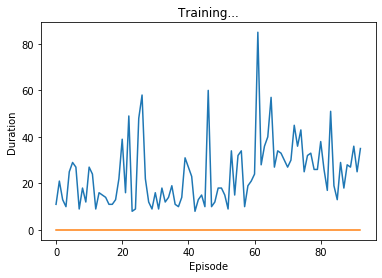

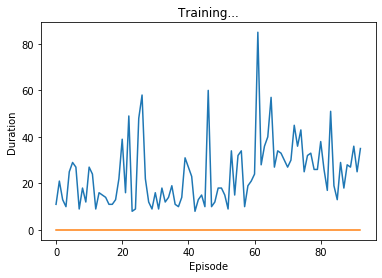

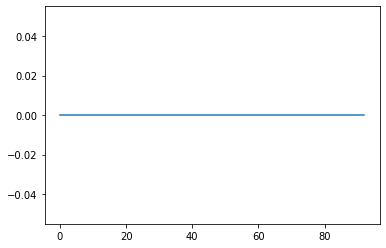

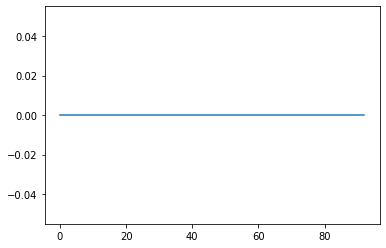

Episode 93 
 100 episode moving avg: 0.0
Episode 93 
 100 episode moving avg: 0.0


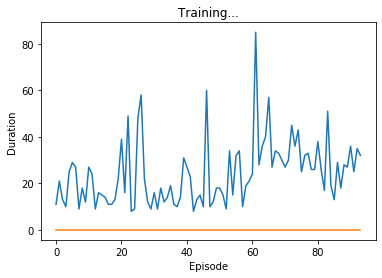

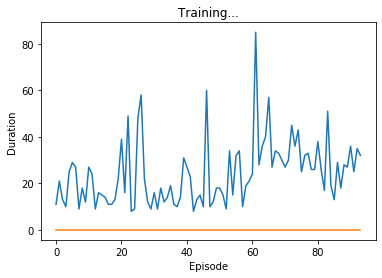

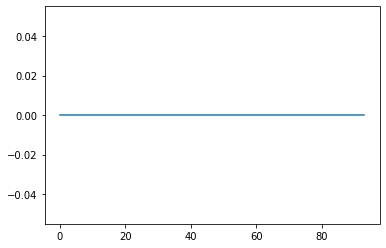

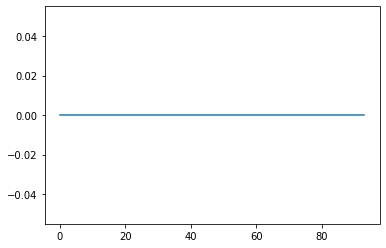

Episode 94 
 100 episode moving avg: 0.0
Episode 94 
 100 episode moving avg: 0.0


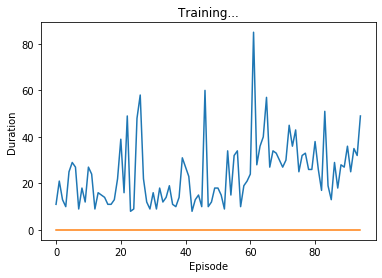

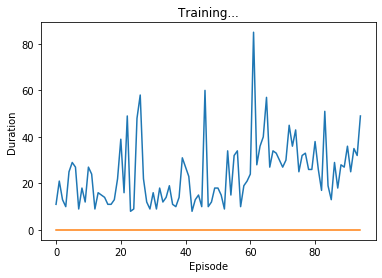

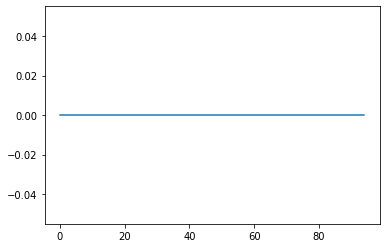

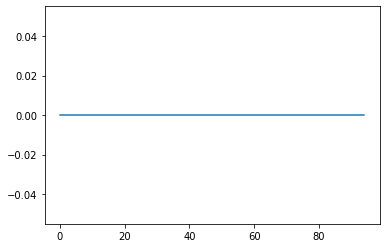

Episode 95 
 100 episode moving avg: 0.0
Episode 95 
 100 episode moving avg: 0.0


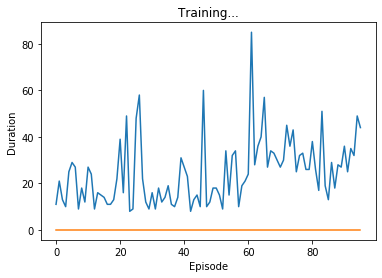

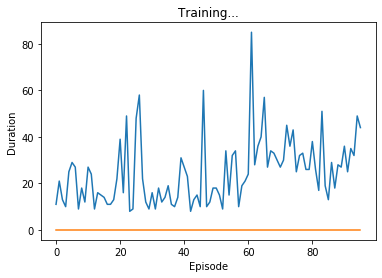

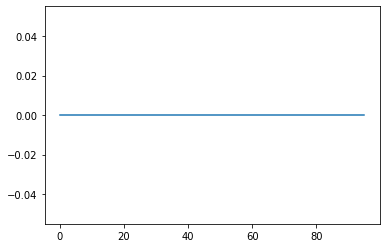

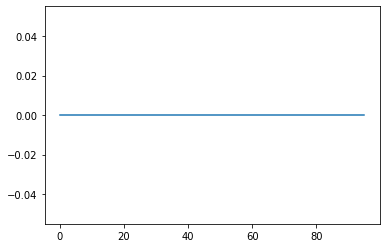

Episode 96 
 100 episode moving avg: 0.0
Episode 96 
 100 episode moving avg: 0.0


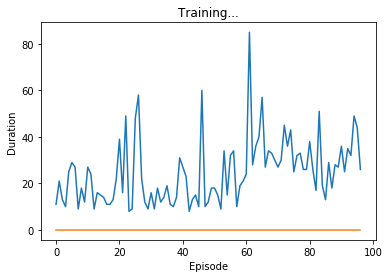

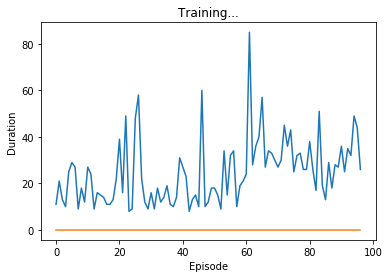

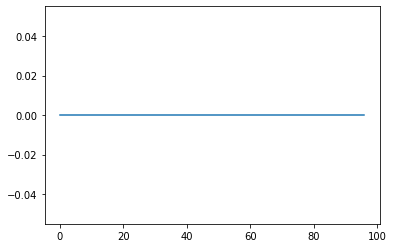

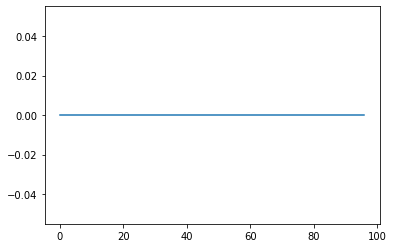

Episode 97 
 100 episode moving avg: 0.0
Episode 97 
 100 episode moving avg: 0.0


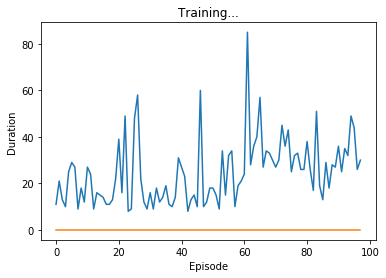

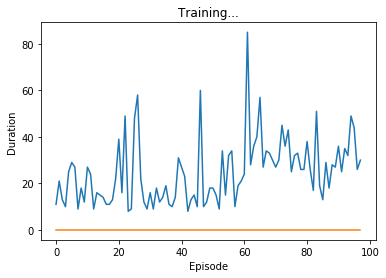

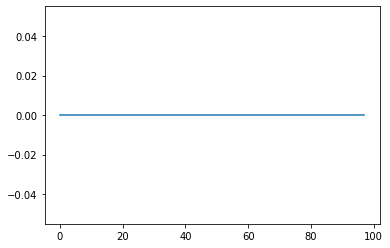

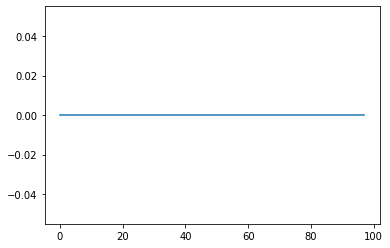

Episode 98 
 100 episode moving avg: 0.0
Episode 98 
 100 episode moving avg: 0.0


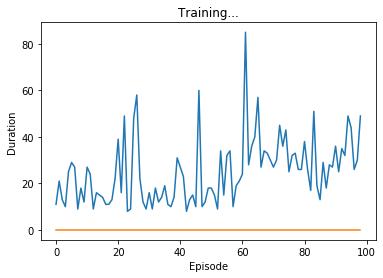

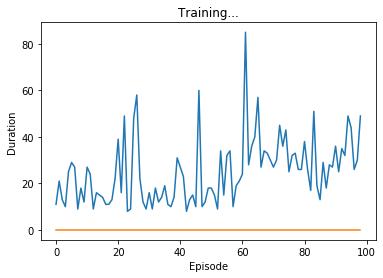

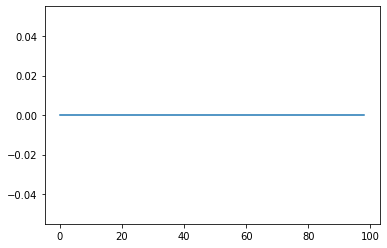

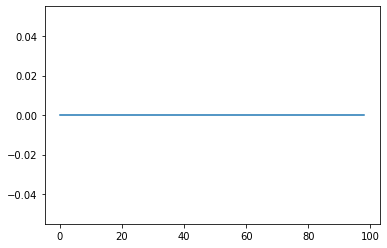

Episode 99 
 100 episode moving avg: 0.0
Episode 99 
 100 episode moving avg: 0.0


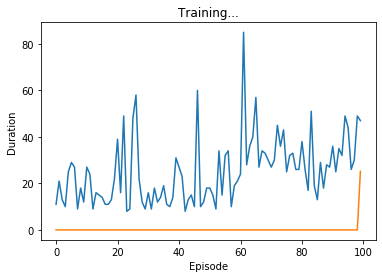

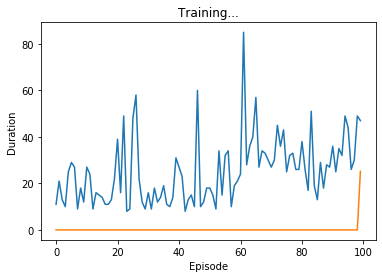

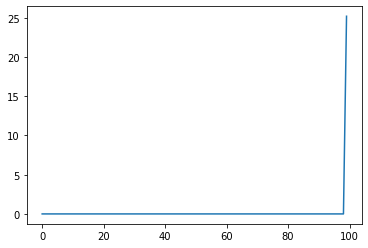

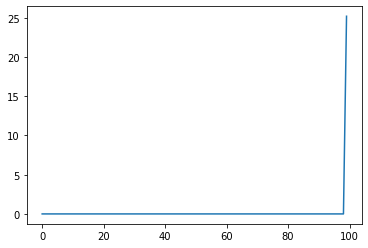

Episode 100 
 100 episode moving avg: 25.2
Episode 100 
 100 episode moving avg: 25.2


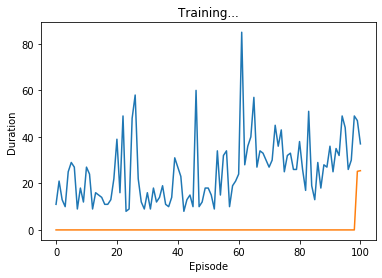

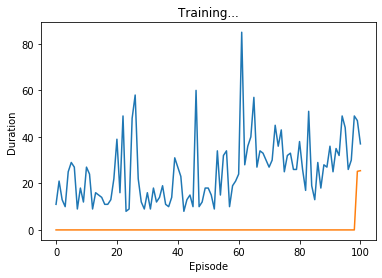

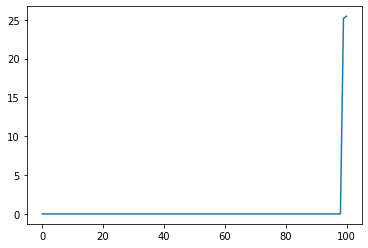

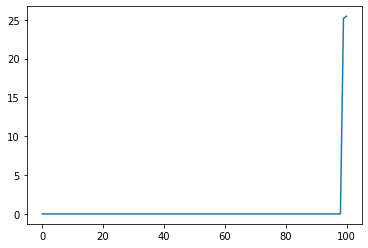

Episode 101 
 100 episode moving avg: 25.46
Episode 101 
 100 episode moving avg: 25.46


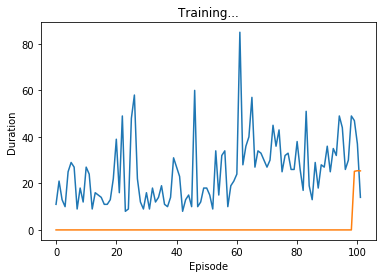

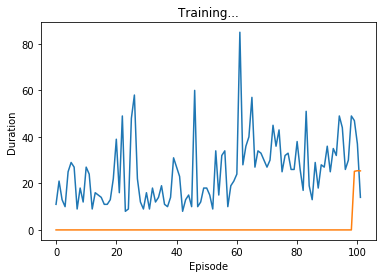

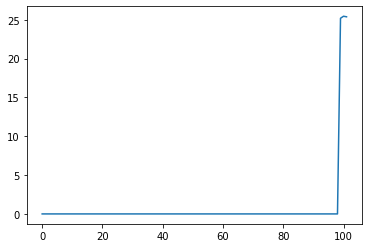

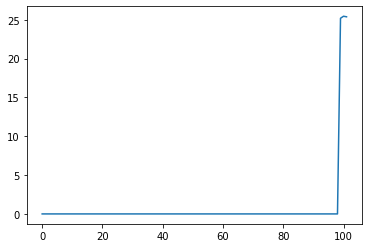

Episode 102 
 100 episode moving avg: 25.39
Episode 102 
 100 episode moving avg: 25.39


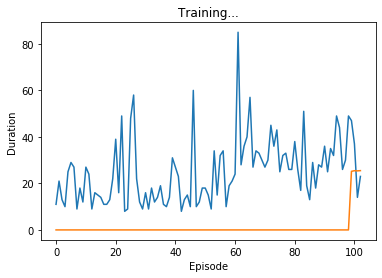

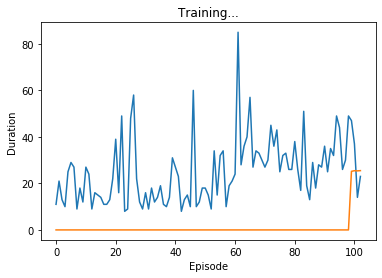

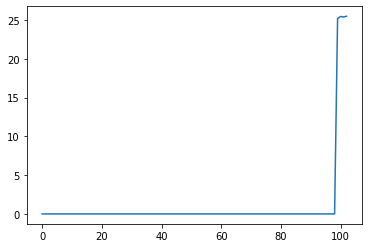

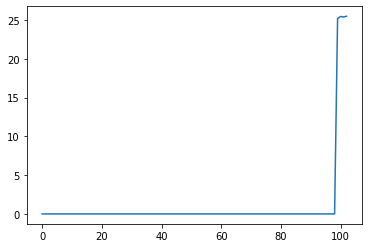

Episode 103 
 100 episode moving avg: 25.49
Episode 103 
 100 episode moving avg: 25.49


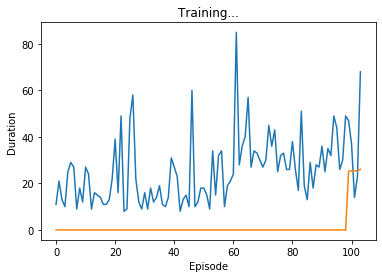

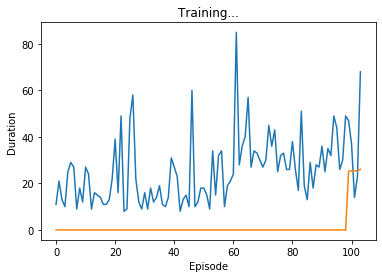

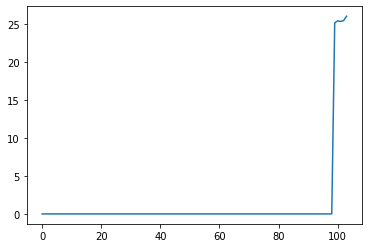

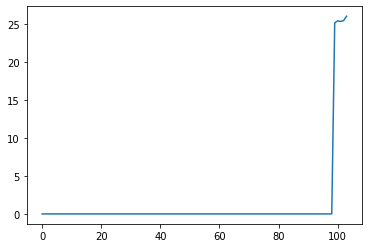

Episode 104 
 100 episode moving avg: 26.07
Episode 104 
 100 episode moving avg: 26.07


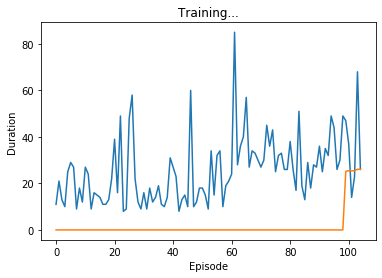

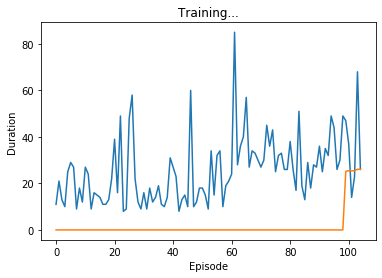

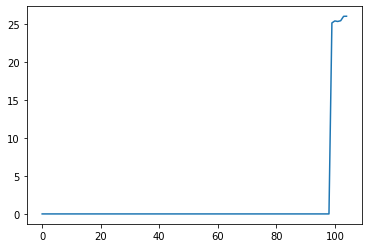

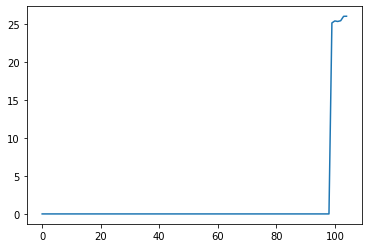

Episode 105 
 100 episode moving avg: 26.08
Episode 105 
 100 episode moving avg: 26.08


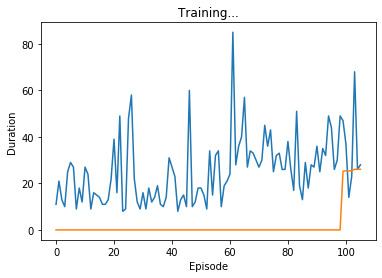

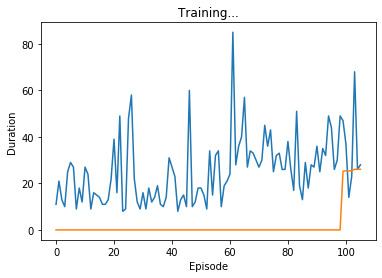

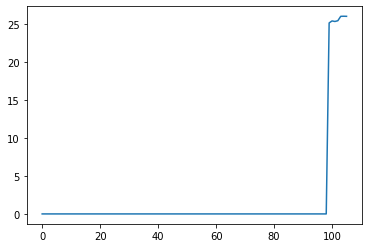

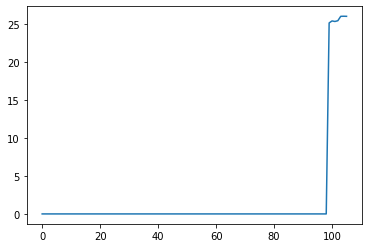

Episode 106 
 100 episode moving avg: 26.07
Episode 106 
 100 episode moving avg: 26.07


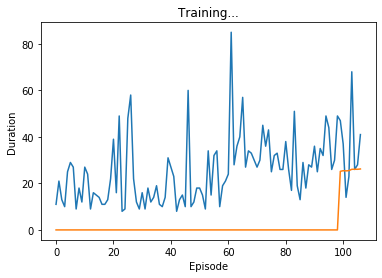

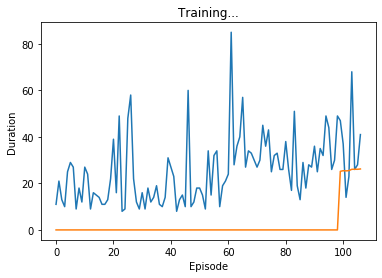

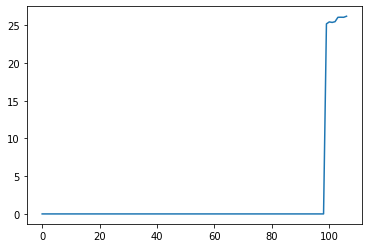

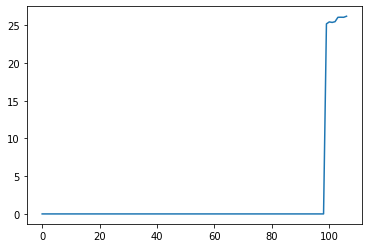

Episode 107 
 100 episode moving avg: 26.21
Episode 107 
 100 episode moving avg: 26.21


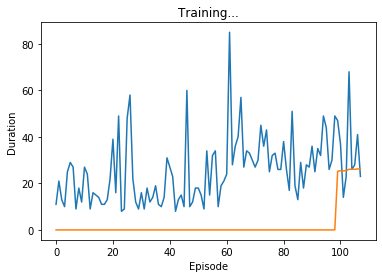

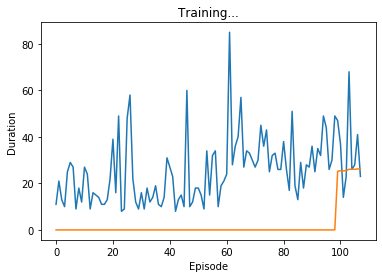

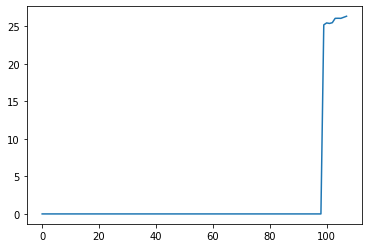

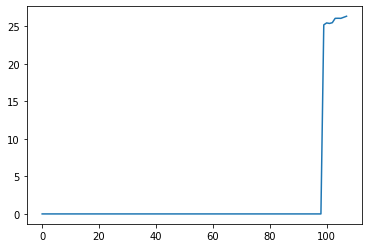

Episode 108 
 100 episode moving avg: 26.35
Episode 108 
 100 episode moving avg: 26.35


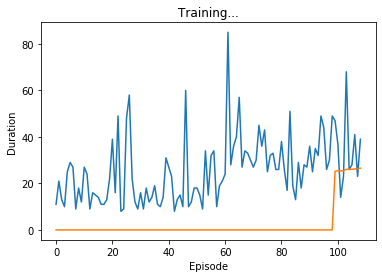

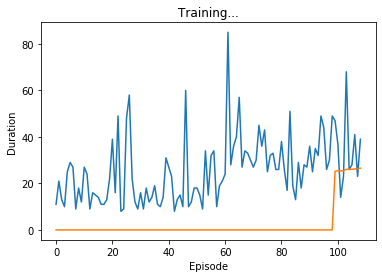

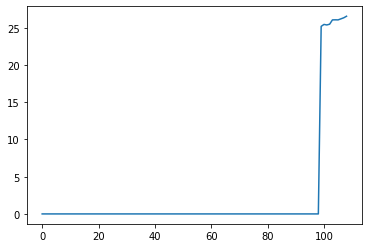

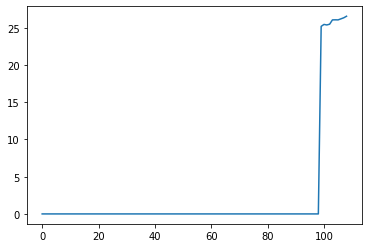

Episode 109 
 100 episode moving avg: 26.56
Episode 109 
 100 episode moving avg: 26.56


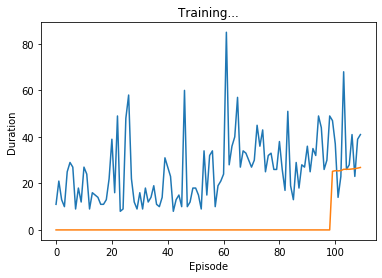

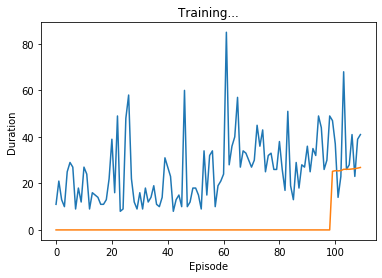

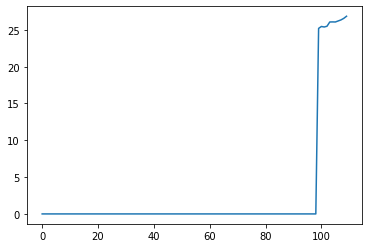

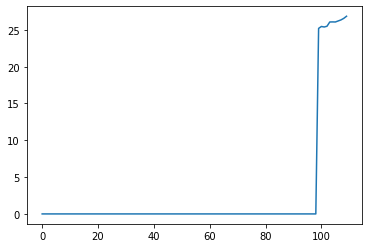

Episode 110 
 100 episode moving avg: 26.85
Episode 110 
 100 episode moving avg: 26.85


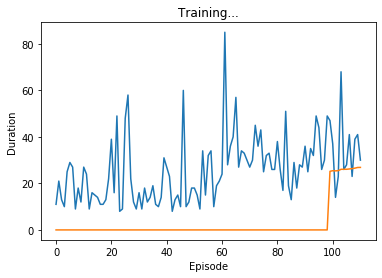

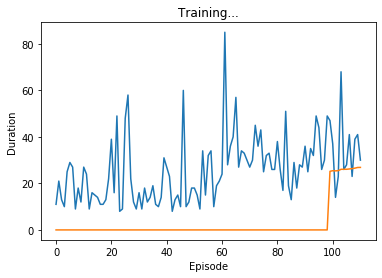

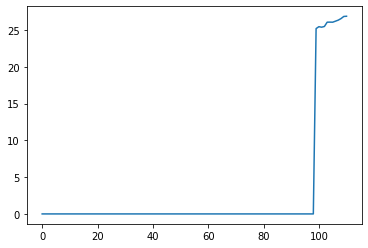

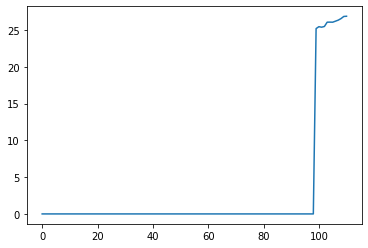

Episode 111 
 100 episode moving avg: 26.88
Episode 111 
 100 episode moving avg: 26.88


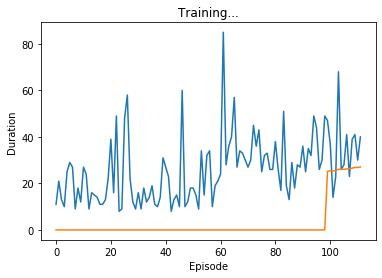

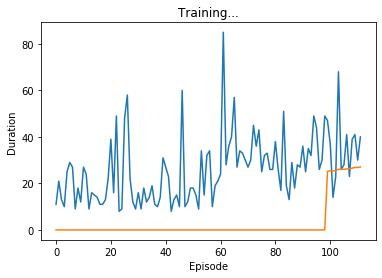

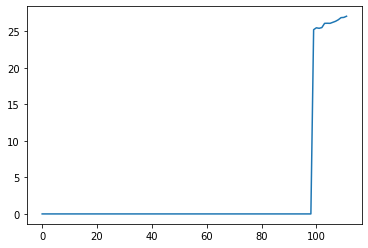

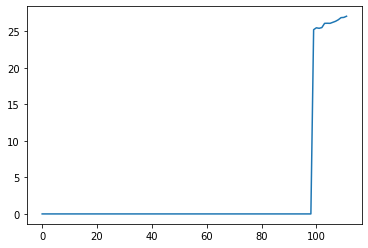

Episode 112 
 100 episode moving avg: 27.04
Episode 112 
 100 episode moving avg: 27.04


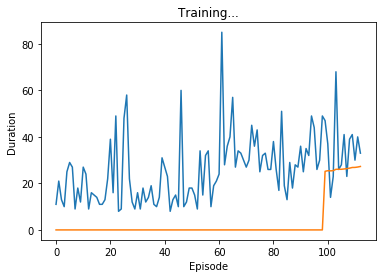

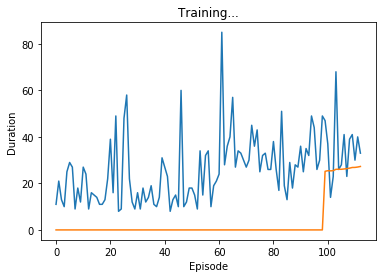

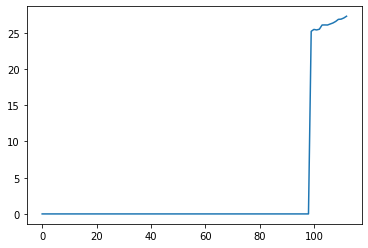

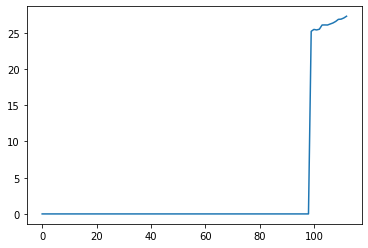

Episode 113 
 100 episode moving avg: 27.28
Episode 113 
 100 episode moving avg: 27.28


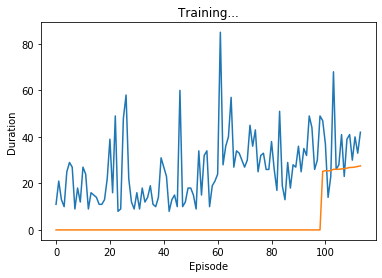

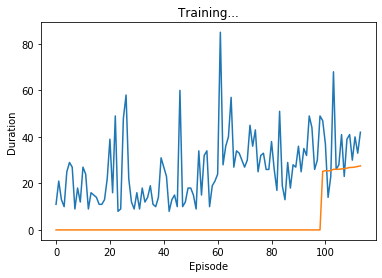

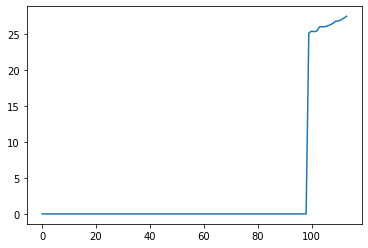

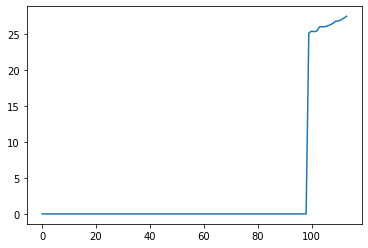

Episode 114 
 100 episode moving avg: 27.54
Episode 114 
 100 episode moving avg: 27.54


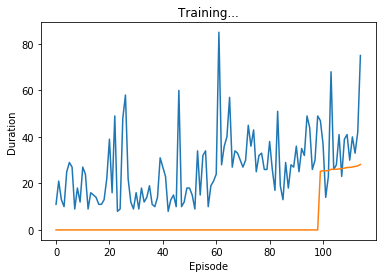

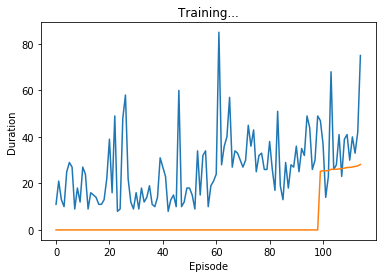

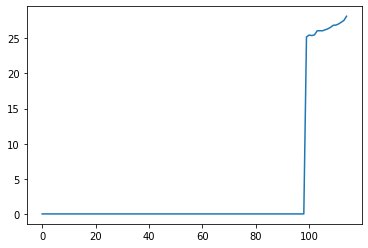

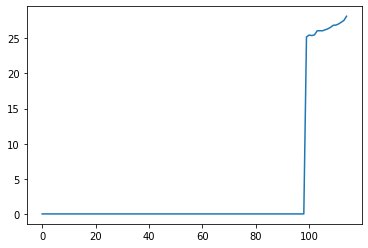

Episode 115 
 100 episode moving avg: 28.14
Episode 115 
 100 episode moving avg: 28.14


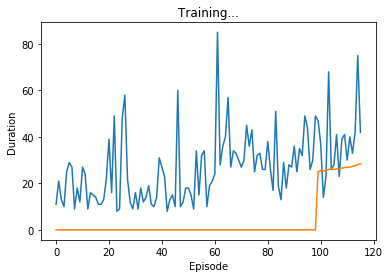

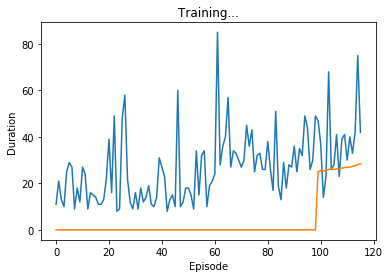

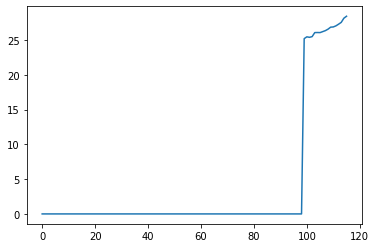

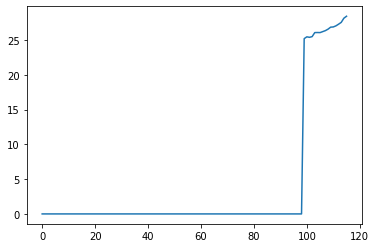

Episode 116 
 100 episode moving avg: 28.42
Episode 116 
 100 episode moving avg: 28.42


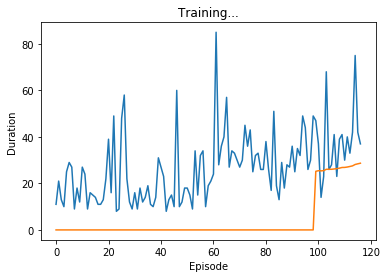

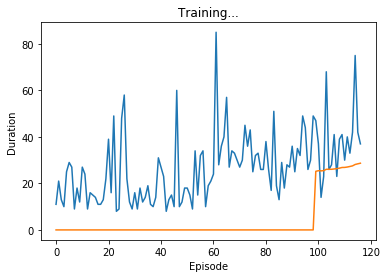

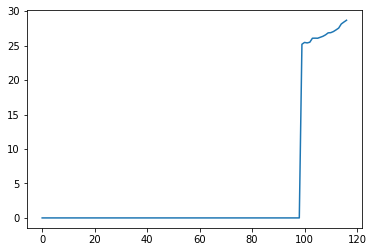

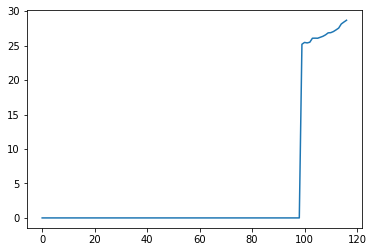

Episode 117 
 100 episode moving avg: 28.68
Episode 117 
 100 episode moving avg: 28.68


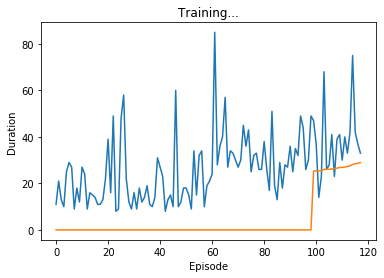

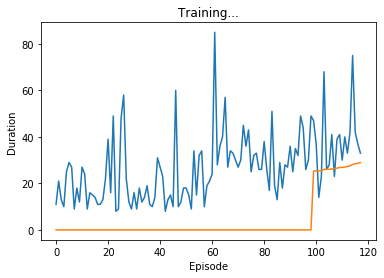

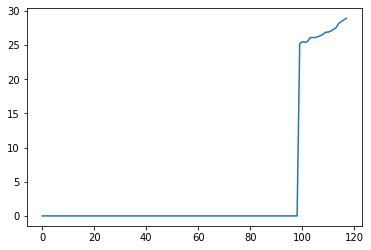

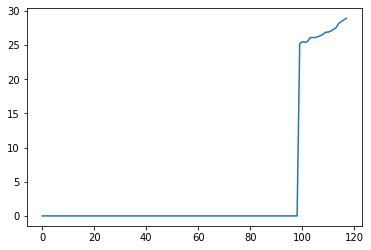

Episode 118 
 100 episode moving avg: 28.9
Episode 118 
 100 episode moving avg: 28.9


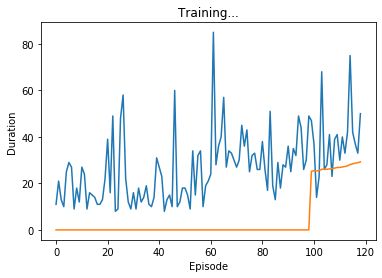

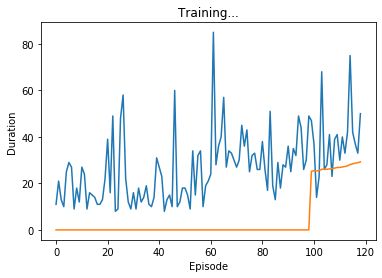

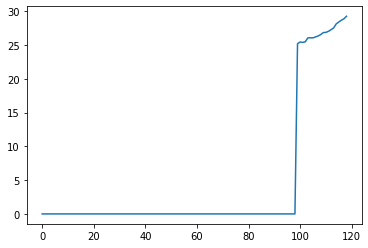

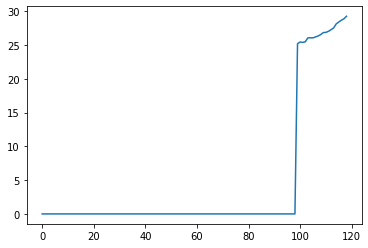

Episode 119 
 100 episode moving avg: 29.27
Episode 119 
 100 episode moving avg: 29.27


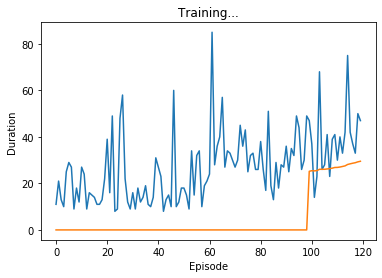

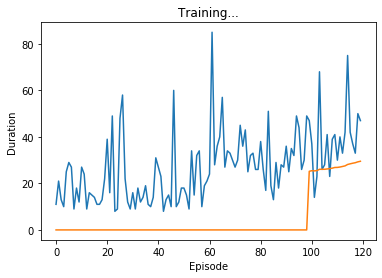

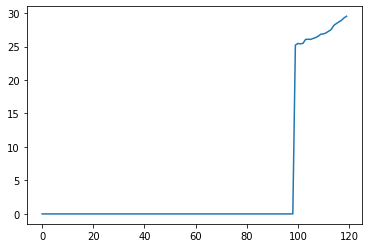

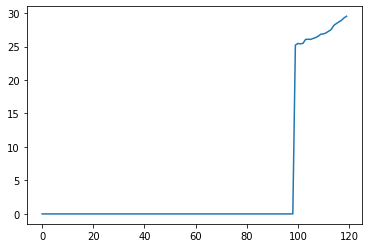

Episode 120 
 100 episode moving avg: 29.52
Episode 120 
 100 episode moving avg: 29.52


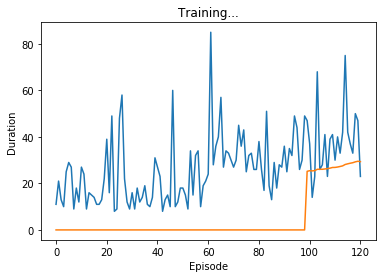

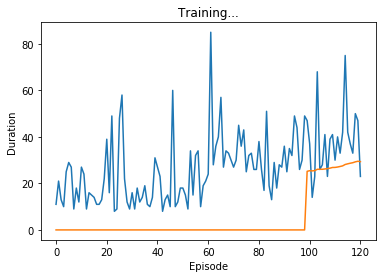

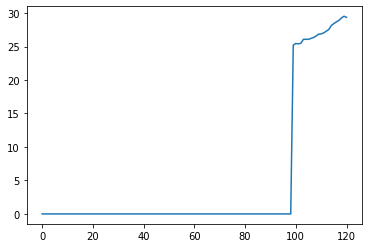

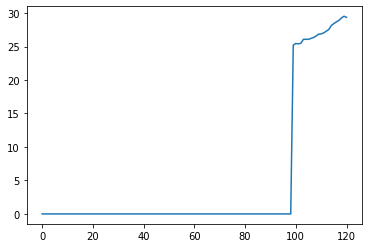

Episode 121 
 100 episode moving avg: 29.36
Episode 121 
 100 episode moving avg: 29.36


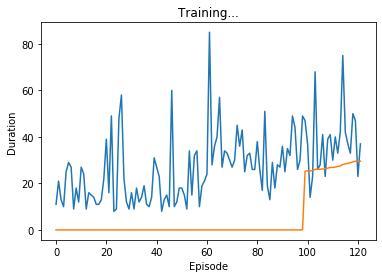

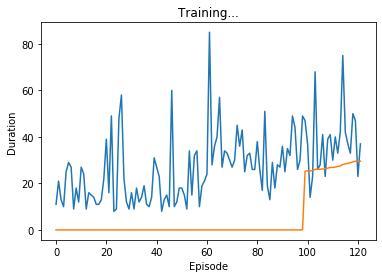

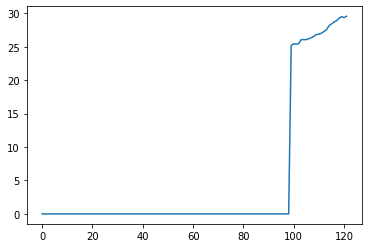

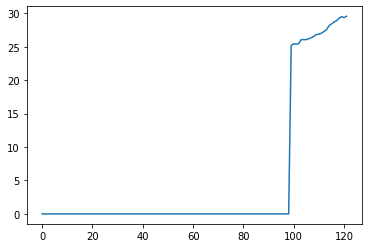

Episode 122 
 100 episode moving avg: 29.57
Episode 122 
 100 episode moving avg: 29.57


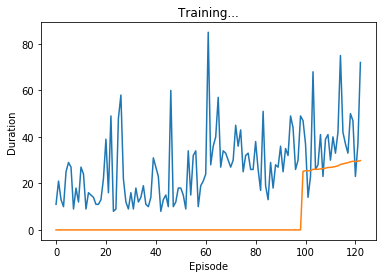

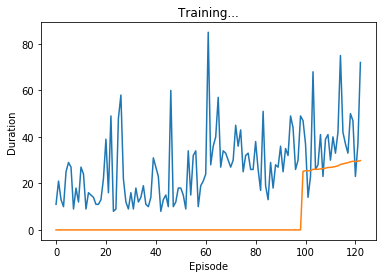

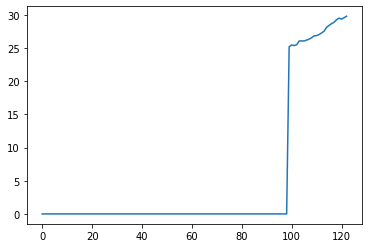

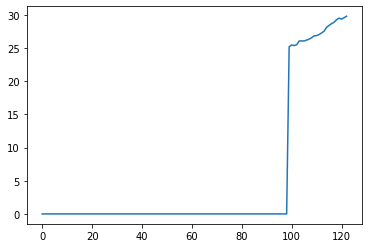

Episode 123 
 100 episode moving avg: 29.8
Episode 123 
 100 episode moving avg: 29.8


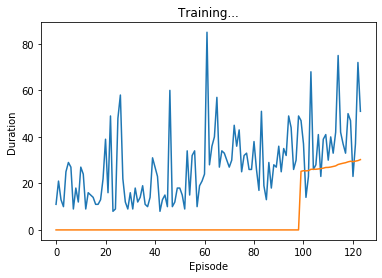

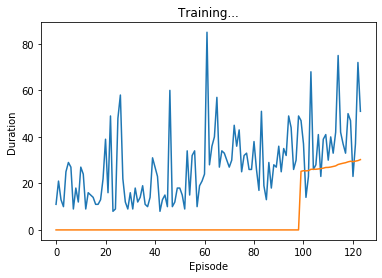

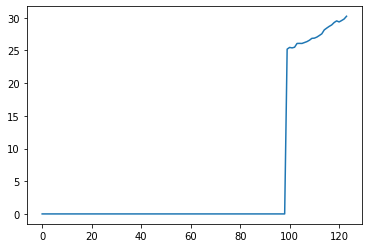

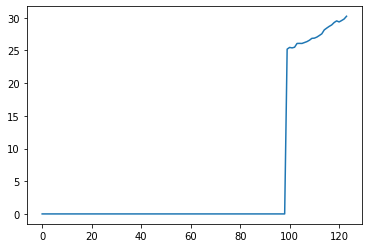

Episode 124 
 100 episode moving avg: 30.23
Episode 124 
 100 episode moving avg: 30.23


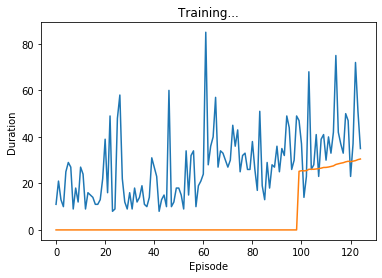

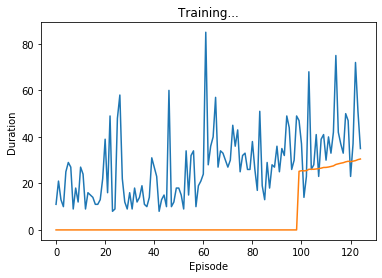

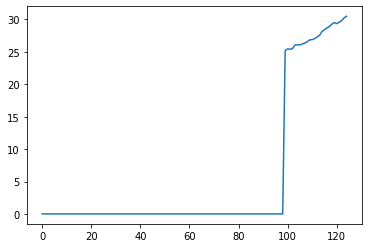

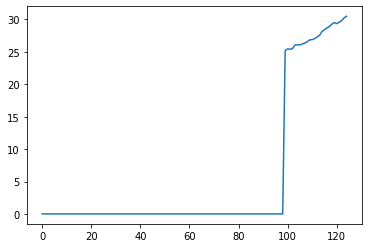

Episode 125 
 100 episode moving avg: 30.49
Episode 125 
 100 episode moving avg: 30.49


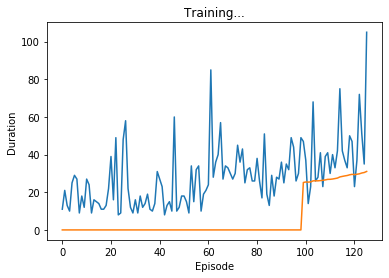

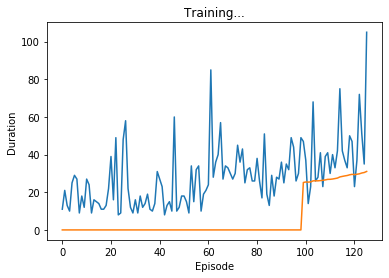

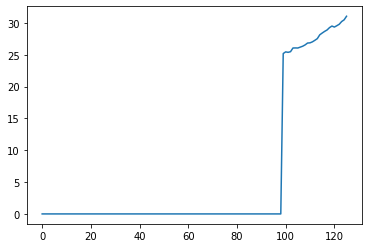

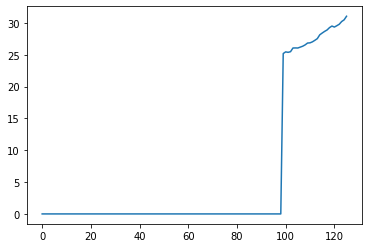

Episode 126 
 100 episode moving avg: 31.06
Episode 126 
 100 episode moving avg: 31.06


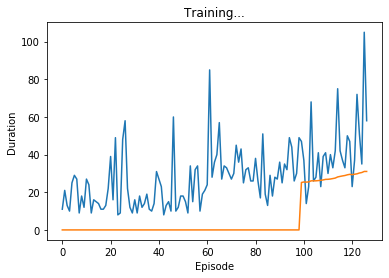

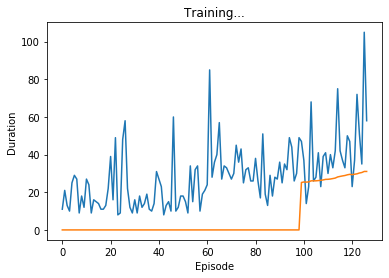

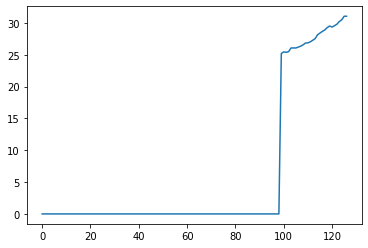

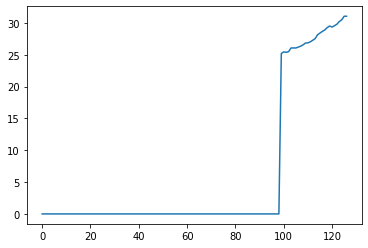

Episode 127 
 100 episode moving avg: 31.06
Episode 127 
 100 episode moving avg: 31.06


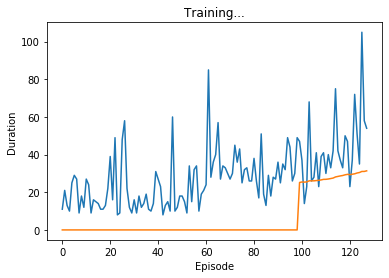

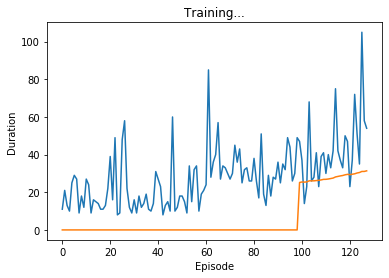

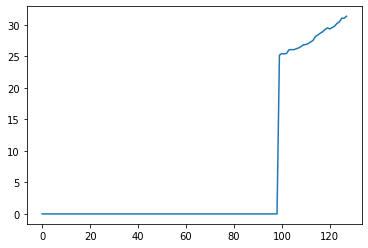

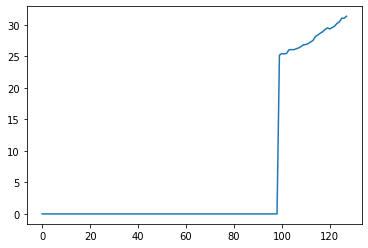

Episode 128 
 100 episode moving avg: 31.38
Episode 128 
 100 episode moving avg: 31.38


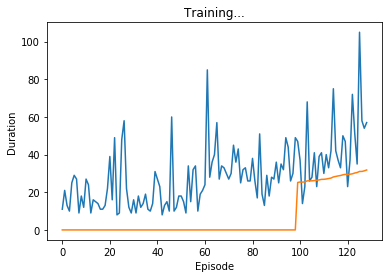

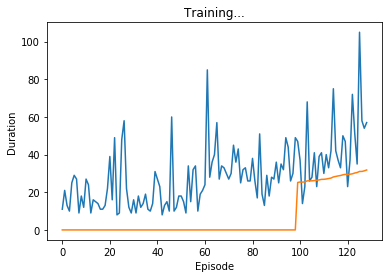

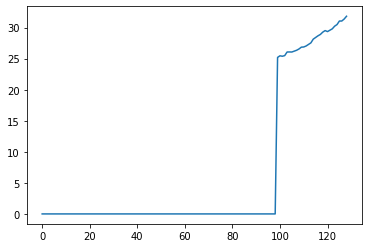

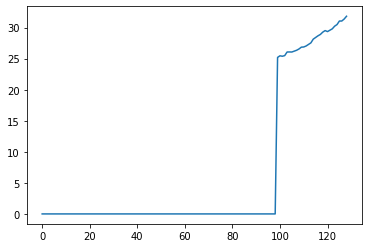

Episode 129 
 100 episode moving avg: 31.83
Episode 129 
 100 episode moving avg: 31.83


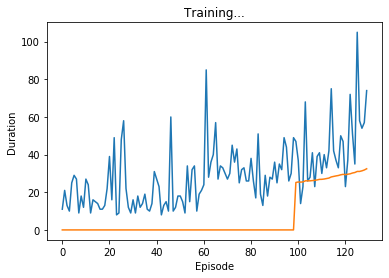

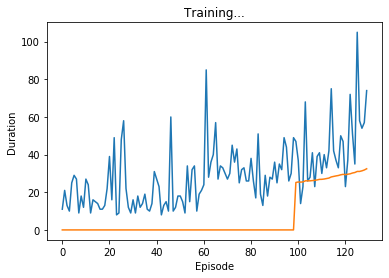

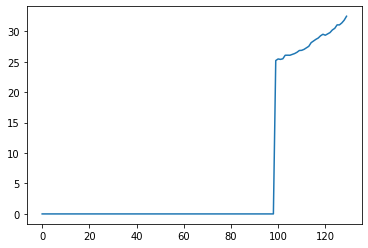

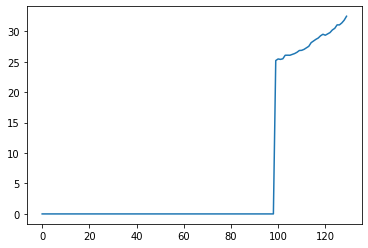

Episode 130 
 100 episode moving avg: 32.48
Episode 130 
 100 episode moving avg: 32.48


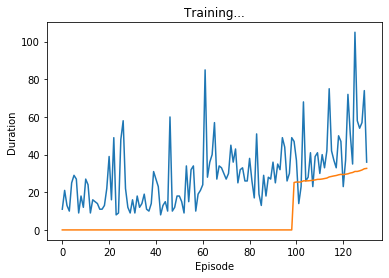

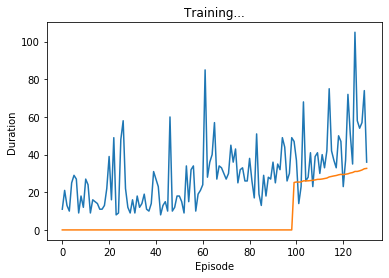

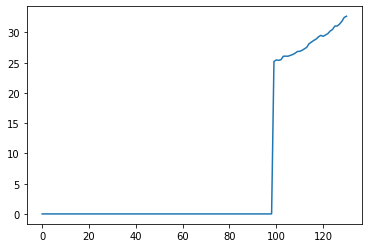

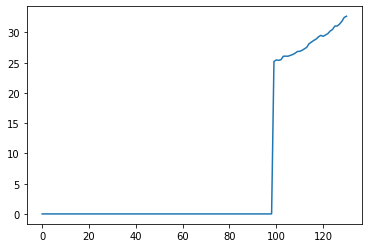

Episode 131 
 100 episode moving avg: 32.68
Episode 131 
 100 episode moving avg: 32.68


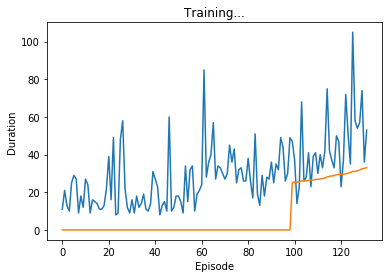

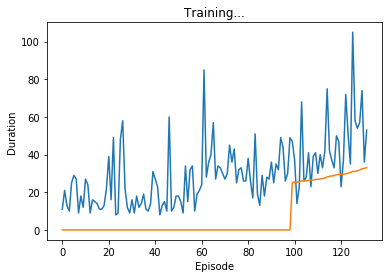

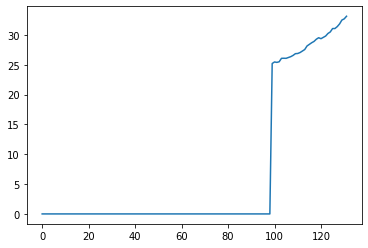

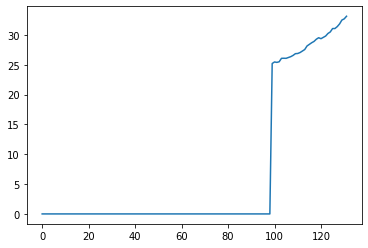

Episode 132 
 100 episode moving avg: 33.12
Episode 132 
 100 episode moving avg: 33.12


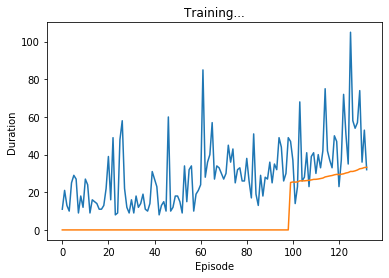

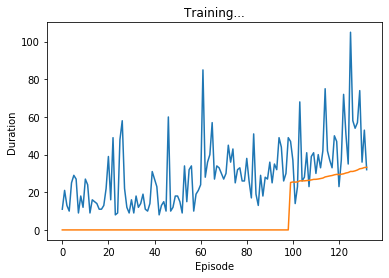

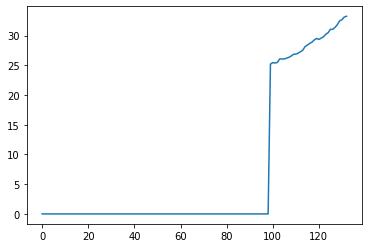

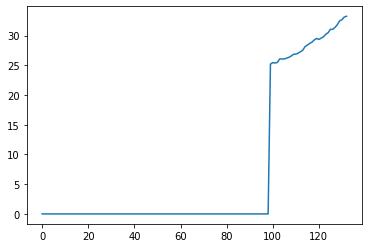

Episode 133 
 100 episode moving avg: 33.26
Episode 133 
 100 episode moving avg: 33.26


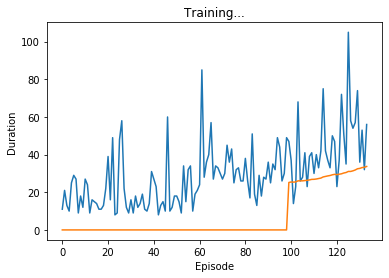

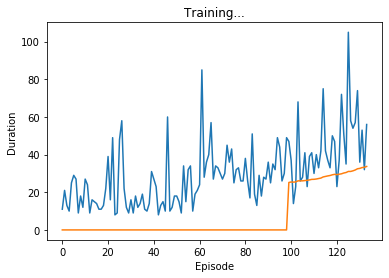

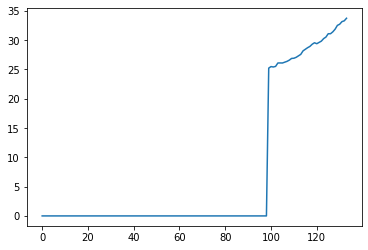

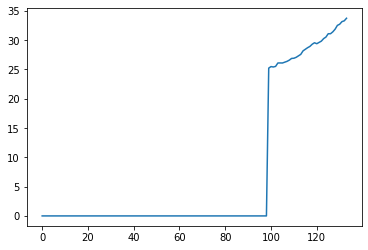

Episode 134 
 100 episode moving avg: 33.7
Episode 134 
 100 episode moving avg: 33.7


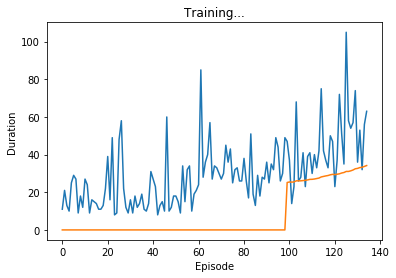

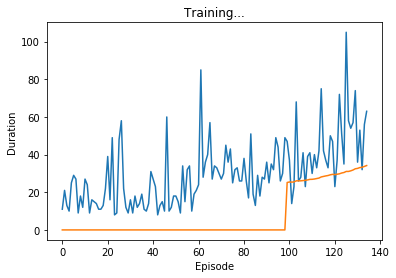

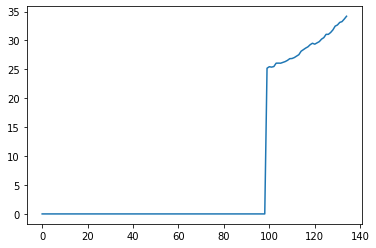

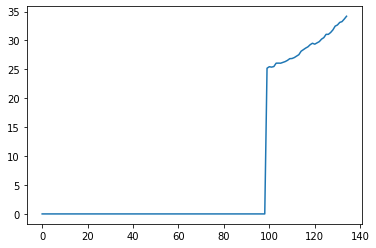

Episode 135 
 100 episode moving avg: 34.19
Episode 135 
 100 episode moving avg: 34.19


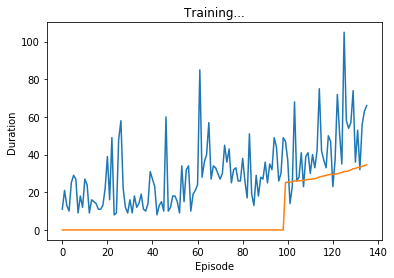

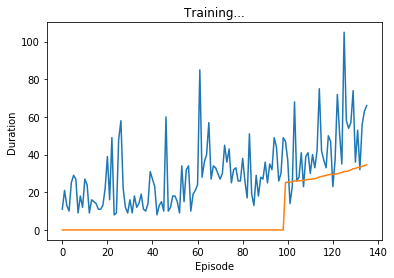

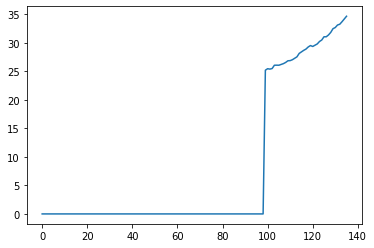

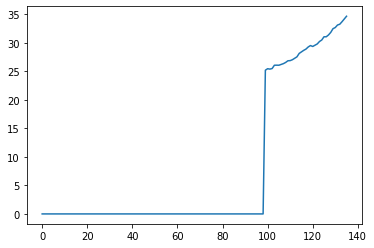

Episode 136 
 100 episode moving avg: 34.66
Episode 136 
 100 episode moving avg: 34.66


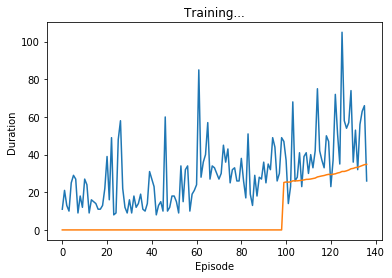

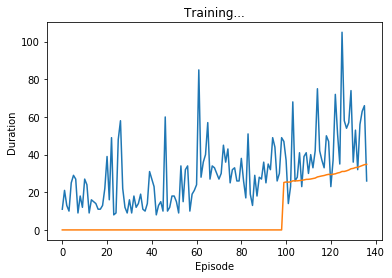

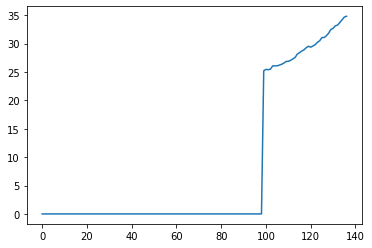

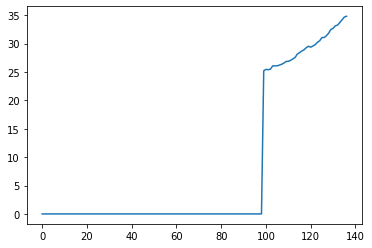

Episode 137 
 100 episode moving avg: 34.81
Episode 137 
 100 episode moving avg: 34.81


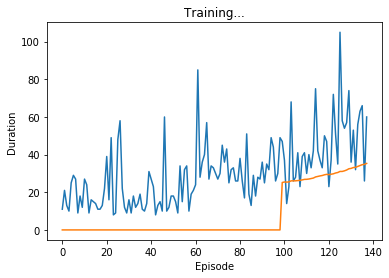

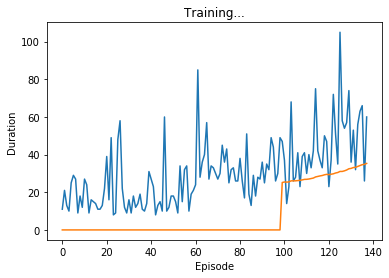

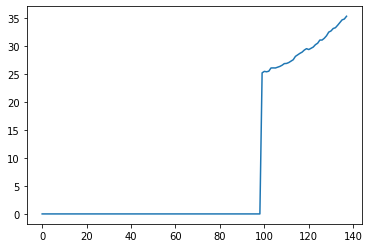

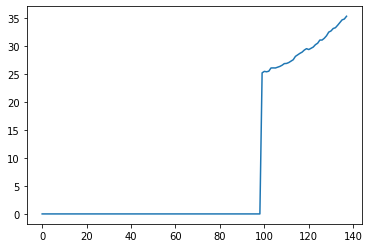

Episode 138 
 100 episode moving avg: 35.31
Episode 138 
 100 episode moving avg: 35.31


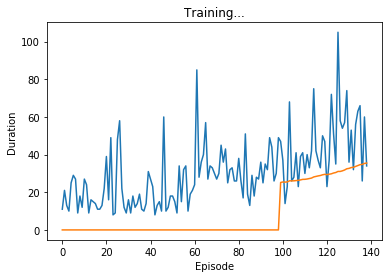

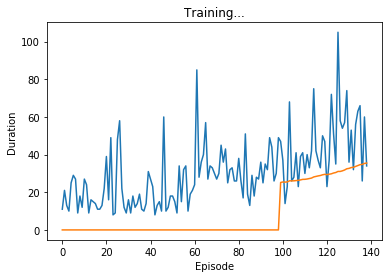

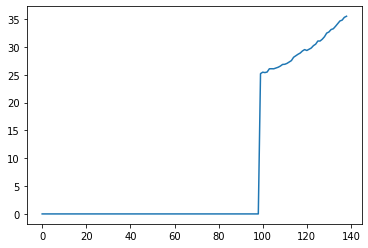

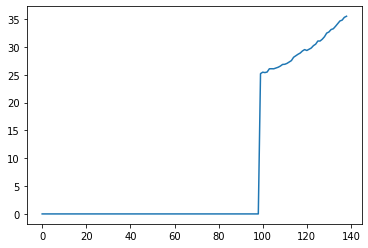

Episode 139 
 100 episode moving avg: 35.51
Episode 139 
 100 episode moving avg: 35.51


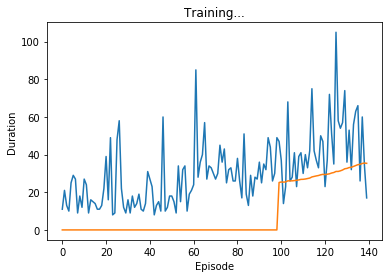

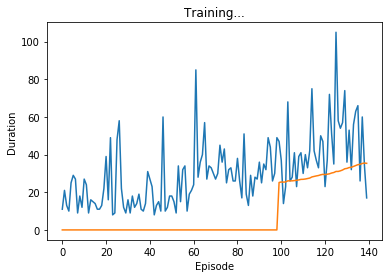

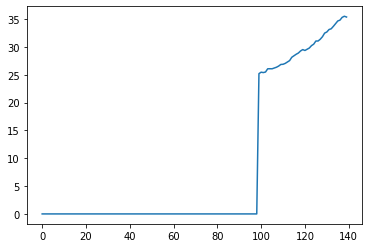

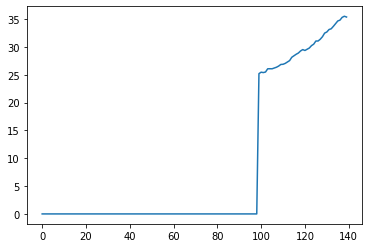

Episode 140 
 100 episode moving avg: 35.37
Episode 140 
 100 episode moving avg: 35.37


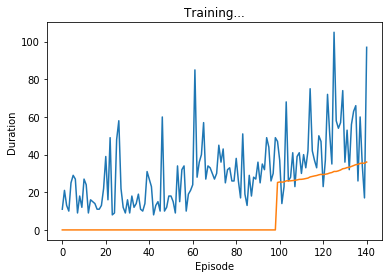

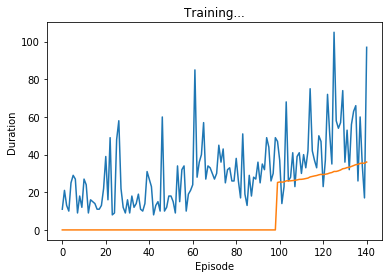

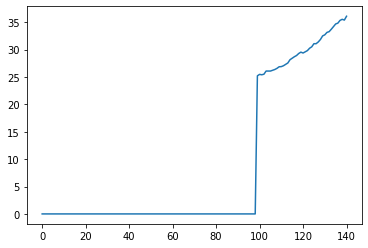

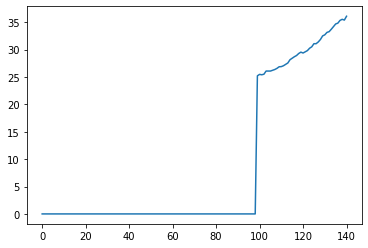

Episode 141 
 100 episode moving avg: 36.07
Episode 141 
 100 episode moving avg: 36.07


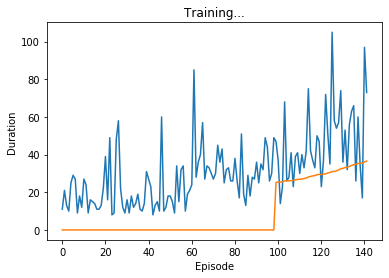

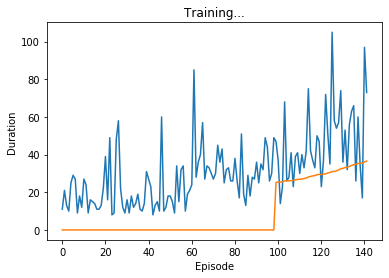

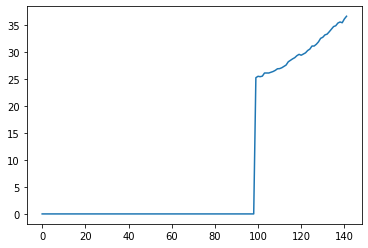

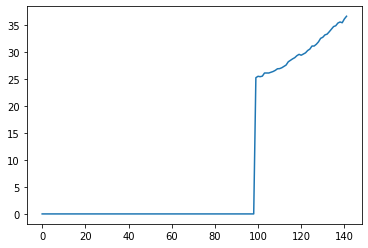

Episode 142 
 100 episode moving avg: 36.57
Episode 142 
 100 episode moving avg: 36.57


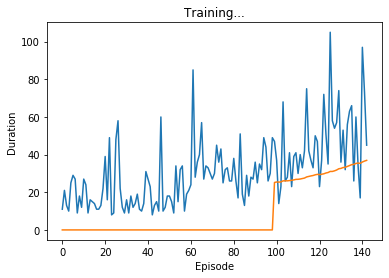

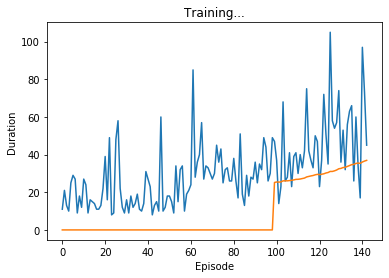

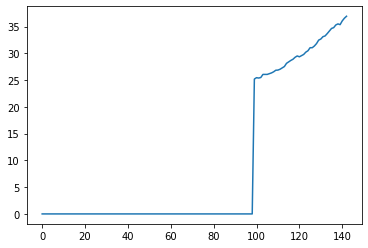

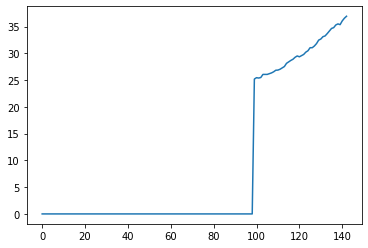

Episode 143 
 100 episode moving avg: 36.94
Episode 143 
 100 episode moving avg: 36.94


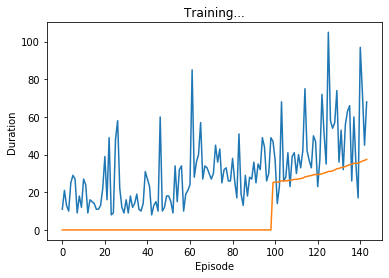

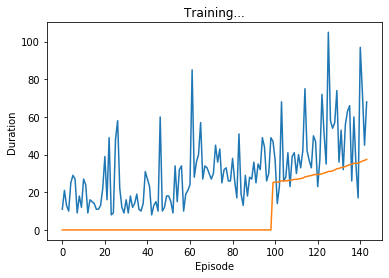

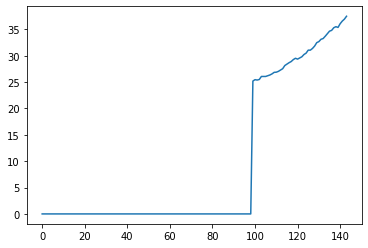

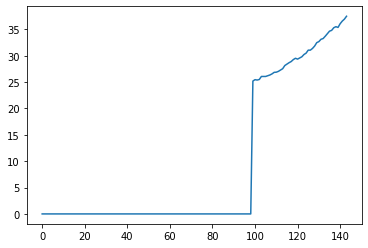

Episode 144 
 100 episode moving avg: 37.49
Episode 144 
 100 episode moving avg: 37.49


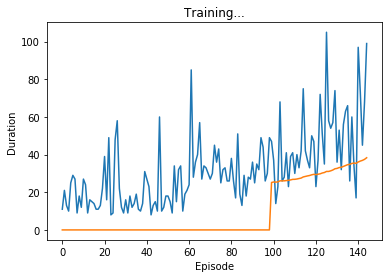

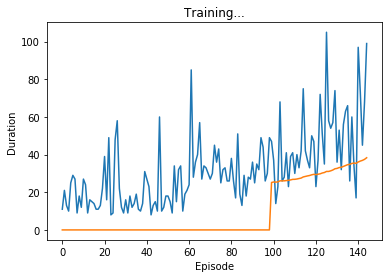

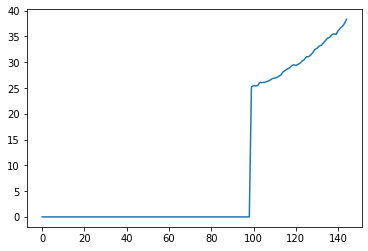

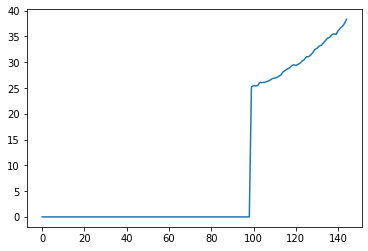

Episode 145 
 100 episode moving avg: 38.33
Episode 145 
 100 episode moving avg: 38.33


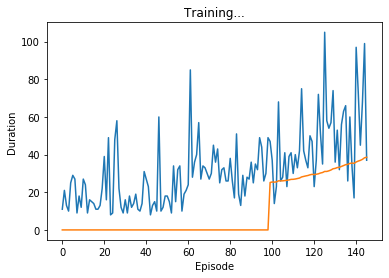

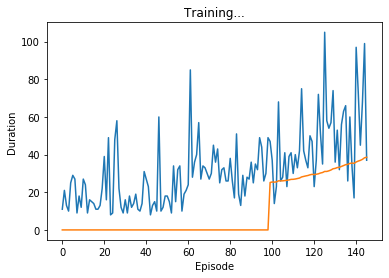

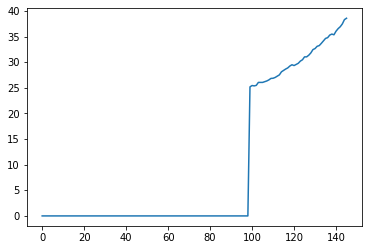

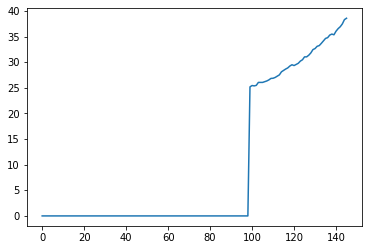

Episode 146 
 100 episode moving avg: 38.6
Episode 146 
 100 episode moving avg: 38.6


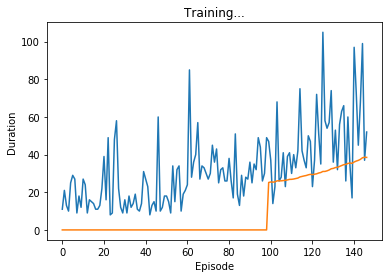

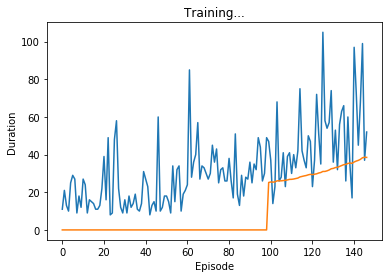

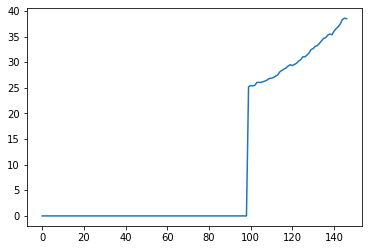

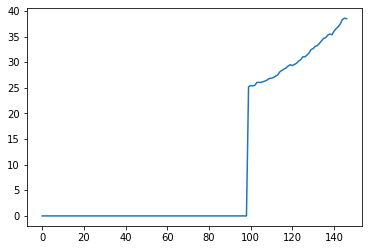

Episode 147 
 100 episode moving avg: 38.52
Episode 147 
 100 episode moving avg: 38.52


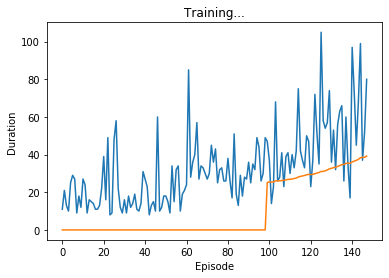

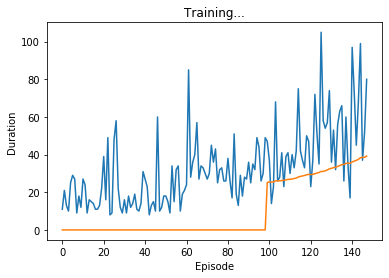

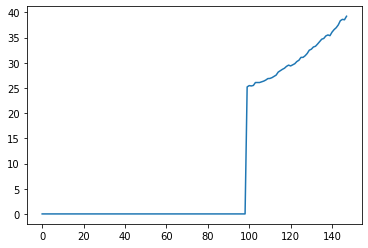

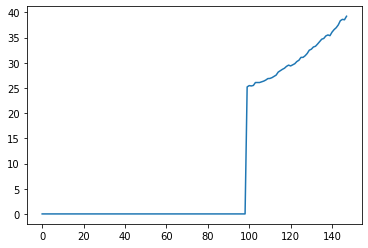

Episode 148 
 100 episode moving avg: 39.22
Episode 148 
 100 episode moving avg: 39.22


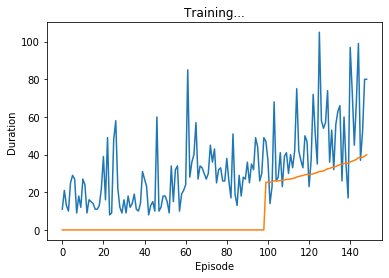

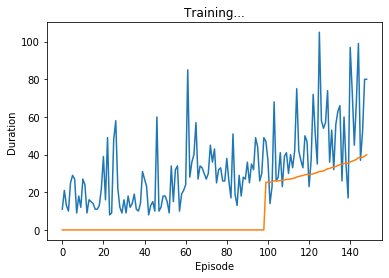

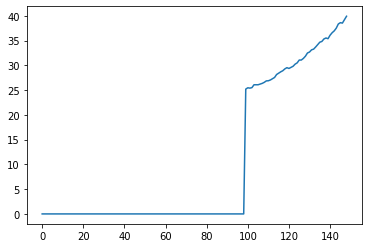

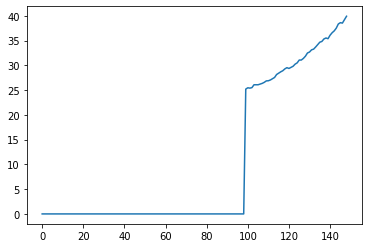

Episode 149 
 100 episode moving avg: 39.9
Episode 149 
 100 episode moving avg: 39.9


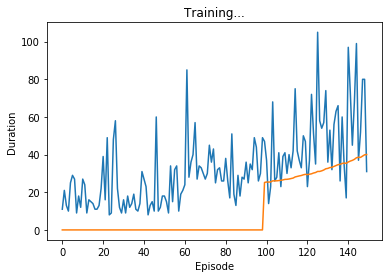

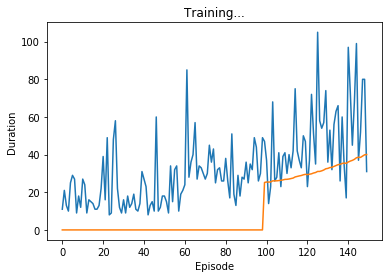

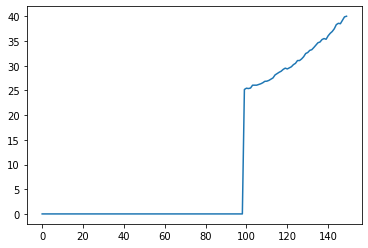

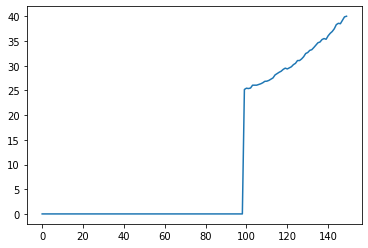

Episode 150 
 100 episode moving avg: 40.03
Episode 150 
 100 episode moving avg: 40.03


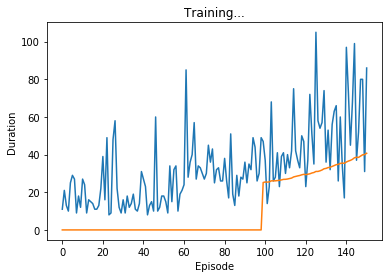

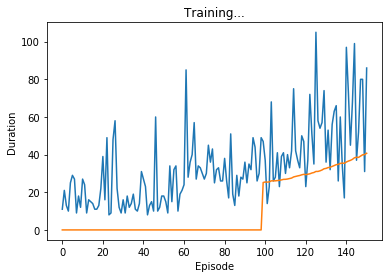

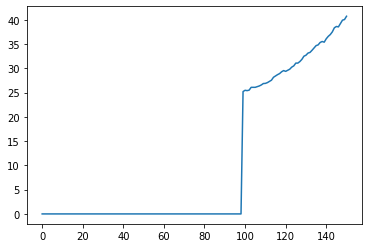

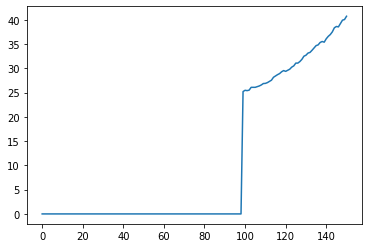

Episode 151 
 100 episode moving avg: 40.71
Episode 151 
 100 episode moving avg: 40.71


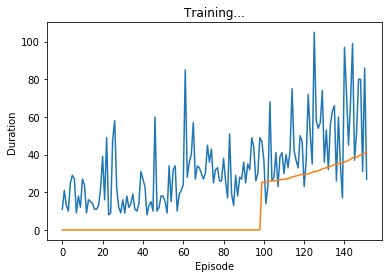

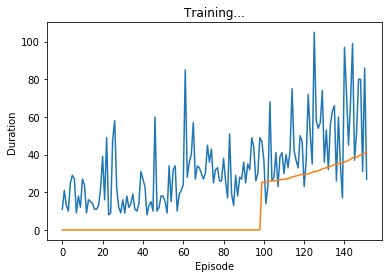

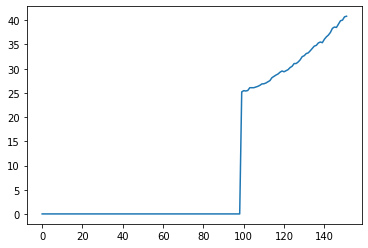

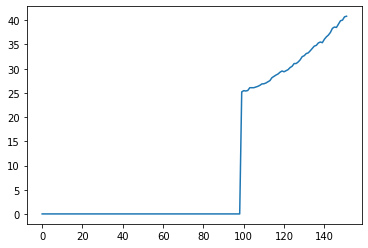

Episode 152 
 100 episode moving avg: 40.83
Episode 152 
 100 episode moving avg: 40.83


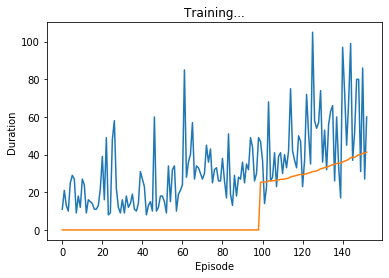

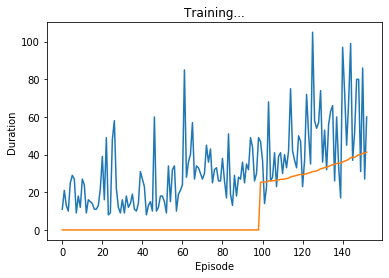

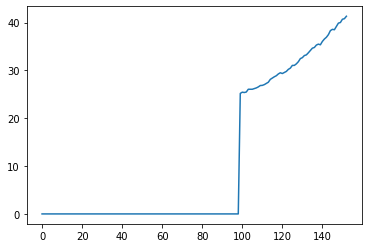

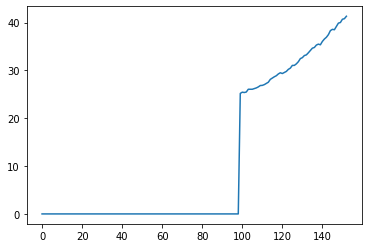

Episode 153 
 100 episode moving avg: 41.34
Episode 153 
 100 episode moving avg: 41.34


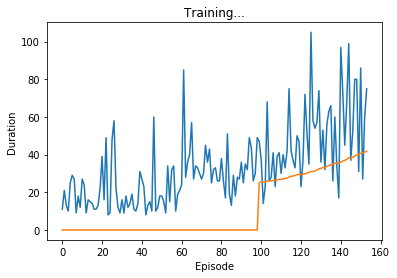

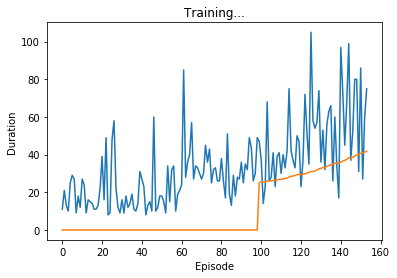

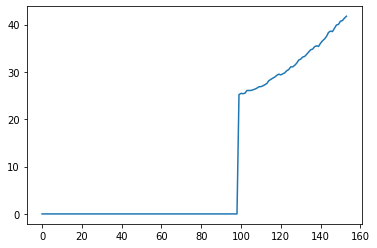

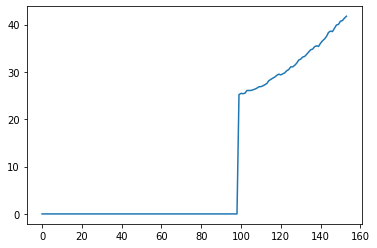

Episode 154 
 100 episode moving avg: 41.75
Episode 154 
 100 episode moving avg: 41.75


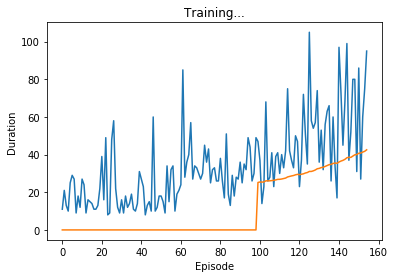

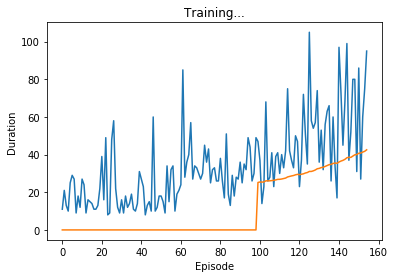

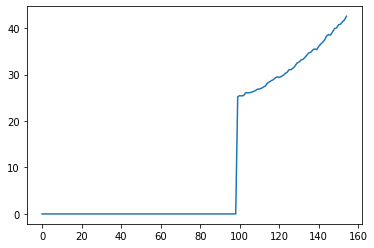

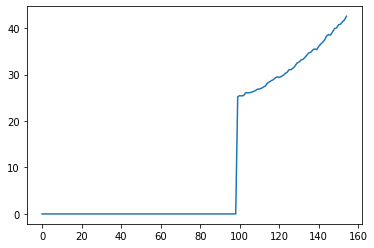

Episode 155 
 100 episode moving avg: 42.55
Episode 155 
 100 episode moving avg: 42.55


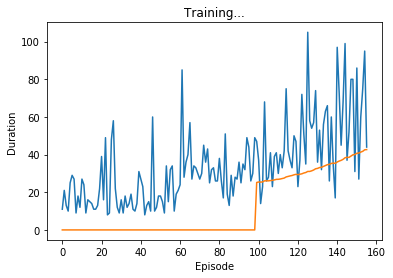

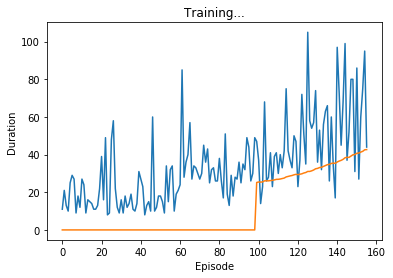

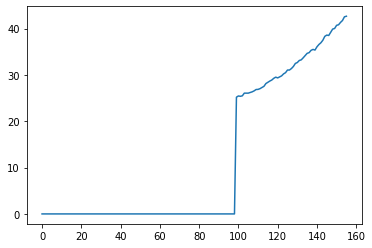

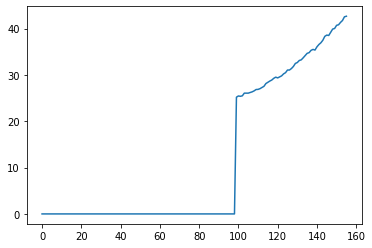

Episode 156 
 100 episode moving avg: 42.67
Episode 156 
 100 episode moving avg: 42.67


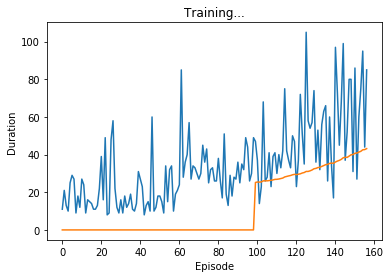

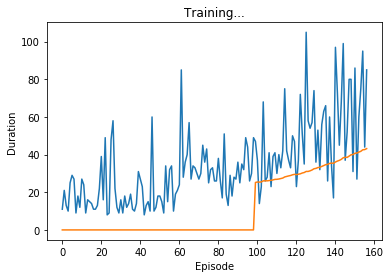

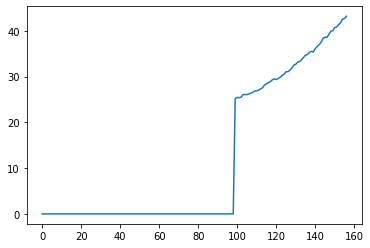

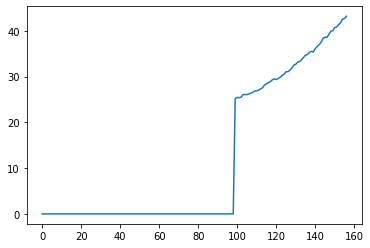

Episode 157 
 100 episode moving avg: 43.18
Episode 157 
 100 episode moving avg: 43.18


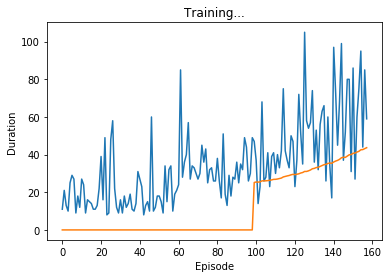

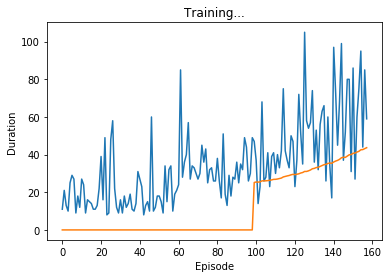

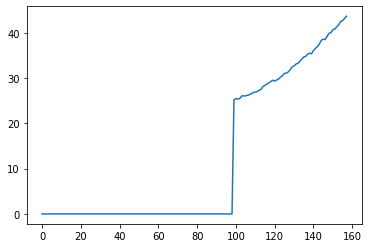

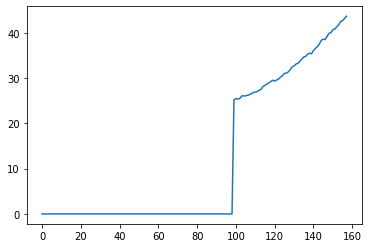

Episode 158 
 100 episode moving avg: 43.67
Episode 158 
 100 episode moving avg: 43.67


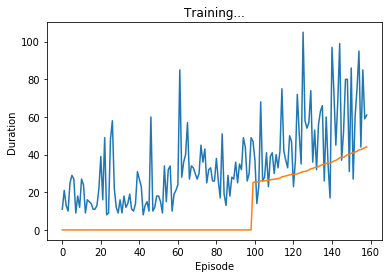

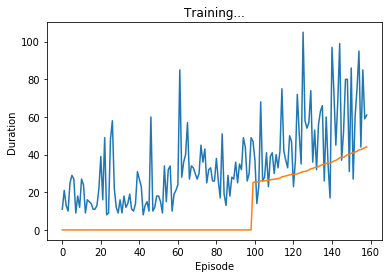

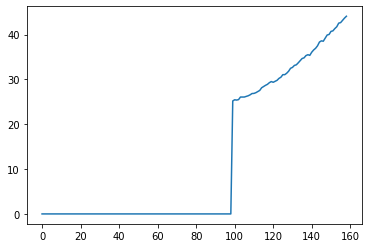

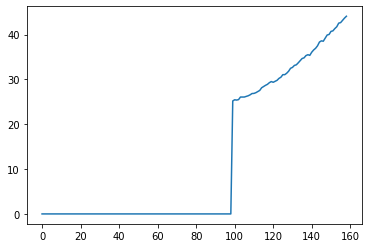

Episode 159 
 100 episode moving avg: 44.09
Episode 159 
 100 episode moving avg: 44.09


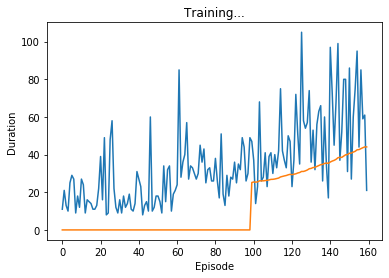

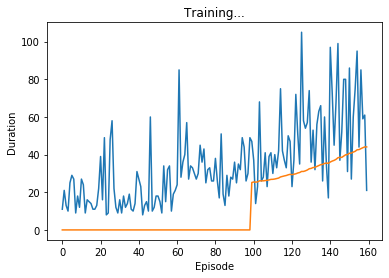

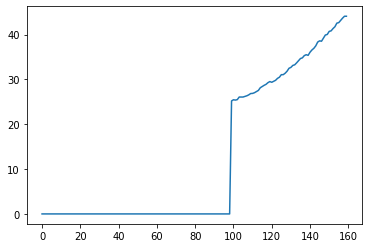

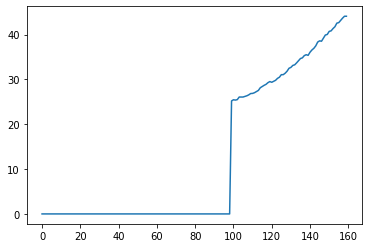

Episode 160 
 100 episode moving avg: 44.09
Episode 160 
 100 episode moving avg: 44.09


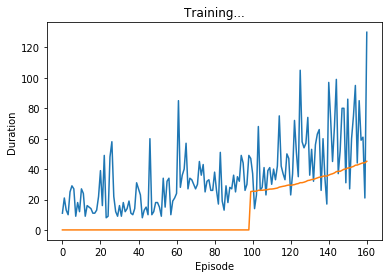

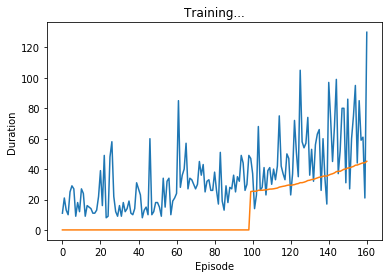

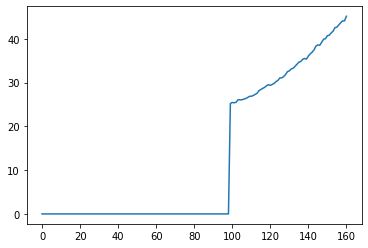

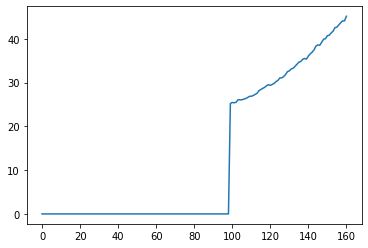

Episode 161 
 100 episode moving avg: 45.15
Episode 161 
 100 episode moving avg: 45.15


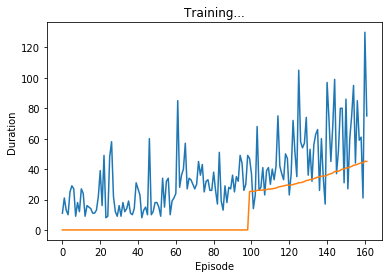

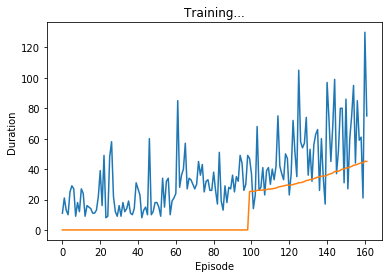

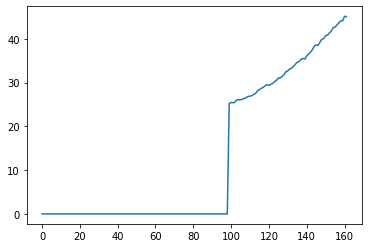

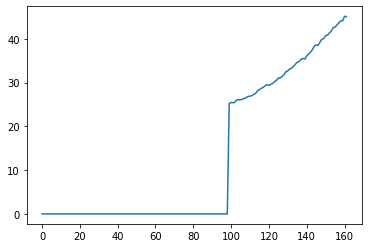

Episode 162 
 100 episode moving avg: 45.05
Episode 162 
 100 episode moving avg: 45.05


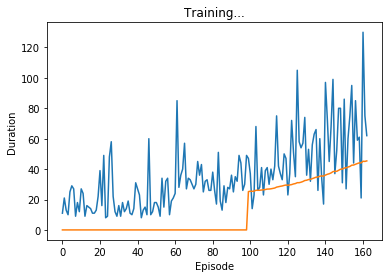

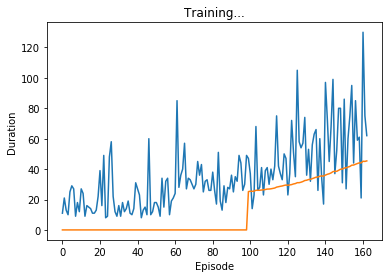

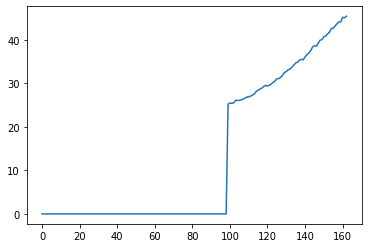

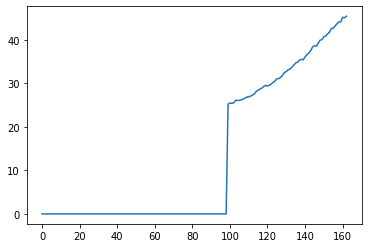

Episode 163 
 100 episode moving avg: 45.39
Episode 163 
 100 episode moving avg: 45.39


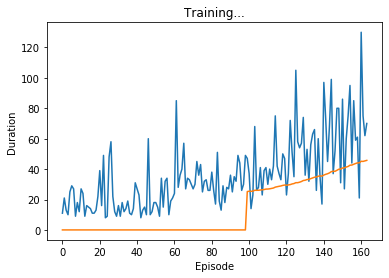

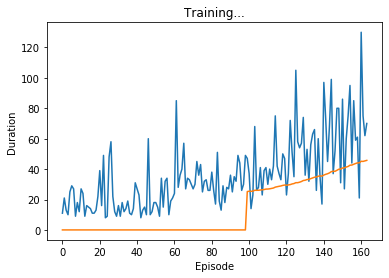

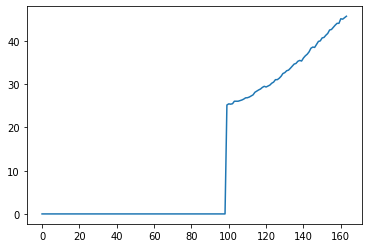

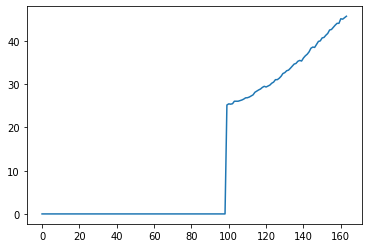

Episode 164 
 100 episode moving avg: 45.73
Episode 164 
 100 episode moving avg: 45.73


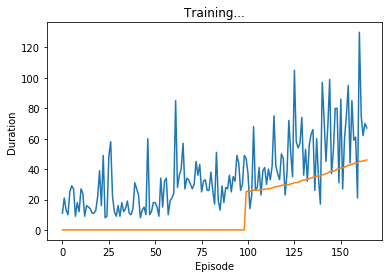

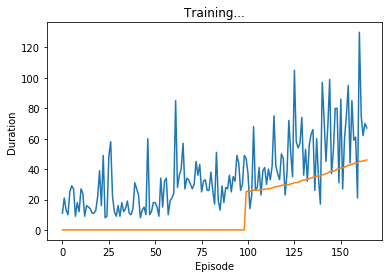

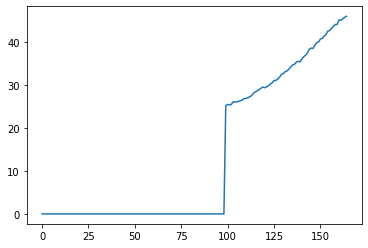

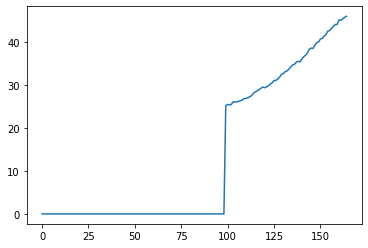

Episode 165 
 100 episode moving avg: 46.0
Episode 165 
 100 episode moving avg: 46.0


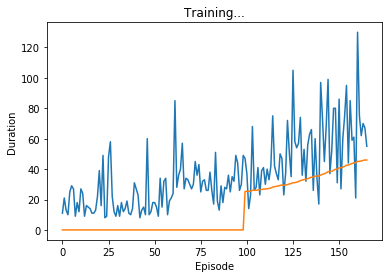

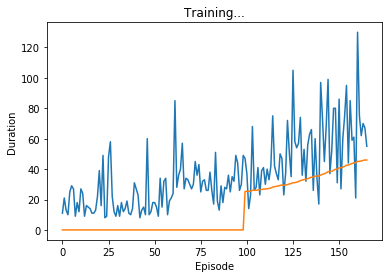

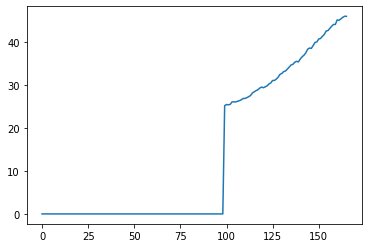

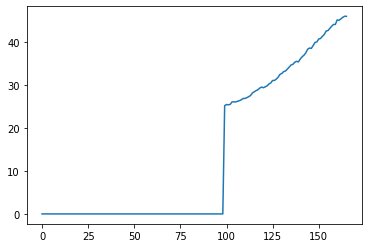

Episode 166 
 100 episode moving avg: 45.98
Episode 166 
 100 episode moving avg: 45.98


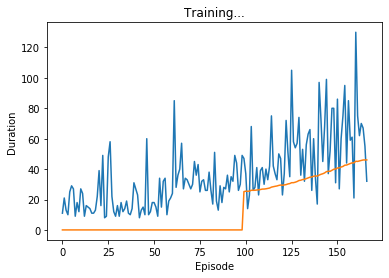

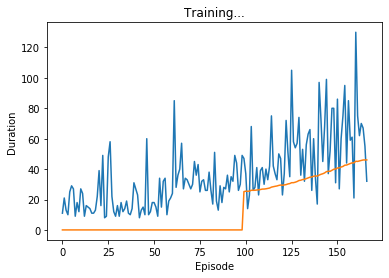

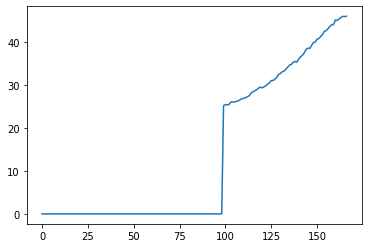

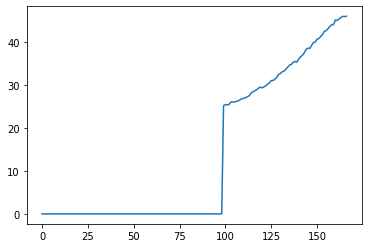

Episode 167 
 100 episode moving avg: 46.03
Episode 167 
 100 episode moving avg: 46.03


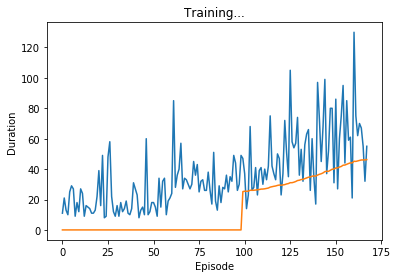

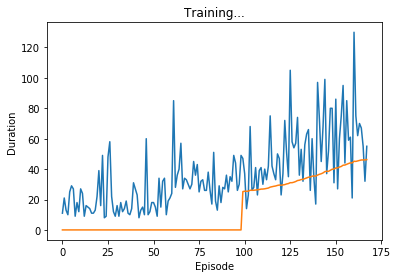

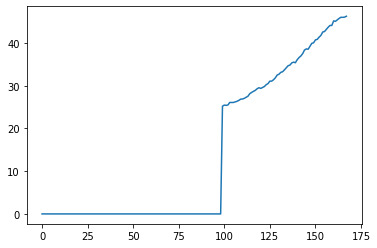

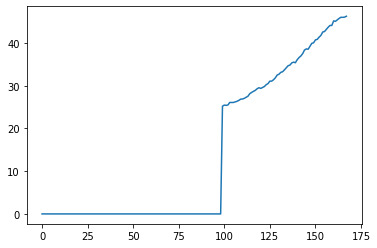

Episode 168 
 100 episode moving avg: 46.24
Episode 168 
 100 episode moving avg: 46.24


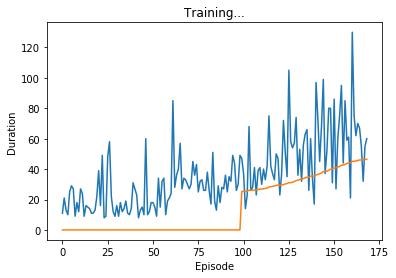

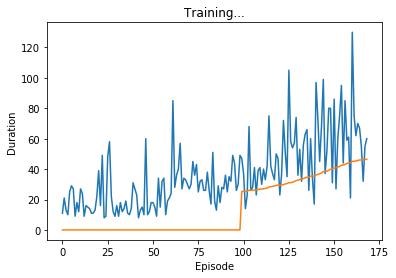

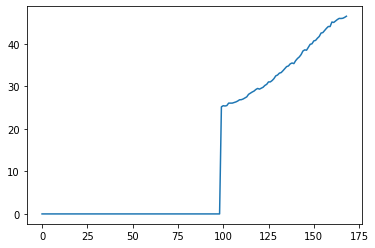

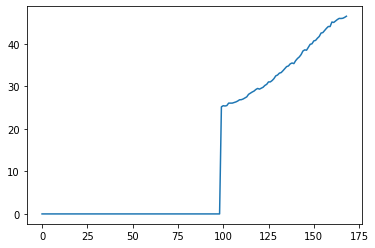

Episode 169 
 100 episode moving avg: 46.51
Episode 169 
 100 episode moving avg: 46.51


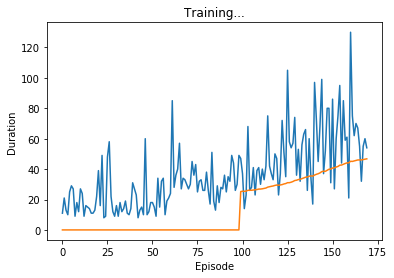

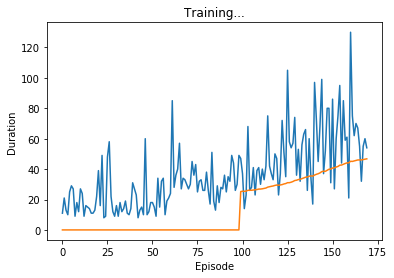

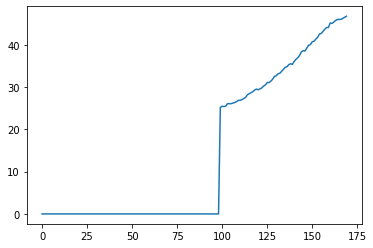

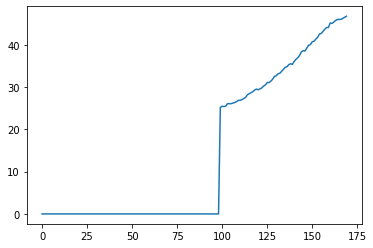

Episode 170 
 100 episode moving avg: 46.75
Episode 170 
 100 episode moving avg: 46.75


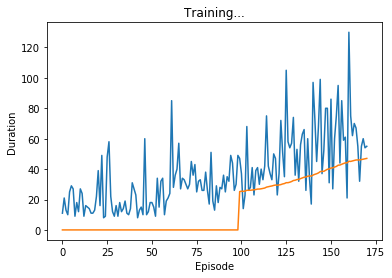

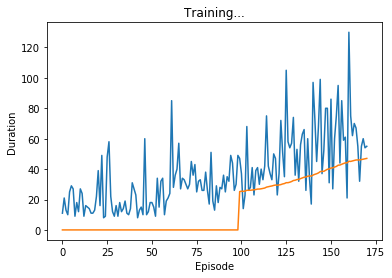

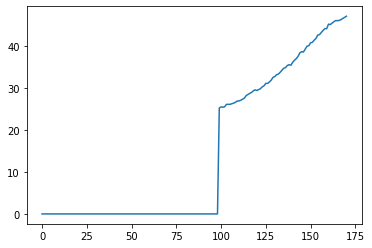

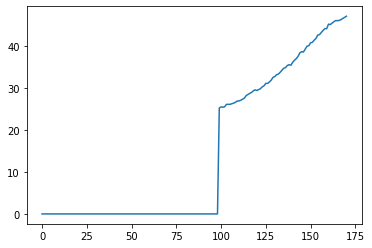

Episode 171 
 100 episode moving avg: 47.03
Episode 171 
 100 episode moving avg: 47.03


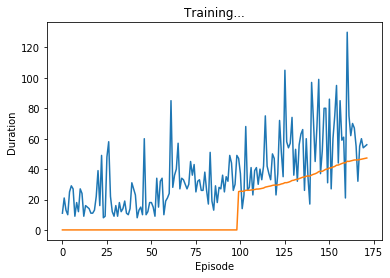

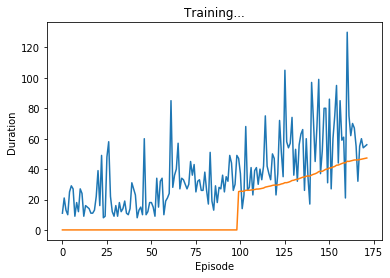

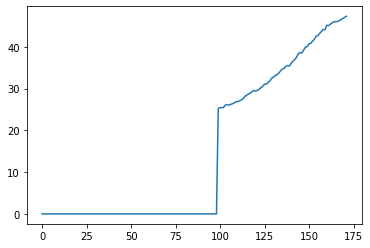

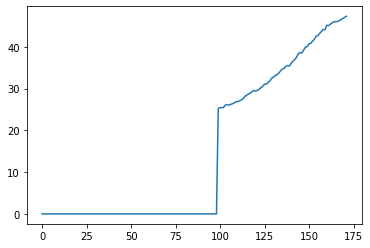

Episode 172 
 100 episode moving avg: 47.29
Episode 172 
 100 episode moving avg: 47.29


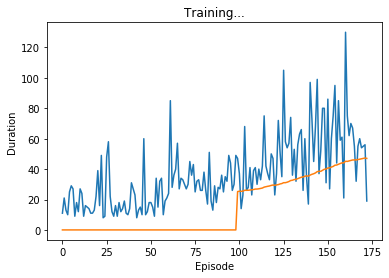

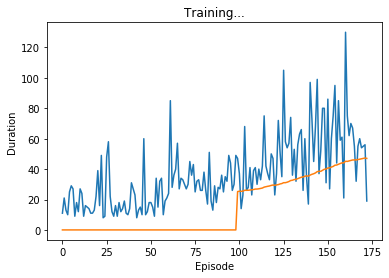

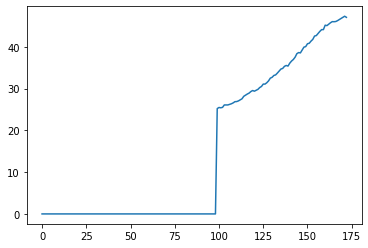

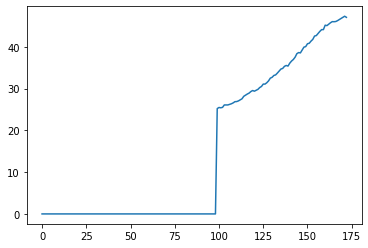

Episode 173 
 100 episode moving avg: 47.03
Episode 173 
 100 episode moving avg: 47.03


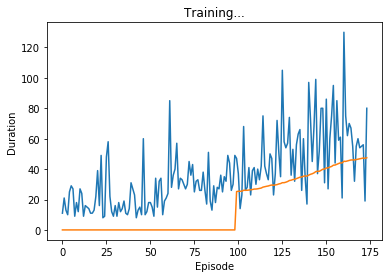

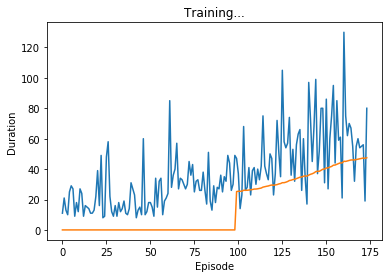

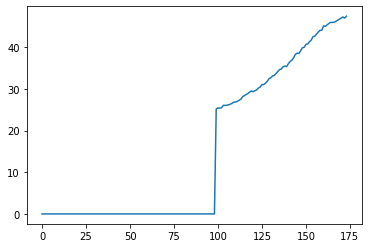

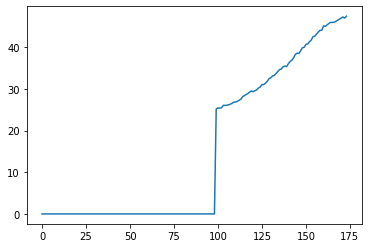

Episode 174 
 100 episode moving avg: 47.47
Episode 174 
 100 episode moving avg: 47.47


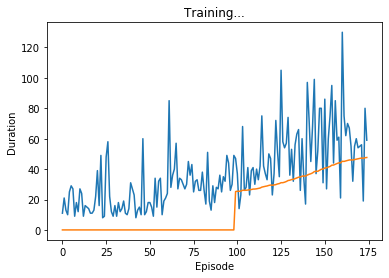

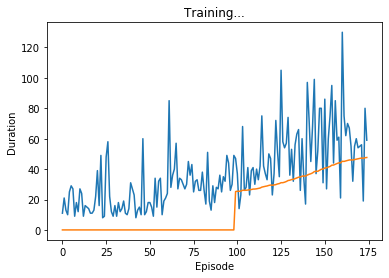

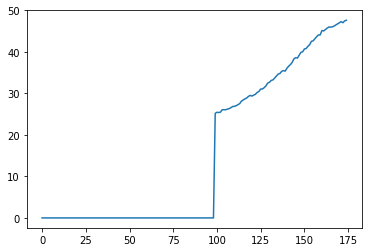

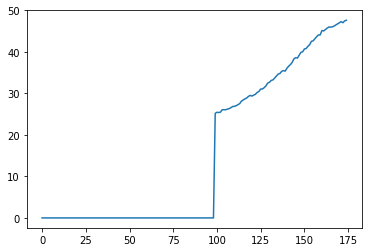

Episode 175 
 100 episode moving avg: 47.63
Episode 175 
 100 episode moving avg: 47.63


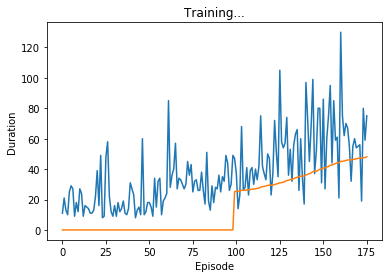

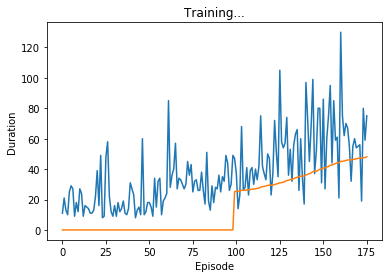

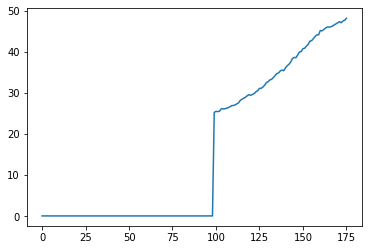

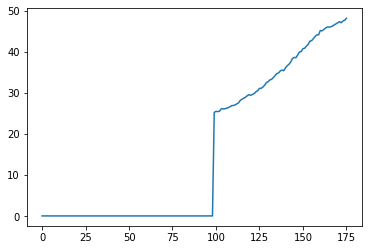

Episode 176 
 100 episode moving avg: 48.13
Episode 176 
 100 episode moving avg: 48.13


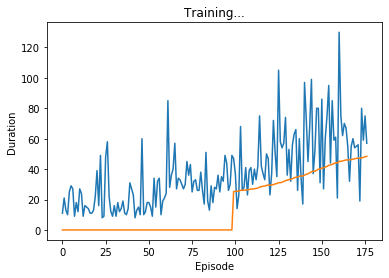

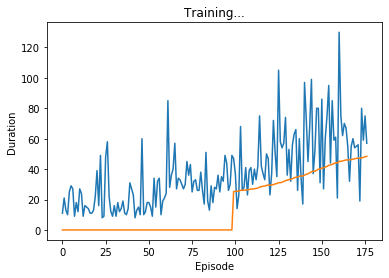

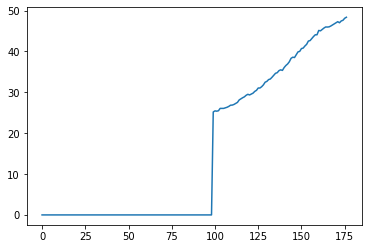

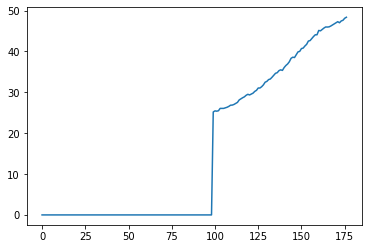

Episode 177 
 100 episode moving avg: 48.38
Episode 177 
 100 episode moving avg: 48.38


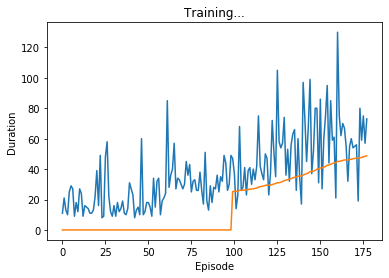

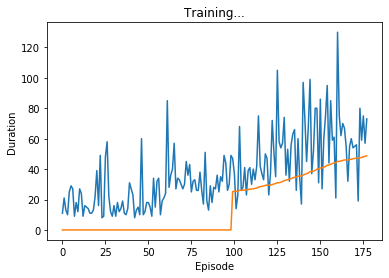

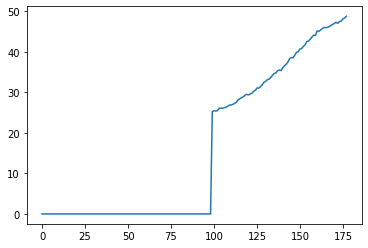

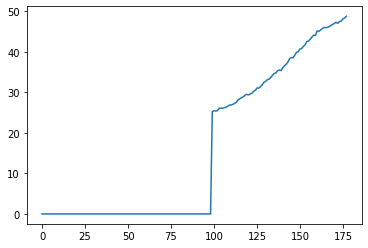

Episode 178 
 100 episode moving avg: 48.78
Episode 178 
 100 episode moving avg: 48.78


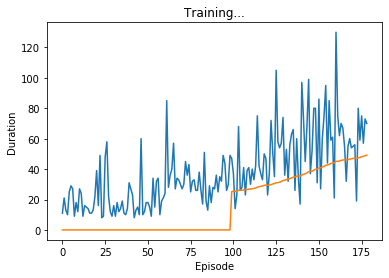

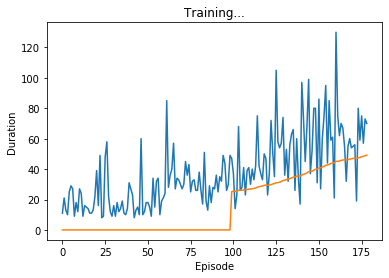

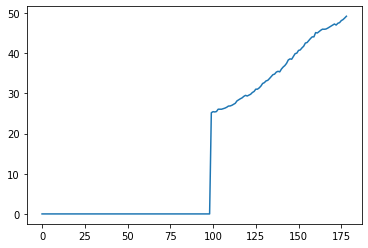

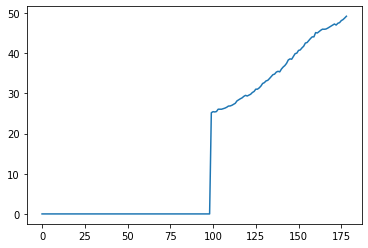

Episode 179 
 100 episode moving avg: 49.22
Episode 179 
 100 episode moving avg: 49.22


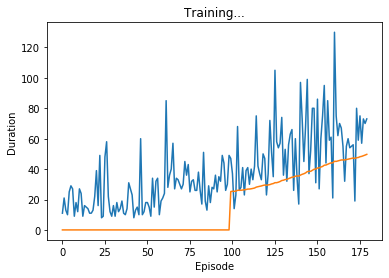

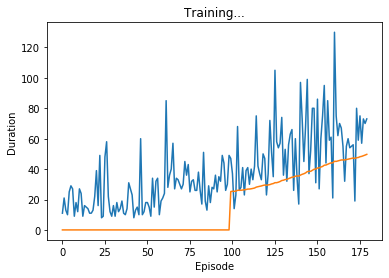

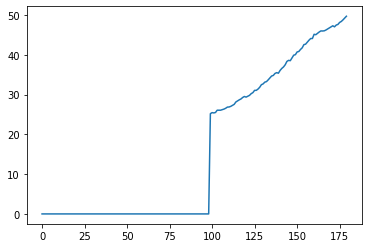

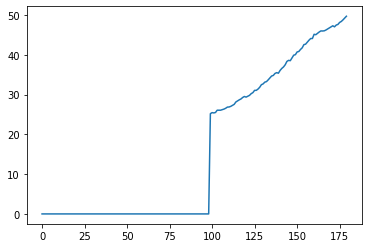

Episode 180 
 100 episode moving avg: 49.69
Episode 180 
 100 episode moving avg: 49.69


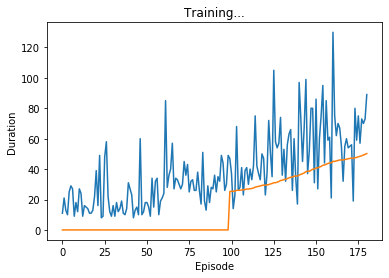

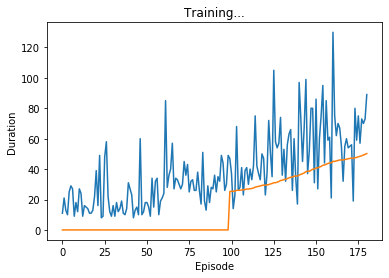

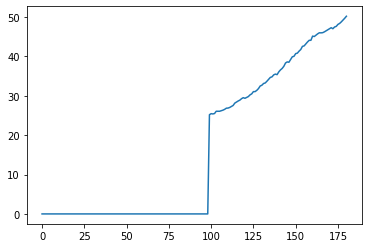

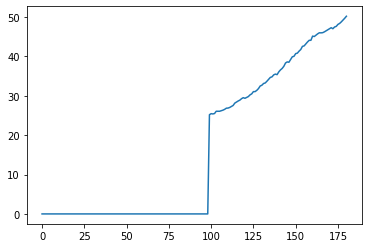

Episode 181 
 100 episode moving avg: 50.2
Episode 181 
 100 episode moving avg: 50.2


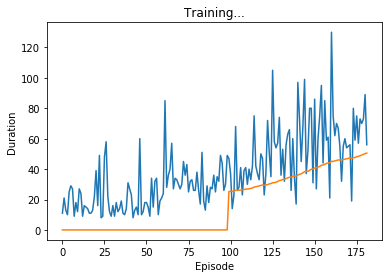

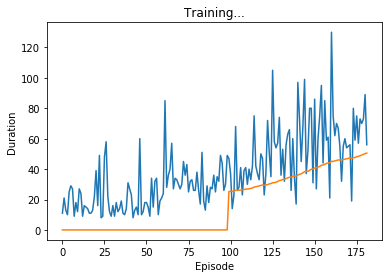

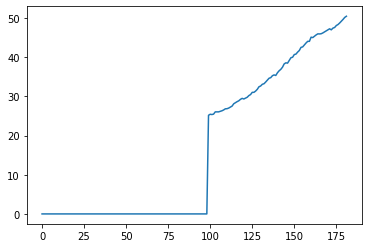

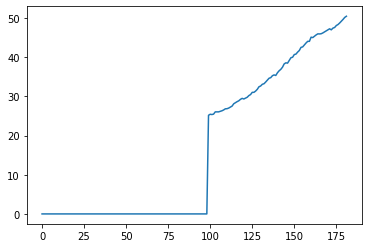

Episode 182 
 100 episode moving avg: 50.5
Episode 182 
 100 episode moving avg: 50.5


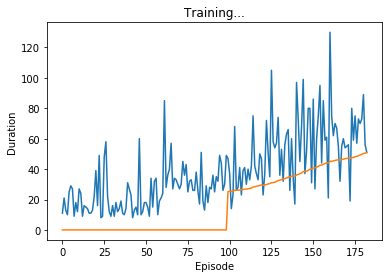

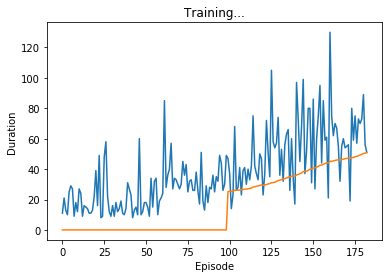

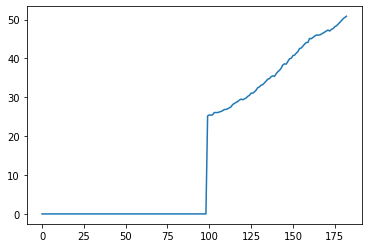

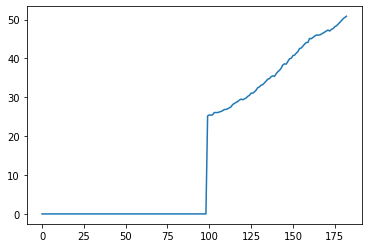

Episode 183 
 100 episode moving avg: 50.84
Episode 183 
 100 episode moving avg: 50.84


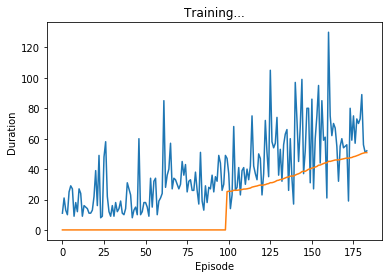

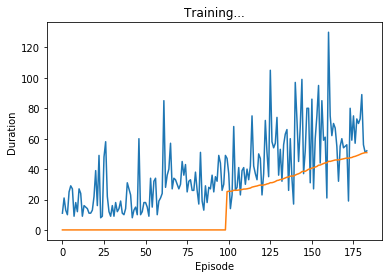

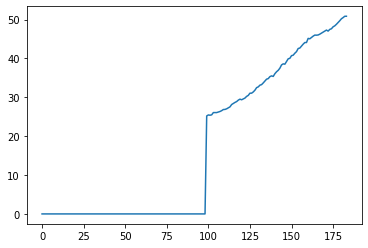

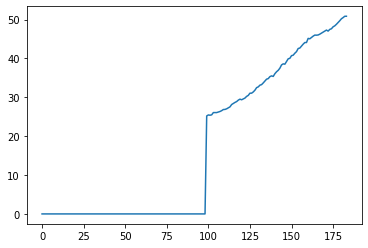

Episode 184 
 100 episode moving avg: 50.85
Episode 184 
 100 episode moving avg: 50.85


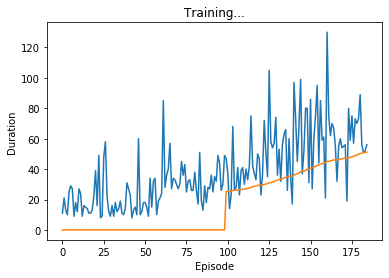

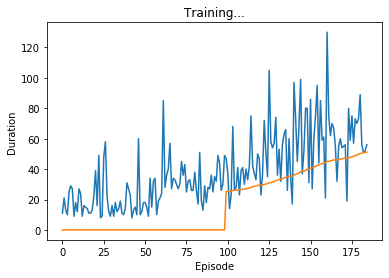

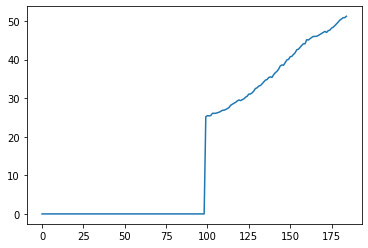

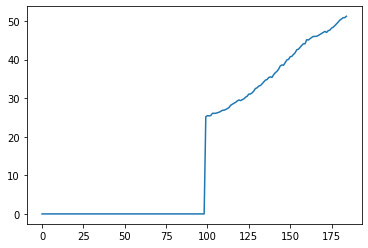

Episode 185 
 100 episode moving avg: 51.22
Episode 185 
 100 episode moving avg: 51.22


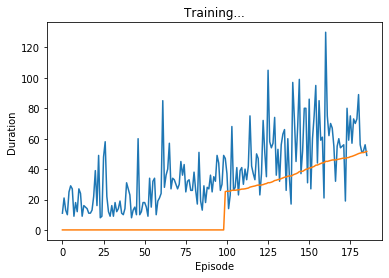

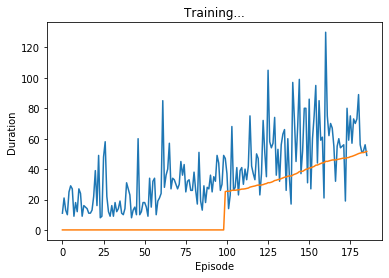

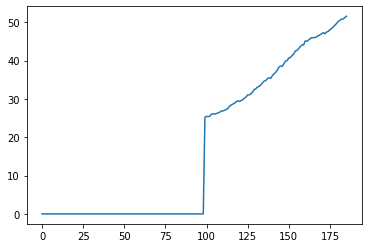

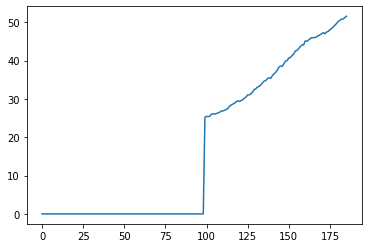

Episode 186 
 100 episode moving avg: 51.58
Episode 186 
 100 episode moving avg: 51.58


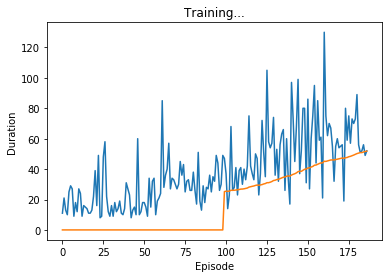

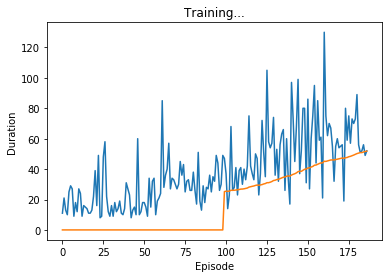

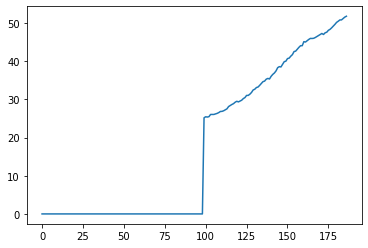

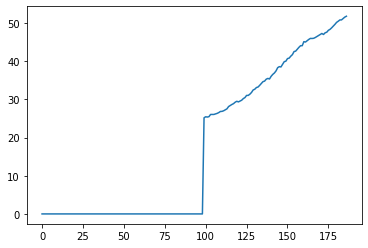

Episode 187 
 100 episode moving avg: 51.81
Episode 187 
 100 episode moving avg: 51.81


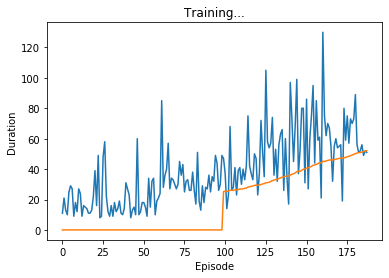

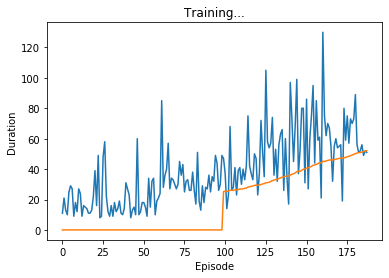

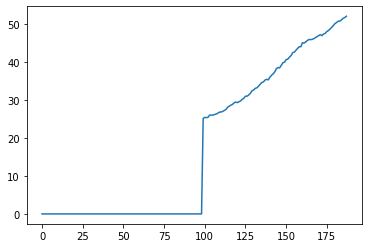

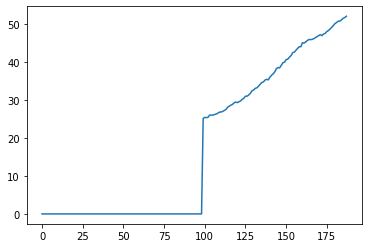

Episode 188 
 100 episode moving avg: 52.14
Episode 188 
 100 episode moving avg: 52.14


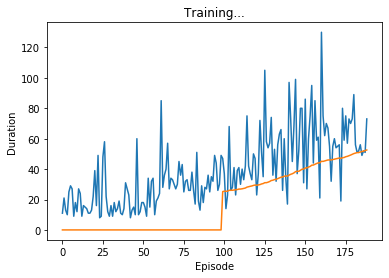

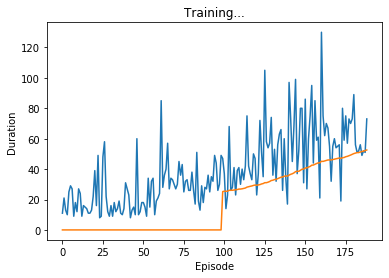

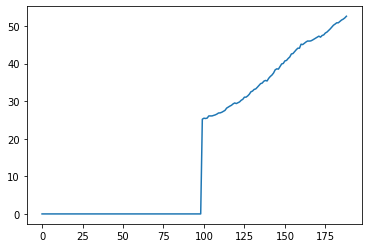

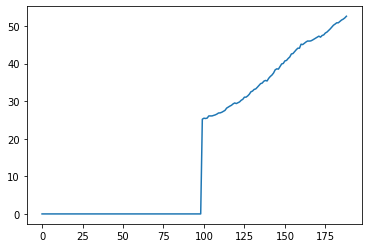

Episode 189 
 100 episode moving avg: 52.59
Episode 189 
 100 episode moving avg: 52.59


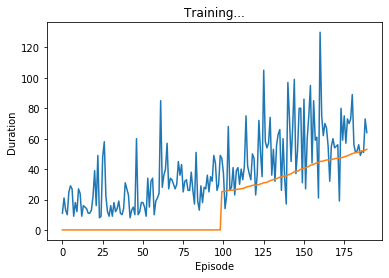

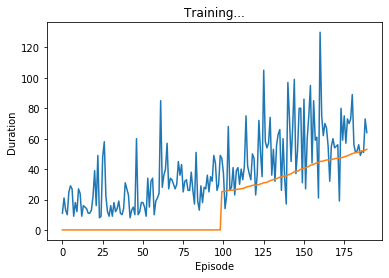

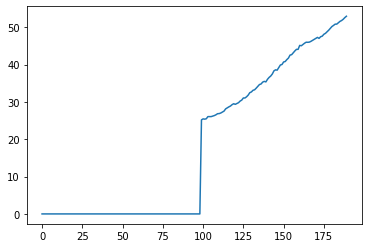

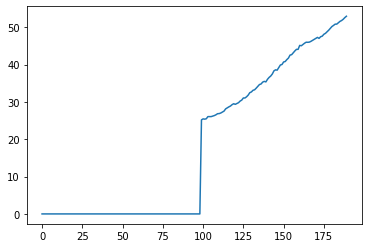

Episode 190 
 100 episode moving avg: 52.96
Episode 190 
 100 episode moving avg: 52.96


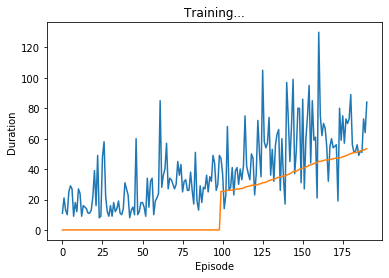

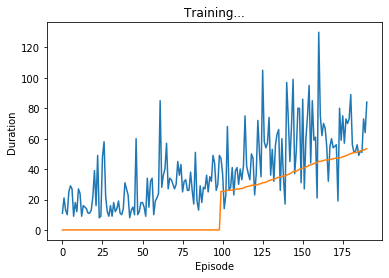

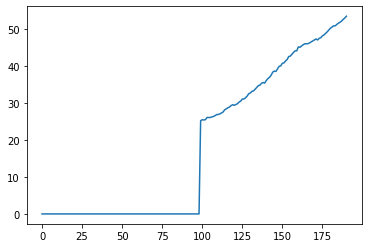

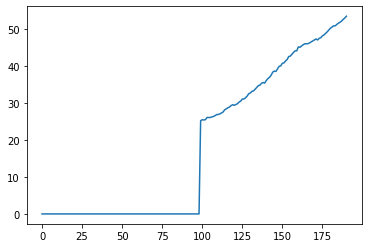

Episode 191 
 100 episode moving avg: 53.44
Episode 191 
 100 episode moving avg: 53.44


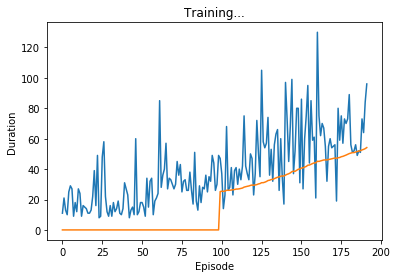

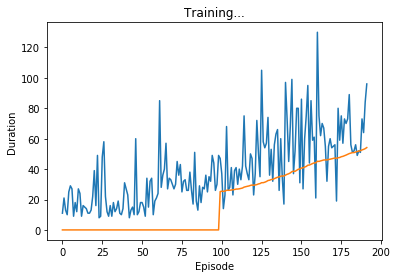

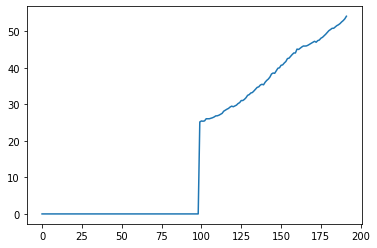

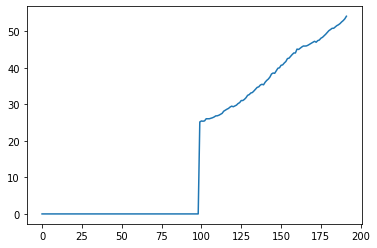

Episode 192 
 100 episode moving avg: 54.15
Episode 192 
 100 episode moving avg: 54.15


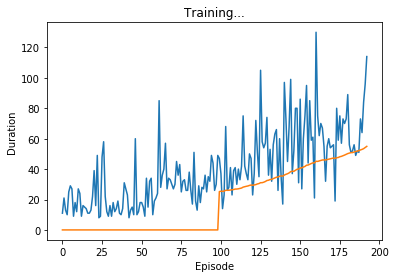

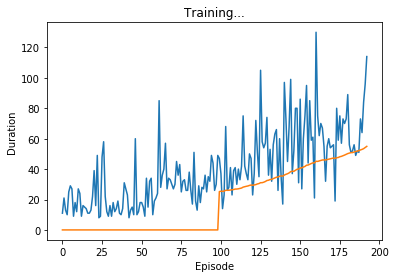

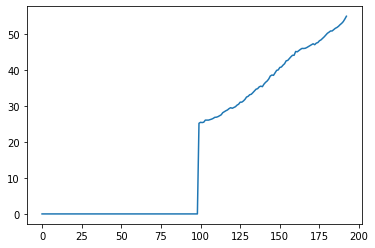

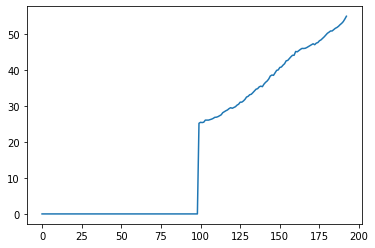

Episode 193 
 100 episode moving avg: 54.94
Episode 193 
 100 episode moving avg: 54.94


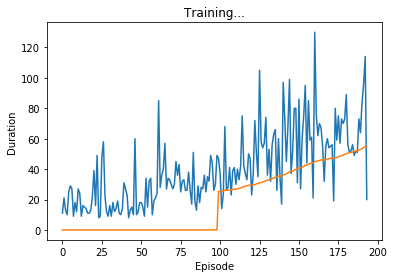

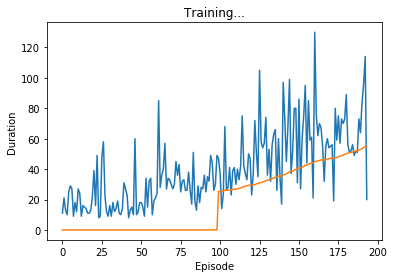

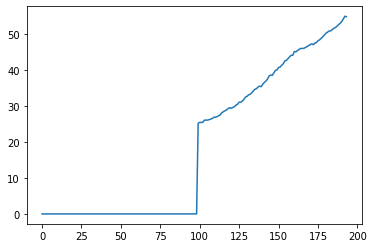

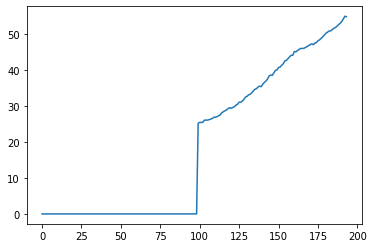

Episode 194 
 100 episode moving avg: 54.82
Episode 194 
 100 episode moving avg: 54.82


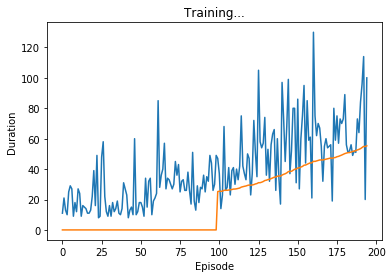

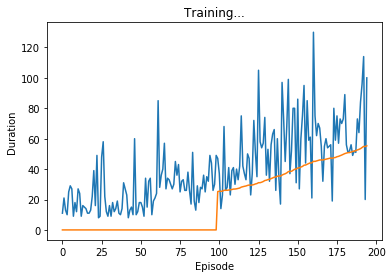

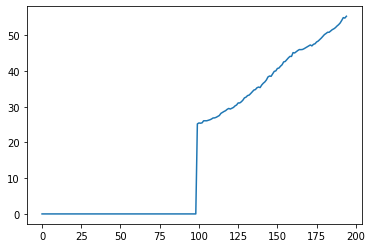

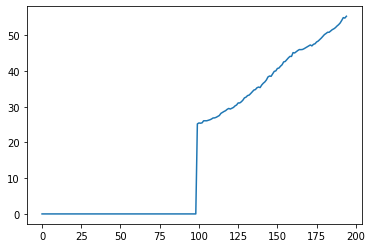

Episode 195 
 100 episode moving avg: 55.33
Episode 195 
 100 episode moving avg: 55.33


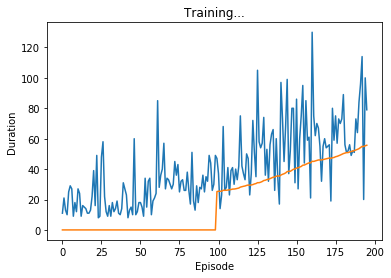

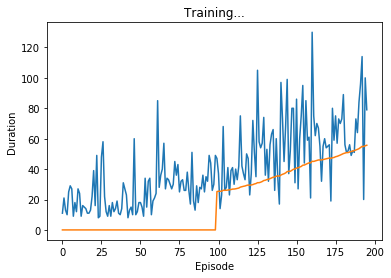

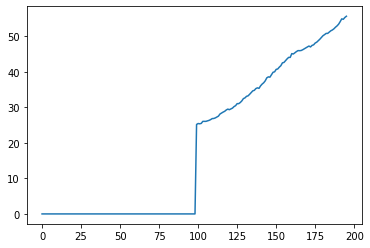

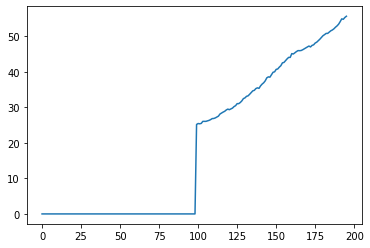

Episode 196 
 100 episode moving avg: 55.68
Episode 196 
 100 episode moving avg: 55.68


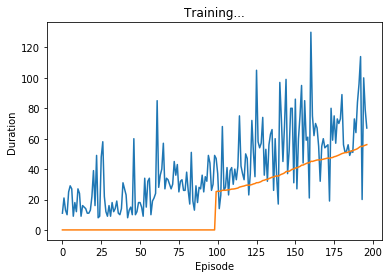

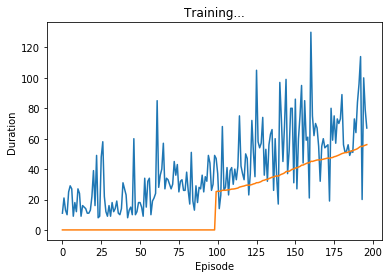

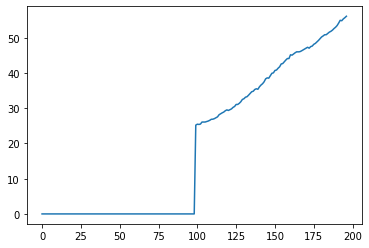

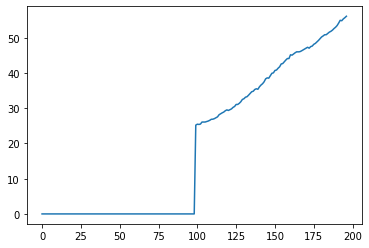

Episode 197 
 100 episode moving avg: 56.09
Episode 197 
 100 episode moving avg: 56.09


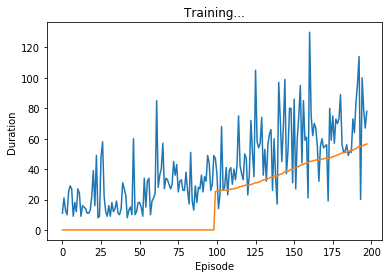

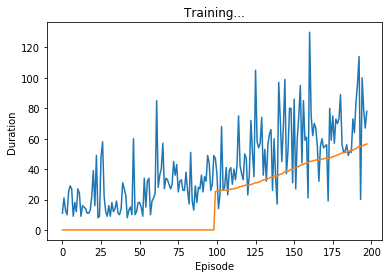

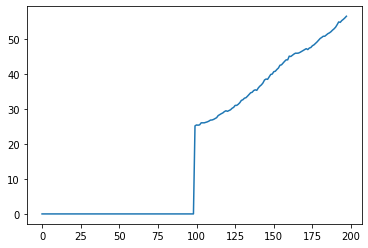

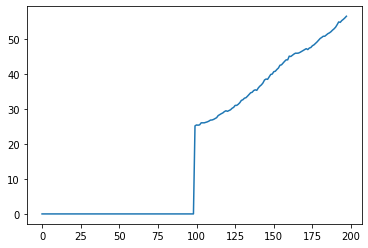

Episode 198 
 100 episode moving avg: 56.57
Episode 198 
 100 episode moving avg: 56.57


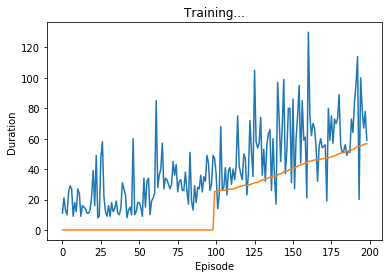

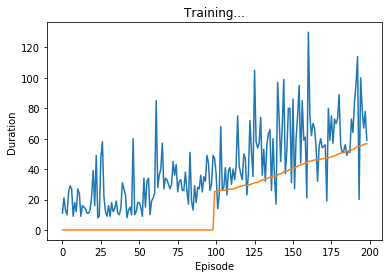

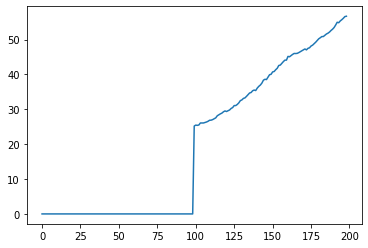

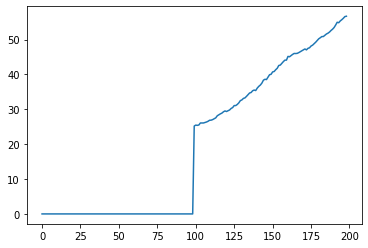

Episode 199 
 100 episode moving avg: 56.67
Episode 199 
 100 episode moving avg: 56.67


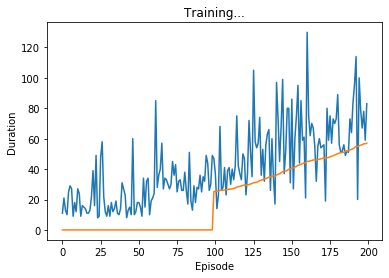

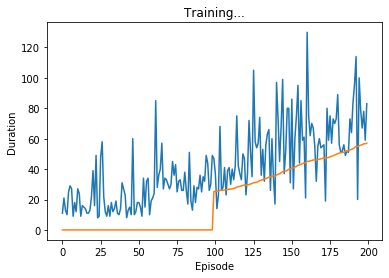

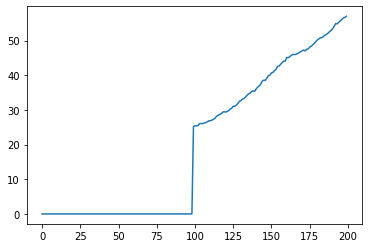

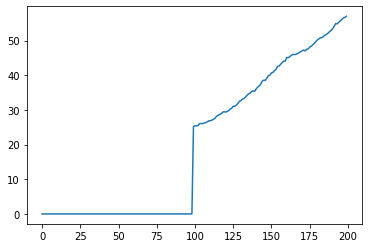

Episode 200 
 100 episode moving avg: 57.03
Episode 200 
 100 episode moving avg: 57.03


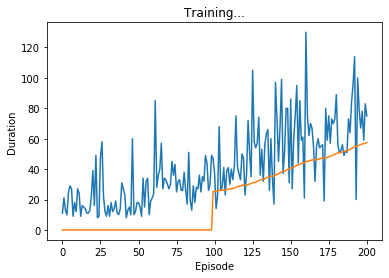

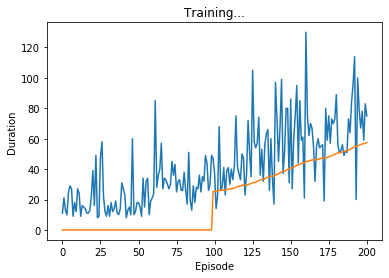

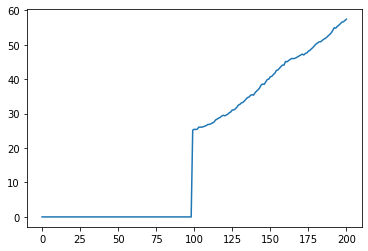

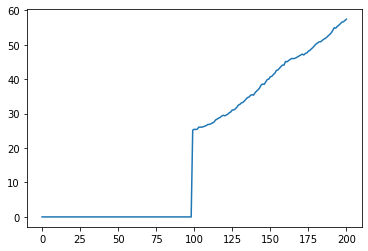

Episode 201 
 100 episode moving avg: 57.41
Episode 201 
 100 episode moving avg: 57.41


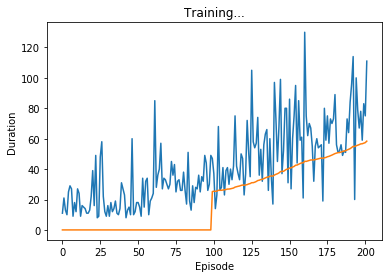

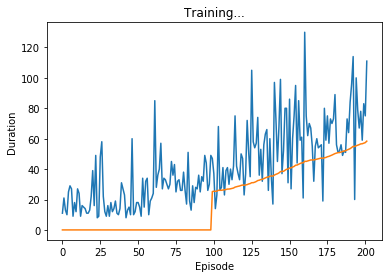

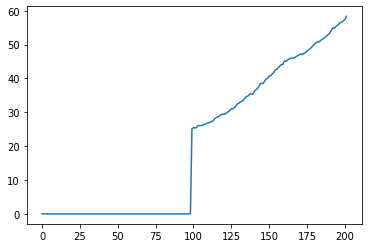

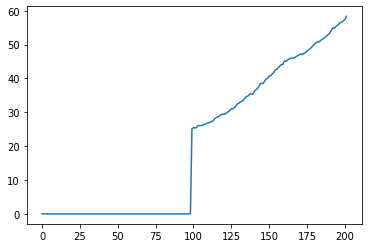

Episode 202 
 100 episode moving avg: 58.38
Episode 202 
 100 episode moving avg: 58.38


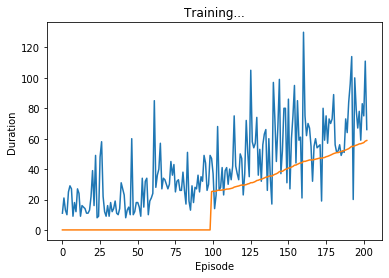

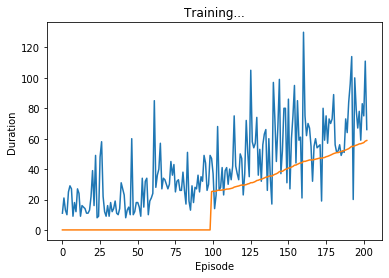

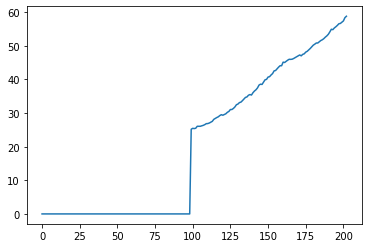

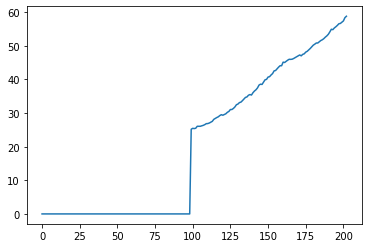

Episode 203 
 100 episode moving avg: 58.81
Episode 203 
 100 episode moving avg: 58.81


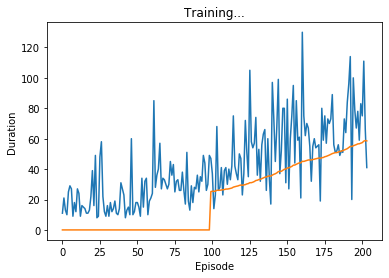

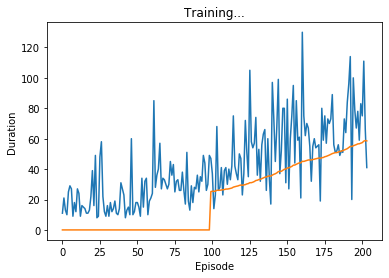

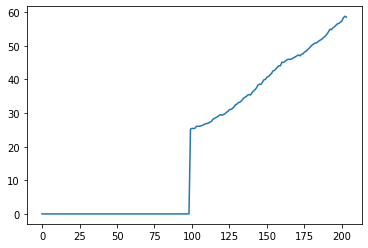

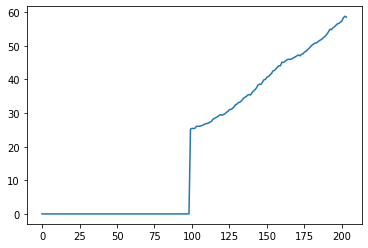

Episode 204 
 100 episode moving avg: 58.54
Episode 204 
 100 episode moving avg: 58.54


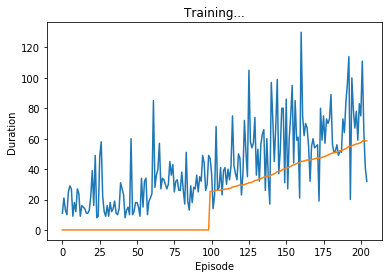

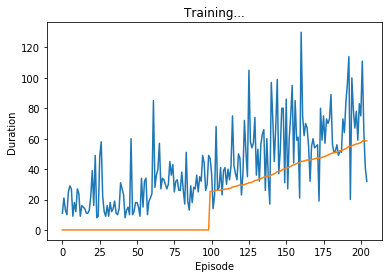

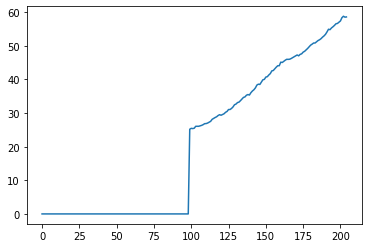

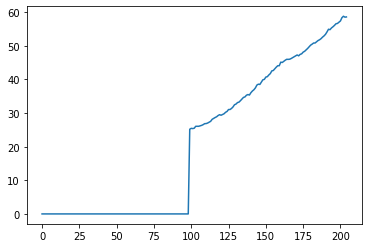

Episode 205 
 100 episode moving avg: 58.6
Episode 205 
 100 episode moving avg: 58.6


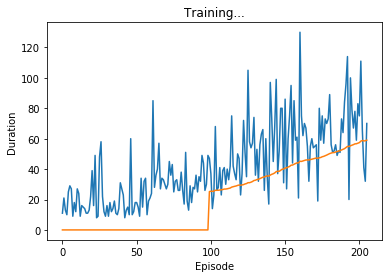

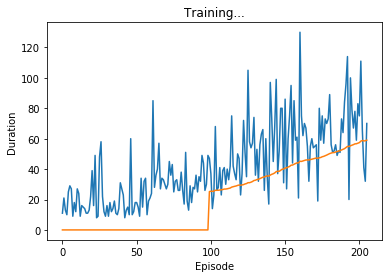

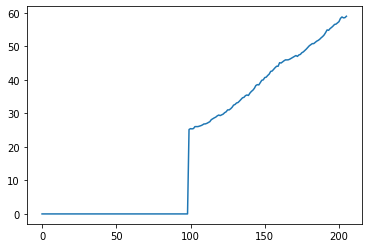

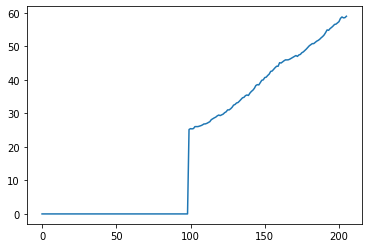

Episode 206 
 100 episode moving avg: 59.02
Episode 206 
 100 episode moving avg: 59.02


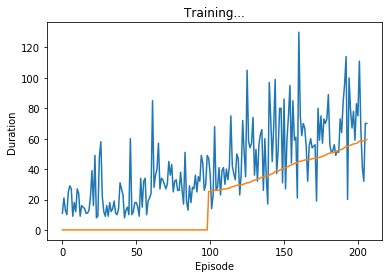

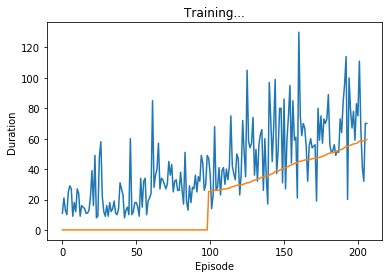

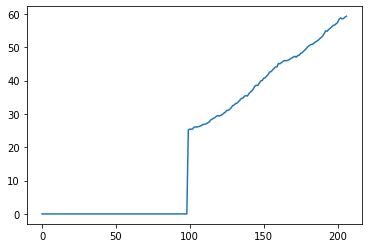

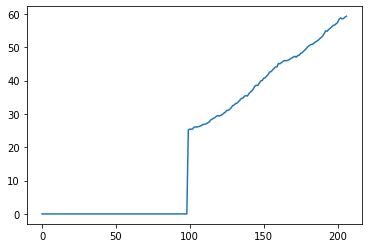

Episode 207 
 100 episode moving avg: 59.31
Episode 207 
 100 episode moving avg: 59.31


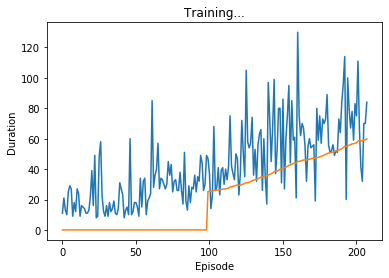

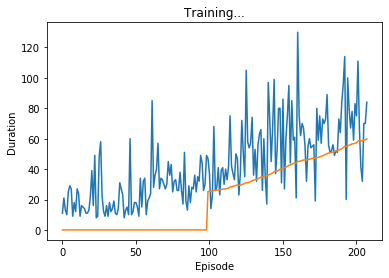

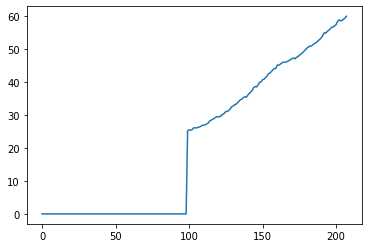

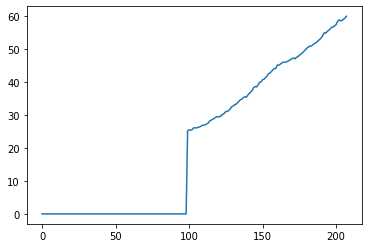

Episode 208 
 100 episode moving avg: 59.92
Episode 208 
 100 episode moving avg: 59.92


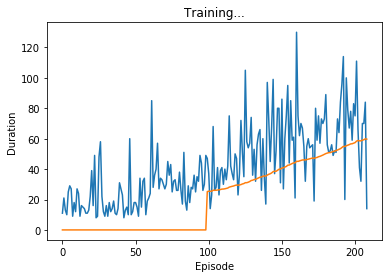

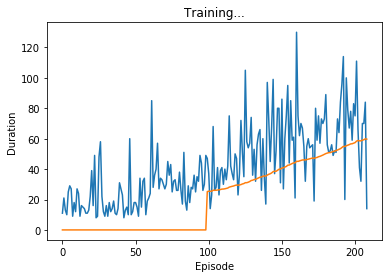

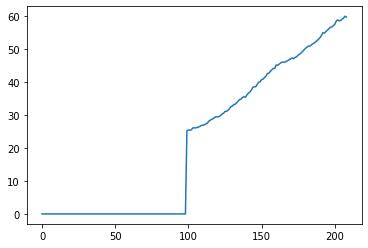

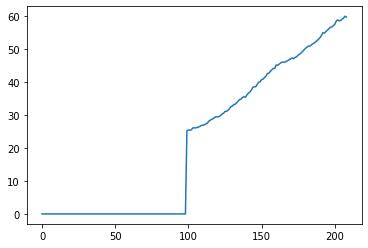

Episode 209 
 100 episode moving avg: 59.67
Episode 209 
 100 episode moving avg: 59.67


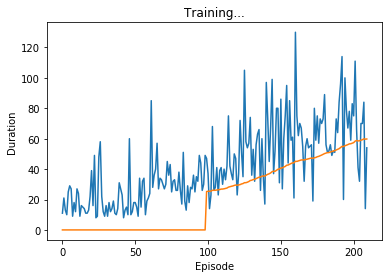

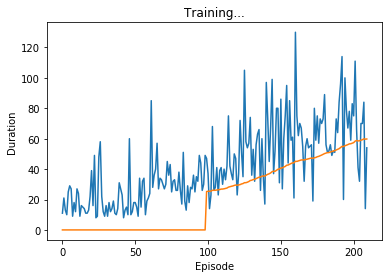

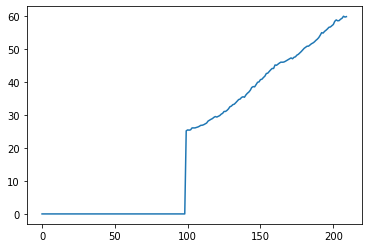

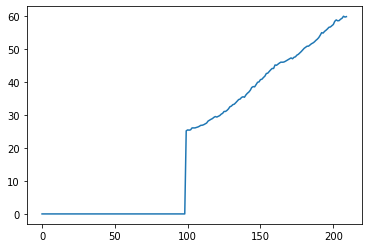

Episode 210 
 100 episode moving avg: 59.8
Episode 210 
 100 episode moving avg: 59.8


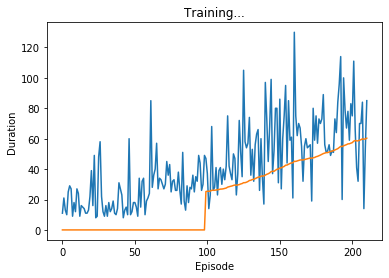

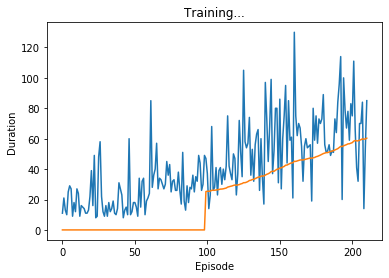

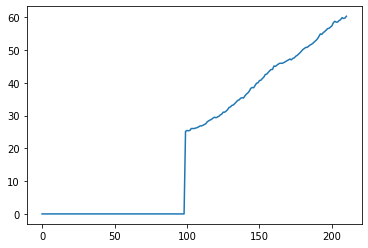

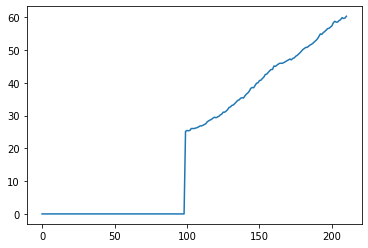

Episode 211 
 100 episode moving avg: 60.35
Episode 211 
 100 episode moving avg: 60.35


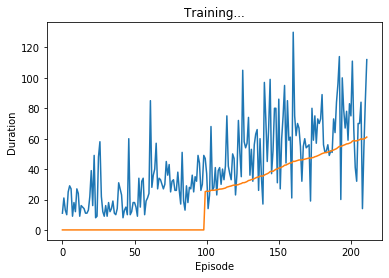

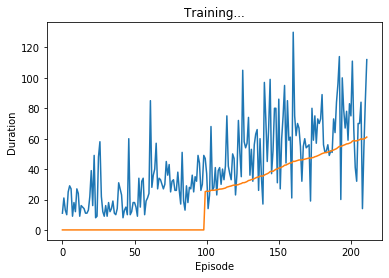

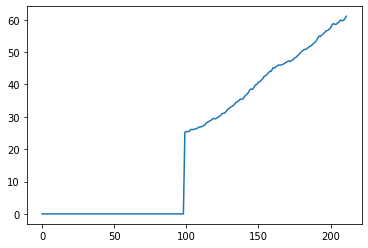

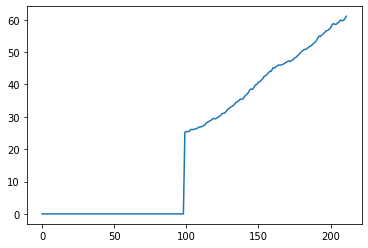

Episode 212 
 100 episode moving avg: 61.07
Episode 212 
 100 episode moving avg: 61.07


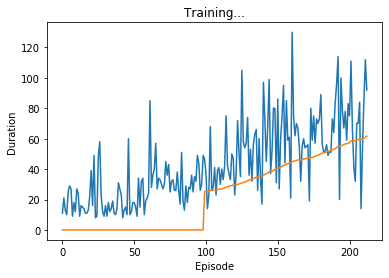

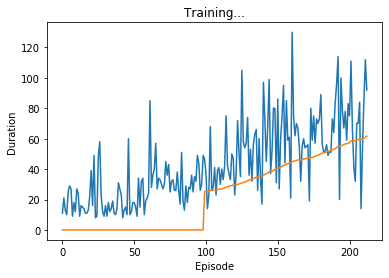

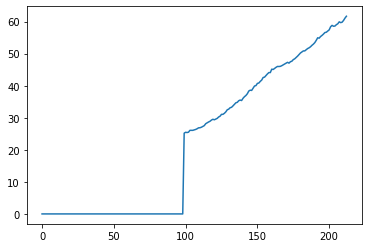

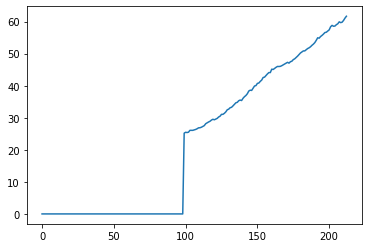

Episode 213 
 100 episode moving avg: 61.66
Episode 213 
 100 episode moving avg: 61.66


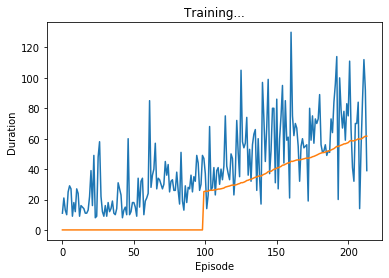

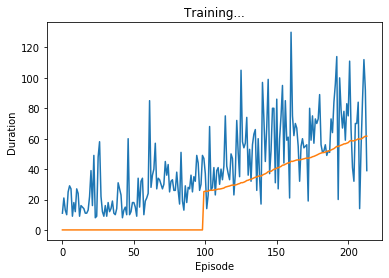

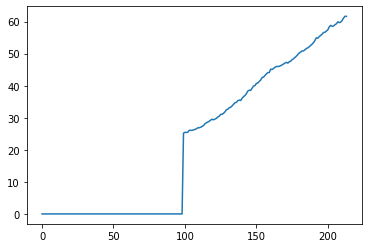

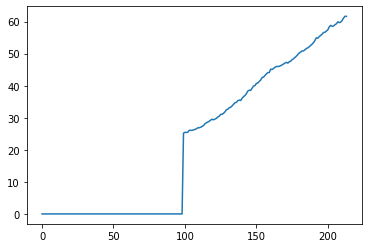

Episode 214 
 100 episode moving avg: 61.63
Episode 214 
 100 episode moving avg: 61.63


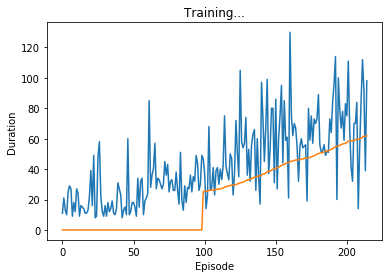

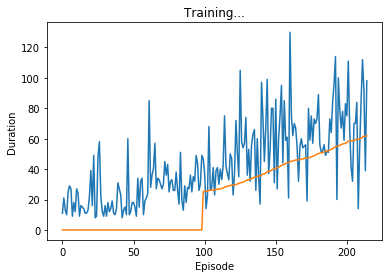

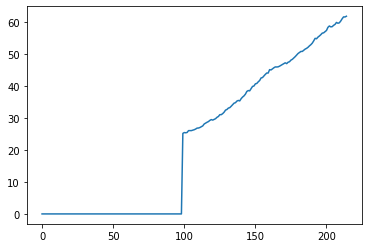

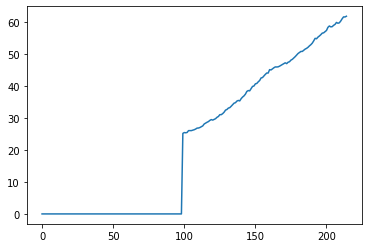

Episode 215 
 100 episode moving avg: 61.86
Episode 215 
 100 episode moving avg: 61.86


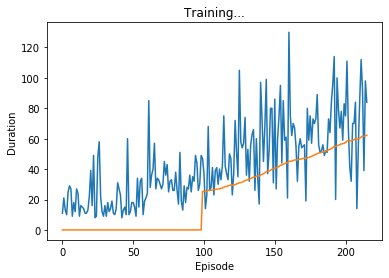

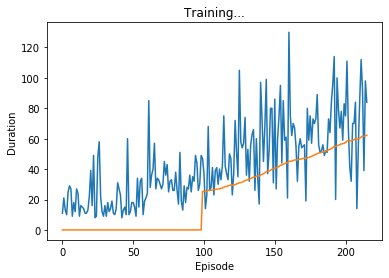

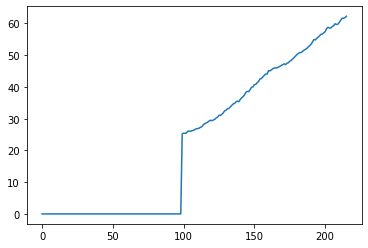

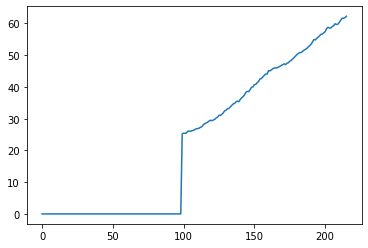

Episode 216 
 100 episode moving avg: 62.28
Episode 216 
 100 episode moving avg: 62.28


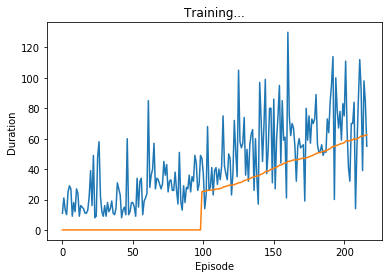

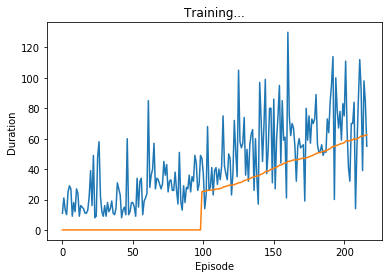

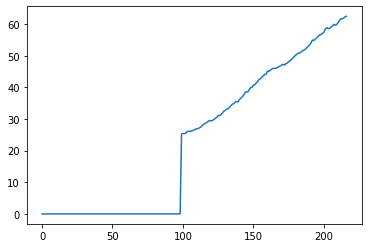

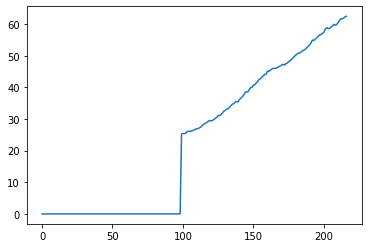

Episode 217 
 100 episode moving avg: 62.46
Episode 217 
 100 episode moving avg: 62.46


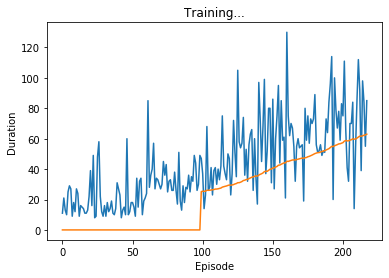

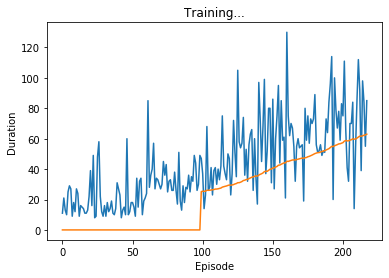

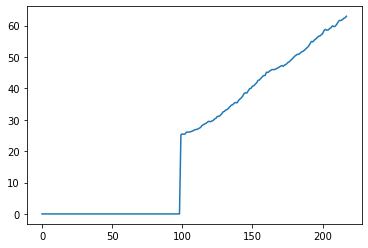

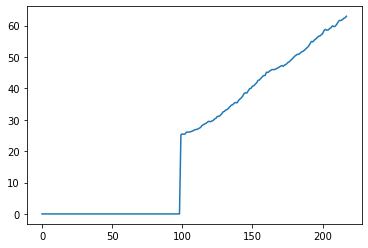

Episode 218 
 100 episode moving avg: 62.98
Episode 218 
 100 episode moving avg: 62.98


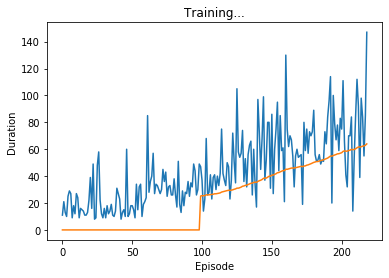

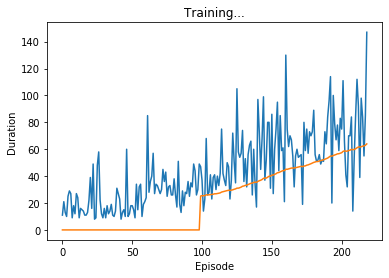

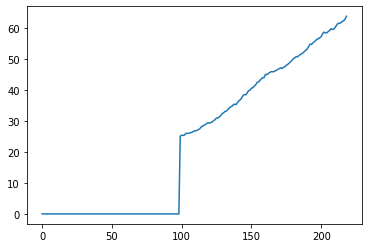

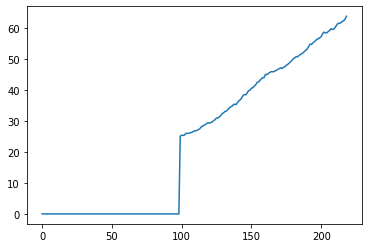

Episode 219 
 100 episode moving avg: 63.95
Episode 219 
 100 episode moving avg: 63.95


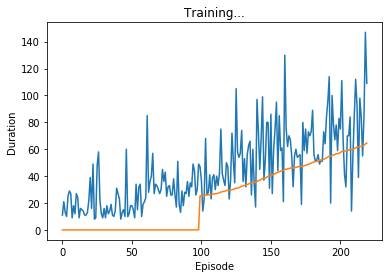

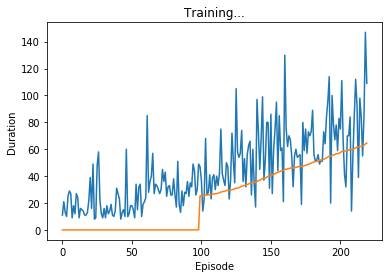

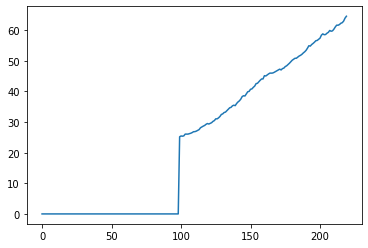

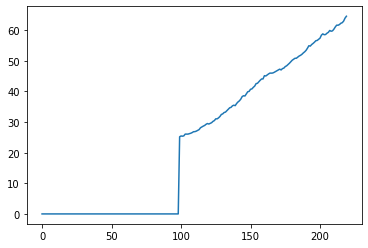

Episode 220 
 100 episode moving avg: 64.57
Episode 220 
 100 episode moving avg: 64.57


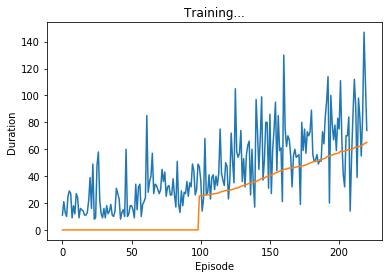

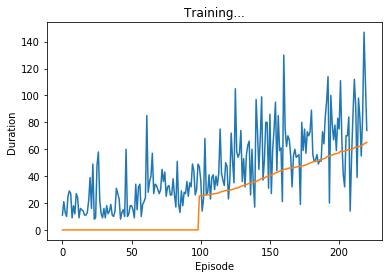

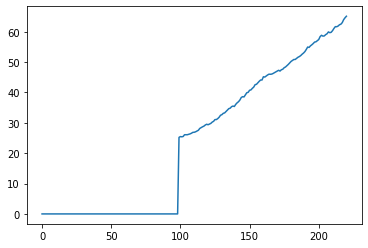

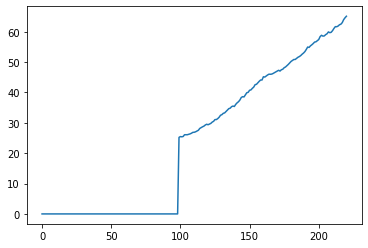

Episode 221 
 100 episode moving avg: 65.08
Episode 221 
 100 episode moving avg: 65.08


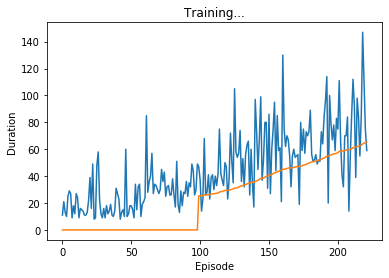

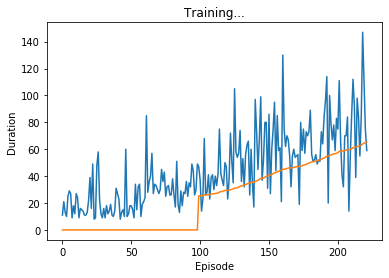

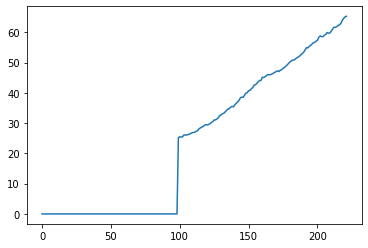

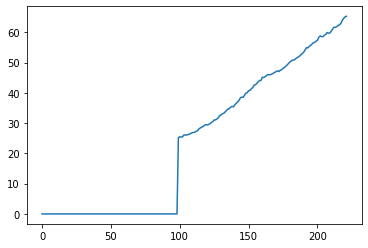

Episode 222 
 100 episode moving avg: 65.3
Episode 222 
 100 episode moving avg: 65.3


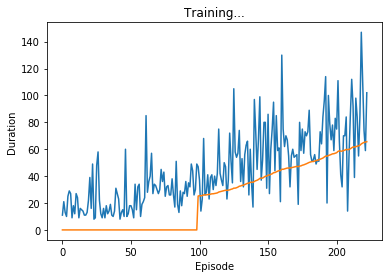

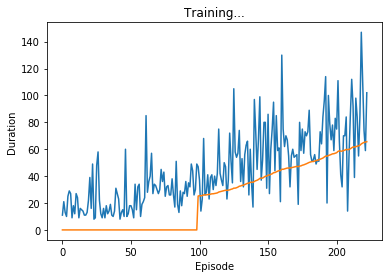

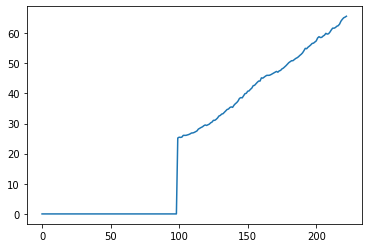

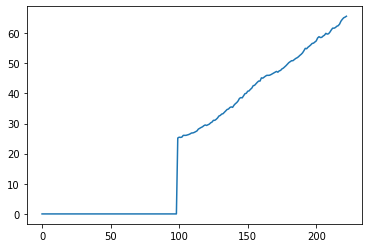

Episode 223 
 100 episode moving avg: 65.6
Episode 223 
 100 episode moving avg: 65.6


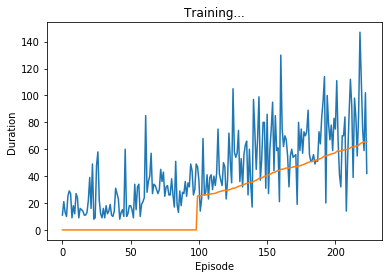

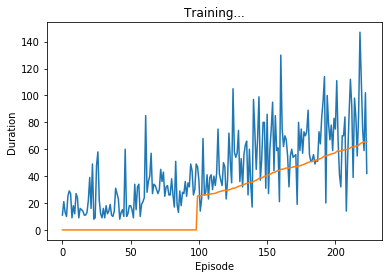

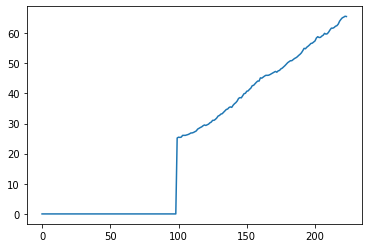

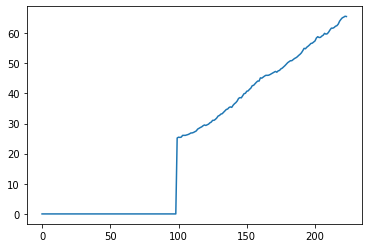

Episode 224 
 100 episode moving avg: 65.51
Episode 224 
 100 episode moving avg: 65.51


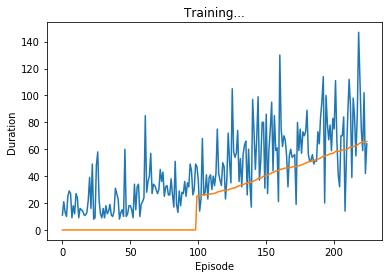

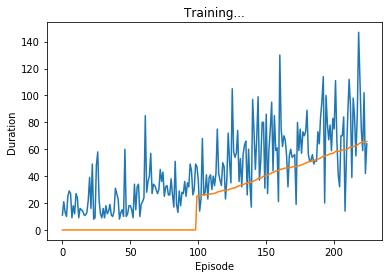

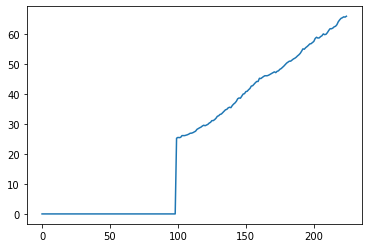

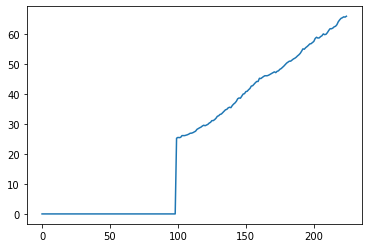

Episode 225 
 100 episode moving avg: 65.8
Episode 225 
 100 episode moving avg: 65.8


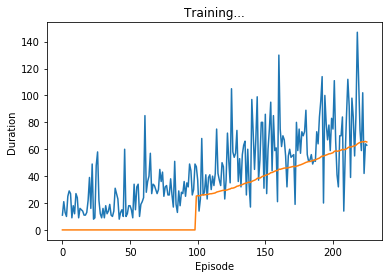

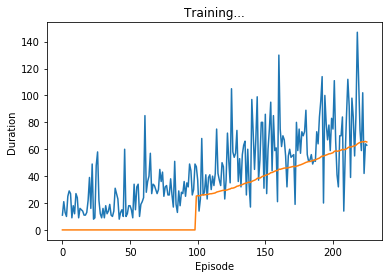

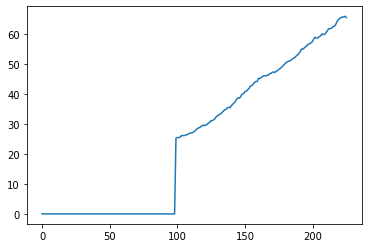

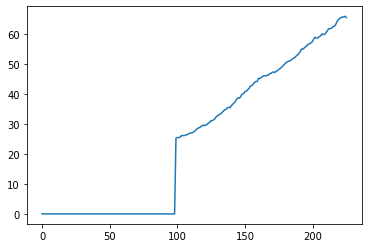

Episode 226 
 100 episode moving avg: 65.38
Episode 226 
 100 episode moving avg: 65.38


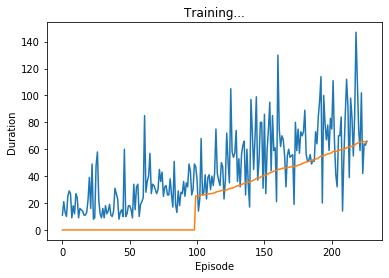

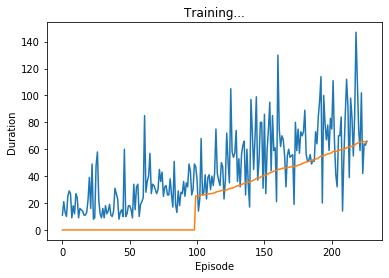

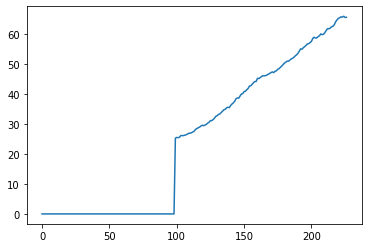

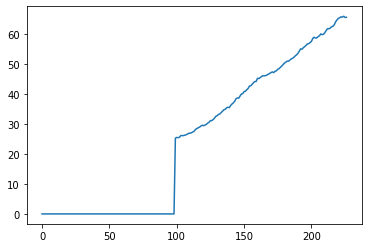

Episode 227 
 100 episode moving avg: 65.46
Episode 227 
 100 episode moving avg: 65.46


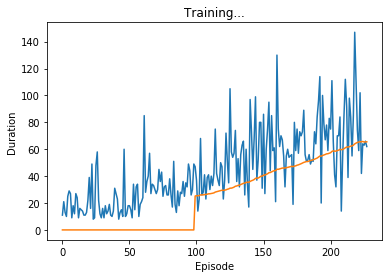

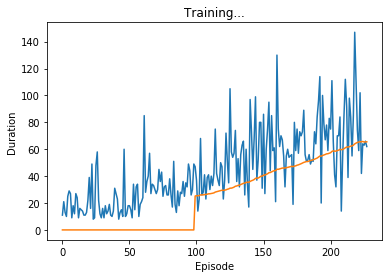

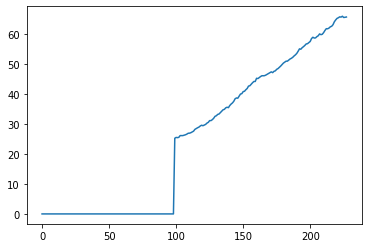

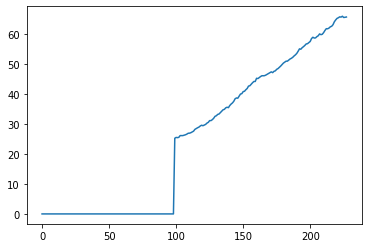

Episode 228 
 100 episode moving avg: 65.54
Episode 228 
 100 episode moving avg: 65.54


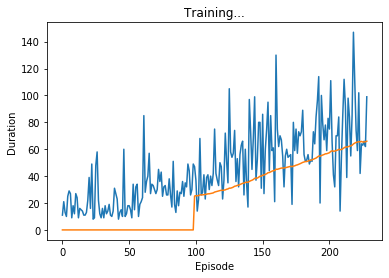

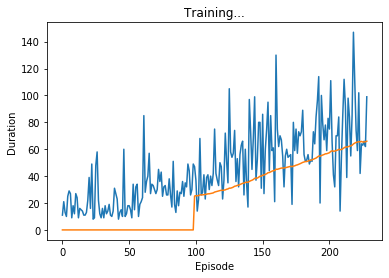

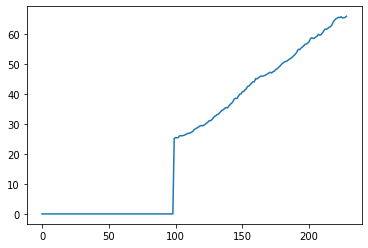

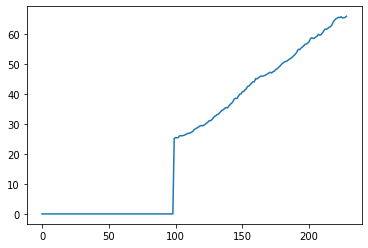

Episode 229 
 100 episode moving avg: 65.96
Episode 229 
 100 episode moving avg: 65.96


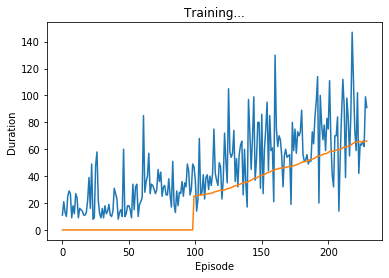

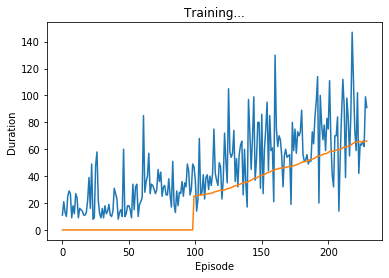

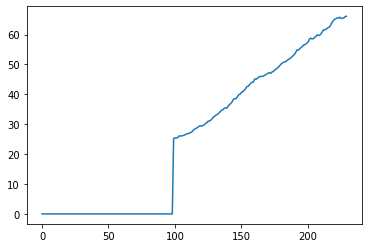

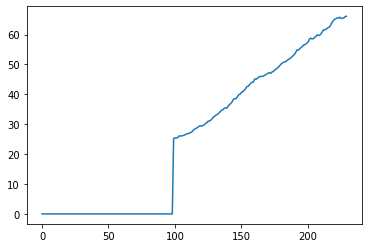

Episode 230 
 100 episode moving avg: 66.13
Episode 230 
 100 episode moving avg: 66.13


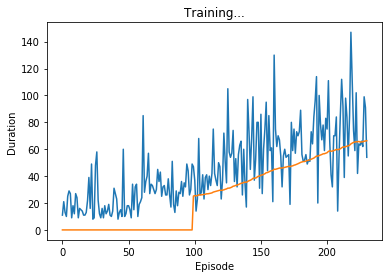

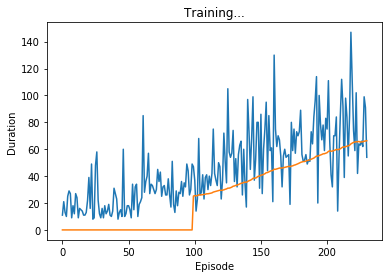

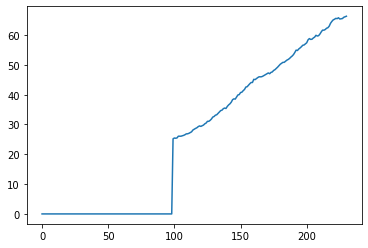

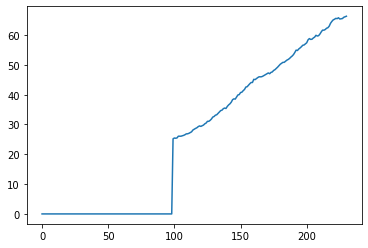

Episode 231 
 100 episode moving avg: 66.31
Episode 231 
 100 episode moving avg: 66.31


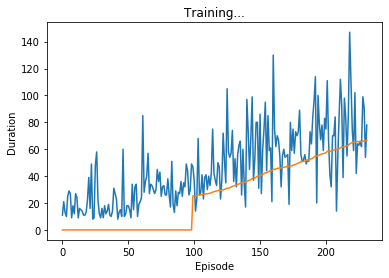

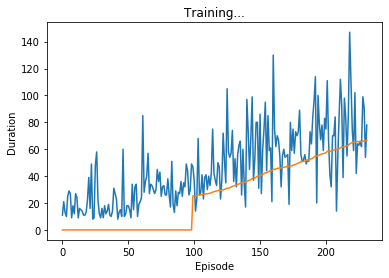

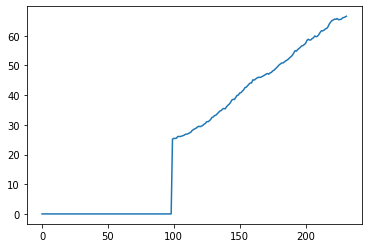

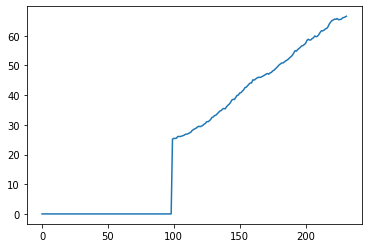

Episode 232 
 100 episode moving avg: 66.56
Episode 232 
 100 episode moving avg: 66.56


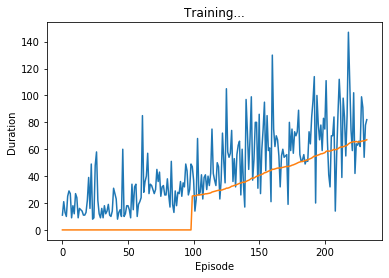

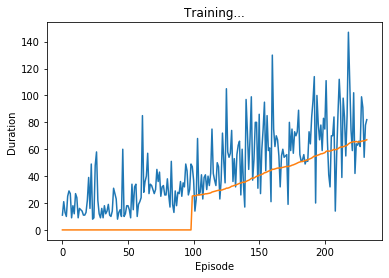

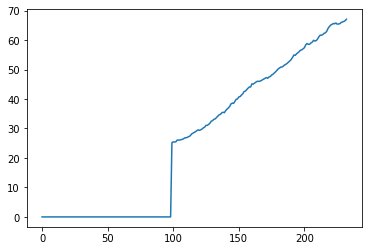

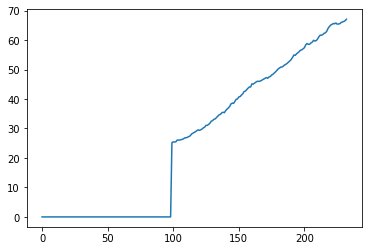

Episode 233 
 100 episode moving avg: 67.06
Episode 233 
 100 episode moving avg: 67.06


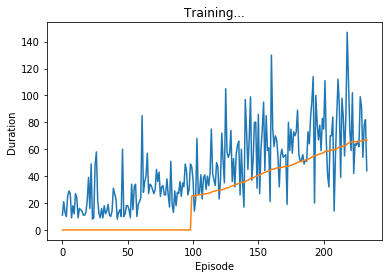

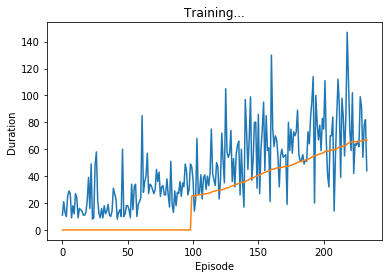

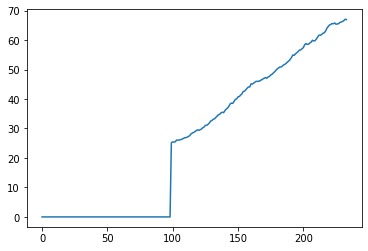

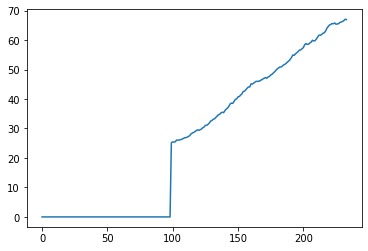

Episode 234 
 100 episode moving avg: 66.94
Episode 234 
 100 episode moving avg: 66.94


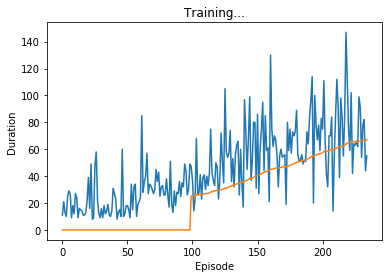

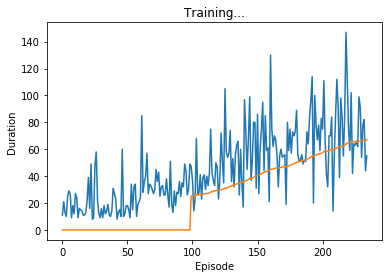

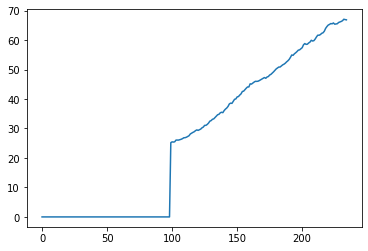

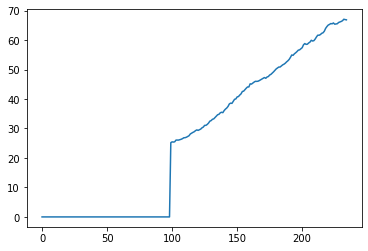

Episode 235 
 100 episode moving avg: 66.86
Episode 235 
 100 episode moving avg: 66.86


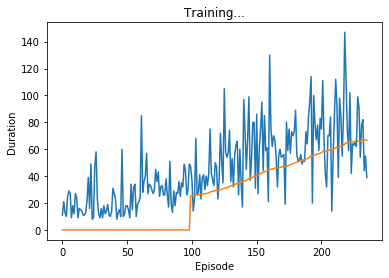

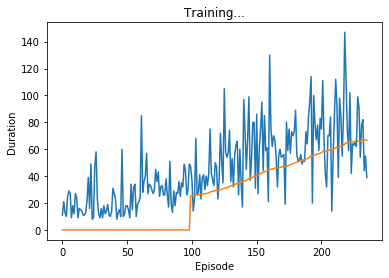

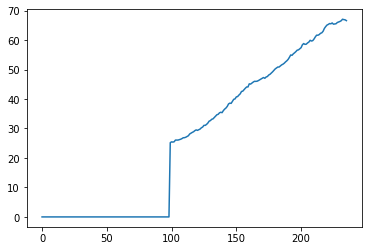

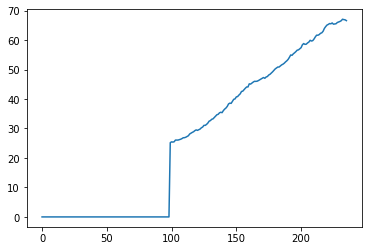

Episode 236 
 100 episode moving avg: 66.59
Episode 236 
 100 episode moving avg: 66.59


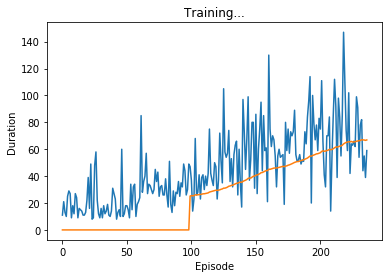

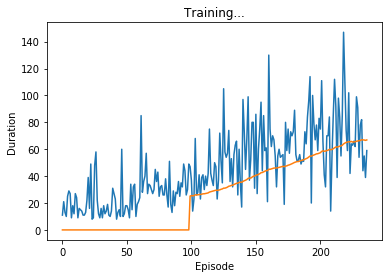

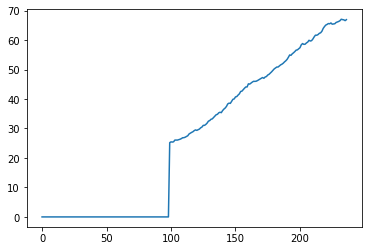

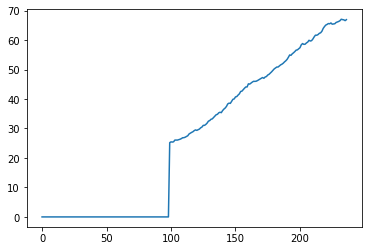

Episode 237 
 100 episode moving avg: 66.92
Episode 237 
 100 episode moving avg: 66.92


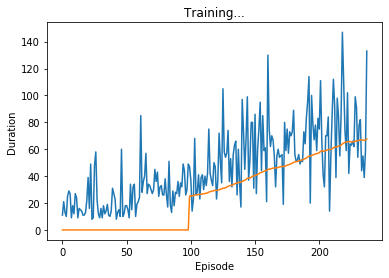

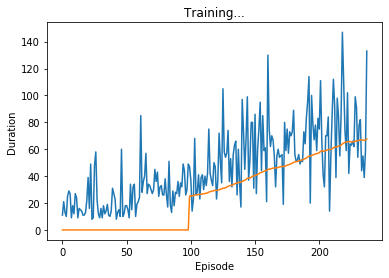

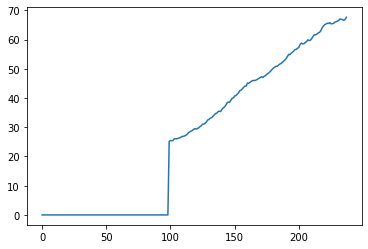

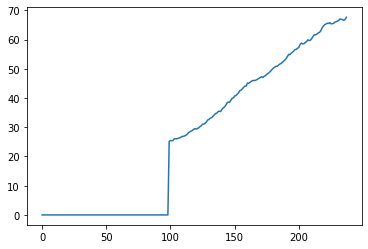

Episode 238 
 100 episode moving avg: 67.65
Episode 238 
 100 episode moving avg: 67.65


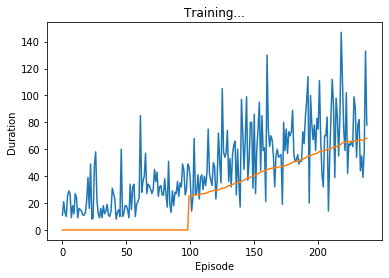

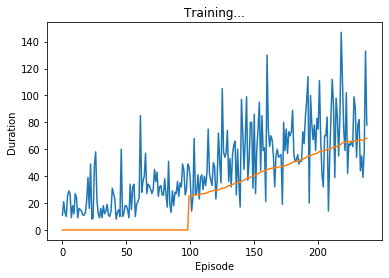

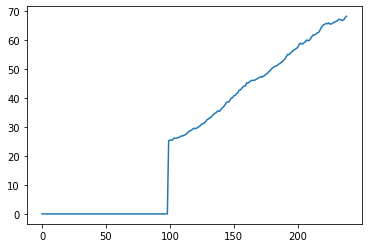

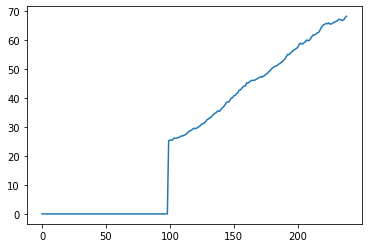

Episode 239 
 100 episode moving avg: 68.09
Episode 239 
 100 episode moving avg: 68.09


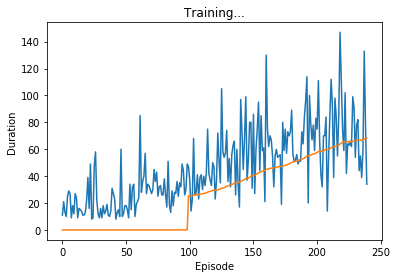

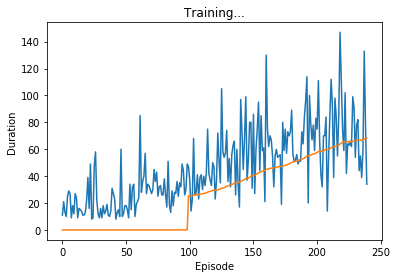

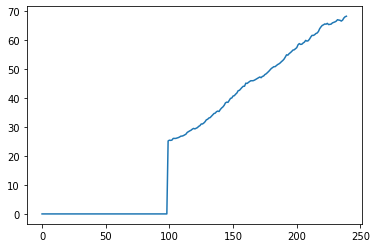

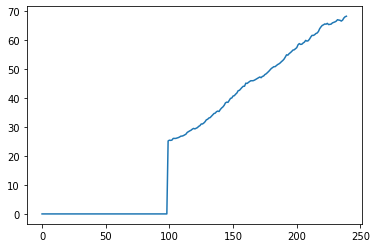

Episode 240 
 100 episode moving avg: 68.26
Episode 240 
 100 episode moving avg: 68.26


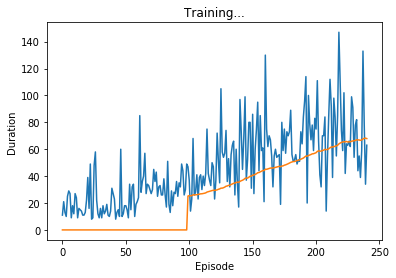

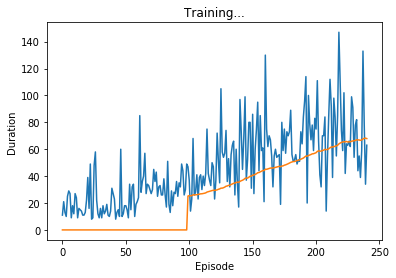

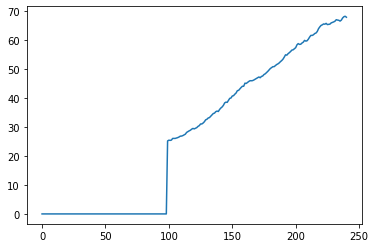

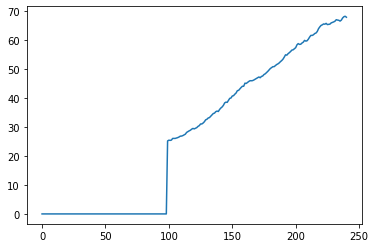

Episode 241 
 100 episode moving avg: 67.92
Episode 241 
 100 episode moving avg: 67.92


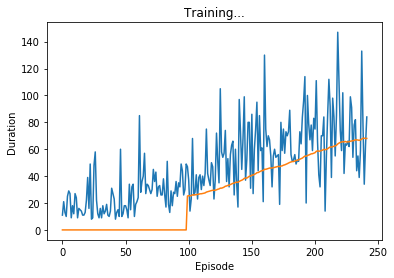

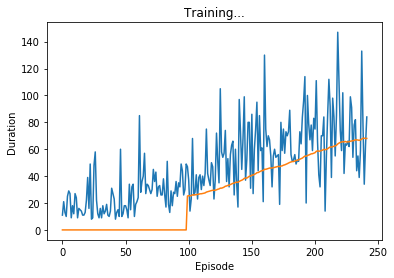

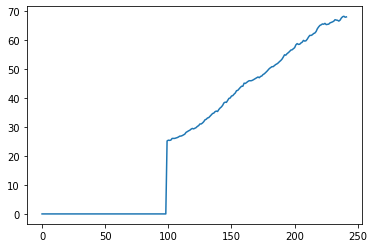

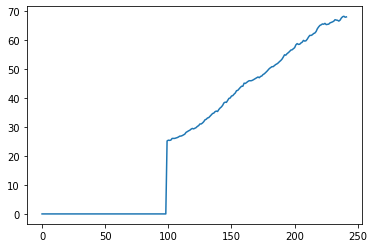

Episode 242 
 100 episode moving avg: 68.03
Episode 242 
 100 episode moving avg: 68.03


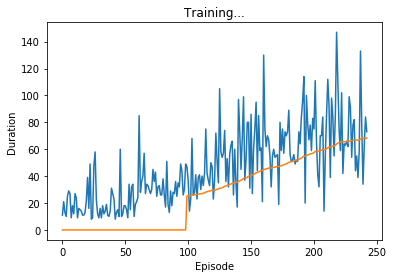

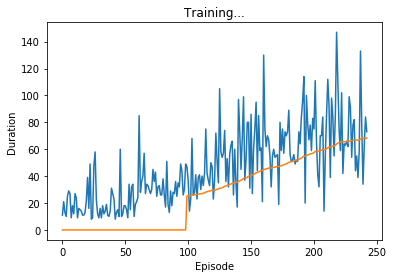

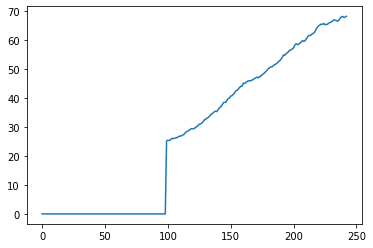

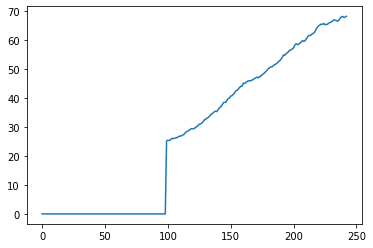

Episode 243 
 100 episode moving avg: 68.31
Episode 243 
 100 episode moving avg: 68.31


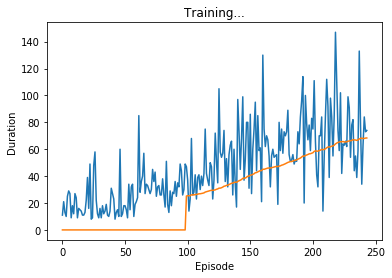

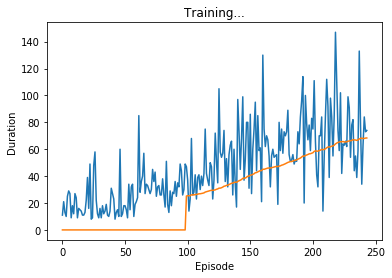

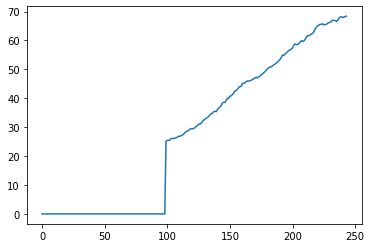

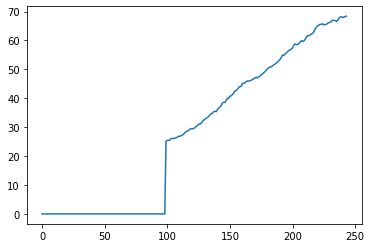

Episode 244 
 100 episode moving avg: 68.37
Episode 244 
 100 episode moving avg: 68.37


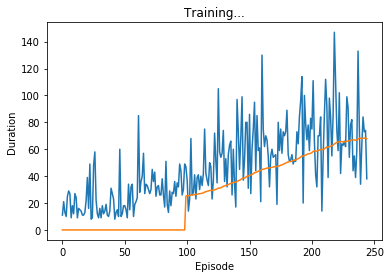

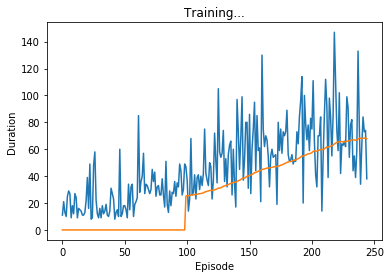

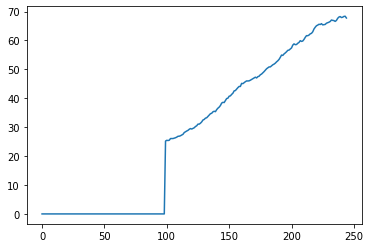

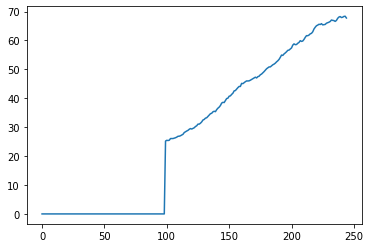

Episode 245 
 100 episode moving avg: 67.76
Episode 245 
 100 episode moving avg: 67.76


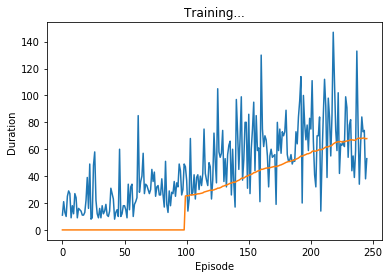

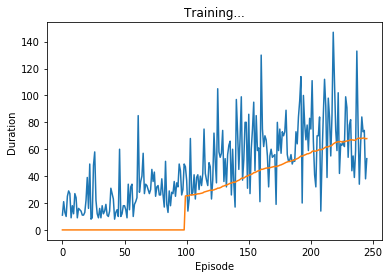

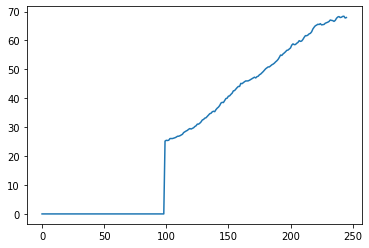

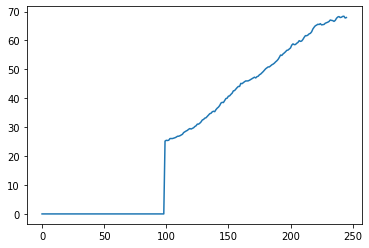

Episode 246 
 100 episode moving avg: 67.92
Episode 246 
 100 episode moving avg: 67.92


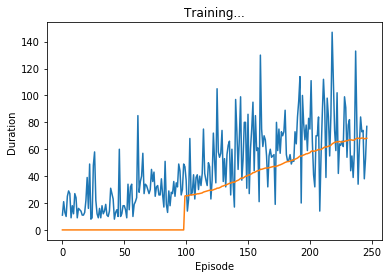

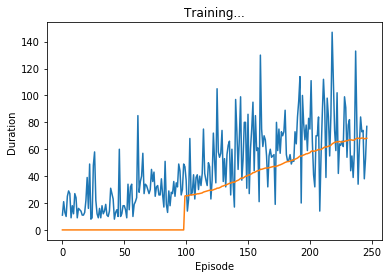

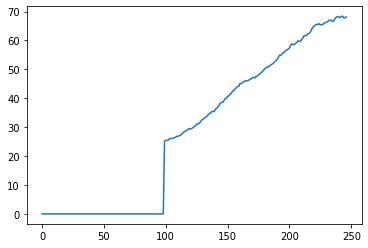

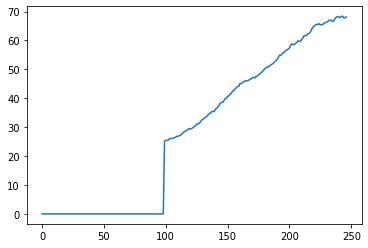

Episode 247 
 100 episode moving avg: 68.17
Episode 247 
 100 episode moving avg: 68.17


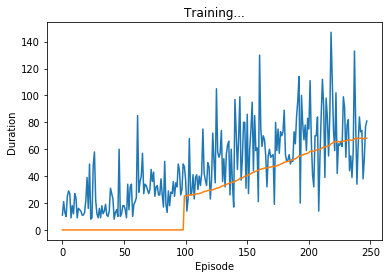

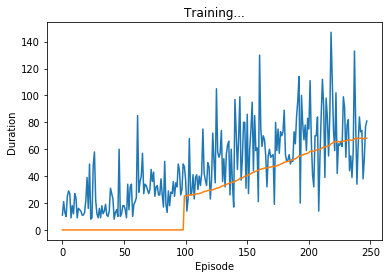

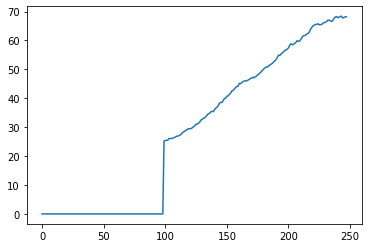

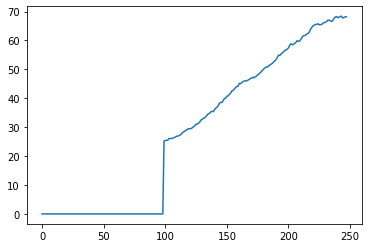

Episode 248 
 100 episode moving avg: 68.18
Episode 248 
 100 episode moving avg: 68.18


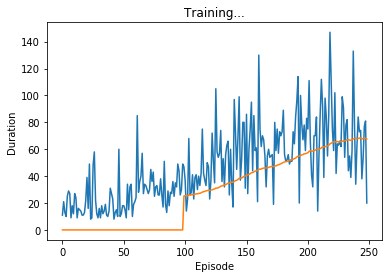

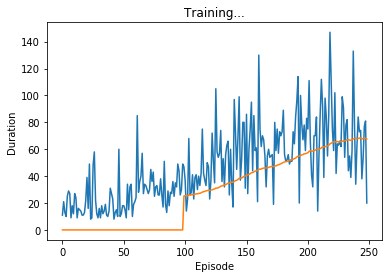

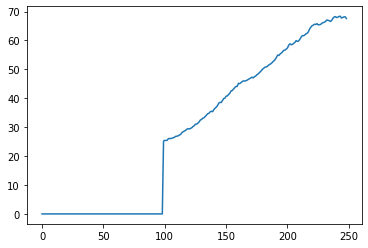

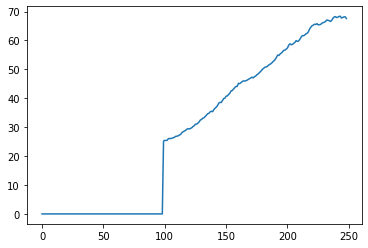

Episode 249 
 100 episode moving avg: 67.58
Episode 249 
 100 episode moving avg: 67.58


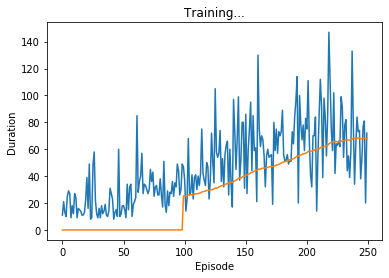

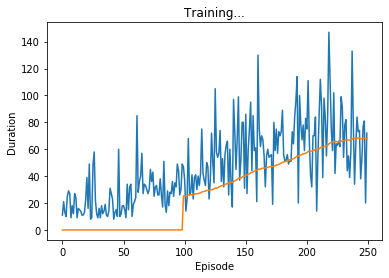

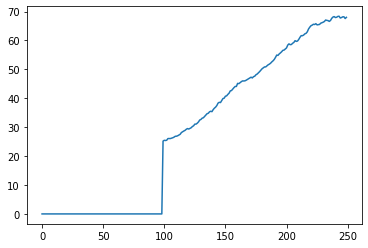

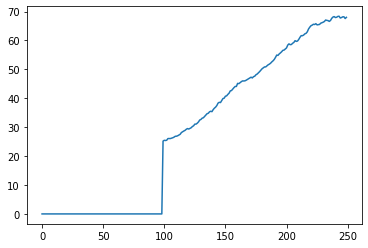

Episode 250 
 100 episode moving avg: 67.99
Episode 250 
 100 episode moving avg: 67.99


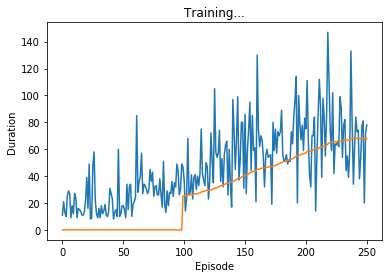

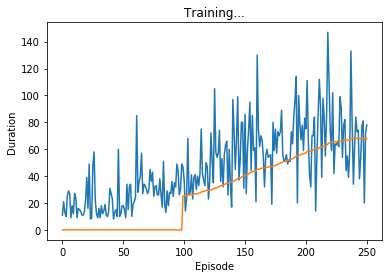

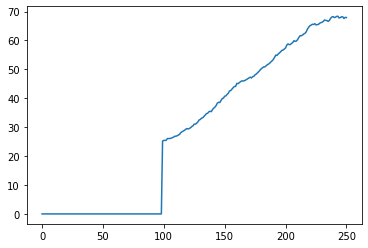

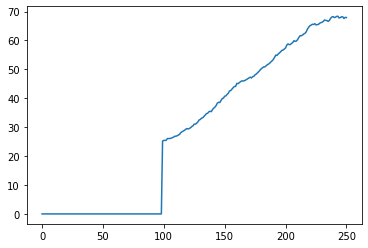

Episode 251 
 100 episode moving avg: 67.91
Episode 251 
 100 episode moving avg: 67.91


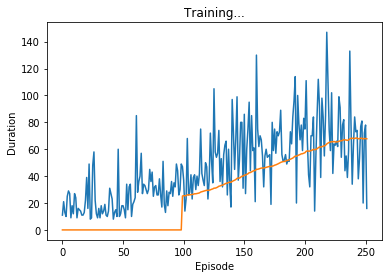

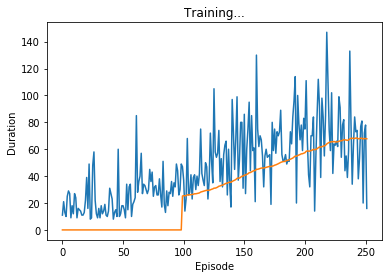

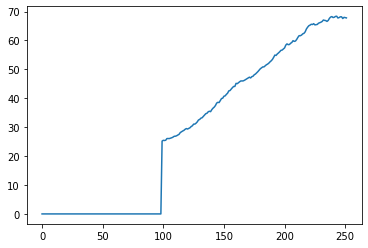

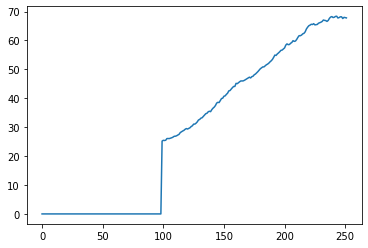

Episode 252 
 100 episode moving avg: 67.8
Episode 252 
 100 episode moving avg: 67.8


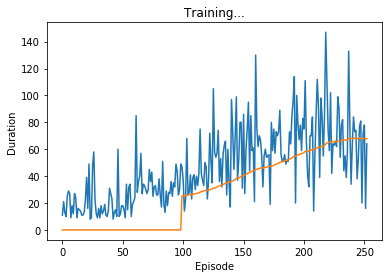

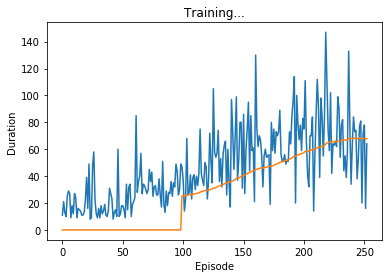

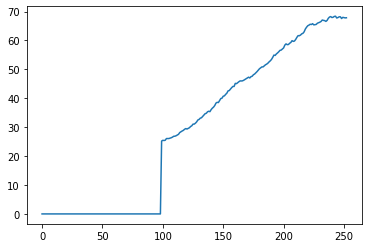

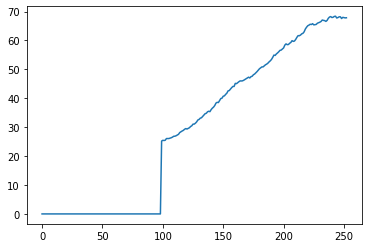

Episode 253 
 100 episode moving avg: 67.84
Episode 253 
 100 episode moving avg: 67.84


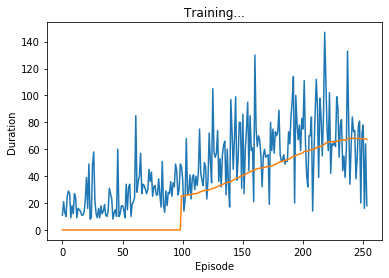

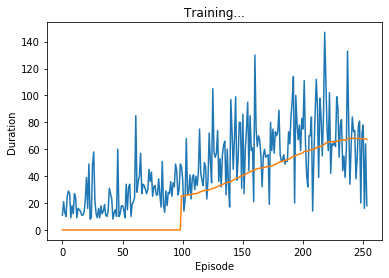

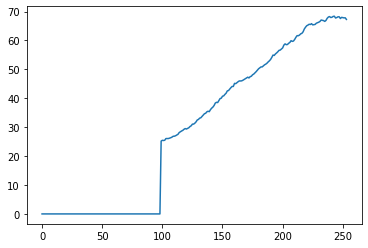

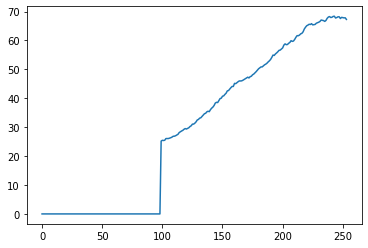

Episode 254 
 100 episode moving avg: 67.27
Episode 254 
 100 episode moving avg: 67.27


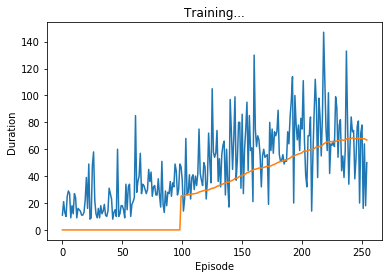

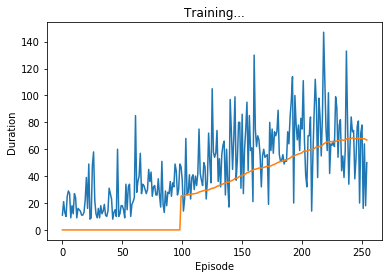

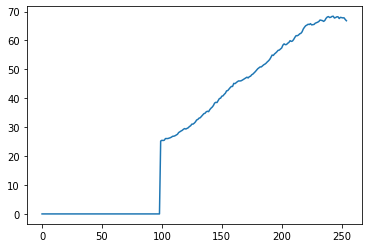

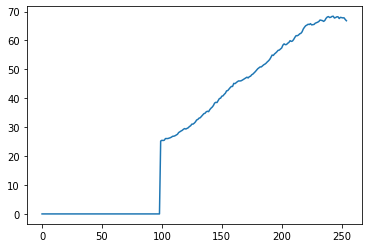

Episode 255 
 100 episode moving avg: 66.82
Episode 255 
 100 episode moving avg: 66.82


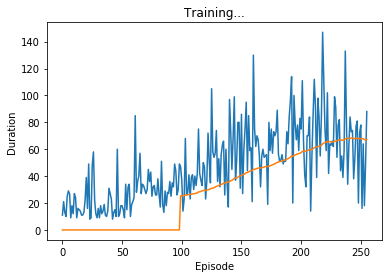

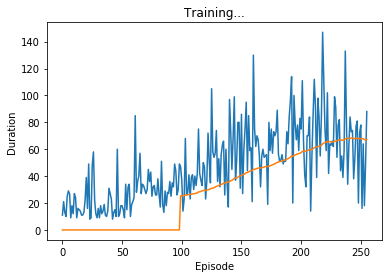

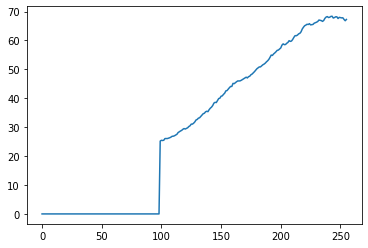

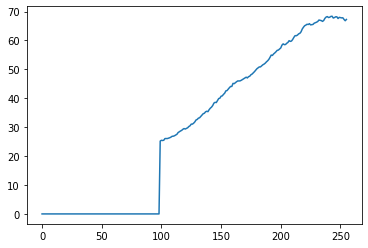

Episode 256 
 100 episode moving avg: 67.26
Episode 256 
 100 episode moving avg: 67.26


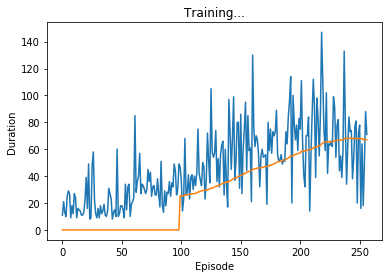

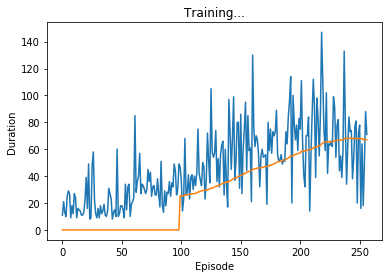

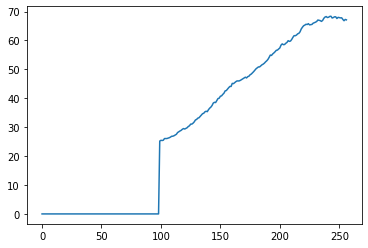

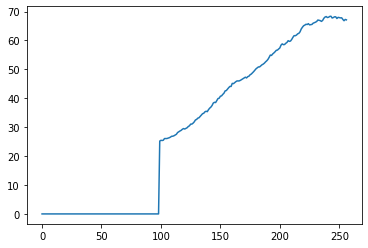

Episode 257 
 100 episode moving avg: 67.12
Episode 257 
 100 episode moving avg: 67.12


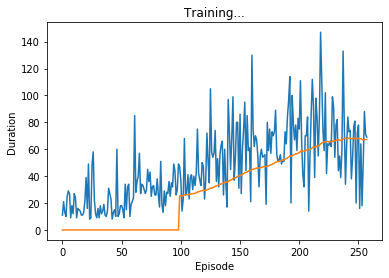

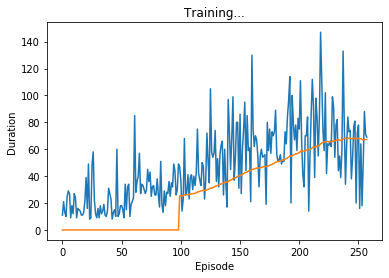

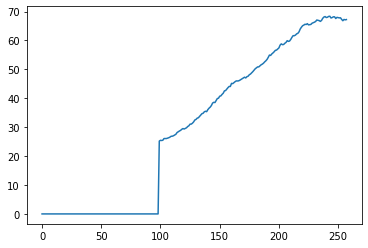

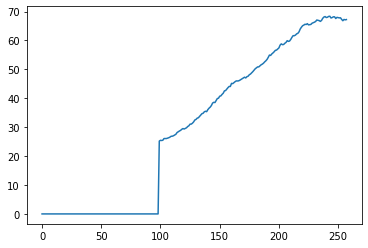

Episode 258 
 100 episode moving avg: 67.22
Episode 258 
 100 episode moving avg: 67.22


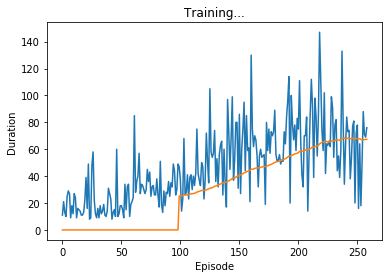

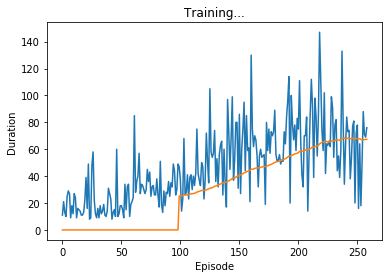

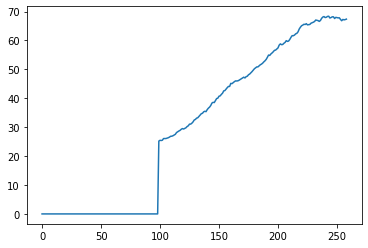

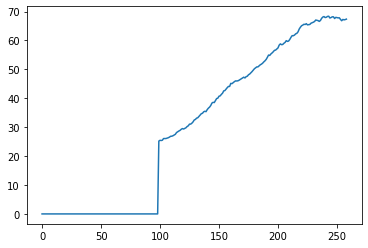

Episode 259 
 100 episode moving avg: 67.37
Episode 259 
 100 episode moving avg: 67.37


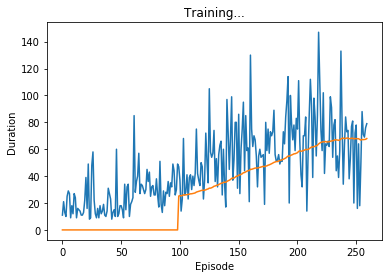

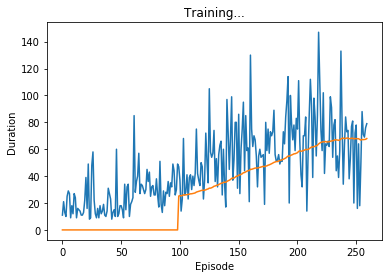

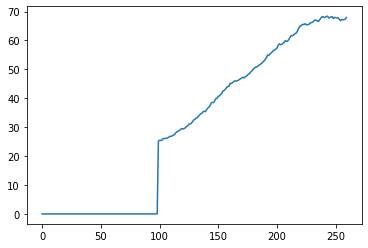

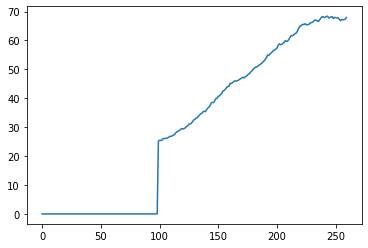

Episode 260 
 100 episode moving avg: 67.95
Episode 260 
 100 episode moving avg: 67.95


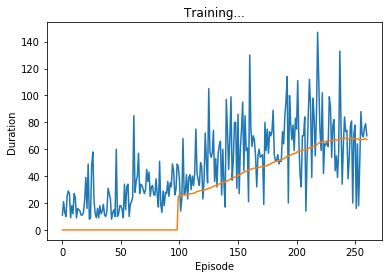

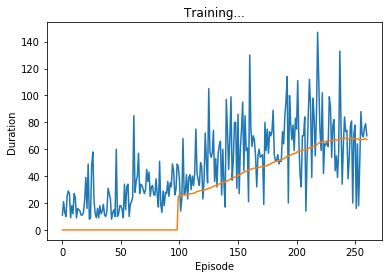

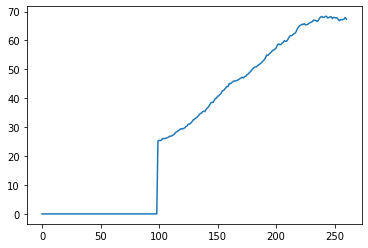

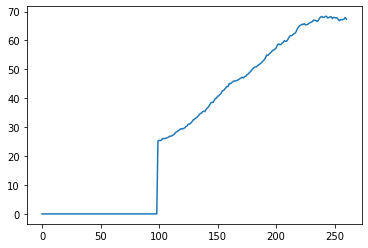

Episode 261 
 100 episode moving avg: 67.35
Episode 261 
 100 episode moving avg: 67.35


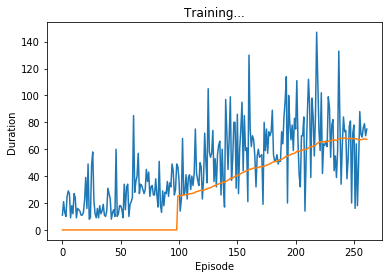

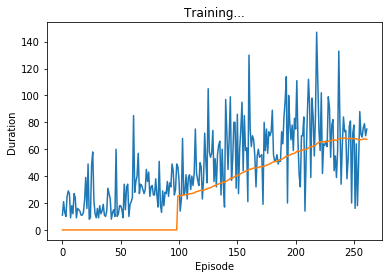

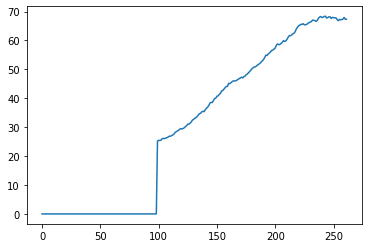

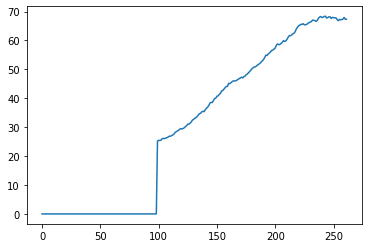

Episode 262 
 100 episode moving avg: 67.35
Episode 262 
 100 episode moving avg: 67.35


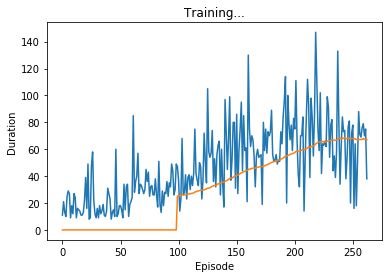

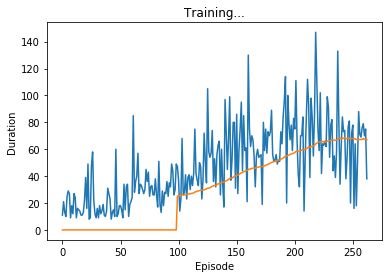

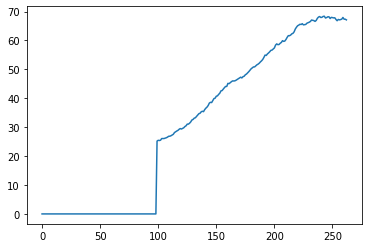

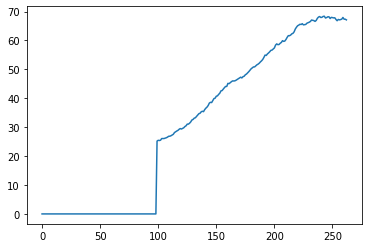

Episode 263 
 100 episode moving avg: 67.11
Episode 263 
 100 episode moving avg: 67.11


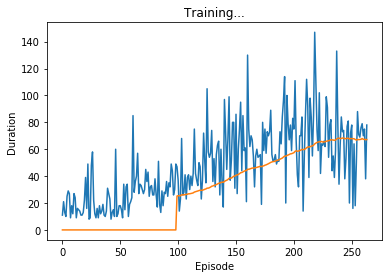

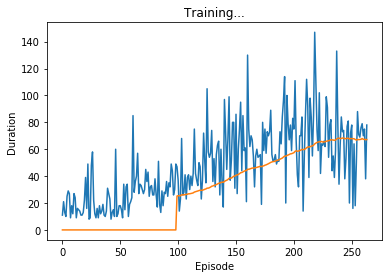

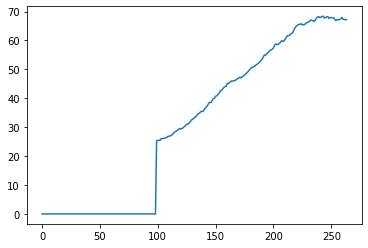

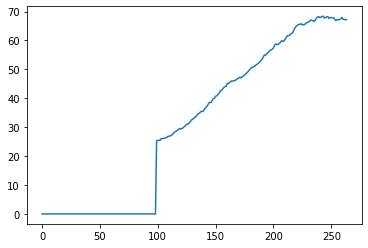

Episode 264 
 100 episode moving avg: 67.19
Episode 264 
 100 episode moving avg: 67.19


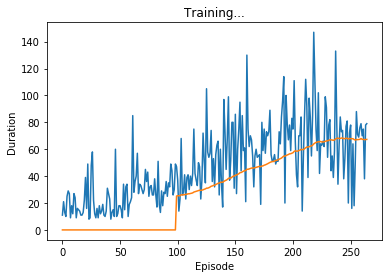

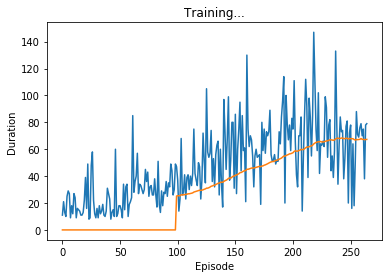

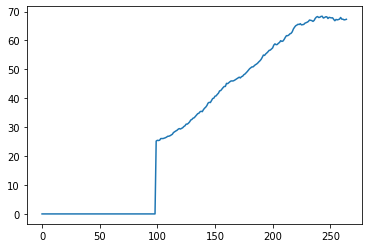

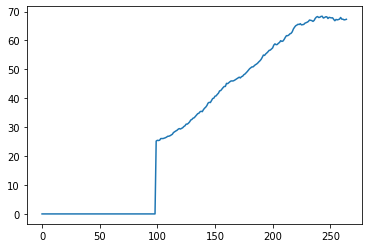

Episode 265 
 100 episode moving avg: 67.31
Episode 265 
 100 episode moving avg: 67.31


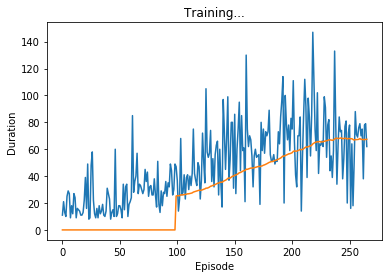

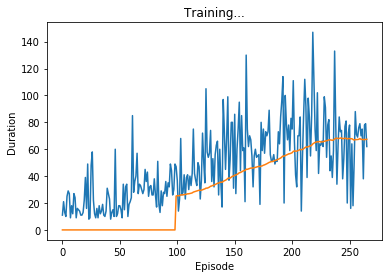

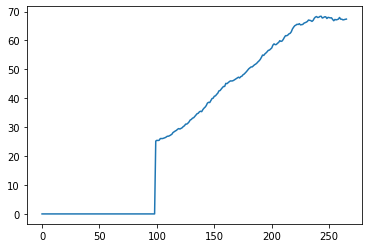

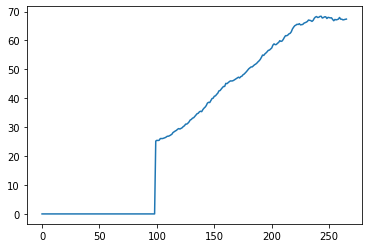

Episode 266 
 100 episode moving avg: 67.38
Episode 266 
 100 episode moving avg: 67.38


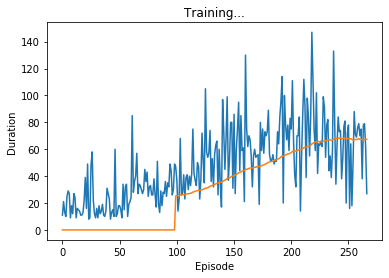

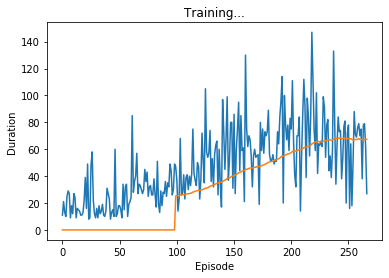

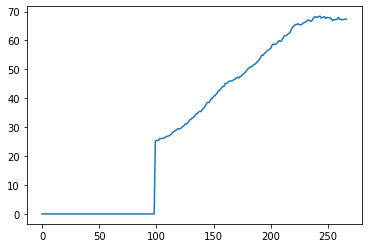

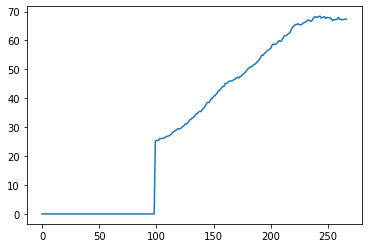

Episode 267 
 100 episode moving avg: 67.33
Episode 267 
 100 episode moving avg: 67.33


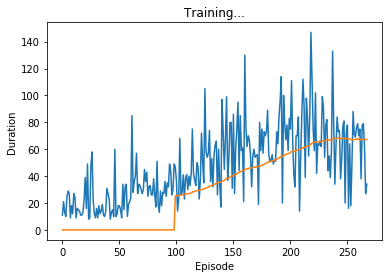

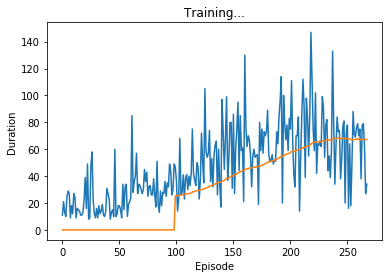

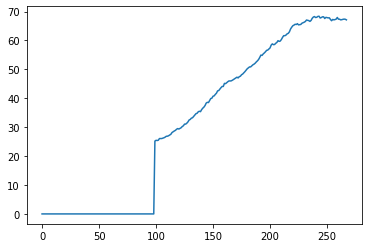

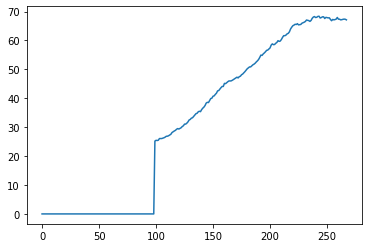

Episode 268 
 100 episode moving avg: 67.12
Episode 268 
 100 episode moving avg: 67.12


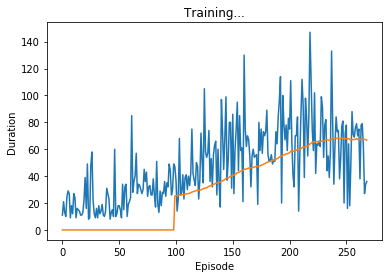

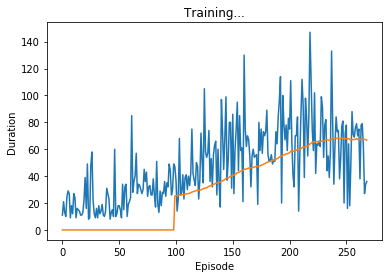

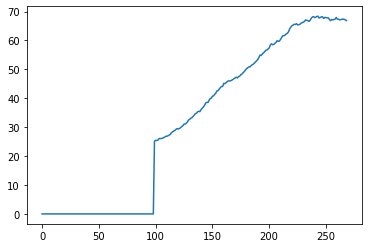

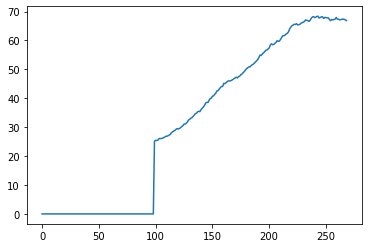

Episode 269 
 100 episode moving avg: 66.88
Episode 269 
 100 episode moving avg: 66.88


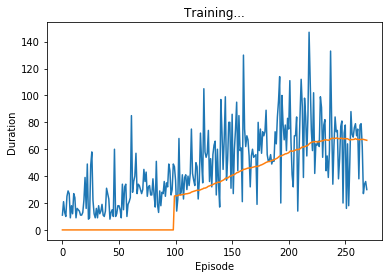

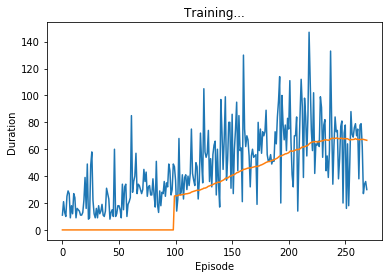

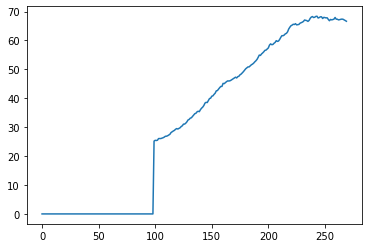

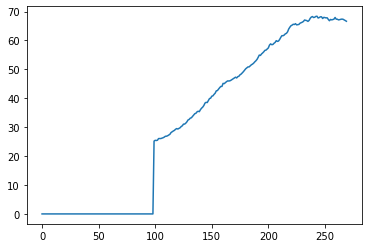

Episode 270 
 100 episode moving avg: 66.64
Episode 270 
 100 episode moving avg: 66.64


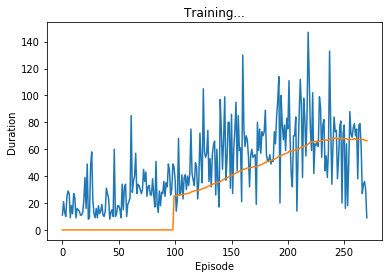

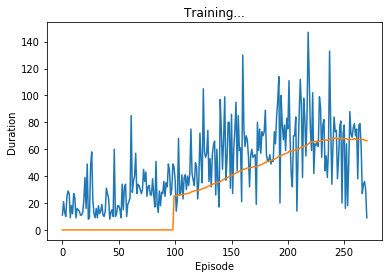

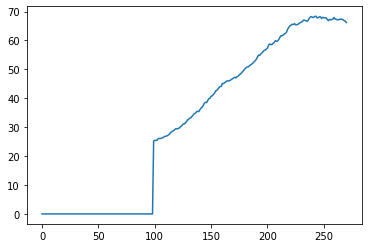

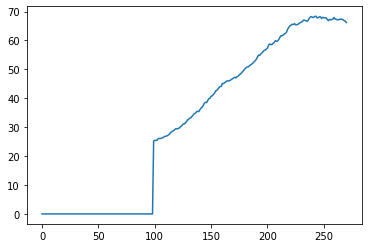

Episode 271 
 100 episode moving avg: 66.18
Episode 271 
 100 episode moving avg: 66.18


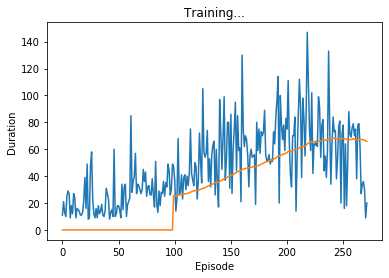

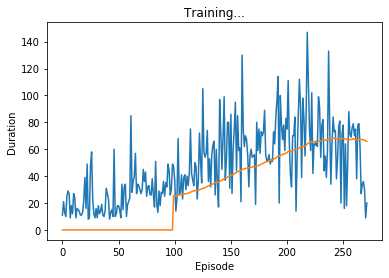

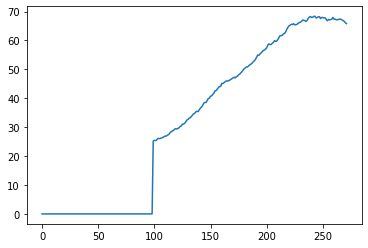

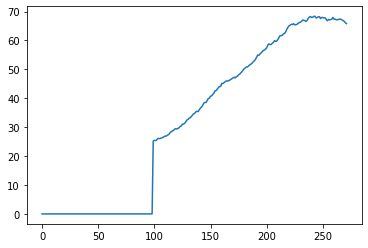

Episode 272 
 100 episode moving avg: 65.82
Episode 272 
 100 episode moving avg: 65.82


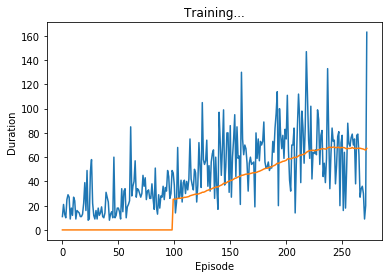

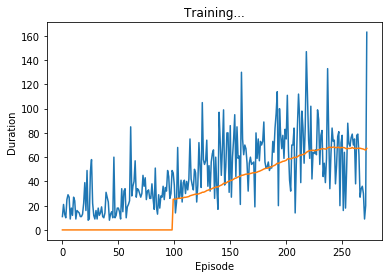

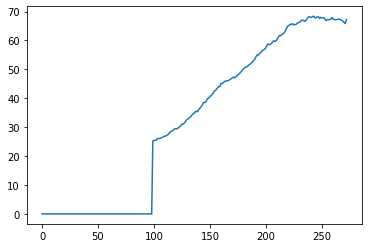

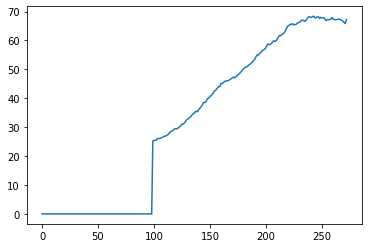

Episode 273 
 100 episode moving avg: 67.26
Episode 273 
 100 episode moving avg: 67.26


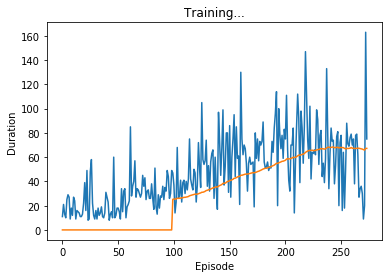

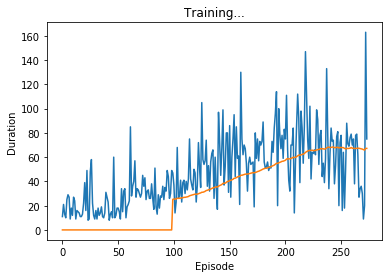

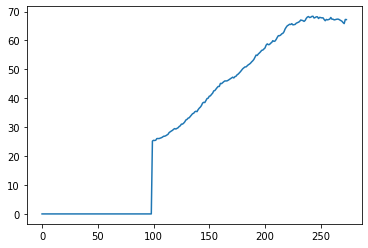

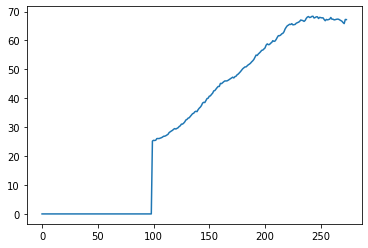

Episode 274 
 100 episode moving avg: 67.21
Episode 274 
 100 episode moving avg: 67.21


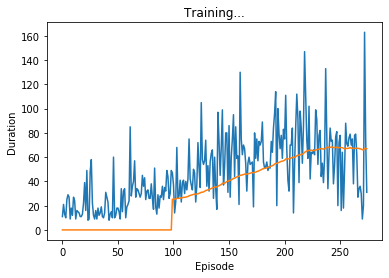

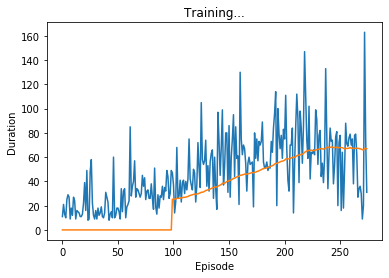

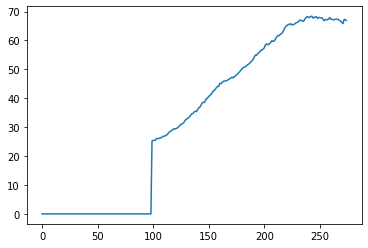

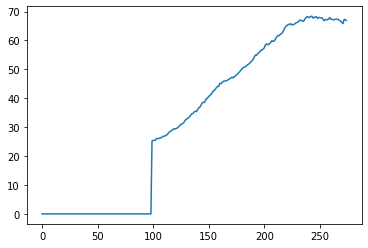

Episode 275 
 100 episode moving avg: 66.93
Episode 275 
 100 episode moving avg: 66.93


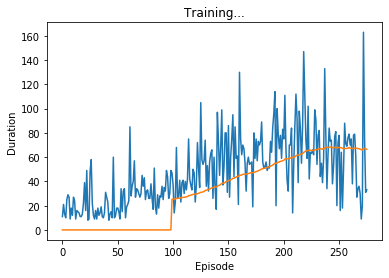

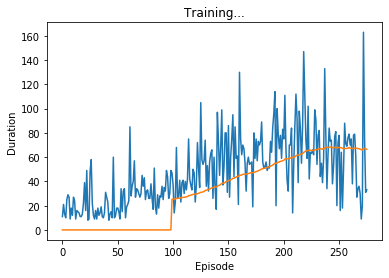

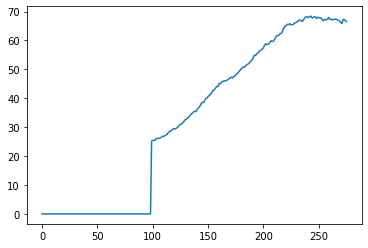

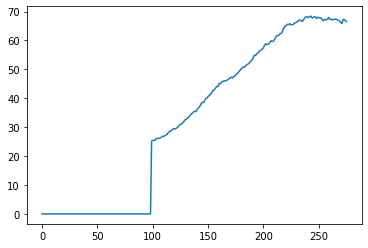

Episode 276 
 100 episode moving avg: 66.51
Episode 276 
 100 episode moving avg: 66.51


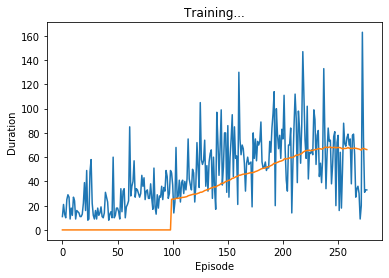

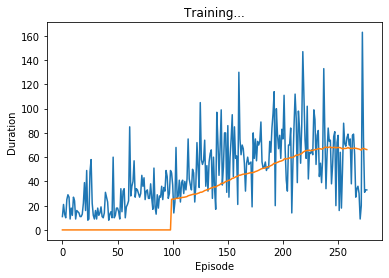

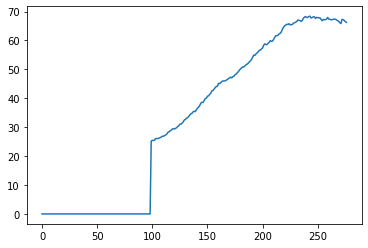

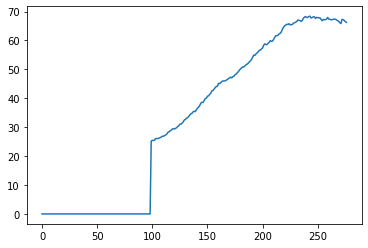

Episode 277 
 100 episode moving avg: 66.27
Episode 277 
 100 episode moving avg: 66.27


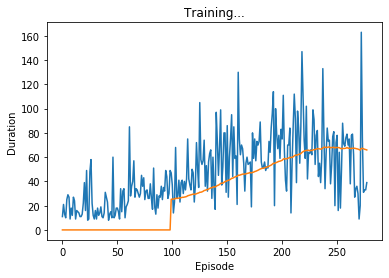

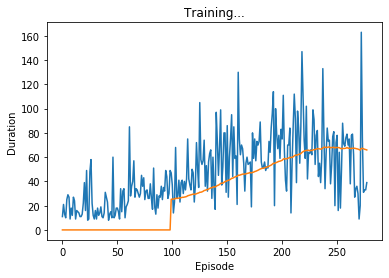

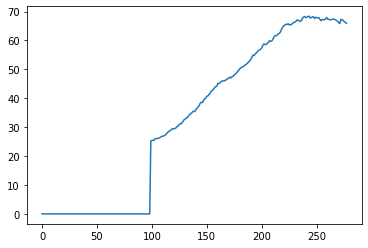

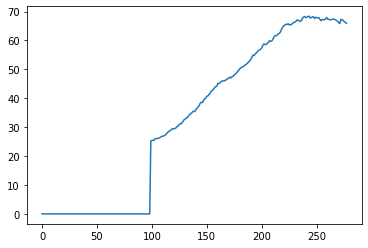

Episode 278 
 100 episode moving avg: 65.93
Episode 278 
 100 episode moving avg: 65.93


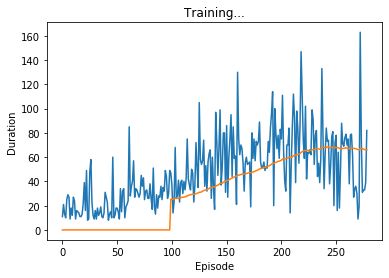

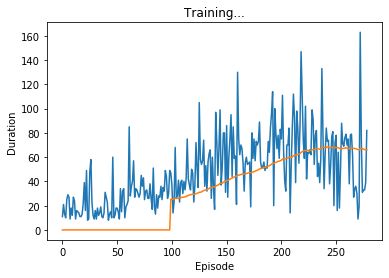

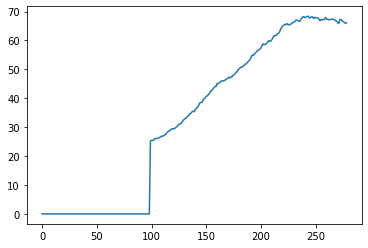

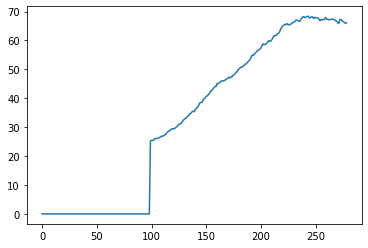

Episode 279 
 100 episode moving avg: 66.05
Episode 279 
 100 episode moving avg: 66.05


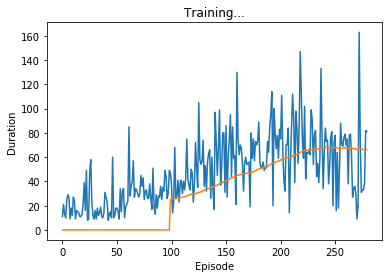

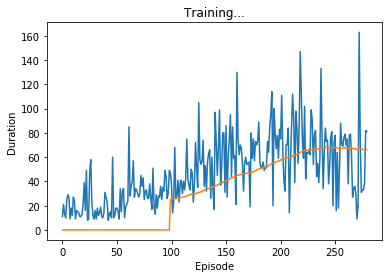

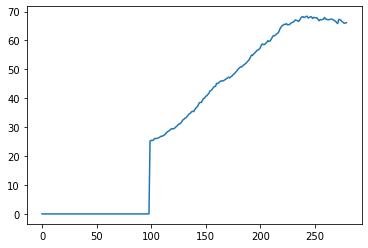

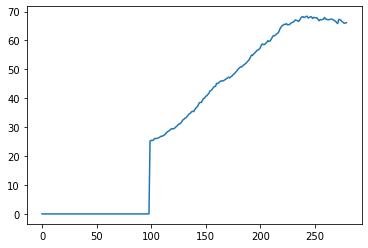

Episode 280 
 100 episode moving avg: 66.13
Episode 280 
 100 episode moving avg: 66.13


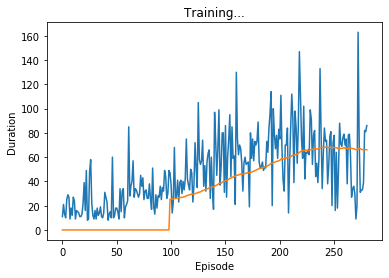

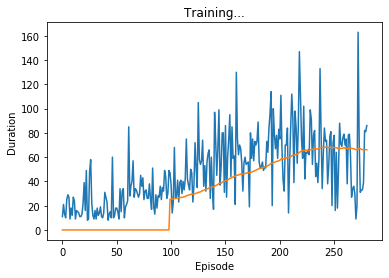

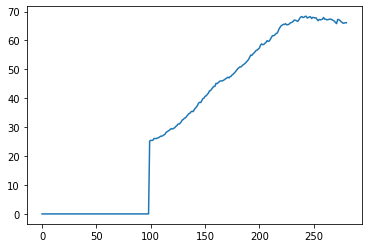

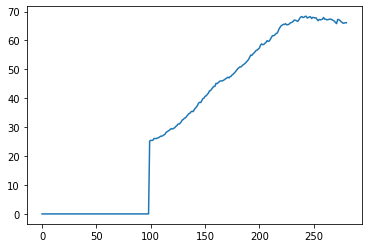

Episode 281 
 100 episode moving avg: 66.1
Episode 281 
 100 episode moving avg: 66.1


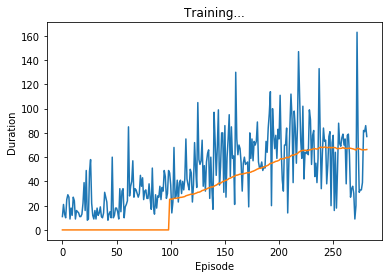

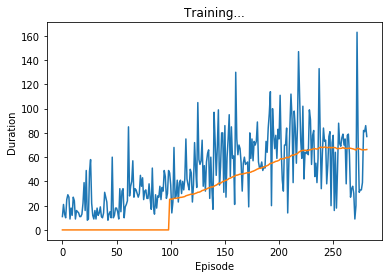

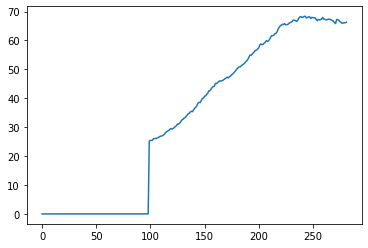

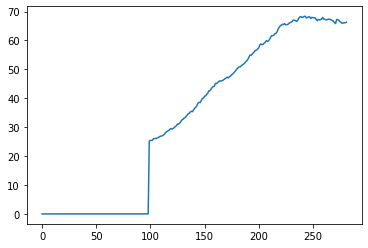

Episode 282 
 100 episode moving avg: 66.31
Episode 282 
 100 episode moving avg: 66.31


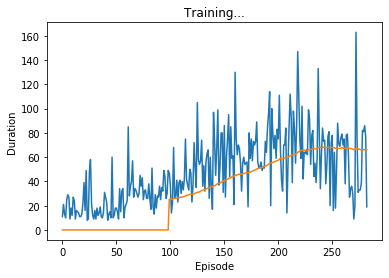

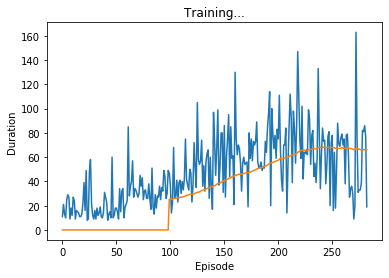

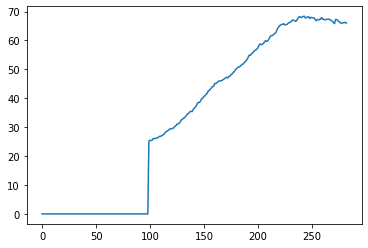

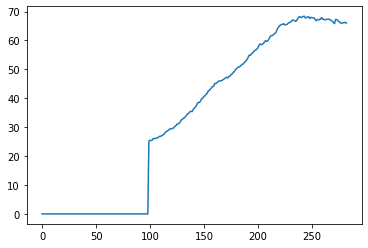

Episode 283 
 100 episode moving avg: 65.99
Episode 283 
 100 episode moving avg: 65.99


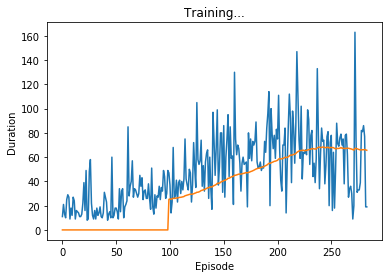

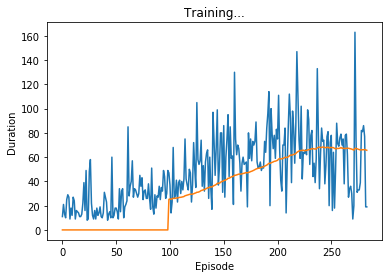

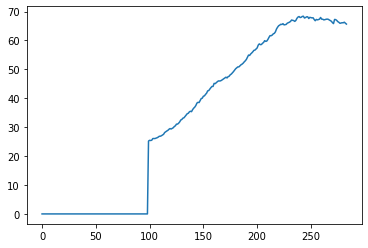

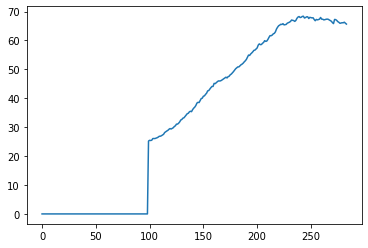

Episode 284 
 100 episode moving avg: 65.66
Episode 284 
 100 episode moving avg: 65.66


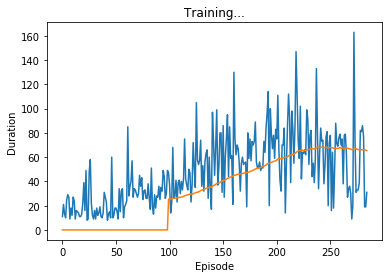

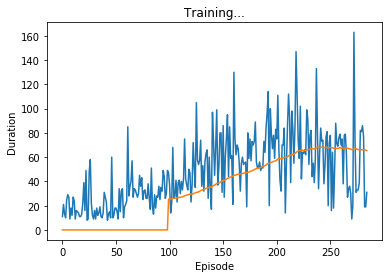

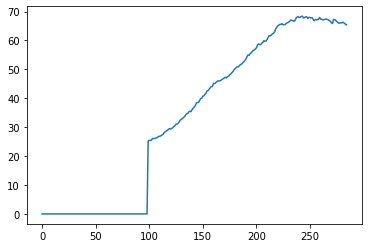

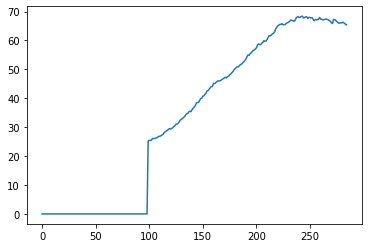

Episode 285 
 100 episode moving avg: 65.41
Episode 285 
 100 episode moving avg: 65.41


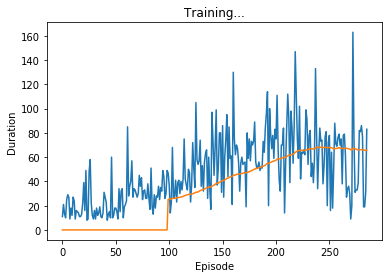

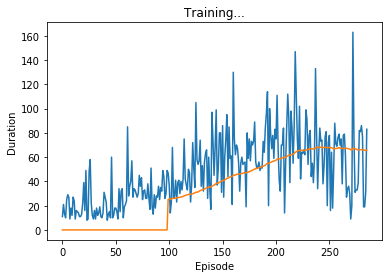

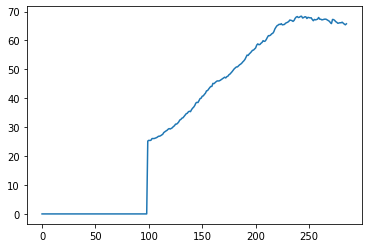

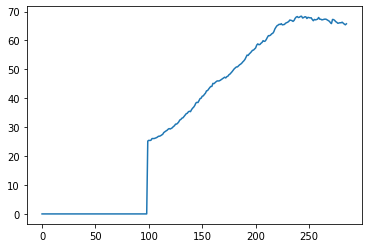

Episode 286 
 100 episode moving avg: 65.75
Episode 286 
 100 episode moving avg: 65.75


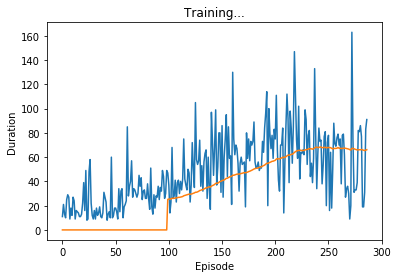

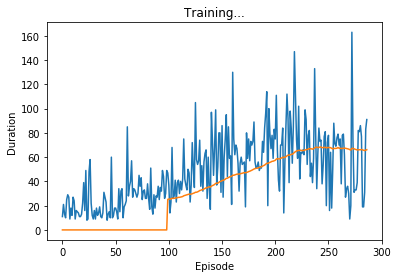

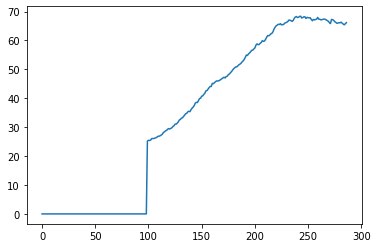

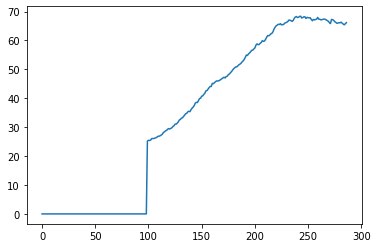

Episode 287 
 100 episode moving avg: 66.14
Episode 287 
 100 episode moving avg: 66.14


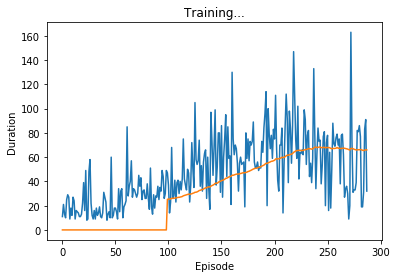

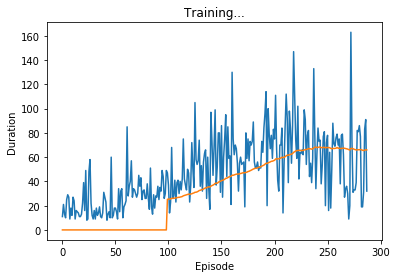

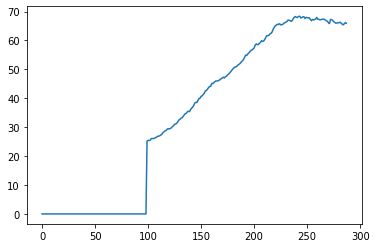

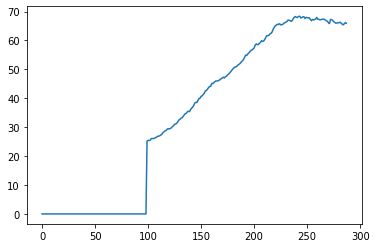

Episode 288 
 100 episode moving avg: 65.95
Episode 288 
 100 episode moving avg: 65.95


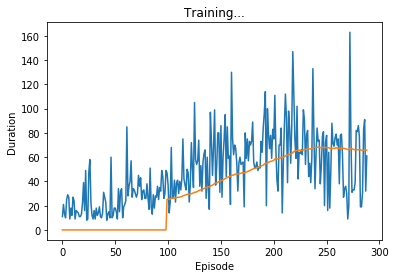

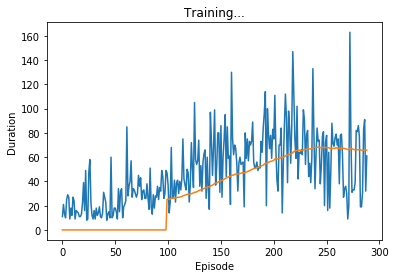

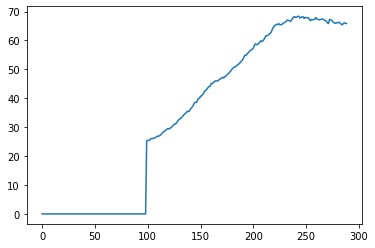

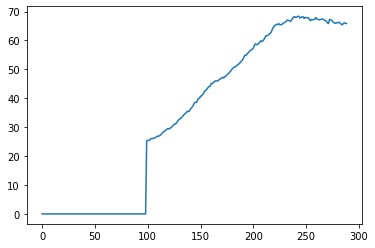

Episode 289 
 100 episode moving avg: 65.83
Episode 289 
 100 episode moving avg: 65.83


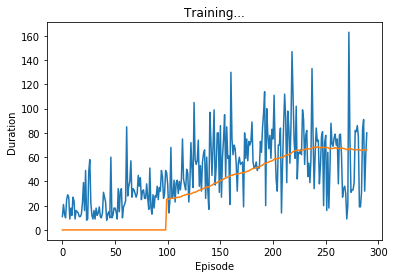

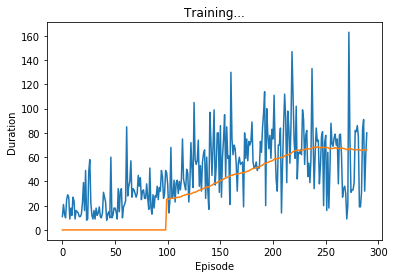

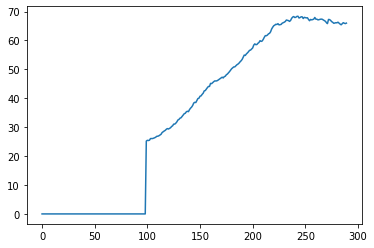

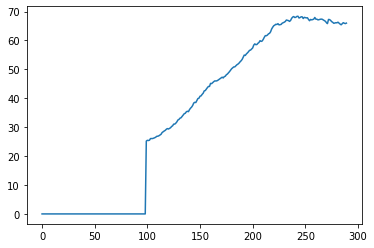

Episode 290 
 100 episode moving avg: 65.99
Episode 290 
 100 episode moving avg: 65.99


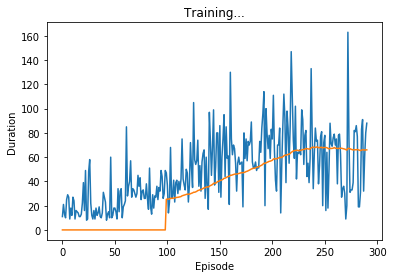

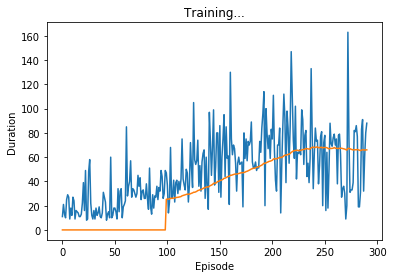

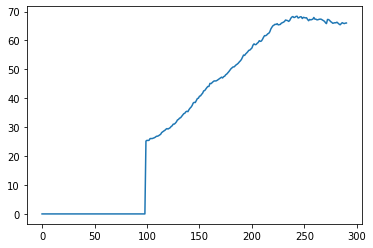

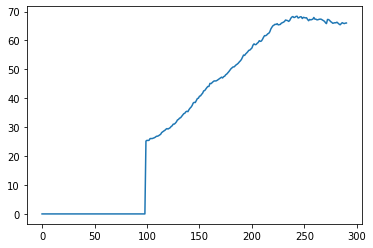

Episode 291 
 100 episode moving avg: 66.03
Episode 291 
 100 episode moving avg: 66.03


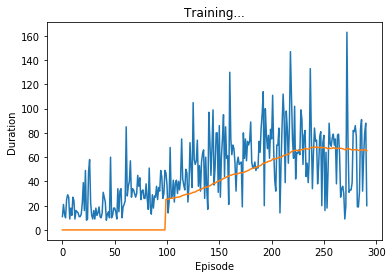

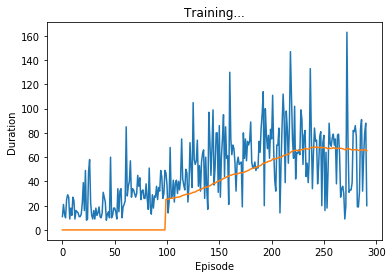

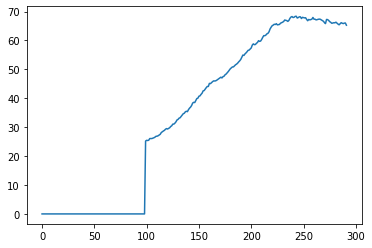

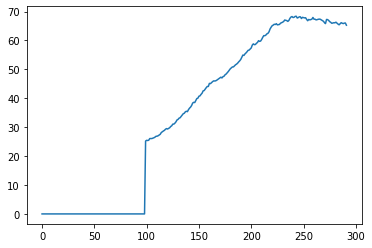

Episode 292 
 100 episode moving avg: 65.27
Episode 292 
 100 episode moving avg: 65.27


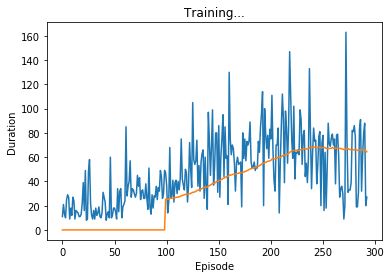

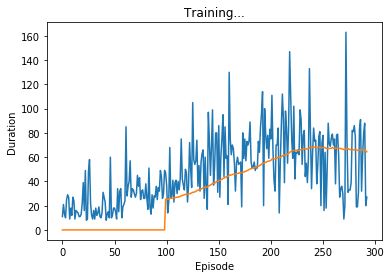

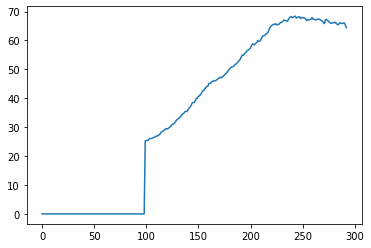

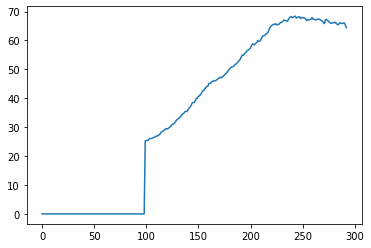

Episode 293 
 100 episode moving avg: 64.4
Episode 293 
 100 episode moving avg: 64.4


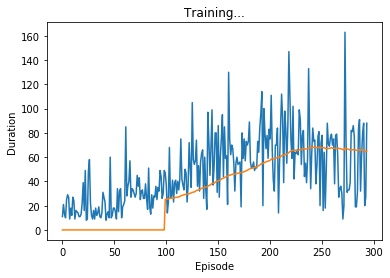

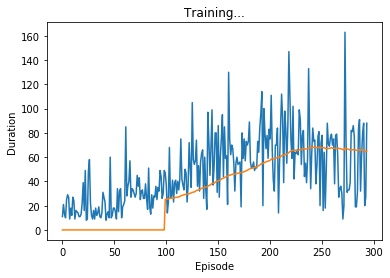

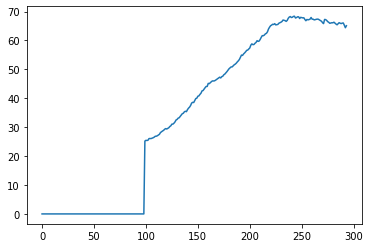

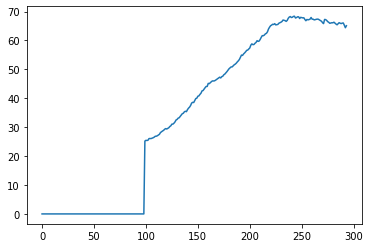

Episode 294 
 100 episode moving avg: 65.08
Episode 294 
 100 episode moving avg: 65.08


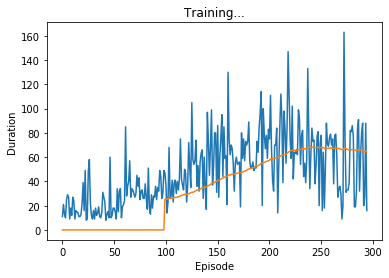

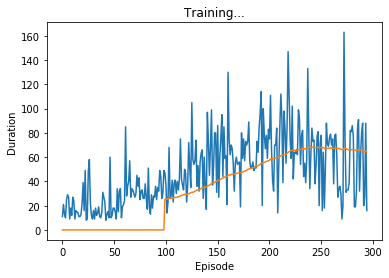

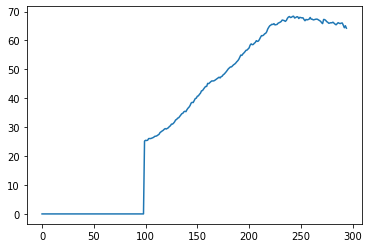

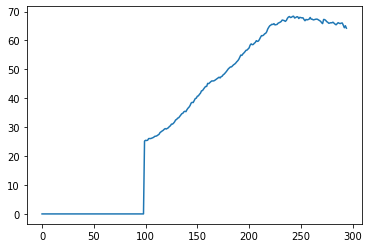

Episode 295 
 100 episode moving avg: 64.24
Episode 295 
 100 episode moving avg: 64.24


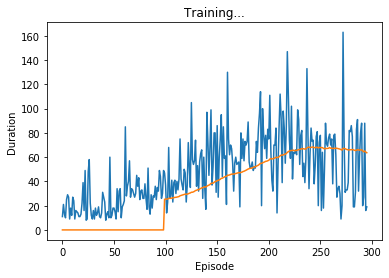

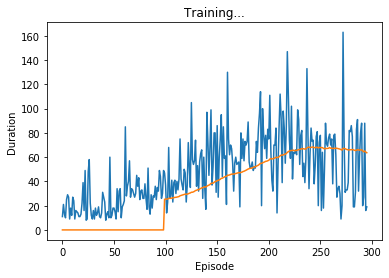

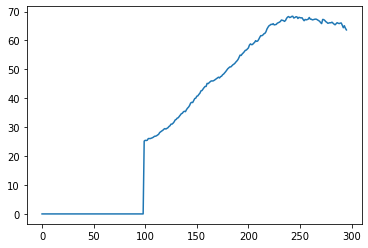

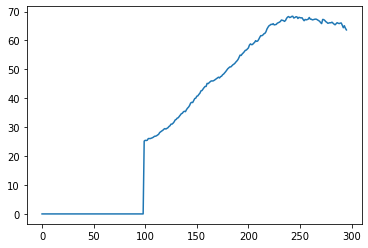

Episode 296 
 100 episode moving avg: 63.64
Episode 296 
 100 episode moving avg: 63.64


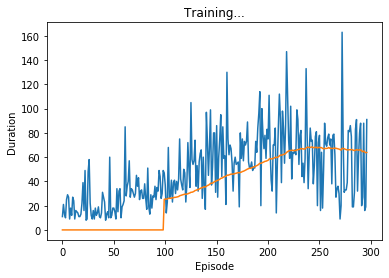

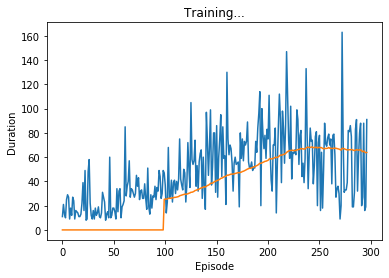

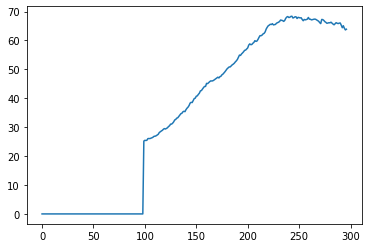

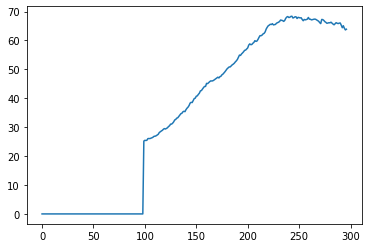

Episode 297 
 100 episode moving avg: 63.88
Episode 297 
 100 episode moving avg: 63.88


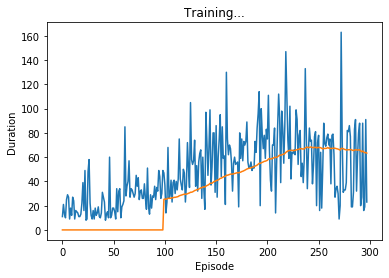

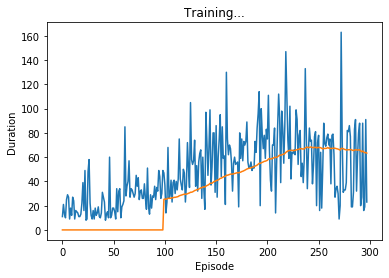

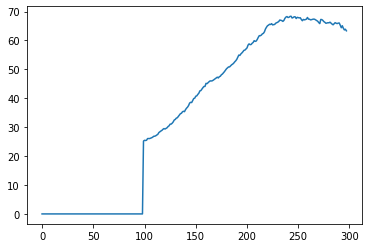

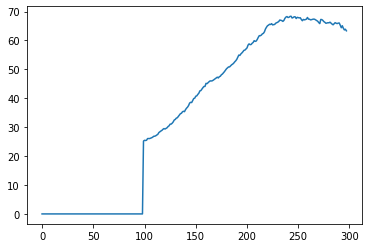

Episode 298 
 100 episode moving avg: 63.33
Episode 298 
 100 episode moving avg: 63.33


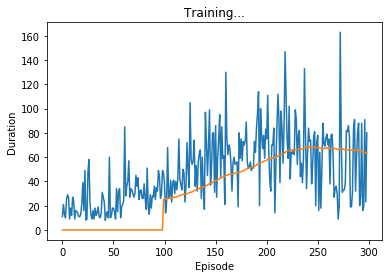

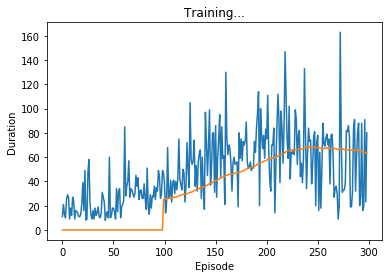

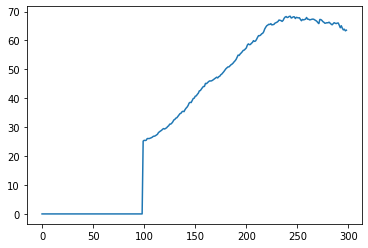

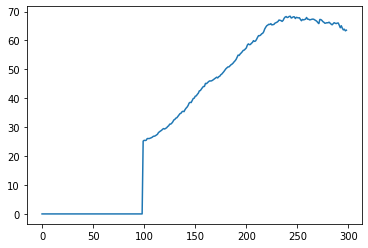

Episode 299 
 100 episode moving avg: 63.54
Episode 299 
 100 episode moving avg: 63.54


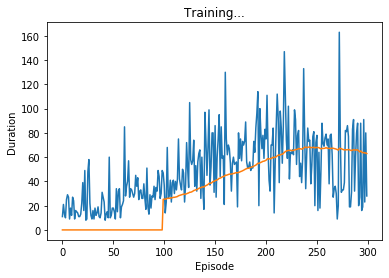

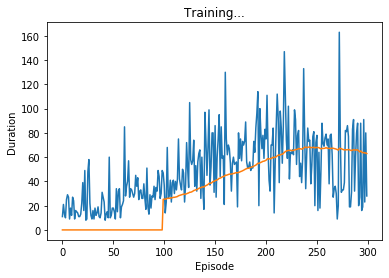

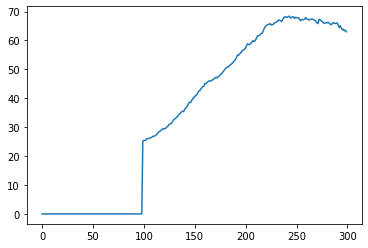

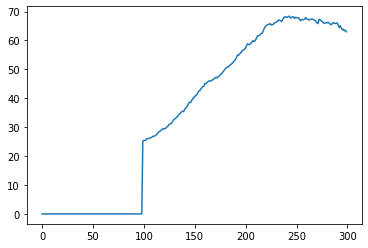

Episode 300 
 100 episode moving avg: 62.99
Episode 300 
 100 episode moving avg: 62.99


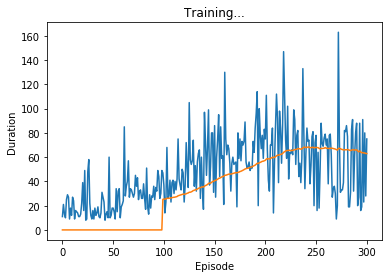

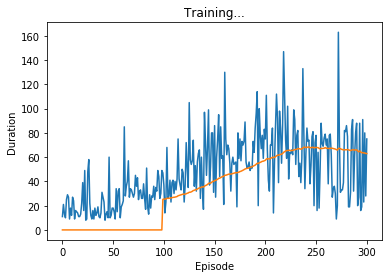

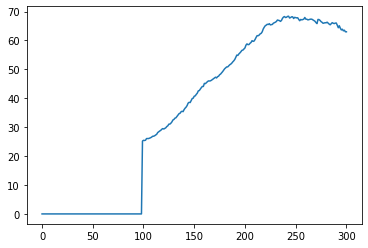

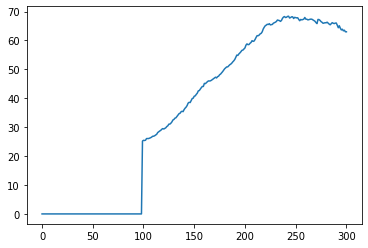

Episode 301 
 100 episode moving avg: 62.99
Episode 301 
 100 episode moving avg: 62.99


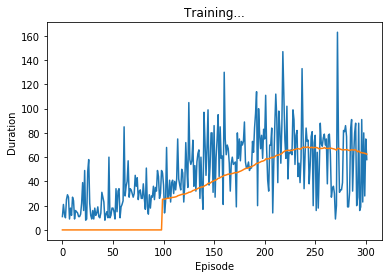

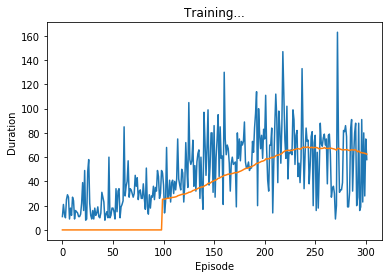

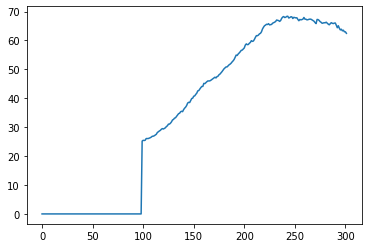

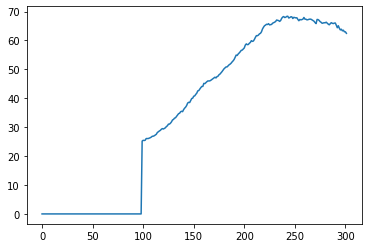

Episode 302 
 100 episode moving avg: 62.46
Episode 302 
 100 episode moving avg: 62.46


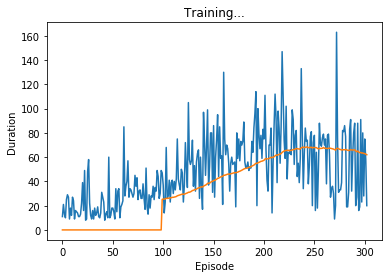

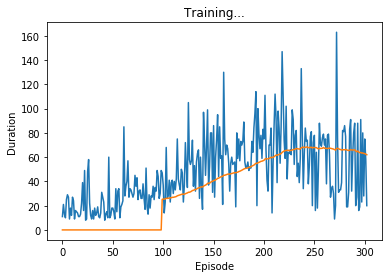

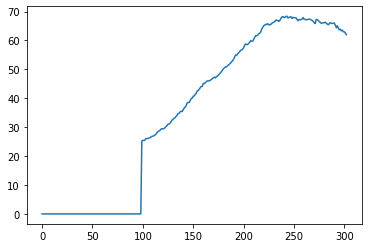

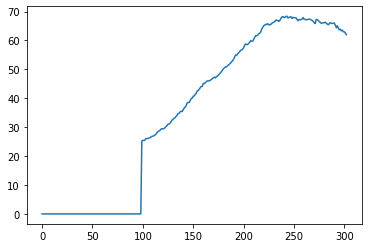

Episode 303 
 100 episode moving avg: 62.0
Episode 303 
 100 episode moving avg: 62.0


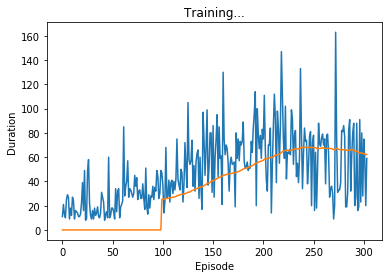

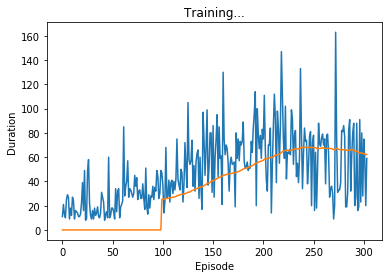

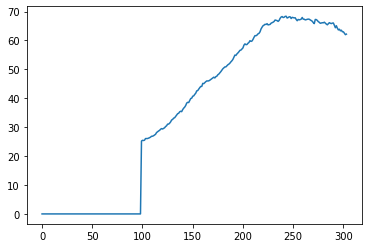

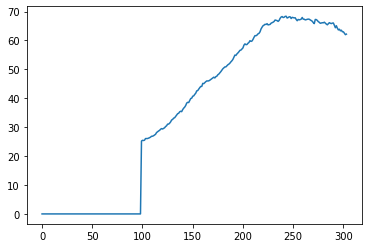

Episode 304 
 100 episode moving avg: 62.18
Episode 304 
 100 episode moving avg: 62.18


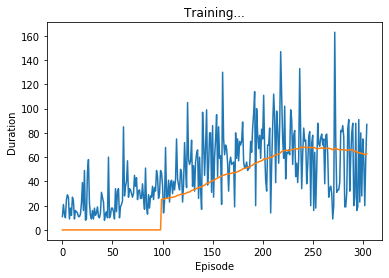

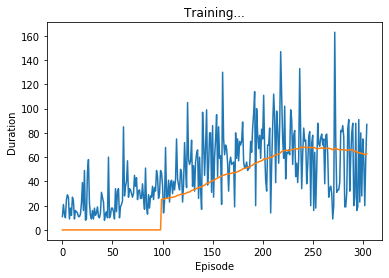

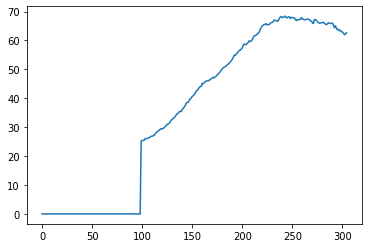

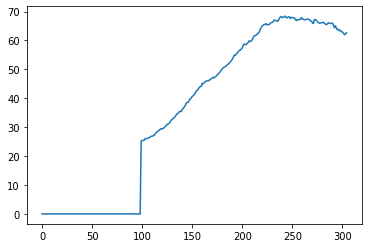

Episode 305 
 100 episode moving avg: 62.73
Episode 305 
 100 episode moving avg: 62.73


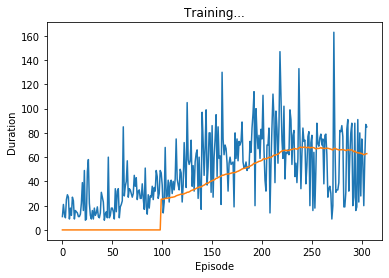

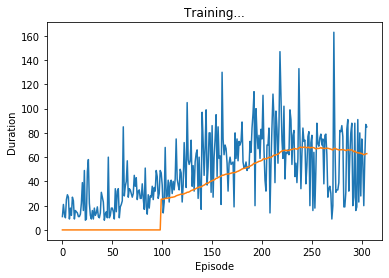

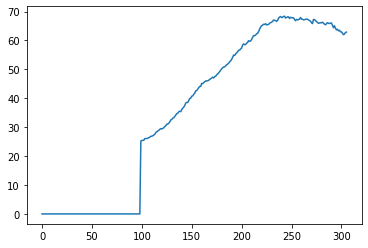

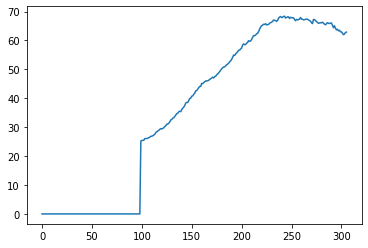

Episode 306 
 100 episode moving avg: 62.88
Episode 306 
 100 episode moving avg: 62.88


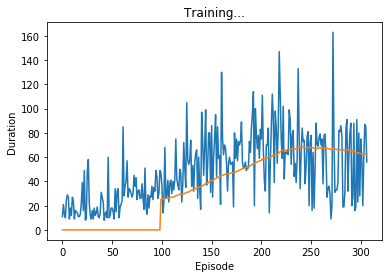

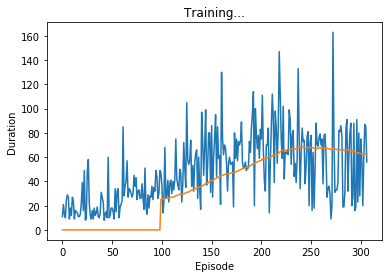

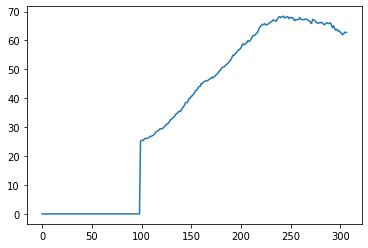

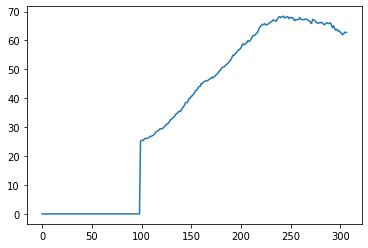

Episode 307 
 100 episode moving avg: 62.74
Episode 307 
 100 episode moving avg: 62.74


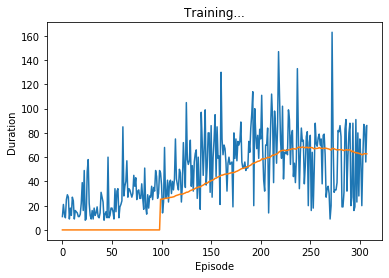

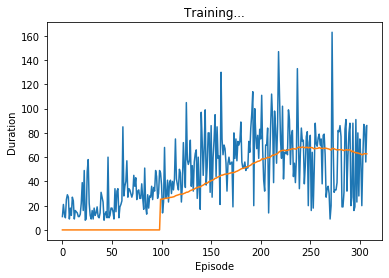

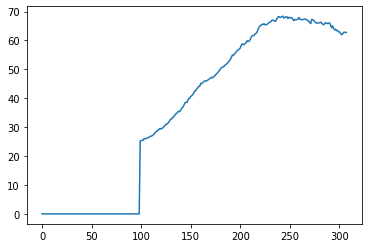

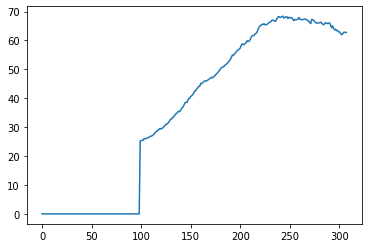

Episode 308 
 100 episode moving avg: 62.76
Episode 308 
 100 episode moving avg: 62.76


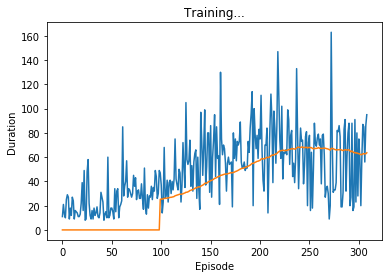

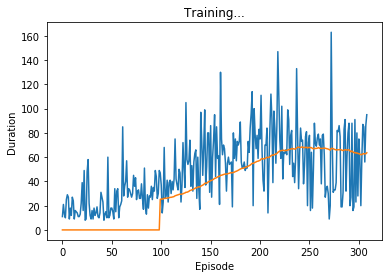

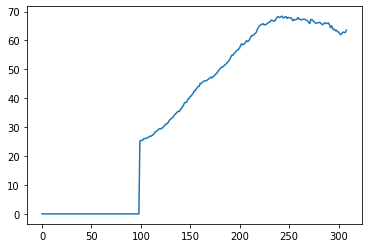

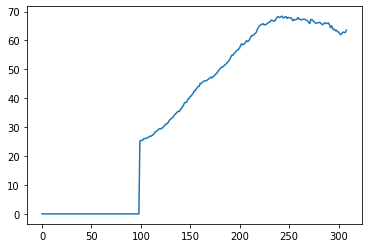

Episode 309 
 100 episode moving avg: 63.57
Episode 309 
 100 episode moving avg: 63.57


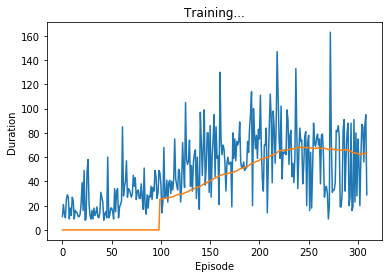

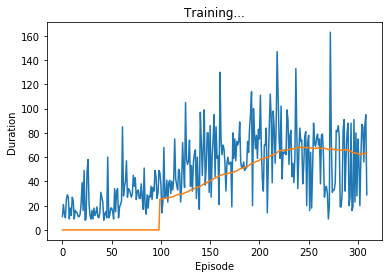

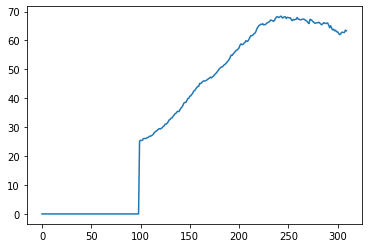

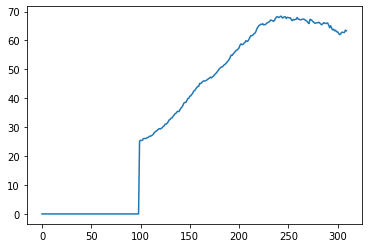

Episode 310 
 100 episode moving avg: 63.32
Episode 310 
 100 episode moving avg: 63.32


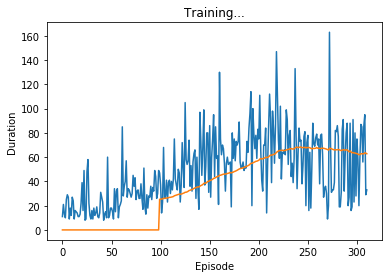

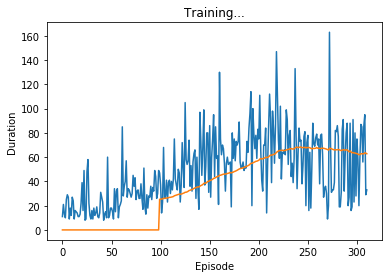

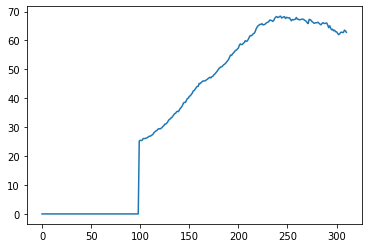

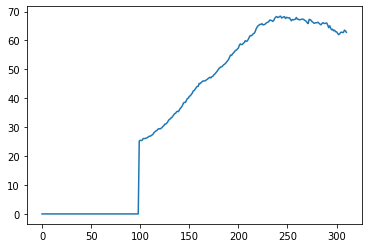

Episode 311 
 100 episode moving avg: 62.8
Episode 311 
 100 episode moving avg: 62.8


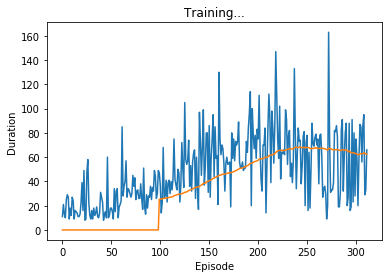

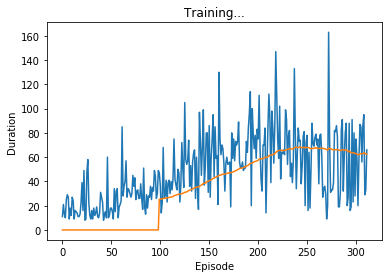

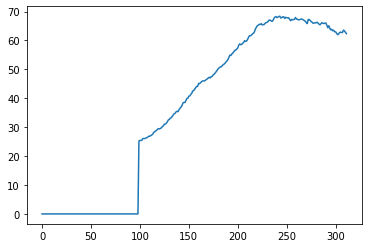

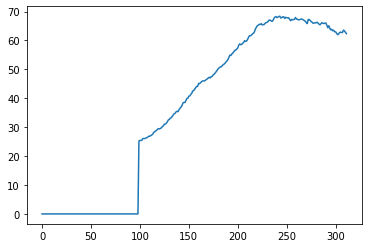

Episode 312 
 100 episode moving avg: 62.34
Episode 312 
 100 episode moving avg: 62.34


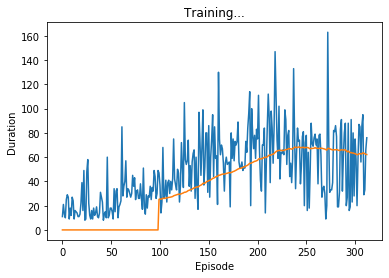

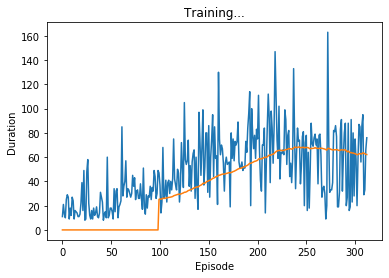

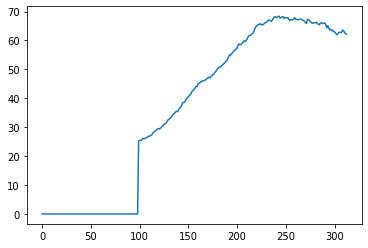

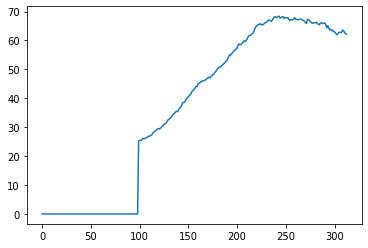

Episode 313 
 100 episode moving avg: 62.18
Episode 313 
 100 episode moving avg: 62.18


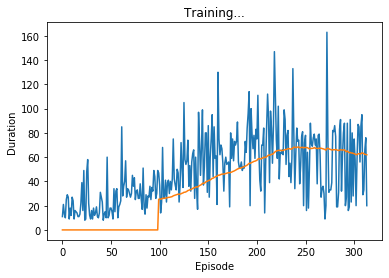

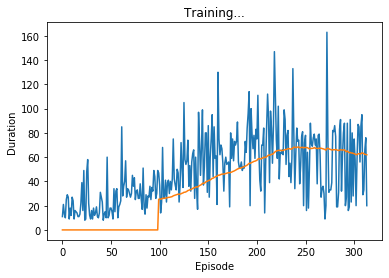

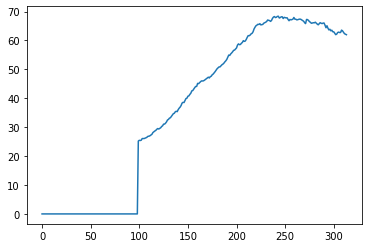

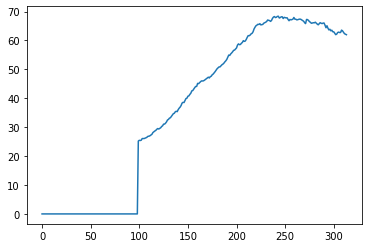

Episode 314 
 100 episode moving avg: 61.99
Episode 314 
 100 episode moving avg: 61.99


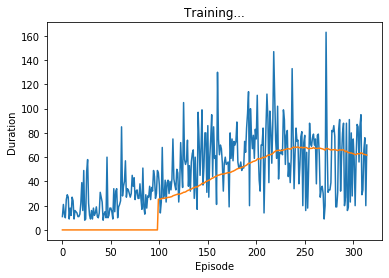

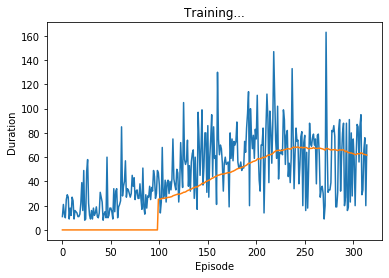

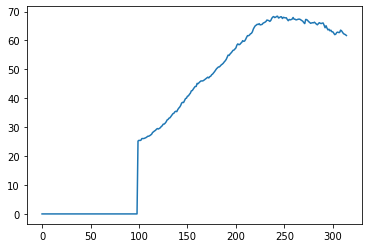

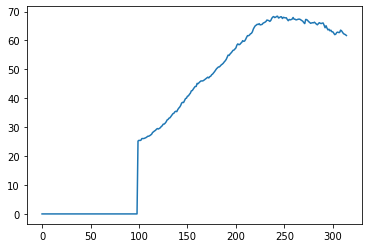

Episode 315 
 100 episode moving avg: 61.71
Episode 315 
 100 episode moving avg: 61.71


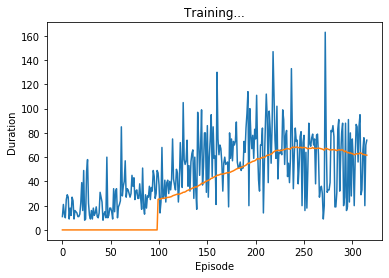

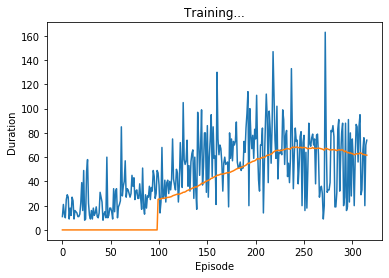

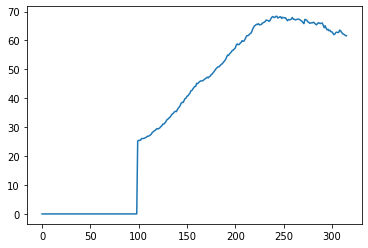

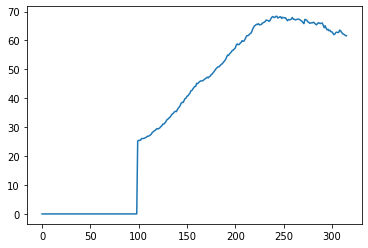

Episode 316 
 100 episode moving avg: 61.61
Episode 316 
 100 episode moving avg: 61.61


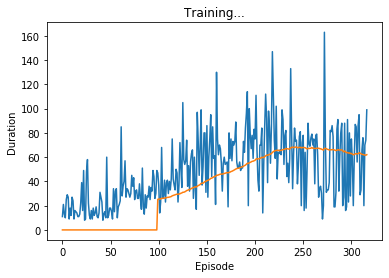

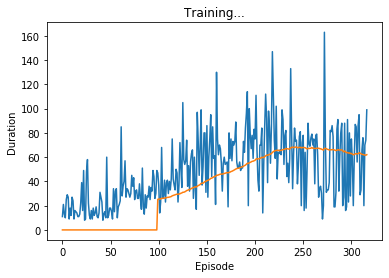

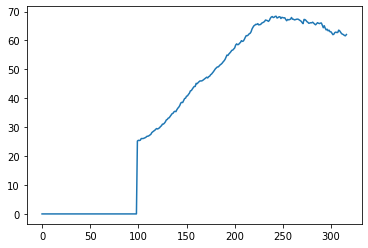

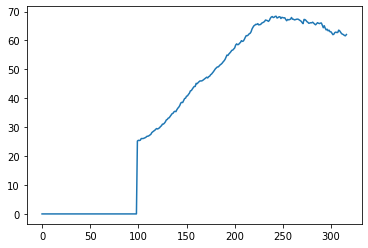

Episode 317 
 100 episode moving avg: 62.05
Episode 317 
 100 episode moving avg: 62.05


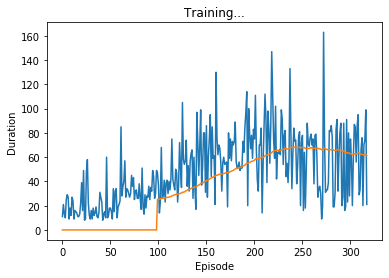

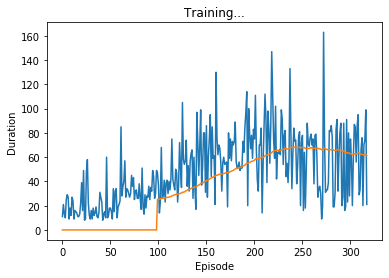

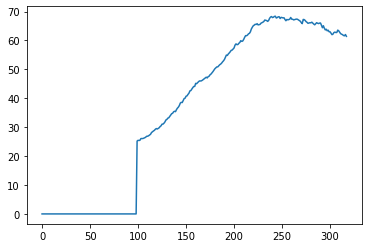

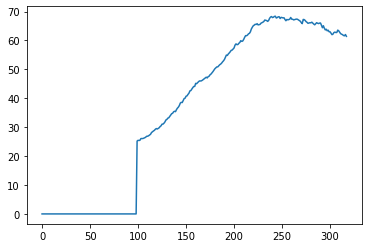

Episode 318 
 100 episode moving avg: 61.41
Episode 318 
 100 episode moving avg: 61.41


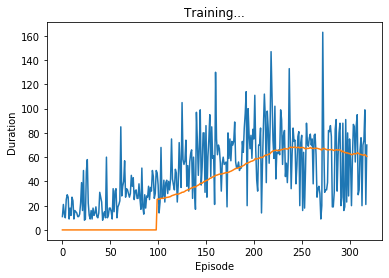

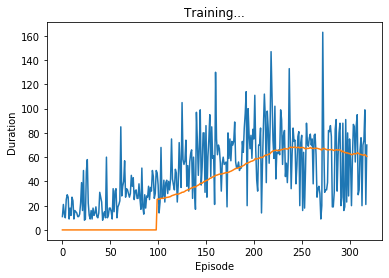

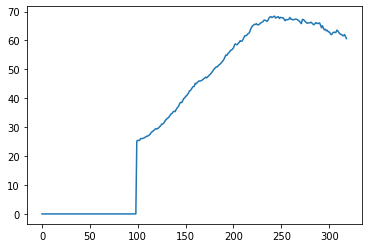

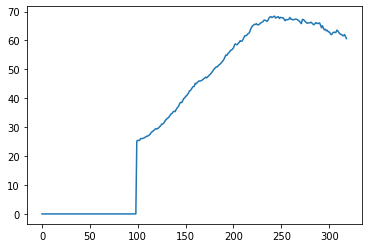

Episode 319 
 100 episode moving avg: 60.64
Episode 319 
 100 episode moving avg: 60.64


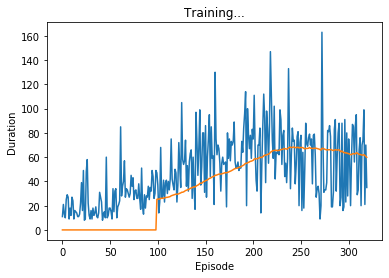

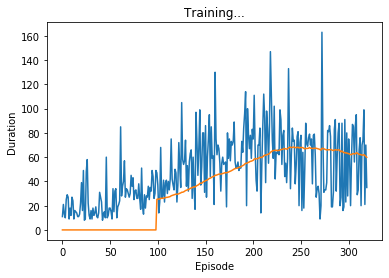

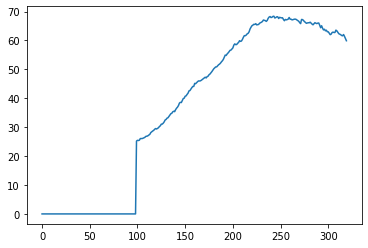

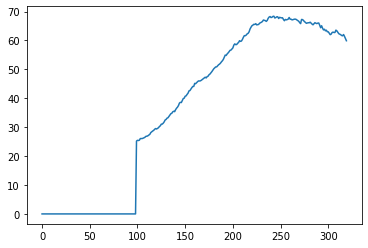

Episode 320 
 100 episode moving avg: 59.9
Episode 320 
 100 episode moving avg: 59.9


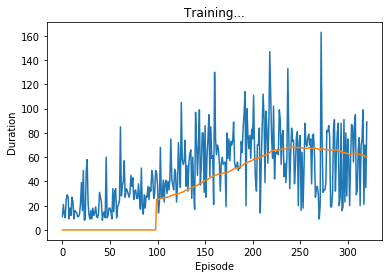

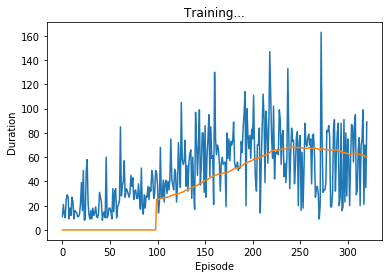

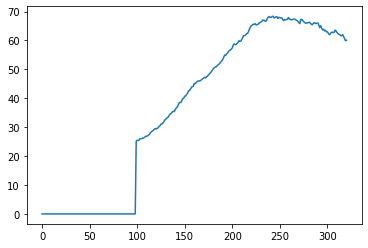

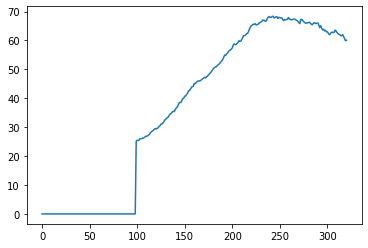

Episode 321 
 100 episode moving avg: 60.05
Episode 321 
 100 episode moving avg: 60.05


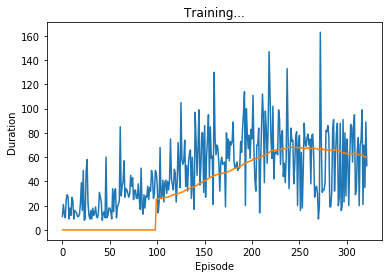

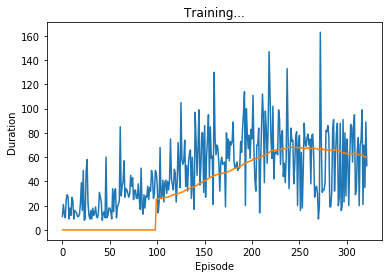

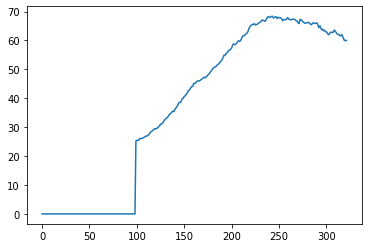

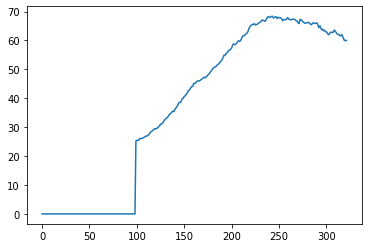

Episode 322 
 100 episode moving avg: 59.99
Episode 322 
 100 episode moving avg: 59.99


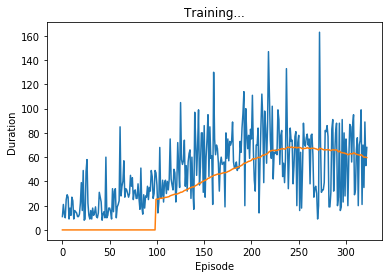

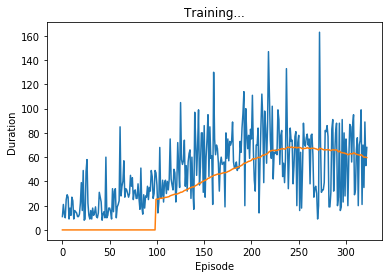

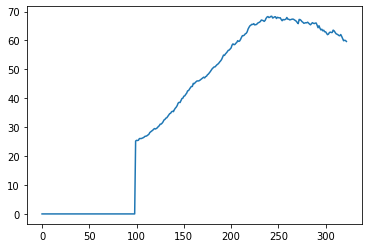

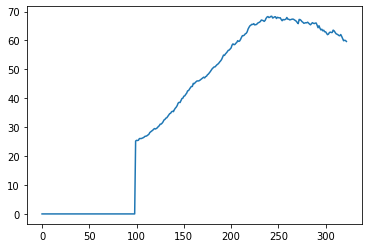

Episode 323 
 100 episode moving avg: 59.65
Episode 323 
 100 episode moving avg: 59.65


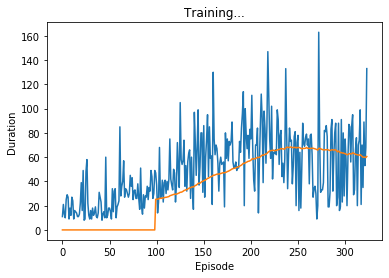

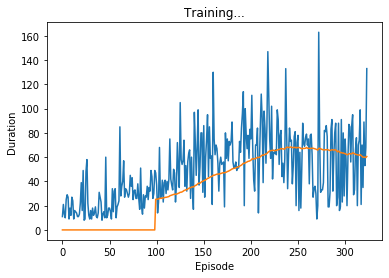

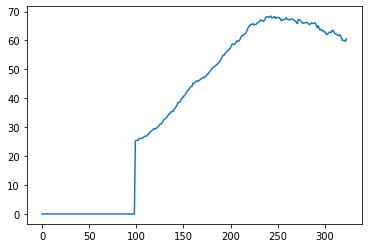

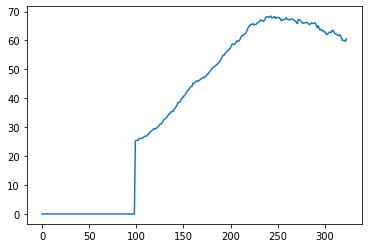

Episode 324 
 100 episode moving avg: 60.56
Episode 324 
 100 episode moving avg: 60.56


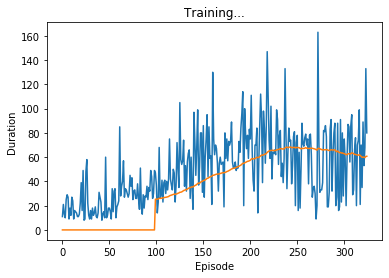

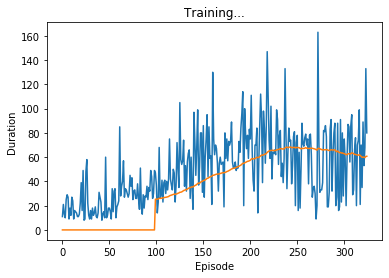

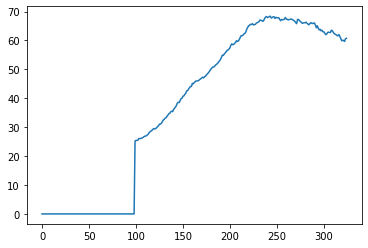

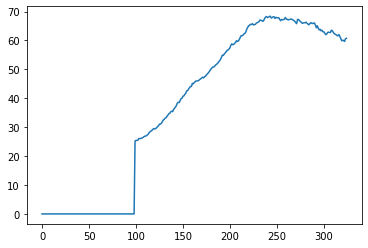

Episode 325 
 100 episode moving avg: 60.72
Episode 325 
 100 episode moving avg: 60.72


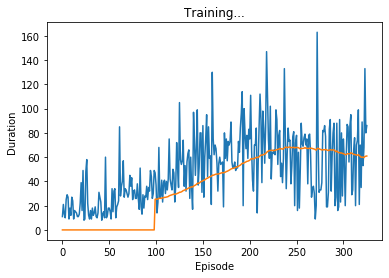

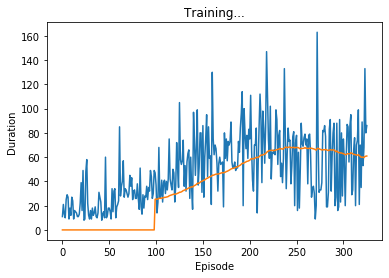

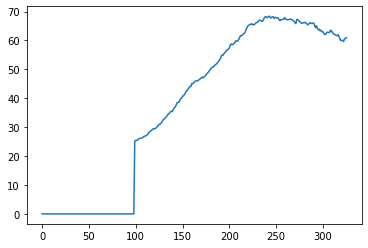

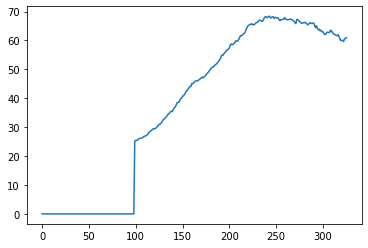

Episode 326 
 100 episode moving avg: 60.95
Episode 326 
 100 episode moving avg: 60.95


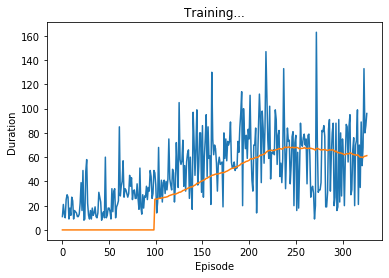

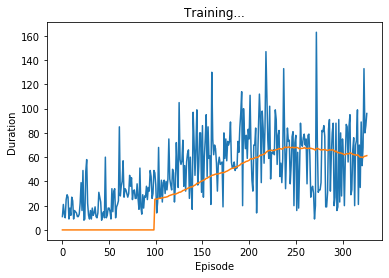

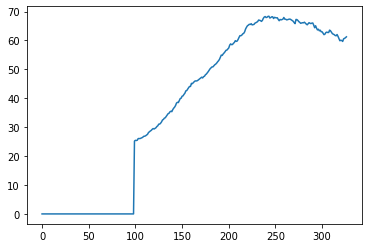

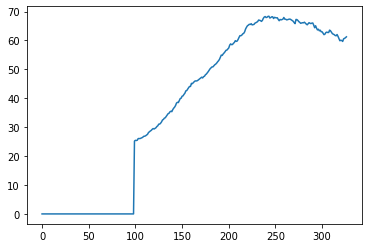

Episode 327 
 100 episode moving avg: 61.25
Episode 327 
 100 episode moving avg: 61.25


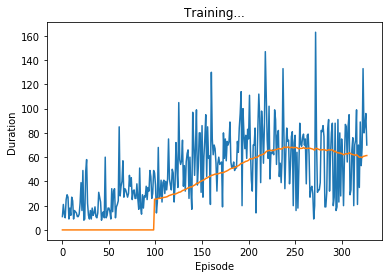

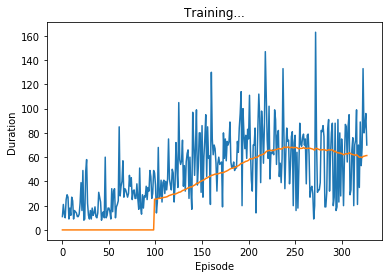

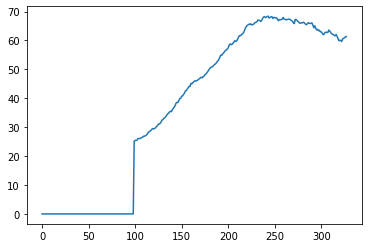

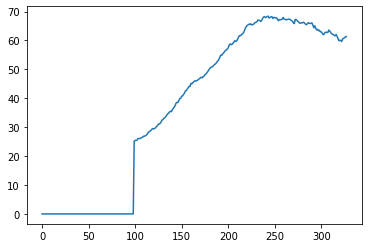

Episode 328 
 100 episode moving avg: 61.33
Episode 328 
 100 episode moving avg: 61.33


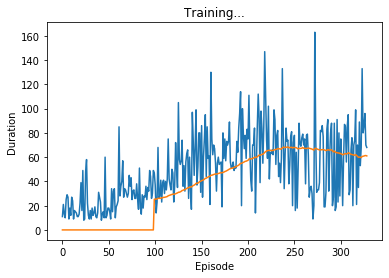

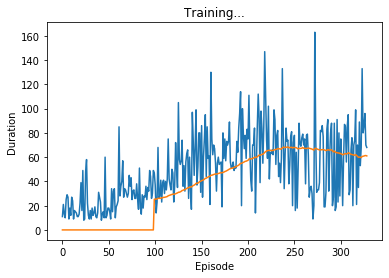

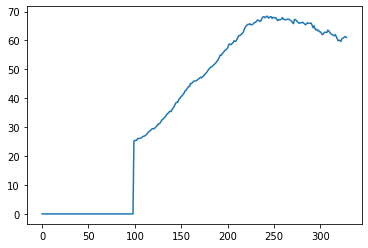

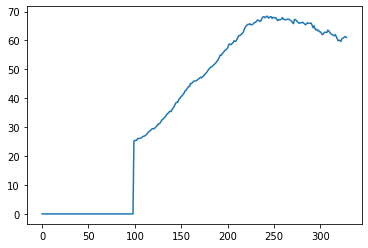

Episode 329 
 100 episode moving avg: 61.02
Episode 329 
 100 episode moving avg: 61.02


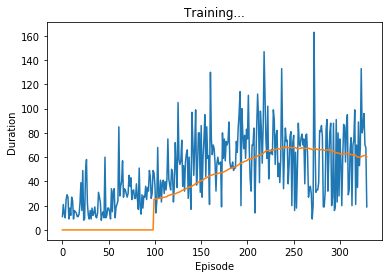

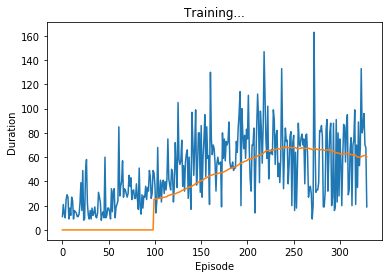

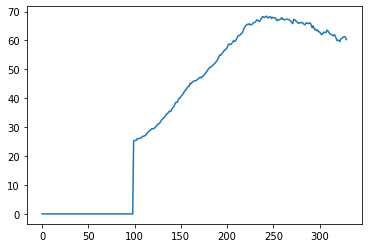

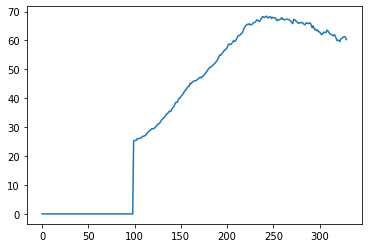

Episode 330 
 100 episode moving avg: 60.3
Episode 330 
 100 episode moving avg: 60.3


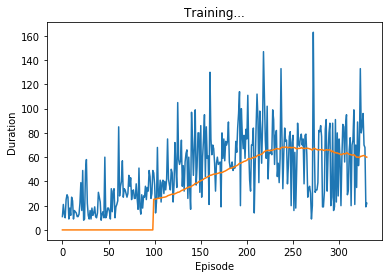

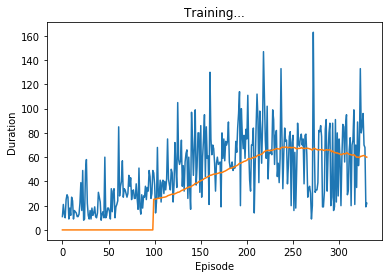

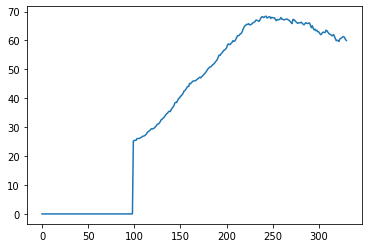

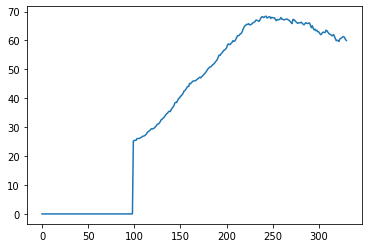

Episode 331 
 100 episode moving avg: 59.98
Episode 331 
 100 episode moving avg: 59.98


KeyboardInterrupt: ignored

KeyboardInterrupt: ignored

In [0]:
episode_durations = []
for episode in range(num_episodes):
    em.reset()
    state = em.get_state()

    for timestep in count():
        action = agent.select_action(state, policy_net)
        reward = em.take_action(action)
        next_state = em.get_state()
        memory.push(Experience(state, action, next_state, reward))
        state = next_state
    
        if memory.can_provide_sample(batch_size):
            experiences = memory.sample(batch_size)
            states, actions, rewards, next_states = extract_tensors(experiences)
            
            current_q_values = QValues.get_current(policy_net, states, actions)
            next_q_values = QValues.get_next(target_net, next_states)
            target_q_values = (next_q_values * gamma) + rewards

            loss = F.mse_loss(current_q_values, target_q_values.unsqueeze(1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        if em.done:
            episode_durations.append(timestep)
            plot(episode_durations, 100)
            break

    if episode % target_update == 0:
        target_net.load_state_dict(policy_net.state_dict())

em.close()

# Findings and Reflection
## Performance
During training, the DQN agent's performance varied quite a lot. As the number of episodes it had trained for increased, there was a general increase in the duration it spent in the environment; meaning that it began to learn how to control the cart better. From the graphs produced, we can see that were some peaks at certain episodes, where the agent performed paticularly well, and also some lows were it performed particularly badly. The 100 episode moving average remained at 0 up until the 100th episode as this metric cannot be calculated until the total number of episodes is greater than or equal to 100. After that we can see the agents performance steadily improve in almost a linear increase, as shown from the increase in the 100 episode moving average. However, we can see that the duration the agent could maintain the cart pole for began to reach a plateau in terms of performance and after episode 230 the 100 episode moving average begins the decrease. This may be due to overload of states and the maximum effectiveness of the agent being reached.

Unfortunately the agent never reached an average reward (duration) of 195 over 100 trials (episodes) and as thus, never solved the environment. If I had ran the training for more episodes, up to episode 1000 it may have ended up solving the CartPole-v0 environment. From OpenAI Gym's website, we can see different evaluations for the Cart Pole environment ranging from algorithms solving it in 85 to 1894 episodes. My decision to stop the training of the agent just before the 350th episode was due to the decrease in performance exhibited after episode 230. If I had continued training the agent up until episode 500, or even 1000 it may have shown more positive increments in it's performance.

## Going forward
The processed image dimensions are 90x40 and the image is RGB. This means that each image inputted has three dimensions, one dimension for each colour; red, green or blue. The processed images which represent the states must be flattened and changed to a tensor in order to input it propely in the neural network. The structure of the ANN (artificial neural network) used in this cart pole training was
*   Image of 90x40x3 is flattened to 10800 indivual values (tensor) representing the magnitude of each pixel value.
*   Input Layer: 10800 nodes
*   Hidden Layer 1: A fully connected layer with 128 nodes. The activation function used is ReLu
*   Hidden Layer 2: A fully connected layer with 64 nodes. The activation function used is ReLu
*   Hidden Layer 3: A fully connected layer with 32 nodes. The activation function used is ReLu
*   Output Layer: This layer has only two nodes and each node represents the action that the agent can take in the environment; apply a force of +1 to the left or right of the cart

Changing the properties of the neural network such as the number of layers, number of nodes in each layer and the type of layer may increase performance. I will try these four things (1) Adding more layers (2) Increasing the number of nodes per layer (3) Changing the layers to Convolutional layers (4) Running the same neural network for more total episodes. I will then compare the metrics of my changes to the original metrics from this neural network. This should allow me to see how changing the size and type of the neural network's layers affects performance.


